In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm.auto import tqdm

import torch
import epiframework
import numpy as np
import pandas as pd
import nn_blocks, idplots, ddpm, myutils, inpaint, ground_truth

import build_dataset, training_datasets
from torch.utils.data import DataLoader
from torchvision import transforms
import datetime


import sys
sys.path.append('CoPaint4influpaint')
from guided_diffusion import O_DDIMSampler
from guided_diffusion import unet
from utils import config

image_size = 64
channels = 1
batch_size=512
epoch = 800
device = "cuda" if torch.cuda.is_available() else "cpu"
print(device)
if device == "cuda":
    print(myutils.cuda_mem_info())
    torch.cuda.empty_cache() # make sure we don't keep old stuff
    print(myutils.cuda_mem_info())

/nas/longleaf/home/chadi/.conda/envs/diffusion_torch6/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


cuda
NVIDIA L40 -- Allocated: 0.0GB, Cached: 0.0GB -- 43.9/44.3 (free/total)
NVIDIA L40 -- Allocated: 0.0GB, Cached: 0.0GB -- 43.9/44.3 (free/total)


ModuleNotFoundError: No module named 'delphi'

## Prepare ground-truth for inpainting

Restored git repo Flusight/FluSight-forecast-hub/
Spatial Setup with 51 locations.
⚠️ ⚠️ ⚠️ Make sure ./update_data.sh is ran AND that the fork is updated
Checked out commit on 2024-03-06 12:46:50.743554 (SHA: 830dfbad2ac3e35630772ae573963f80edb4b50a, 1709746053) for repo Flusight/FluSight-forecast-hub/
⚠️ ⚠️ ⚠️ Make sure ./update_data.sh is ran AND that the fork is updated
Restored git repo Flusight/FluSight-forecast-hub/
Masking, >> 32 weeks already in data, inpainting the next ones


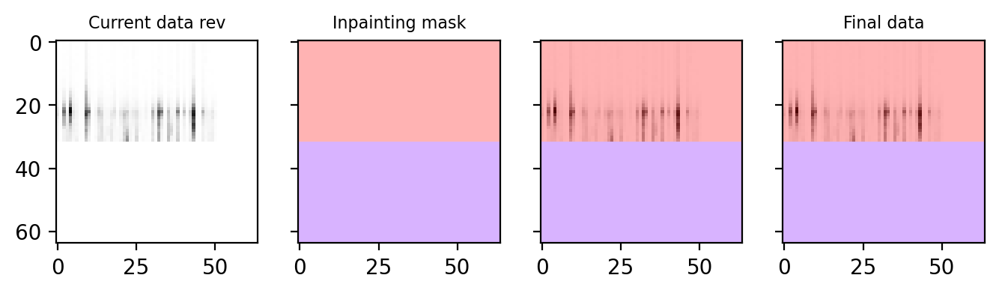

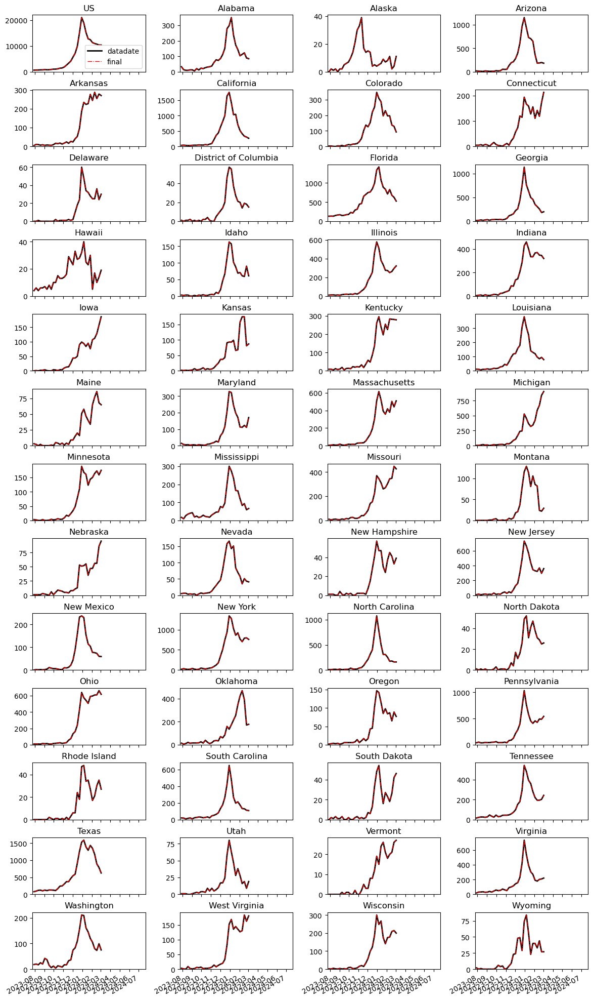

In [2]:
# if True, take a training data sample as gt:
if False: 
    inpaintfrom_idx = 19
    gt_keep_mask = np.ones((channels,image_size,image_size))
    gt_keep_mask[:,inpaintfrom_idx:,:] = 0
    # mask is ones for the known pixels, and zero for the ones to be infered
    gt = data.getitem_nocast(4)
    print(gt.shape)
    show_tensor_image(gt, place=ipl)
    plt.show()

gt1 = ground_truth.GroundTruth(season_first_year="2023", 
                               data_date=datetime.datetime.today(), #datetime.datetime(2023,10,25)
                               mask_date=datetime.datetime.today(),
                               channels=channels,
                               image_size=image_size
                               )
gt1.plot_mask()
gt1.plot()

In [3]:
gt1.flusetup

## Define a PyTorch Dataset + DataLoader

In [4]:
dataset = training_datasets.FluDataset.from_fluview(
                                         flusetup=gt1.flusetup,
                                         download=False, 
                                         #transform=transforms.transform_randomscale
                                         )
dataset = training_datasets.FluDataset.from_SMHR1_fluview(flusetup=gt1.flusetup, download=False)
#data = training_datasets.FluDataset.from_csp_SMHR1('Flusight/flu-datasets/synthetic/CSP_FluSMHR1_weekly_padded_4scn.nc', channels=channels)
dataset.test(6)

created dataset with max [19.4177], full dataset has shape (13, 1, 64, 64)
After repeat, fluview data has shape (1170, 1, 64, 64) vs (1199, 1, 64, 64) from csp
created dataset with max [14603.53538403], full dataset has shape (2369, 1, 64, 64)
test passed: back and forth transformation are ok ✅


In [5]:
scaling_per_channel = np.array(np.sqrt(max(dataset.max_per_feature, gt1.gt_xarr.max(dim=["date", "place"])).data))
scaling_per_channel

array([120.84508837])

In [6]:
## define image transformations (e.g. using torchvision)

transform_enrich = transforms.Compose([
                        transforms.Lambda(lambda t: transforms.transform_poisson(t)),
                        transforms.Lambda(lambda t: transforms.transform_random_padintime(t, min_shift = -15, max_shift = 15)),
                        #transforms.Lambda(lambda t: transforms.transform_randomscale(t, min=.1, max=1.9)),
        ])
#                         transforms.Lambda(lambda t: transforms.transform_skewednoise(t, scale=.4, a=-1.8))
transform = transforms.Compose([
                        transforms.transform_sqrt,
                        transforms.Lambda(lambda t: transforms.transform_channelwisescale(t, scale = 1/scaling_per_channel)),
                        transforms.Lambda(lambda t: transforms.transform_channelwisescale(t, scale = 2)),

        ])

# TODO: scaling on incident hops scale.

transform_inv = transforms.Compose([
                    transforms.transform_sqrt_inv,
                    transforms.Lambda(lambda t: transforms.transform_channelwisescale_inv(t, scale = 1/scaling_per_channel)),
                    transforms.Lambda(lambda t: transforms.transform_channelwisescale_inv(t, scale = 2)),
        ][::-1])      # important reverse the sequence

In [7]:
dataset.add_transform(transform=transform, transform_inv=transform_inv, transform_enrich=transform_enrich, bypass_test=False)

test passed: back and forth transformation are ok ✅


In [8]:
sample = dataset[6]
print(f"There are {len(dataset)} samples in the dataset, and a single sample has shape {sample.shape}")

There are 2369 samples in the dataset, and a single sample has shape torch.Size([1, 64, 64])


In [9]:
# Dataset is shuffled, but the last incompleted batch is dropped
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, drop_last=True) 
batch = next(iter(dataloader))
print(f"batch shape {batch.shape}")

batch shape torch.Size([512, 1, 64, 64])


Next, we define a function which we'll apply on-the-fly on the entire dataset. We use the `with_transform` [functionality](https://huggingface.co/docs/datasets/v2.2.1/en/package_reference/main_classes#datasets.Dataset.with_transform) for that. The function just applies some basic image preprocessing: random horizontal flips, rescaling and finally make them have values in the $[-1,1]$ range.

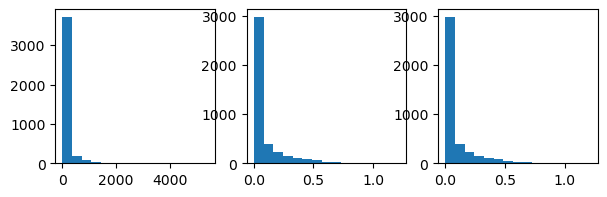

In [10]:
fig, axes = plt.subplots(1,3, figsize=(7,2))
axes.flat[0].hist(dataset.get_sample_raw(4).flatten(), bins=15);
axes.flat[1].hist(dataset.get_sample_transformed(4).flatten(), bins=15);
axes.flat[2].hist(dataset.get_sample_transformed_enriched(4).flatten(), bins=15);

In [11]:
# fig, axes = plt.subplots(8, 7, figsize=(16,16), dpi=100, sharex=True, sharey=True)
# for ipl in range(51):
#     ax = axes.flat[ipl]
#     for i in range(batch_size):
#         ax.plot(batch[i][0][:,ipl], lw=0.5)

## Initialize the DDPM class

In [12]:
model = nn_blocks.Unet(
    dim=image_size,
    channels=channels,
    dim_mults=(1, 2, 4,),
    use_convnext=False
)

ddpm1 = ddpm.DDPM(model=model, 
                    image_size=image_size, 
                    channels=channels, 
                    batch_size=batch_size, 
                    epochs=epoch, 
                    timesteps=200,
                    device=device)


In [13]:
if False:
    model = unet.UNetModel(
            image_size=image_size,
            in_channels=1,
            out_channels=1,
            num_res_blocks=3,
            model_channels=3,
            attention_resolutions=2,
        )

In [14]:
dataset
if device == "cuda":
    print(myutils.cuda_mem_info())
    torch.cuda.empty_cache() # make sure we don't keep old stuff
    print(myutils.cuda_mem_info())

NVIDIA L40 -- Allocated: 0.0GB, Cached: 0.0GB -- 43.9/44.3 (free/total)
NVIDIA L40 -- Allocated: 0.0GB, Cached: 0.0GB -- 43.9/44.3 (free/total)


## Forward diffusion sample

batch shape torch.Size([512, 1, 64, 64])
California


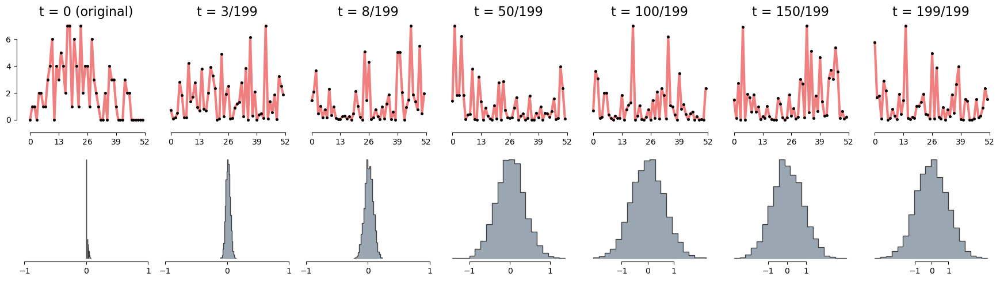

In [15]:
# use seed for reproducability
#torch.manual_seed(0)
x_start = next(iter(dataloader))
print(f"batch shape {batch.shape}")

def plot(imgs, row_title=None, col_title=None, with_histogram=True, plot_size=2, **imshow_kwargs): # with_orig=False,
    if not isinstance(imgs[0], list):
        # Make a 2d grid even if there's just 1 row
        imgs = [imgs]

    
    mult_rows=1
    if with_histogram:
        mult_rows=2

    place = 4
    color="lightcoral"#'slategray'
    print(gt1.flusetup.get_location_name(gt1.flusetup.locations[place]))
    
    num_rows = len(imgs)*mult_rows
    num_cols = len(imgs[0]) #+ with_orig
    fig, axs = plt.subplots(figsize=(plot_size*num_cols,plot_size*num_rows), nrows=num_rows, ncols=num_cols, squeeze=False, dpi=100)
    for row_idx, row in enumerate(imgs):
        # row = [transform_inv(a[place,:])] + row if with_orig else row
        for col_idx, img in enumerate(row):
            ax = axs[row_idx*mult_rows, col_idx]
            ax.plot(np.arange(52), transform_inv(np.asarray(img))[0,:52,place], **imshow_kwargs, color=color, lw=3, marker='.', markersize=5, markerfacecolor='black', markeredgecolor='black')
            ax.set_xticks(np.arange(0,53,13))
            sns.despine(ax = ax,  offset = 10, trim = True)
            if col_idx>0:
                ax.set(yticklabels=[], yticks=[])
                sns.despine(ax = ax,  offset = 10, left=True, trim = True)

            
            #ax.set_ylim(0)
            #ax.set(xticklabels=[], yticklabels=[], xticks=[], yticks=[])
            if with_histogram:
                ax = axs[row_idx*mult_rows+1, col_idx]
                ax.hist(np.asarray(img).flatten(), bins=20, color='slategray', alpha=0.7, lw=1, edgecolor='k', histtype='stepfilled')
                ax.set_xticks([-1,0,1])
                ax.set(yticklabels=[], yticks=[])
                sns.despine(ax = ax,  offset = 4, left=True, trim = True)
            

    #if with_orig:
    #    axs[0, 0].set(title='Original')
    #    axs[0, 0].title.set_size(8)
    if row_title is not None:
        for row_idx in range(num_rows):
            axs[row_idx, 0].set(ylabel=row_title[row_idx])
    if col_title is not None:
        for col_idx in range(num_cols):
            axs[0, col_idx].set(title=col_title[col_idx])
            axs[0, col_idx].title.set_size(16)

    plt.tight_layout()

#diffused_curves = [[q_sample(x_start[7,:], torch.tensor([t])) for t in [0, 50, 100, 150, 199]] ,
#                   [q_sample(x_start[9,:], torch.tensor([t])) for t in [0, 50, 100, 150, 199]]]#
#plot(diffused_curves, with_histogram=True)

def plot_foward_diffusion(x_start, ts, with_histogram=True, plot_size=2, **imshow_kwargs):
    if not isinstance(x_start, list):
        # Make a 2d grid even if there's just 1 row
        x_start = [x_start]
    diffused_curves = [[x] + [ddpm1.q_sample(x, torch.tensor([t])) for t in ts] for x in x_start]
    col_title = ['t = 0 (original)'] + [f't = {t}/{ddpm1.timesteps-1}' for t in ts]

    plot(diffused_curves, with_histogram=with_histogram, plot_size=plot_size, col_title=col_title, **imshow_kwargs)


plot_foward_diffusion([x_start[0,:]], ts=[3,8, 50, 100, 150, 199], with_histogram=True, plot_size= 2.5)

This means that we can now define the loss function given the model as follows:

## Train the model


In [16]:
if False:
    ddpm1.train(dataloader=dataloader)

In [17]:
%ls /work/users/c/h/chadi/influpaint_res/3d47f4a_2023-11-07/*.pth

/work/users/c/h/chadi/influpaint_res/3d47f4a_2023-11-07/test::model_MyUnet200::dataset_R1Fv::trans_Lins::enrich_No::800.pth
/work/users/c/h/chadi/influpaint_res/3d47f4a_2023-11-07/test::model_MyUnet200::dataset_R1Fv::trans_Lins::enrich_Pois::800.pth
/work/users/c/h/chadi/influpaint_res/3d47f4a_2023-11-07/test::model_MyUnet200::dataset_R1Fv::trans_Lins::enrich_PoisPadScale::800.pth
/work/users/c/h/chadi/influpaint_res/3d47f4a_2023-11-07/test::model_MyUnet200::dataset_R1Fv::trans_Lins::enrich_PoisPadScaleSmall::800.pth
/work/users/c/h/chadi/influpaint_res/3d47f4a_2023-11-07/test::model_MyUnet200::dataset_R1Fv::trans_Sqrt::enrich_No::800.pth
/work/users/c/h/chadi/influpaint_res/3d47f4a_2023-11-07/test::model_MyUnet200::dataset_R1Fv::trans_Sqrt::enrich_Pois::800.pth
/work/users/c/h/chadi/influpaint_res/3d47f4a_2023-11-07/test::model_MyUnet200::dataset_R1Fv::trans_Sqrt::enrich_PoisPadScale::800.pth
/work/users/c/h/chadi/influpaint_res/3d47f4a_2023-11-07/test::model_MyUnet200::dataset_R1Fv::

In [18]:
checkpoint_fn = "/work/users/c/h/chadi/influpaint_res/3d47f4a_2023-11-07/test::model_MyUnet500::dataset_R1::trans_Sqrt::enrich_No::800.pth"
#work with noTT2
#checkpoint_fn = "/work/users/c/h/chadi/influpaint_res/3d47f4a_2023-11-07/test::model_MyUnet200::dataset_R1Fv::trans_Sqrt::enrich_PoisPadScaleSmall::800.pth"

In [19]:
model_str = checkpoint_fn.split('/')[-1]
for part in model_str.split('::')[1:-1]:
    print(part)
    tp, val = part.split('_')
    if tp == 'model':
        unet_spec = epiframework.model_libary(image_size=image_size, channels=channels, epoch=epoch, device=device, batch_size=batch_size)
        ddpm1 = unet_spec[val]
    elif tp == "dataset":
        dataset_spec = epiframework.dataset_library(gt1=gt1, channels=channels)
        dataset = dataset_spec[val]
    elif tp == "trans":
        scaling_per_channel = np.array(max(dataset.max_per_feature, gt1.gt_xarr.max(dim=["date", "place"])))
        transforms_spec, transform_enrich = epiframework.transform_library(scaling_per_channel=scaling_per_channel)
        transform = transforms_spec[val]
    elif tp == "enrich":
        scaling_per_channel = np.array(max(dataset.max_per_feature, gt1.gt_xarr.max(dim=["date", "place"])))
        transforms_spec, transform_enrich = epiframework.transform_library(scaling_per_channel=scaling_per_channel)
        enrich = transform_enrich[val]
dataset.add_transform(transform=transform["reg"], transform_inv=transform["inv"], transform_enrich=enrich, bypass_test=False)

model_MyUnet500
dataset_R1
After repeat, fluview data has shape (1170, 1, 64, 64) vs (1199, 1, 64, 64) from csp
created dataset with max [14603.53538403], full dataset has shape (2369, 1, 64, 64)
created dataset with max [14603.53538403], full dataset has shape (1199, 1, 64, 64)
trans_Sqrt
[14603.53538403]
enrich_No
[14603.53538403]
test passed: back and forth transformation are ok ✅


In [20]:
ddpm1.load_model_checkpoint(checkpoint_fn)

In [21]:
if False:
    ddpm1.write_train_checkpoint()

## Sampling (inference)

To sample from the model, we can just use our sample function defined above:


In [22]:
if device == "cuda":
    print(myutils.cuda_mem_info())
    torch.cuda.empty_cache() # make sure we don't keep old stuff
    print(myutils.cuda_mem_info())

NVIDIA L40 -- Allocated: 0.0GB, Cached: 0.0GB -- 43.9/44.3 (free/total)
NVIDIA L40 -- Allocated: 0.0GB, Cached: 0.0GB -- 43.9/44.3 (free/total)


In [23]:
do_sampling=False
if do_sampling: 
    samples = ddpm1.sample()
    random_index = 0
    fig, axes = plt.subplots(1, 1, figsize=(16,3), dpi=100)
    ax = axes # es.flat[i]
    idplots.show_tensor_image(dataset.apply_transform_inv(samples[-1][random_index]), ax = ax)
    plt.show()
    plt.imshow(samples[-1][random_index].reshape(image_size, image_size, channels))
    plt.show()

In [24]:
if do_sampling:
    fig, axes = plt.subplots(1, 1, figsize=(16,3), dpi=100)
    ax = axes # es.flat[i]
    for i in range(batch_size):
        idplots.show_tensor_image(dataset.apply_transform_inv(samples[-1][i]), ax = ax)
    #ax.set_ylim(0,10000)

In [25]:
#plt.hist(samples[-1].flatten(), bins = 100);
#plt.plot(transform_inv(samples[-1][:,0,:,:].sum(axis=2)).T);

In [26]:
if do_sampling:
    # histogram of peaks. In the US historically it's from 13k to 34k
    plt.hist(transform_inv(samples[-1][:,0,:,:].sum(axis=2)).max(axis=1), bins=30)

In [27]:
# fig, axes = plt.subplots(8, 7, figsize=(16,16), dpi=100)
# 
# for ipl in range(51):
#     ax = axes.flat[ipl]
#     for i in range(batch_size):
#         idplots.show_tensor_image(dataset.apply_transform_inv(samples[-1][i]), ax = ax, place=ipl, multi=True)

In [28]:
animate = False
if animate:
    import matplotlib.animation as animation

    random_index = 53
# TODO: the reshape shuffles the information
    fig = plt.figure()
    ims = []
    for i in range(ddpm1.timesteps):
        im = plt.imshow(samples[i][random_index].reshape(image_size, image_size, channels), animated=True)
        ims.append([im])

    animate = animation.ArtistAnimation(fig, ims, interval=50, blit=True, repeat_delay=1000)
    animate.save('diffusion.gif')
    plt.show()
if animate:
    plt.ioff()
    for ts in tqdm(range(0, ddpm1.timesteps, 5)):
        fig, axes = plt.subplots(8, 8, figsize=(10,10))
        for ipl in range(51):
            ax = axes.flat[ipl]
            for i in range(0,batch_size, 2):
                idplots.show_tensor_image(dataset.apply_transform_inv(samples[ts][i]), ax = ax, place=ipl)
        plt.savefig(f'results/{ts}.png')
        plt.close(fig)

## Inpainting (general)

In [29]:
gt = dataset.apply_transform(gt1.gt_xarr.data) # data.apply_transform
gt_keep_mask = torch.from_numpy(gt1.gt_keep_mask).type(torch.FloatTensor).to(device)
gt = torch.from_numpy(gt).type(torch.FloatTensor).to(device)

## Inpatinting from copaint

In [30]:
conf = config.Config(default_config_dict=
                    {
                        "respace_interpolate": False,
                            "ddim": {
                                "ddim_sigma": 0.0,
                                "schedule_params": {
                                    "ddpm_num_steps": 200,
                                    "jump_length": 10,
                                    "jump_n_sample": 2,
                                    "num_inference_steps": 200,
                                    "schedule_type": "linear",
                                    "time_travel_filter_type": "none",
                                    "use_timetravel": True
                                }
                            },
                            "optimize_xt": {
                                "coef_xt_reg": 0.0001,
                                "coef_xt_reg_decay": 1.01,
                                "filter_xT": False,
                                "lr_xt": 0.02,
                                "lr_xt_decay": 1.012,
                                "mid_interval_num": 1,
                                "num_iteration_optimize_xt": 2,
                                "optimize_before_time_travel": True,
                                "optimize_xt": True,
                                "use_adaptive_lr_xt": True,
                                "use_smart_lr_xt_decay": True
                            
                            },
                        "debug":False
                    },  use_argparse=False)

conf = epiframework.copaint_config_library(timesteps=ddpm1.timesteps)["celebahq_noTT"]
sampler = O_DDIMSampler(use_timesteps=np.arange(ddpm1.timesteps), 
                conf=conf,
                betas=ddpm1.betas, 
                model_mean_type=None,
                model_var_type=None,
                loss_type=None)


use_timesteps: [  0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16  17
  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35
  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53
  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71
  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89
  90  91  92  93  94  95  96  97  98  99 100 101 102 103 104 105 106 107
 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125
 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143
 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161
 162 163 164 165 166 167 168 169 170 171 172 173 174 175 176 177 178 179
 180 181 182 183 184 185 186 187 188 189 190 191 192 193 194 195 196 197
 198 199 200 201 202 203 204 205 206 207 208 209 210 211 212 213 214 215
 216 217 218 219 220 221 222 223 224 225 226 227 228 229 230 231 232 233
 234 235 236 237 238 239 240 241 242

In [31]:
a = sampler.p_sample_loop(model_fn=ddpm1.model, 
                     shape=(batch_size, channels, image_size, image_size),
                     conf=conf,
                     model_kwargs={"gt": gt.repeat(batch_size, 1, 1, 1),
                                    "gt_keep_mask":gt_keep_mask.repeat(batch_size, 1, 1, 1),
                                    "mymodel":True, 
                                }
                     )
fluforecasts = np.array(a['sample'].cpu())

  0%|          | 0/499 [00:00<?, ?it/s]/nas/longleaf/home/chadi/.local/lib/python3.10/site-packages/torch/nn/modules/conv.py:456: UserWarning: Applied workaround for CuDNN issue, install nvrtc.so (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:80.)
  return F.conv2d(input, weight, bias, self.stride,


step: 499 lr_xt 0.00159416


grad norm: 322.782 250.394 203.694


grad norm: 318.058 246.639 200.824


  0%|          | 1/499 [00:02<18:18,  2.21s/it]

Loss Change: 25935.570 -> 25611.129
Regularization Change: 0.000 -> 1.044
Learning rate of xt decay: 0.02000 -> 0.02024.
Coefficient of regularization decay: 0.00010 -> 0.00010.


step: 498 lr_xt 0.00162967


grad norm: 327.178 253.649 206.659


grad norm: 322.596 250.054 203.817


  0%|          | 2/499 [00:04<17:19,  2.09s/it]

Loss Change: 25444.088 -> 25103.160
Regularization Change: 0.000 -> 1.121
Learning rate of xt decay: 0.02024 -> 0.02048.
Coefficient of regularization decay: 0.00010 -> 0.00010.


step: 497 lr_xt 0.00166593


grad norm: 320.191 248.425 202.009


grad norm: 315.767 244.972 199.241


  1%|          | 3/499 [00:06<16:49,  2.04s/it]

Loss Change: 24733.898 -> 24400.449
Regularization Change: 0.000 -> 1.122
Learning rate of xt decay: 0.02048 -> 0.02073.
Coefficient of regularization decay: 0.00010 -> 0.00010.


step: 496 lr_xt 0.00170297


grad norm: 308.361 239.477 194.261


grad norm: 304.191 236.234 191.641


  1%|          | 4/499 [00:08<16:34,  2.01s/it]

Loss Change: 24055.408 -> 23737.926
Regularization Change: 0.000 -> 1.088
Learning rate of xt decay: 0.02073 -> 0.02098.
Coefficient of regularization decay: 0.00010 -> 0.00010.


step: 495 lr_xt 0.00174080


grad norm: 308.715 239.529 194.759


grad norm: 304.591 236.321 192.167


  1%|          | 5/499 [00:10<16:25,  2.00s/it]

Loss Change: 23920.797 -> 23594.312
Regularization Change: 0.000 -> 1.140
Learning rate of xt decay: 0.02098 -> 0.02123.
Coefficient of regularization decay: 0.00010 -> 0.00011.


step: 494 lr_xt 0.00177943


grad norm: 319.425 247.119 202.397


grad norm: 315.304 243.948 199.766


  1%|          | 6/499 [00:12<17:01,  2.07s/it]

Loss Change: 24181.191 -> 23825.738
Regularization Change: 0.000 -> 1.276
Learning rate of xt decay: 0.02123 -> 0.02148.
Coefficient of regularization decay: 0.00011 -> 0.00011.


step: 493 lr_xt 0.00181888


grad norm: 322.203 248.721 204.825


grad norm: 318.045 245.530 202.158


  1%|▏         | 7/499 [00:14<17:02,  2.08s/it]

Loss Change: 24126.320 -> 23755.320
Regularization Change: 0.000 -> 1.356
Learning rate of xt decay: 0.02148 -> 0.02174.
Coefficient of regularization decay: 0.00011 -> 0.00011.


step: 492 lr_xt 0.00185917


grad norm: 312.576 241.205 198.806


grad norm: 308.576 238.153 196.220


  2%|▏         | 8/499 [00:16<16:47,  2.05s/it]

Loss Change: 23524.662 -> 23168.570
Regularization Change: 0.000 -> 1.334
Learning rate of xt decay: 0.02174 -> 0.02200.
Coefficient of regularization decay: 0.00011 -> 0.00011.


step: 491 lr_xt 0.00190031


grad norm: 286.179 221.278 181.478


grad norm: 282.487 218.463 179.089


  2%|▏         | 9/499 [00:18<16:33,  2.03s/it]

Loss Change: 22253.973 -> 21949.277
Regularization Change: 0.000 -> 1.168
Learning rate of xt decay: 0.02200 -> 0.02227.
Coefficient of regularization decay: 0.00011 -> 0.00011.


step: 490 lr_xt 0.00194232


grad norm: 249.253 193.284 157.379


grad norm: 246.143 190.930 155.346


  2%|▏         | 10/499 [00:20<16:25,  2.01s/it]

Loss Change: 20725.145 -> 20489.240
Regularization Change: 0.000 -> 0.926
Learning rate of xt decay: 0.02227 -> 0.02253.
Coefficient of regularization decay: 0.00011 -> 0.00011.


step: 489 lr_xt 0.00198522


grad norm: 233.477 181.178 147.261


grad norm: 230.624 179.024 145.388


  2%|▏         | 11/499 [00:22<16:17,  2.00s/it]

Loss Change: 19970.566 -> 19759.711
Regularization Change: 0.000 -> 0.849
Learning rate of xt decay: 0.02253 -> 0.02280.
Coefficient of regularization decay: 0.00011 -> 0.00011.


step: 488 lr_xt 0.00202903


grad norm: 244.301 189.341 154.379


grad norm: 241.298 187.073 152.409


  2%|▏         | 12/499 [00:24<16:11,  1.99s/it]

Loss Change: 20079.932 -> 19843.090
Regularization Change: 0.000 -> 0.971
Learning rate of xt decay: 0.02280 -> 0.02308.
Coefficient of regularization decay: 0.00011 -> 0.00011.


step: 487 lr_xt 0.00207376


grad norm: 246.762 191.198 155.997


grad norm: 243.709 188.893 153.993


  3%|▎         | 13/499 [00:26<16:06,  1.99s/it]

Loss Change: 20052.711 -> 19804.305
Regularization Change: 0.000 -> 1.035
Learning rate of xt decay: 0.02308 -> 0.02335.
Coefficient of regularization decay: 0.00011 -> 0.00011.


step: 486 lr_xt 0.00211943


grad norm: 216.247 168.349 135.726


grad norm: 213.613 166.367 133.987


  3%|▎         | 14/499 [00:28<16:03,  1.99s/it]

Loss Change: 19003.395 -> 18808.199
Regularization Change: 0.000 -> 0.830
Learning rate of xt decay: 0.02335 -> 0.02364.
Coefficient of regularization decay: 0.00011 -> 0.00011.


step: 485 lr_xt 0.00216607


grad norm: 185.441 145.102 115.471


grad norm: 183.208 143.415 114.005


  3%|▎         | 15/499 [00:30<16:02,  1.99s/it]

Loss Change: 18029.598 -> 17882.805
Regularization Change: 0.000 -> 0.638
Learning rate of xt decay: 0.02364 -> 0.02392.
Coefficient of regularization decay: 0.00011 -> 0.00012.


step: 484 lr_xt 0.00221368


grad norm: 174.945 137.095 108.677


grad norm: 172.877 135.543 107.306


  3%|▎         | 16/499 [00:32<15:58,  1.98s/it]

Loss Change: 17524.674 -> 17391.904
Regularization Change: 0.000 -> 0.593
Learning rate of xt decay: 0.02392 -> 0.02421.
Coefficient of regularization decay: 0.00012 -> 0.00012.


step: 483 lr_xt 0.00226230


grad norm: 179.058 140.297 111.259


grad norm: 176.923 138.689 109.851


  3%|▎         | 17/499 [00:34<15:55,  1.98s/it]

Loss Change: 17327.246 -> 17184.043
Regularization Change: 0.000 -> 0.649
Learning rate of xt decay: 0.02421 -> 0.02450.
Coefficient of regularization decay: 0.00012 -> 0.00012.


step: 482 lr_xt 0.00231194


grad norm: 190.307 148.758 118.692


grad norm: 188.048 147.063 117.194


  4%|▎         | 18/499 [00:36<15:53,  1.98s/it]

Loss Change: 17397.018 -> 17230.945
Regularization Change: 0.000 -> 0.765
Learning rate of xt decay: 0.02450 -> 0.02479.
Coefficient of regularization decay: 0.00012 -> 0.00012.


step: 481 lr_xt 0.00236262


grad norm: 197.044 153.887 123.065


grad norm: 194.680 152.115 121.496


  4%|▍         | 19/499 [00:38<15:50,  1.98s/it]

Loss Change: 17454.693 -> 17274.062
Regularization Change: 0.000 -> 0.857
Learning rate of xt decay: 0.02479 -> 0.02509.
Coefficient of regularization decay: 0.00012 -> 0.00012.


step: 480 lr_xt 0.00241436


grad norm: 188.682 147.721 117.386


grad norm: 186.402 146.008 115.876


  4%|▍         | 20/499 [00:40<15:48,  1.98s/it]

Loss Change: 17078.156 -> 16909.279
Regularization Change: 0.000 -> 0.820
Learning rate of xt decay: 0.02509 -> 0.02539.
Coefficient of regularization decay: 0.00012 -> 0.00012.


step: 479 lr_xt 0.00246719


grad norm: 168.535 132.678 103.926


grad norm: 166.518 131.172 102.579


  4%|▍         | 21/499 [00:42<15:46,  1.98s/it]

Loss Change: 16351.662 -> 16214.360
Regularization Change: 0.000 -> 0.683
Learning rate of xt decay: 0.02539 -> 0.02569.
Coefficient of regularization decay: 0.00012 -> 0.00012.


step: 478 lr_xt 0.00252112


grad norm: 151.058 119.483 92.425


grad norm: 149.250 118.121 91.230


  4%|▍         | 22/499 [00:44<15:48,  1.99s/it]

Loss Change: 15736.493 -> 15623.314
Regularization Change: 0.000 -> 0.573
Learning rate of xt decay: 0.02569 -> 0.02600.
Coefficient of regularization decay: 0.00012 -> 0.00012.


step: 477 lr_xt 0.00257617


grad norm: 146.365 116.009 89.244


grad norm: 144.630 114.697 88.104


  5%|▍         | 23/499 [00:46<15:45,  1.99s/it]

Loss Change: 15419.616 -> 15311.646
Regularization Change: 0.000 -> 0.562
Learning rate of xt decay: 0.02600 -> 0.02631.
Coefficient of regularization decay: 0.00012 -> 0.00013.


step: 476 lr_xt 0.00263238


grad norm: 157.882 124.686 96.850


grad norm: 155.974 123.249 95.590


  5%|▍         | 24/499 [00:48<15:42,  1.98s/it]

Loss Change: 15488.346 -> 15359.301
Regularization Change: 0.000 -> 0.683
Learning rate of xt decay: 0.02631 -> 0.02663.
Coefficient of regularization decay: 0.00013 -> 0.00013.


step: 475 lr_xt 0.00268975


grad norm: 160.358 126.488 98.567


grad norm: 158.411 125.020 97.283


  5%|▌         | 25/499 [00:50<15:39,  1.98s/it]

Loss Change: 15434.770 -> 15297.561
Regularization Change: 0.000 -> 0.735
Learning rate of xt decay: 0.02663 -> 0.02695.
Coefficient of regularization decay: 0.00013 -> 0.00013.


step: 474 lr_xt 0.00274832


grad norm: 138.014 109.891 83.497


grad norm: 136.346 108.607 82.430


  5%|▌         | 26/499 [00:52<15:37,  1.98s/it]

Loss Change: 14823.689 -> 14720.146
Regularization Change: 0.000 -> 0.569
Learning rate of xt decay: 0.02695 -> 0.02727.
Coefficient of regularization decay: 0.00013 -> 0.00013.


step: 473 lr_xt 0.00280811


grad norm: 121.785 97.560 72.895


grad norm: 120.247 96.331 71.970


  5%|▌         | 27/499 [00:54<15:35,  1.98s/it]

Loss Change: 14397.322 -> 14315.889
Regularization Change: 0.000 -> 0.462
Learning rate of xt decay: 0.02727 -> 0.02760.
Coefficient of regularization decay: 0.00013 -> 0.00013.


step: 472 lr_xt 0.00286915


grad norm: 121.704 97.972 72.202


grad norm: 120.076 96.644 71.262


  6%|▌         | 28/499 [00:56<15:33,  1.98s/it]

Loss Change: 14191.337 -> 14108.145
Regularization Change: 0.000 -> 0.481
Learning rate of xt decay: 0.02760 -> 0.02793.
Coefficient of regularization decay: 0.00013 -> 0.00013.


step: 471 lr_xt 0.00293144


grad norm: 126.455 101.862 74.933


grad norm: 124.735 100.445 73.956


  6%|▌         | 29/499 [00:58<15:31,  1.98s/it]

Loss Change: 14118.066 -> 14026.585
Regularization Change: 0.000 -> 0.542
Learning rate of xt decay: 0.02793 -> 0.02827.
Coefficient of regularization decay: 0.00013 -> 0.00013.


step: 470 lr_xt 0.00299503


grad norm: 127.612 102.811 75.595


grad norm: 125.758 101.244 74.598


  6%|▌         | 30/499 [01:00<15:31,  1.99s/it]

Loss Change: 14018.549 -> 13923.155
Regularization Change: 0.000 -> 0.576
Learning rate of xt decay: 0.02827 -> 0.02861.
Coefficient of regularization decay: 0.00013 -> 0.00013.


step: 469 lr_xt 0.00305994


grad norm: 131.663 105.952 78.162


grad norm: 129.627 104.195 77.114


  6%|▌         | 31/499 [01:02<15:28,  1.98s/it]

Loss Change: 13955.491 -> 13851.804
Regularization Change: 0.000 -> 0.639
Learning rate of xt decay: 0.02861 -> 0.02895.
Coefficient of regularization decay: 0.00013 -> 0.00014.


step: 468 lr_xt 0.00312619


grad norm: 133.192 107.343 78.852


grad norm: 130.956 105.373 77.756


  6%|▋         | 32/499 [01:03<15:26,  1.98s/it]

Loss Change: 13823.182 -> 13713.714
Regularization Change: 0.000 -> 0.682
Learning rate of xt decay: 0.02895 -> 0.02930.
Coefficient of regularization decay: 0.00014 -> 0.00014.


step: 467 lr_xt 0.00319381


grad norm: 125.856 102.383 73.195


grad norm: 123.437 100.161 72.141


  7%|▋         | 33/499 [01:05<15:24,  1.98s/it]

Loss Change: 13466.725 -> 13368.887
Regularization Change: 0.000 -> 0.634
Learning rate of xt decay: 0.02930 -> 0.02965.
Coefficient of regularization decay: 0.00014 -> 0.00014.


step: 466 lr_xt 0.00326283


grad norm: 112.911 93.369 63.491


grad norm: 110.166 90.703 62.526


  7%|▋         | 34/499 [01:07<15:22,  1.98s/it]

Loss Change: 13015.424 -> 12935.616
Regularization Change: 0.000 -> 0.530
Learning rate of xt decay: 0.02965 -> 0.03000.
Coefficient of regularization decay: 0.00014 -> 0.00014.


step: 465 lr_xt 0.00333327


grad norm: 101.493 85.119 55.278


grad norm: 98.167 81.733 54.374


  7%|▋         | 35/499 [01:09<15:21,  1.99s/it]

Loss Change: 12654.167 -> 12588.261
Regularization Change: 0.000 -> 0.443
Learning rate of xt decay: 0.03000 -> 0.03036.
Coefficient of regularization decay: 0.00014 -> 0.00014.


step: 464 lr_xt 0.00340516


grad norm: 98.427 82.504 53.674


grad norm: 95.775 79.905 52.802


  7%|▋         | 36/499 [01:11<15:19,  1.99s/it]

Loss Change: 12456.992 -> 12394.099
Regularization Change: 0.000 -> 0.437
Learning rate of xt decay: 0.03036 -> 0.03073.
Coefficient of regularization decay: 0.00014 -> 0.00014.


step: 463 lr_xt 0.00347853


grad norm: 103.136 86.574 56.055


grad norm: 100.705 84.254 55.161


  7%|▋         | 37/499 [01:13<15:17,  1.99s/it]

Loss Change: 12390.963 -> 12319.833
Regularization Change: 0.000 -> 0.503
Learning rate of xt decay: 0.03073 -> 0.03110.
Coefficient of regularization decay: 0.00014 -> 0.00014.


step: 462 lr_xt 0.00355341


grad norm: 108.330 90.244 59.927


grad norm: 106.046 88.111 59.009


  8%|▊         | 38/499 [01:15<15:15,  1.99s/it]

Loss Change: 12496.542 -> 12416.356
Regularization Change: 0.000 -> 0.580
Learning rate of xt decay: 0.03110 -> 0.03147.
Coefficient of regularization decay: 0.00014 -> 0.00015.


step: 461 lr_xt 0.00362983


grad norm: 98.717 83.203 53.126


grad norm: 96.375 80.936 52.320


  8%|▊         | 39/499 [01:17<15:13,  1.99s/it]

Loss Change: 12301.283 -> 12233.140
Regularization Change: 0.000 -> 0.501
Learning rate of xt decay: 0.03147 -> 0.03185.
Coefficient of regularization decay: 0.00015 -> 0.00015.


step: 460 lr_xt 0.00370782


grad norm: 87.973 75.291 45.504


grad norm: 85.402 72.692 44.826


  8%|▊         | 40/499 [01:19<15:11,  1.99s/it]

Loss Change: 12022.109 -> 11968.029
Regularization Change: 0.000 -> 0.413
Learning rate of xt decay: 0.03185 -> 0.03223.
Coefficient of regularization decay: 0.00015 -> 0.00015.


step: 459 lr_xt 0.00378740


grad norm: 83.083 71.680 42.009


grad norm: 80.445 68.982 41.387


  8%|▊         | 41/499 [01:21<15:09,  1.98s/it]

Loss Change: 11769.383 -> 11719.230
Regularization Change: 0.000 -> 0.383
Learning rate of xt decay: 0.03223 -> 0.03262.
Coefficient of regularization decay: 0.00015 -> 0.00015.


step: 458 lr_xt 0.00386862


grad norm: 83.324 71.917 42.081


grad norm: 80.899 69.468 41.459


  8%|▊         | 42/499 [01:23<15:07,  1.99s/it]

Loss Change: 11549.625 -> 11498.495
Regularization Change: 0.000 -> 0.403
Learning rate of xt decay: 0.03262 -> 0.03301.
Coefficient of regularization decay: 0.00015 -> 0.00015.


step: 457 lr_xt 0.00395149


grad norm: 87.116 74.789 44.676


grad norm: 84.799 72.490 44.000


  9%|▊         | 43/499 [01:25<15:05,  1.99s/it]

Loss Change: 11411.349 -> 11353.389
Regularization Change: 0.000 -> 0.461
Learning rate of xt decay: 0.03301 -> 0.03340.
Coefficient of regularization decay: 0.00015 -> 0.00015.


step: 456 lr_xt 0.00403606


grad norm: 88.240 75.804 45.168


grad norm: 85.132 72.626 44.418


  9%|▉         | 44/499 [01:27<15:03,  1.99s/it]

Loss Change: 11275.121 -> 11215.346
Regularization Change: 0.000 -> 0.489
Learning rate of xt decay: 0.03340 -> 0.03380.
Coefficient of regularization decay: 0.00015 -> 0.00015.


step: 455 lr_xt 0.00412236


grad norm: 81.759 71.166 40.250


grad norm: 78.411 67.710 39.544


  9%|▉         | 45/499 [01:29<15:01,  1.99s/it]

Loss Change: 11061.296 -> 11009.342
Regularization Change: 0.000 -> 0.436
Learning rate of xt decay: 0.03380 -> 0.03421.
Coefficient of regularization decay: 0.00015 -> 0.00016.


step: 454 lr_xt 0.00421041


grad norm: 74.824 65.870 35.492


grad norm: 71.280 62.177 34.855


  9%|▉         | 46/499 [01:31<15:01,  1.99s/it]

Loss Change: 10858.037 -> 10813.749
Regularization Change: 0.000 -> 0.378
Learning rate of xt decay: 0.03421 -> 0.03462.
Coefficient of regularization decay: 0.00016 -> 0.00016.


step: 453 lr_xt 0.00430026


grad norm: 72.145 63.874 33.542


grad norm: 68.744 60.334 32.947


  9%|▉         | 47/499 [01:33<14:59,  1.99s/it]

Loss Change: 10669.108 -> 10627.088
Regularization Change: 0.000 -> 0.367
Learning rate of xt decay: 0.03462 -> 0.03504.
Coefficient of regularization decay: 0.00016 -> 0.00016.


step: 452 lr_xt 0.00439194


grad norm: 72.421 64.109 33.686


grad norm: 69.112 60.679 33.083


 10%|▉         | 48/499 [01:35<14:57,  1.99s/it]

Loss Change: 10533.410 -> 10490.047
Regularization Change: 0.000 -> 0.386
Learning rate of xt decay: 0.03504 -> 0.03546.
Coefficient of regularization decay: 0.00016 -> 0.00016.


step: 451 lr_xt 0.00448548


grad norm: 73.271 64.880 34.047


grad norm: 69.947 61.449 33.416


 10%|▉         | 49/499 [01:37<14:54,  1.99s/it]

Loss Change: 10430.896 -> 10386.222
Regularization Change: 0.000 -> 0.412
Learning rate of xt decay: 0.03546 -> 0.03588.
Coefficient of regularization decay: 0.00016 -> 0.00016.


step: 450 lr_xt 0.00458092


grad norm: 74.516 65.999 34.595


grad norm: 71.178 62.571 33.928


 10%|█         | 50/499 [01:39<14:52,  1.99s/it]

Loss Change: 10356.269 -> 10308.621
Regularization Change: 0.000 -> 0.445
Learning rate of xt decay: 0.03588 -> 0.03631.
Coefficient of regularization decay: 0.00016 -> 0.00016.


step: 449 lr_xt 0.00467829


grad norm: 73.294 65.213 33.454


grad norm: 69.915 61.759 32.772


 10%|█         | 51/499 [01:41<14:50,  1.99s/it]

Loss Change: 10288.888 -> 10242.076
Regularization Change: 0.000 -> 0.448
Learning rate of xt decay: 0.03631 -> 0.03675.
Coefficient of regularization decay: 0.00016 -> 0.00017.


step: 448 lr_xt 0.00477764


grad norm: 71.232 63.500 32.276


grad norm: 68.044 60.248 31.626


 10%|█         | 52/499 [01:43<14:48,  1.99s/it]

Loss Change: 10236.660 -> 10190.942
Regularization Change: 0.000 -> 0.442
Learning rate of xt decay: 0.03675 -> 0.03719.
Coefficient of regularization decay: 0.00017 -> 0.00017.


step: 447 lr_xt 0.00487900


grad norm: 71.156 63.067 32.951


grad norm: 68.372 60.240 32.340


 11%|█         | 53/499 [01:45<14:47,  1.99s/it]

Loss Change: 10177.969 -> 10131.508
Regularization Change: 0.000 -> 0.463
Learning rate of xt decay: 0.03719 -> 0.03764.
Coefficient of regularization decay: 0.00017 -> 0.00017.


step: 446 lr_xt 0.00498241


grad norm: 72.906 63.833 35.222


grad norm: 70.403 61.300 34.625


 11%|█         | 54/499 [01:47<14:44,  1.99s/it]

Loss Change: 10125.180 -> 10074.922
Regularization Change: 0.000 -> 0.509
Learning rate of xt decay: 0.03764 -> 0.03809.
Coefficient of regularization decay: 0.00017 -> 0.00017.


step: 445 lr_xt 0.00508791


grad norm: 71.585 62.758 34.436


grad norm: 69.090 60.222 33.863


 11%|█         | 55/499 [01:49<14:42,  1.99s/it]

Loss Change: 10025.027 -> 9975.283
Regularization Change: 0.000 -> 0.512
Learning rate of xt decay: 0.03809 -> 0.03854.
Coefficient of regularization decay: 0.00017 -> 0.00017.


step: 444 lr_xt 0.00519553


grad norm: 68.958 60.947 32.259


grad norm: 66.380 58.312 31.716


 11%|█         | 56/499 [01:51<14:41,  1.99s/it]

Loss Change: 9934.070 -> 9887.660
Regularization Change: 0.000 -> 0.494
Learning rate of xt decay: 0.03854 -> 0.03901.
Coefficient of regularization decay: 0.00017 -> 0.00017.


step: 443 lr_xt 0.00530532


grad norm: 64.761 57.832 29.145


grad norm: 61.994 54.982 28.639


 11%|█▏        | 57/499 [01:53<14:38,  1.99s/it]

Loss Change: 9864.300 -> 9822.598
Regularization Change: 0.000 -> 0.452
Learning rate of xt decay: 0.03901 -> 0.03947.
Coefficient of regularization decay: 0.00017 -> 0.00018.


step: 442 lr_xt 0.00541733


grad norm: 61.166 54.571 27.626


grad norm: 58.224 51.503 27.156


 12%|█▏        | 58/499 [01:55<14:36,  1.99s/it]

Loss Change: 9819.514 -> 9781.906
Regularization Change: 0.000 -> 0.418
Learning rate of xt decay: 0.03947 -> 0.03995.
Coefficient of regularization decay: 0.00018 -> 0.00018.


step: 441 lr_xt 0.00553158


grad norm: 58.646 52.251 26.630


grad norm: 55.685 49.143 26.187


 12%|█▏        | 59/499 [01:57<14:35,  1.99s/it]

Loss Change: 9685.459 -> 9650.355
Regularization Change: 0.000 -> 0.399
Learning rate of xt decay: 0.03995 -> 0.04043.
Coefficient of regularization decay: 0.00018 -> 0.00018.


step: 440 lr_xt 0.00564813


grad norm: 56.219 50.637 24.423


grad norm: 53.366 47.660 24.009


 12%|█▏        | 60/499 [01:59<14:33,  1.99s/it]

Loss Change: 9464.821 -> 9431.893
Regularization Change: 0.000 -> 0.383
Learning rate of xt decay: 0.04043 -> 0.04091.
Coefficient of regularization decay: 0.00018 -> 0.00018.


step: 439 lr_xt 0.00576702


grad norm: 55.806 50.618 23.497


grad norm: 53.066 47.785 23.078


 12%|█▏        | 61/499 [02:01<14:31,  1.99s/it]

Loss Change: 9297.918 -> 9264.471
Regularization Change: 0.000 -> 0.394
Learning rate of xt decay: 0.04091 -> 0.04140.
Coefficient of regularization decay: 0.00018 -> 0.00018.


step: 438 lr_xt 0.00588830


grad norm: 56.900 51.728 23.703


grad norm: 54.345 49.112 23.268


 12%|█▏        | 62/499 [02:03<14:29,  1.99s/it]

Loss Change: 9193.272 -> 9157.454
Regularization Change: 0.000 -> 0.429
Learning rate of xt decay: 0.04140 -> 0.04190.
Coefficient of regularization decay: 0.00018 -> 0.00019.


step: 437 lr_xt 0.00601200


grad norm: 58.813 53.106 25.274


grad norm: 56.504 50.757 24.829


 13%|█▎        | 63/499 [02:05<14:27,  1.99s/it]

Loss Change: 9158.172 -> 9118.654
Regularization Change: 0.000 -> 0.480
Learning rate of xt decay: 0.04190 -> 0.04240.
Coefficient of regularization decay: 0.00019 -> 0.00019.


step: 436 lr_xt 0.00613817


grad norm: 58.811 53.022 25.445


grad norm: 56.644 50.827 25.004


 13%|█▎        | 64/499 [02:07<14:25,  1.99s/it]

Loss Change: 9124.467 -> 9083.964
Regularization Change: 0.000 -> 0.502
Learning rate of xt decay: 0.04240 -> 0.04291.
Coefficient of regularization decay: 0.00019 -> 0.00019.


step: 435 lr_xt 0.00626687


grad norm: 57.160 51.755 24.262


grad norm: 54.990 49.560 23.827


 13%|█▎        | 65/499 [02:09<14:23,  1.99s/it]

Loss Change: 9055.053 -> 9016.336
Regularization Change: 0.000 -> 0.494
Learning rate of xt decay: 0.04291 -> 0.04343.
Coefficient of regularization decay: 0.00019 -> 0.00019.


step: 434 lr_xt 0.00639813


grad norm: 54.898 49.909 22.867


grad norm: 52.757 47.733 22.467


 13%|█▎        | 66/499 [02:11<14:22,  1.99s/it]

Loss Change: 8955.343 -> 8919.014
Regularization Change: 0.000 -> 0.474
Learning rate of xt decay: 0.04343 -> 0.04395.
Coefficient of regularization decay: 0.00019 -> 0.00019.


step: 433 lr_xt 0.00653201


grad norm: 53.148 48.522 21.686


grad norm: 51.019 46.352 21.318


 13%|█▎        | 67/499 [02:13<14:20,  1.99s/it]

Loss Change: 8829.832 -> 8794.912
Regularization Change: 0.000 -> 0.463
Learning rate of xt decay: 0.04395 -> 0.04448.
Coefficient of regularization decay: 0.00019 -> 0.00019.


step: 432 lr_xt 0.00666856


grad norm: 54.210 49.503 22.096


grad norm: 52.199 47.471 21.708


 14%|█▎        | 68/499 [02:15<14:19,  2.00s/it]

Loss Change: 8717.338 -> 8680.090
Regularization Change: 0.000 -> 0.503
Learning rate of xt decay: 0.04448 -> 0.04501.
Coefficient of regularization decay: 0.00019 -> 0.00020.


step: 431 lr_xt 0.00680783


grad norm: 57.774 52.239 24.678


grad norm: 55.901 50.377 24.228


 14%|█▍        | 69/499 [02:17<14:17,  1.99s/it]

Loss Change: 8682.961 -> 8639.322
Regularization Change: 0.000 -> 0.599
Learning rate of xt decay: 0.04501 -> 0.04555.
Coefficient of regularization decay: 0.00020 -> 0.00020.


step: 430 lr_xt 0.00694986


grad norm: 56.835 51.558 23.917


grad norm: 54.994 49.729 23.481


 14%|█▍        | 70/499 [02:19<14:14,  1.99s/it]

Loss Change: 8639.494 -> 8596.658
Regularization Change: 0.000 -> 0.604
Learning rate of xt decay: 0.04555 -> 0.04610.
Coefficient of regularization decay: 0.00020 -> 0.00020.


step: 429 lr_xt 0.00709471


grad norm: 51.759 47.578 20.379


grad norm: 49.854 45.657 20.020


 14%|█▍        | 71/499 [02:21<14:12,  1.99s/it]

Loss Change: 8564.179 -> 8528.174
Regularization Change: 0.000 -> 0.519
Learning rate of xt decay: 0.04610 -> 0.04665.
Coefficient of regularization decay: 0.00020 -> 0.00020.


step: 428 lr_xt 0.00724243


grad norm: 48.910 44.653 19.957


grad norm: 46.938 42.629 19.645


 14%|█▍        | 72/499 [02:23<14:11,  1.99s/it]

Loss Change: 8550.588 -> 8517.543
Regularization Change: 0.000 -> 0.481
Learning rate of xt decay: 0.04665 -> 0.04721.
Coefficient of regularization decay: 0.00020 -> 0.00020.


step: 427 lr_xt 0.00739308


grad norm: 48.630 43.508 21.725


grad norm: 46.646 41.444 21.406


 15%|█▍        | 73/499 [02:25<14:08,  1.99s/it]

Loss Change: 8565.100 -> 8532.064
Regularization Change: 0.000 -> 0.496
Learning rate of xt decay: 0.04721 -> 0.04778.
Coefficient of regularization decay: 0.00020 -> 0.00021.


step: 426 lr_xt 0.00754671


grad norm: 47.557 42.542 21.256


grad norm: 45.650 40.554 20.959


 15%|█▍        | 74/499 [02:27<14:06,  1.99s/it]

Loss Change: 8478.846 -> 8446.736
Regularization Change: 0.000 -> 0.494
Learning rate of xt decay: 0.04778 -> 0.04835.
Coefficient of regularization decay: 0.00021 -> 0.00021.


step: 425 lr_xt 0.00770337


grad norm: 46.102 41.931 19.162


grad norm: 44.386 40.148 18.927


 15%|█▌        | 75/499 [02:29<14:04,  1.99s/it]

Loss Change: 8326.581 -> 8295.533
Regularization Change: 0.000 -> 0.485
Learning rate of xt decay: 0.04835 -> 0.04893.
Coefficient of regularization decay: 0.00021 -> 0.00021.


step: 424 lr_xt 0.00786313


grad norm: 46.749 42.905 18.564


grad norm: 45.115 41.226 18.325


 15%|█▌        | 76/499 [02:31<14:02,  1.99s/it]

Loss Change: 8241.372 -> 8208.663
Regularization Change: 0.000 -> 0.521
Learning rate of xt decay: 0.04893 -> 0.04952.
Coefficient of regularization decay: 0.00021 -> 0.00021.


step: 423 lr_xt 0.00802603


grad norm: 47.625 43.844 18.598


grad norm: 45.992 42.185 18.322


 15%|█▌        | 77/499 [02:33<14:01,  1.99s/it]

Loss Change: 8191.676 -> 8157.363
Regularization Change: 0.000 -> 0.564
Learning rate of xt decay: 0.04952 -> 0.05011.
Coefficient of regularization decay: 0.00021 -> 0.00022.


step: 422 lr_xt 0.00819215


grad norm: 46.731 43.056 18.165


grad norm: 45.220 41.522 17.909


 16%|█▌        | 78/499 [02:35<13:58,  1.99s/it]

Loss Change: 8127.196 -> 8092.496
Regularization Change: 0.000 -> 0.567
Learning rate of xt decay: 0.05011 -> 0.05071.
Coefficient of regularization decay: 0.00022 -> 0.00022.


step: 421 lr_xt 0.00836154


grad norm: 45.052 41.499 17.537


grad norm: 43.725 40.141 17.337


 16%|█▌        | 79/499 [02:37<13:56,  1.99s/it]

Loss Change: 8040.262 -> 8007.786
Regularization Change: 0.000 -> 0.551
Learning rate of xt decay: 0.05071 -> 0.05132.
Coefficient of regularization decay: 0.00022 -> 0.00022.


step: 420 lr_xt 0.00853425


grad norm: 44.318 40.745 17.434


grad norm: 43.093 39.487 17.256


 16%|█▌        | 80/499 [02:39<13:54,  1.99s/it]

Loss Change: 7965.812 -> 7933.795
Regularization Change: 0.000 -> 0.556
Learning rate of xt decay: 0.05132 -> 0.05194.
Coefficient of regularization decay: 0.00022 -> 0.00022.


step: 419 lr_xt 0.00871036


grad norm: 44.681 40.995 17.771


grad norm: 43.484 39.766 17.594


 16%|█▌        | 81/499 [02:41<13:53,  1.99s/it]

Loss Change: 7934.146 -> 7900.282
Regularization Change: 0.000 -> 0.589
Learning rate of xt decay: 0.05194 -> 0.05256.
Coefficient of regularization decay: 0.00022 -> 0.00022.


step: 418 lr_xt 0.00888992


grad norm: 44.889 41.122 17.999


grad norm: 43.722 39.924 17.826


 16%|█▋        | 82/499 [02:43<13:51,  1.99s/it]

Loss Change: 7939.534 -> 7904.688
Regularization Change: 0.000 -> 0.620
Learning rate of xt decay: 0.05256 -> 0.05319.
Coefficient of regularization decay: 0.00022 -> 0.00023.


step: 417 lr_xt 0.00907299


grad norm: 44.117 40.317 17.912


grad norm: 42.983 39.142 17.760


 17%|█▋        | 83/499 [02:45<13:48,  1.99s/it]

Loss Change: 7950.807 -> 7916.696
Regularization Change: 0.000 -> 0.624
Learning rate of xt decay: 0.05319 -> 0.05383.
Coefficient of regularization decay: 0.00023 -> 0.00023.


step: 416 lr_xt 0.00925965


grad norm: 43.296 39.355 18.048


grad norm: 42.271 38.289 17.910


 17%|█▋        | 84/499 [02:47<13:45,  1.99s/it]

Loss Change: 7938.807 -> 7905.177
Regularization Change: 0.000 -> 0.627
Learning rate of xt decay: 0.05383 -> 0.05447.
Coefficient of regularization decay: 0.00023 -> 0.00023.


step: 415 lr_xt 0.00944996


grad norm: 42.985 38.949 18.185


grad norm: 42.048 37.976 18.052


 17%|█▋        | 85/499 [02:49<13:43,  1.99s/it]

Loss Change: 7892.688 -> 7858.911
Regularization Change: 0.000 -> 0.645
Learning rate of xt decay: 0.05447 -> 0.05513.
Coefficient of regularization decay: 0.00023 -> 0.00023.


step: 414 lr_xt 0.00964398


grad norm: 42.991 39.072 17.933


grad norm: 42.024 38.064 17.808


 17%|█▋        | 86/499 [02:51<13:41,  1.99s/it]

Loss Change: 7821.992 -> 7787.641
Regularization Change: 0.000 -> 0.672
Learning rate of xt decay: 0.05513 -> 0.05579.
Coefficient of regularization decay: 0.00023 -> 0.00024.


step: 413 lr_xt 0.00984179


grad norm: 43.916 40.147 17.800


grad norm: 42.917 39.111 17.670


 17%|█▋        | 87/499 [02:53<13:39,  1.99s/it]

Loss Change: 7747.644 -> 7710.682
Regularization Change: 0.000 -> 0.730
Learning rate of xt decay: 0.05579 -> 0.05646.
Coefficient of regularization decay: 0.00024 -> 0.00024.


step: 412 lr_xt 0.01004345


grad norm: 45.843 42.090 18.168


grad norm: 44.827 41.049 18.012


 18%|█▊        | 88/499 [02:55<13:42,  2.00s/it]

Loss Change: 7679.854 -> 7639.025
Regularization Change: 0.000 -> 0.829
Learning rate of xt decay: 0.05646 -> 0.05714.
Coefficient of regularization decay: 0.00024 -> 0.00024.


step: 411 lr_xt 0.01024903


grad norm: 47.170 43.175 18.998


grad norm: 46.127 42.119 18.808


 18%|█▊        | 89/499 [02:57<13:41,  2.00s/it]

Loss Change: 7622.907 -> 7578.845
Regularization Change: 0.000 -> 0.914
Learning rate of xt decay: 0.05714 -> 0.05782.
Coefficient of regularization decay: 0.00024 -> 0.00024.


step: 410 lr_xt 0.01045862


grad norm: 45.063 41.036 18.619


grad norm: 44.177 40.131 18.470


 18%|█▊        | 90/499 [02:59<13:38,  2.00s/it]

Loss Change: 7534.986 -> 7494.061
Regularization Change: 0.000 -> 0.871
Learning rate of xt decay: 0.05782 -> 0.05852.
Coefficient of regularization decay: 0.00024 -> 0.00024.


step: 409 lr_xt 0.01067227


grad norm: 42.434 38.161 18.559


grad norm: 41.660 37.376 18.400


 18%|█▊        | 91/499 [03:01<13:34,  2.00s/it]

Loss Change: 7441.621 -> 7404.489
Regularization Change: 0.000 -> 0.805
Learning rate of xt decay: 0.05852 -> 0.05922.
Coefficient of regularization decay: 0.00024 -> 0.00025.


step: 408 lr_xt 0.01089006


grad norm: 41.279 36.734 18.829


grad norm: 40.413 35.882 18.593


 18%|█▊        | 92/499 [03:03<13:31,  1.99s/it]

Loss Change: 7353.938 -> 7318.285
Regularization Change: 0.000 -> 0.791
Learning rate of xt decay: 0.05922 -> 0.05993.
Coefficient of regularization decay: 0.00025 -> 0.00025.


step: 407 lr_xt 0.01111207


grad norm: 40.248 35.848 18.298


grad norm: 39.393 34.995 18.087


 19%|█▊        | 93/499 [03:05<13:29,  1.99s/it]

Loss Change: 7265.310 -> 7230.604
Regularization Change: 0.000 -> 0.783
Learning rate of xt decay: 0.05993 -> 0.06065.
Coefficient of regularization decay: 0.00025 -> 0.00025.


step: 406 lr_xt 0.01133838


grad norm: 39.583 35.854 16.773


grad norm: 38.864 35.103 16.678


 19%|█▉        | 94/499 [03:07<13:26,  1.99s/it]

Loss Change: 7172.182 -> 7137.922
Regularization Change: 0.000 -> 0.791
Learning rate of xt decay: 0.06065 -> 0.06138.
Coefficient of regularization decay: 0.00025 -> 0.00025.


step: 405 lr_xt 0.01156907


grad norm: 39.934 36.528 16.137


grad norm: 39.220 35.772 16.078


 19%|█▉        | 95/499 [03:09<13:24,  1.99s/it]

Loss Change: 7135.581 -> 7099.809
Regularization Change: 0.000 -> 0.838
Learning rate of xt decay: 0.06138 -> 0.06211.
Coefficient of regularization decay: 0.00025 -> 0.00026.


step: 404 lr_xt 0.01180421


grad norm: 39.659 36.010 16.617


grad norm: 39.032 35.353 16.544


 19%|█▉        | 96/499 [03:11<13:22,  1.99s/it]

Loss Change: 7155.053 -> 7118.823
Regularization Change: 0.000 -> 0.863
Learning rate of xt decay: 0.06211 -> 0.06286.
Coefficient of regularization decay: 0.00026 -> 0.00026.


step: 403 lr_xt 0.01204388


grad norm: 39.648 35.456 17.744


grad norm: 39.011 34.822 17.587


 19%|█▉        | 97/499 [03:13<13:20,  1.99s/it]

Loss Change: 7169.272 -> 7132.147
Regularization Change: 0.000 -> 0.897
Learning rate of xt decay: 0.06286 -> 0.06361.
Coefficient of regularization decay: 0.00026 -> 0.00026.


step: 402 lr_xt 0.01228817


grad norm: 40.199 35.473 18.911


grad norm: 39.372 34.683 18.633


 20%|█▉        | 98/499 [03:15<13:18,  1.99s/it]

Loss Change: 7137.812 -> 7099.402
Regularization Change: 0.000 -> 0.956
Learning rate of xt decay: 0.06361 -> 0.06438.
Coefficient of regularization decay: 0.00026 -> 0.00027.


step: 401 lr_xt 0.01253716


grad norm: 39.941 35.255 18.772


grad norm: 39.146 34.504 18.491


 20%|█▉        | 99/499 [03:17<13:16,  1.99s/it]

Loss Change: 7057.120 -> 7018.443
Regularization Change: 0.000 -> 0.983
Learning rate of xt decay: 0.06438 -> 0.06515.
Coefficient of regularization decay: 0.00027 -> 0.00027.


step: 400 lr_xt 0.01279094


grad norm: 39.926 35.450 18.368


grad norm: 39.416 34.960 18.204


 20%|██        | 100/499 [03:19<13:13,  1.99s/it]

Loss Change: 7002.557 -> 6962.170
Regularization Change: 0.000 -> 1.030
Learning rate of xt decay: 0.06515 -> 0.06593.
Coefficient of regularization decay: 0.00027 -> 0.00027.


step: 399 lr_xt 0.01304959


grad norm: 40.060 35.789 17.998


grad norm: 39.844 35.586 17.921


 20%|██        | 101/499 [03:21<13:12,  1.99s/it]

Loss Change: 6998.828 -> 6957.088
Regularization Change: 0.000 -> 1.087
Learning rate of xt decay: 0.06593 -> 0.06672.
Coefficient of regularization decay: 0.00027 -> 0.00027.


step: 398 lr_xt 0.01331320


grad norm: 38.664 34.574 17.309


grad norm: 38.443 34.346 17.269


 20%|██        | 102/499 [03:23<13:09,  1.99s/it]

Loss Change: 6995.361 -> 6955.905
Regularization Change: 0.000 -> 1.054
Learning rate of xt decay: 0.06672 -> 0.06752.
Coefficient of regularization decay: 0.00027 -> 0.00028.


step: 397 lr_xt 0.01358186


grad norm: 39.081 34.188 18.935


grad norm: 38.866 34.001 18.829


 21%|██        | 103/499 [03:25<13:07,  1.99s/it]

Loss Change: 6996.869 -> 6955.801
Regularization Change: 0.000 -> 1.120
Learning rate of xt decay: 0.06752 -> 0.06833.
Coefficient of regularization decay: 0.00028 -> 0.00028.


step: 396 lr_xt 0.01385566


grad norm: 39.358 34.345 19.221


grad norm: 39.039 34.040 19.113


 21%|██        | 104/499 [03:27<13:05,  1.99s/it]

Loss Change: 6893.567 -> 6851.334
Regularization Change: 0.000 -> 1.180
Learning rate of xt decay: 0.06833 -> 0.06915.
Coefficient of regularization decay: 0.00028 -> 0.00028.


step: 395 lr_xt 0.01413470


grad norm: 37.981 34.184 16.553


grad norm: 37.626 33.795 16.543


 21%|██        | 105/499 [03:29<13:03,  1.99s/it]

Loss Change: 6690.964 -> 6650.704
Regularization Change: 0.000 -> 1.142
Learning rate of xt decay: 0.06915 -> 0.06998.
Coefficient of regularization decay: 0.00028 -> 0.00028.


step: 394 lr_xt 0.01441906


grad norm: 38.079 35.092 14.785


grad norm: 37.338 34.276 14.807


 21%|██        | 106/499 [03:31<13:02,  1.99s/it]

Loss Change: 6541.829 -> 6500.912
Regularization Change: 0.000 -> 1.182
Learning rate of xt decay: 0.06998 -> 0.07082.
Coefficient of regularization decay: 0.00028 -> 0.00029.


step: 393 lr_xt 0.01470885


grad norm: 38.042 35.075 14.728


grad norm: 37.285 34.246 14.745


 21%|██▏       | 107/499 [03:33<13:00,  1.99s/it]

Loss Change: 6479.806 -> 6438.429
Regularization Change: 0.000 -> 1.227
Learning rate of xt decay: 0.07082 -> 0.07167.
Coefficient of regularization decay: 0.00029 -> 0.00029.


step: 392 lr_xt 0.01500415


grad norm: 37.047 33.863 15.025


grad norm: 36.389 33.137 15.036


 22%|██▏       | 108/499 [03:35<12:58,  1.99s/it]

Loss Change: 6455.038 -> 6414.846
Regularization Change: 0.000 -> 1.213
Learning rate of xt decay: 0.07167 -> 0.07253.
Coefficient of regularization decay: 0.00029 -> 0.00029.


step: 391 lr_xt 0.01530508


grad norm: 36.170 32.702 15.456


grad norm: 35.654 32.139 15.437


 22%|██▏       | 109/499 [03:37<12:57,  1.99s/it]

Loss Change: 6413.244 -> 6373.674
Regularization Change: 0.000 -> 1.208
Learning rate of xt decay: 0.07253 -> 0.07340.
Coefficient of regularization decay: 0.00029 -> 0.00030.


step: 390 lr_xt 0.01561172


grad norm: 35.268 31.751 15.352


grad norm: 34.848 31.313 15.292


 22%|██▏       | 110/499 [03:39<12:55,  1.99s/it]

Loss Change: 6323.910 -> 6285.693
Regularization Change: 0.000 -> 1.198
Learning rate of xt decay: 0.07340 -> 0.07428.
Coefficient of regularization decay: 0.00030 -> 0.00030.


step: 389 lr_xt 0.01592418


grad norm: 34.965 31.515 15.145


grad norm: 34.529 31.076 15.053


 22%|██▏       | 111/499 [03:41<12:53,  1.99s/it]

Loss Change: 6214.731 -> 6176.570
Regularization Change: 0.000 -> 1.224
Learning rate of xt decay: 0.07428 -> 0.07517.
Coefficient of regularization decay: 0.00030 -> 0.00030.


step: 388 lr_xt 0.01624257


grad norm: 35.158 31.963 14.645


grad norm: 34.722 31.510 14.586


 22%|██▏       | 112/499 [03:43<12:51,  1.99s/it]

Loss Change: 6116.599 -> 6077.405
Regularization Change: 0.000 -> 1.288
Learning rate of xt decay: 0.07517 -> 0.07608.
Coefficient of regularization decay: 0.00030 -> 0.00030.


step: 387 lr_xt 0.01656699


grad norm: 36.036 33.068 14.321


grad norm: 35.467 32.451 14.311


 23%|██▎       | 113/499 [03:45<12:50,  2.00s/it]

Loss Change: 6066.357 -> 6024.209
Regularization Change: 0.000 -> 1.403
Learning rate of xt decay: 0.07608 -> 0.07699.
Coefficient of regularization decay: 0.00030 -> 0.00031.


step: 386 lr_xt 0.01689754


grad norm: 36.224 33.549 13.663


grad norm: 35.401 32.646 13.690


 23%|██▎       | 114/499 [03:47<12:47,  1.99s/it]

Loss Change: 6044.722 -> 6001.782
Regularization Change: 0.000 -> 1.464
Learning rate of xt decay: 0.07699 -> 0.07791.
Coefficient of regularization decay: 0.00031 -> 0.00031.


step: 385 lr_xt 0.01723435


grad norm: 35.302 32.364 14.099


grad norm: 34.604 31.596 14.112


 23%|██▎       | 115/499 [03:49<12:45,  1.99s/it]

Loss Change: 6050.335 -> 6008.707
Regularization Change: 0.000 -> 1.451
Learning rate of xt decay: 0.07791 -> 0.07885.
Coefficient of regularization decay: 0.00031 -> 0.00031.


step: 384 lr_xt 0.01757751


grad norm: 34.359 30.752 15.326


grad norm: 33.921 30.317 15.216


 23%|██▎       | 116/499 [03:51<12:43,  1.99s/it]

Loss Change: 6037.144 -> 5996.149
Regularization Change: 0.000 -> 1.440
Learning rate of xt decay: 0.07885 -> 0.07979.
Coefficient of regularization decay: 0.00031 -> 0.00032.


step: 383 lr_xt 0.01792714


grad norm: 33.878 30.218 15.317


grad norm: 33.325 29.714 15.089


 23%|██▎       | 117/499 [03:53<12:40,  1.99s/it]

Loss Change: 5963.992 -> 5923.800
Regularization Change: 0.000 -> 1.451
Learning rate of xt decay: 0.07979 -> 0.08075.
Coefficient of regularization decay: 0.00032 -> 0.00032.


step: 382 lr_xt 0.01828335


grad norm: 33.558 30.109 14.820


grad norm: 33.092 29.683 14.628


 24%|██▎       | 118/499 [03:55<12:38,  1.99s/it]

Loss Change: 5878.918 -> 5838.784
Regularization Change: 0.000 -> 1.484
Learning rate of xt decay: 0.08075 -> 0.08172.
Coefficient of regularization decay: 0.00032 -> 0.00032.


step: 381 lr_xt 0.01864626


grad norm: 33.409 30.210 14.267


grad norm: 33.047 29.862 14.156


 24%|██▍       | 119/499 [03:57<12:36,  1.99s/it]

Loss Change: 5802.764 -> 5761.543
Regularization Change: 0.000 -> 1.535
Learning rate of xt decay: 0.08172 -> 0.08270.
Coefficient of regularization decay: 0.00032 -> 0.00033.


step: 380 lr_xt 0.01901600


grad norm: 32.955 29.957 13.734


grad norm: 32.587 29.596 13.638


 24%|██▍       | 120/499 [03:59<12:35,  1.99s/it]

Loss Change: 5742.082 -> 5701.578
Regularization Change: 0.000 -> 1.553
Learning rate of xt decay: 0.08270 -> 0.08369.
Coefficient of regularization decay: 0.00033 -> 0.00033.


step: 379 lr_xt 0.01939267


grad norm: 33.258 29.935 14.491


grad norm: 32.756 29.478 14.282


 24%|██▍       | 121/499 [04:01<12:32,  1.99s/it]

Loss Change: 5727.805 -> 5685.963
Regularization Change: 0.000 -> 1.638
Learning rate of xt decay: 0.08369 -> 0.08470.
Coefficient of regularization decay: 0.00033 -> 0.00033.


step: 378 lr_xt 0.01977640


grad norm: 34.652 30.819 15.840


grad norm: 33.693 29.944 15.447


 24%|██▍       | 122/499 [04:03<12:30,  1.99s/it]

Loss Change: 5716.526 -> 5670.920
Regularization Change: 0.000 -> 1.824
Learning rate of xt decay: 0.08470 -> 0.08571.
Coefficient of regularization decay: 0.00033 -> 0.00034.


step: 377 lr_xt 0.02016732


grad norm: 34.359 30.726 15.376


grad norm: 33.144 29.593 14.926


 25%|██▍       | 123/499 [04:05<12:28,  1.99s/it]

Loss Change: 5625.115 -> 5579.845
Regularization Change: 0.000 -> 1.850
Learning rate of xt decay: 0.08571 -> 0.08674.
Coefficient of regularization decay: 0.00034 -> 0.00034.


step: 376 lr_xt 0.02056554


grad norm: 32.894 29.659 14.225


grad norm: 31.903 28.736 13.858


 25%|██▍       | 124/499 [04:07<12:26,  1.99s/it]

Loss Change: 5519.212 -> 5476.639
Regularization Change: 0.000 -> 1.773
Learning rate of xt decay: 0.08674 -> 0.08778.
Coefficient of regularization decay: 0.00034 -> 0.00034.


step: 375 lr_xt 0.02097121


grad norm: 31.451 28.451 13.406


grad norm: 30.945 27.995 13.188


 25%|██▌       | 125/499 [04:09<12:24,  1.99s/it]

Loss Change: 5451.926 -> 5411.438
Regularization Change: 0.000 -> 1.711
Learning rate of xt decay: 0.08778 -> 0.08884.
Coefficient of regularization decay: 0.00034 -> 0.00035.


step: 374 lr_xt 0.02138445


grad norm: 30.733 27.883 12.924


grad norm: 30.423 27.591 12.818


 25%|██▌       | 126/499 [04:11<12:26,  2.00s/it]

Loss Change: 5409.433 -> 5369.444
Regularization Change: 0.000 -> 1.710
Learning rate of xt decay: 0.08884 -> 0.08990.
Coefficient of regularization decay: 0.00035 -> 0.00035.


step: 373 lr_xt 0.02180538


grad norm: 30.145 27.458 12.441


grad norm: 29.770 27.076 12.376


 25%|██▌       | 127/499 [04:13<12:23,  2.00s/it]

Loss Change: 5365.358 -> 5326.394
Regularization Change: 0.000 -> 1.706
Learning rate of xt decay: 0.08990 -> 0.09098.
Coefficient of regularization decay: 0.00035 -> 0.00035.


step: 372 lr_xt 0.02223416


grad norm: 30.033 27.185 12.765


grad norm: 29.626 26.778 12.674


 26%|██▌       | 128/499 [04:15<12:20,  2.00s/it]

Loss Change: 5343.433 -> 5303.864
Regularization Change: 0.000 -> 1.759
Learning rate of xt decay: 0.09098 -> 0.09207.
Coefficient of regularization decay: 0.00035 -> 0.00036.


step: 371 lr_xt 0.02267090


grad norm: 30.175 27.170 13.127


grad norm: 29.735 26.769 12.946


 26%|██▌       | 129/499 [04:17<12:17,  1.99s/it]

Loss Change: 5304.922 -> 5264.597
Regularization Change: 0.000 -> 1.844
Learning rate of xt decay: 0.09207 -> 0.09318.
Coefficient of regularization decay: 0.00036 -> 0.00036.


step: 370 lr_xt 0.02311576


grad norm: 31.660 28.813 13.123


grad norm: 30.255 27.461 12.699


 26%|██▌       | 130/499 [04:19<12:15,  1.99s/it]

Loss Change: 5238.753 -> 5195.386
Regularization Change: 0.000 -> 2.041
Learning rate of xt decay: 0.09318 -> 0.09430.
Coefficient of regularization decay: 0.00036 -> 0.00036.


step: 369 lr_xt 0.02356886


grad norm: 34.471 31.440 14.134


grad norm: 31.877 28.889 13.476


 26%|██▋       | 131/499 [04:21<12:12,  1.99s/it]

Loss Change: 5221.677 -> 5171.482
Regularization Change: 0.000 -> 2.429
Learning rate of xt decay: 0.09430 -> 0.09543.
Coefficient of regularization decay: 0.00036 -> 0.00037.


step: 368 lr_xt 0.02403037


grad norm: 31.905 28.877 13.565


grad norm: 30.758 27.812 13.135


 26%|██▋       | 132/499 [04:23<12:10,  1.99s/it]

Loss Change: 5187.992 -> 5141.513
Regularization Change: 0.000 -> 2.261
Learning rate of xt decay: 0.09543 -> 0.09657.
Coefficient of regularization decay: 0.00037 -> 0.00037.


step: 367 lr_xt 0.02450041


grad norm: 29.606 27.067 11.995


grad norm: 29.129 26.592 11.888


 27%|██▋       | 133/499 [04:25<12:08,  1.99s/it]

Loss Change: 5126.900 -> 5085.029
Regularization Change: 0.000 -> 2.069
Learning rate of xt decay: 0.09657 -> 0.09773.
Coefficient of regularization decay: 0.00037 -> 0.00038.


step: 366 lr_xt 0.02497914


grad norm: 29.192 26.831 11.502


grad norm: 28.414 26.005 11.449


 27%|██▋       | 134/499 [04:27<12:06,  1.99s/it]

Loss Change: 5071.799 -> 5030.816
Regularization Change: 0.000 -> 2.066
Learning rate of xt decay: 0.09773 -> 0.09891.
Coefficient of regularization decay: 0.00038 -> 0.00038.


step: 365 lr_xt 0.02546672


grad norm: 28.126 25.364 12.156


grad norm: 27.723 25.012 11.957


 27%|██▋       | 135/499 [04:29<12:04,  1.99s/it]

Loss Change: 5023.005 -> 4983.298
Regularization Change: 0.000 -> 2.022
Learning rate of xt decay: 0.09891 -> 0.10009.
Coefficient of regularization decay: 0.00038 -> 0.00038.


step: 364 lr_xt 0.02596328


grad norm: 28.976 26.080 12.625


grad norm: 27.696 24.869 12.190


 27%|██▋       | 136/499 [04:31<12:11,  2.01s/it]

Loss Change: 4961.642 -> 4920.713
Regularization Change: 0.000 -> 2.155
Learning rate of xt decay: 0.10009 -> 0.10129.
Coefficient of regularization decay: 0.00038 -> 0.00039.


step: 363 lr_xt 0.02646899


grad norm: 27.498 24.927 11.608


grad norm: 26.572 24.065 11.266


 27%|██▋       | 137/499 [04:33<12:06,  2.01s/it]

Loss Change: 4875.951 -> 4837.767
Regularization Change: 0.000 -> 2.042
Learning rate of xt decay: 0.10129 -> 0.10251.
Coefficient of regularization decay: 0.00039 -> 0.00039.


step: 362 lr_xt 0.02698400


grad norm: 25.707 23.541 10.328


grad norm: 25.351 23.204 10.210


 28%|██▊       | 138/499 [04:35<12:02,  2.00s/it]

Loss Change: 4806.304 -> 4771.441
Regularization Change: 0.000 -> 1.897
Learning rate of xt decay: 0.10251 -> 0.10374.
Coefficient of regularization decay: 0.00039 -> 0.00039.


step: 361 lr_xt 0.02750848


grad norm: 25.686 23.613 10.109


grad norm: 25.025 22.926 10.034


 28%|██▊       | 139/499 [04:37<11:58,  2.00s/it]

Loss Change: 4786.943 -> 4751.830
Regularization Change: 0.000 -> 1.942
Learning rate of xt decay: 0.10374 -> 0.10498.
Coefficient of regularization decay: 0.00039 -> 0.00040.


step: 360 lr_xt 0.02804259


grad norm: 25.612 23.244 10.756


grad norm: 25.090 22.719 10.645


 28%|██▊       | 140/499 [04:39<11:56,  2.00s/it]

Loss Change: 4798.968 -> 4763.351
Regularization Change: 0.000 -> 2.019
Learning rate of xt decay: 0.10498 -> 0.10624.
Coefficient of regularization decay: 0.00040 -> 0.00040.


step: 359 lr_xt 0.02858648


grad norm: 25.444 22.872 11.149


grad norm: 25.014 22.488 10.955


 28%|██▊       | 141/499 [04:41<11:53,  1.99s/it]

Loss Change: 4791.899 -> 4755.711
Regularization Change: 0.000 -> 2.079
Learning rate of xt decay: 0.10624 -> 0.10752.
Coefficient of regularization decay: 0.00040 -> 0.00041.


step: 358 lr_xt 0.02914034


grad norm: 25.767 23.158 11.296


grad norm: 24.924 22.365 11.001


 28%|██▊       | 142/499 [04:43<11:51,  1.99s/it]

Loss Change: 4763.970 -> 4727.104
Regularization Change: 0.000 -> 2.174
Learning rate of xt decay: 0.10752 -> 0.10881.
Coefficient of regularization decay: 0.00041 -> 0.00041.


step: 357 lr_xt 0.02970432


grad norm: 24.563 22.199 10.513


grad norm: 23.940 21.618 10.287


 29%|██▊       | 143/499 [04:45<11:48,  1.99s/it]

Loss Change: 4695.608 -> 4661.012
Regularization Change: 0.000 -> 2.071
Learning rate of xt decay: 0.10881 -> 0.11011.
Coefficient of regularization decay: 0.00041 -> 0.00041.


step: 356 lr_xt 0.03027861


grad norm: 22.885 21.069 8.935


grad norm: 22.516 20.702 8.856


 29%|██▉       | 144/499 [04:47<11:46,  1.99s/it]

Loss Change: 4600.732 -> 4569.905
Regularization Change: 0.000 -> 1.888
Learning rate of xt decay: 0.11011 -> 0.11144.
Coefficient of regularization decay: 0.00041 -> 0.00042.


step: 355 lr_xt 0.03086338


grad norm: 23.243 21.663 8.421


grad norm: 22.230 20.620 8.307


 29%|██▉       | 145/499 [04:49<11:44,  1.99s/it]

Loss Change: 4545.616 -> 4514.392
Regularization Change: 0.000 -> 1.960
Learning rate of xt decay: 0.11144 -> 0.11277.
Coefficient of regularization decay: 0.00042 -> 0.00042.


step: 354 lr_xt 0.03145880


grad norm: 22.361 20.788 8.237


grad norm: 21.710 20.130 8.133


 29%|██▉       | 146/499 [04:51<11:42,  1.99s/it]

Loss Change: 4516.783 -> 4486.755
Regularization Change: 0.000 -> 1.917
Learning rate of xt decay: 0.11277 -> 0.11413.
Coefficient of regularization decay: 0.00042 -> 0.00043.


step: 353 lr_xt 0.03206507


grad norm: 21.670 19.987 8.374


grad norm: 21.252 19.596 8.226


 29%|██▉       | 147/499 [04:53<11:40,  1.99s/it]

Loss Change: 4490.029 -> 4460.751
Regularization Change: 0.000 -> 1.891
Learning rate of xt decay: 0.11413 -> 0.11550.
Coefficient of regularization decay: 0.00043 -> 0.00043.


step: 352 lr_xt 0.03268235


grad norm: 22.134 20.306 8.810


grad norm: 21.198 19.398 8.548


 30%|██▉       | 148/499 [04:55<11:48,  2.02s/it]

Loss Change: 4458.014 -> 4427.694
Regularization Change: 0.000 -> 1.994
Learning rate of xt decay: 0.11550 -> 0.11688.
Coefficient of regularization decay: 0.00043 -> 0.00044.


step: 351 lr_xt 0.03331085


grad norm: 21.203 19.302 8.773


grad norm: 20.773 18.915 8.587


 30%|██▉       | 149/499 [04:57<11:43,  2.01s/it]

Loss Change: 4422.185 -> 4393.182
Regularization Change: 0.000 -> 1.952
Learning rate of xt decay: 0.11688 -> 0.11828.
Coefficient of regularization decay: 0.00044 -> 0.00044.


step: 350 lr_xt 0.03395074


grad norm: 20.722 19.035 8.190


grad norm: 20.145 18.455 8.076


 30%|███       | 150/499 [04:59<11:40,  2.01s/it]

Loss Change: 4376.142 -> 4348.392
Regularization Change: 0.000 -> 1.919
Learning rate of xt decay: 0.11828 -> 0.11970.
Coefficient of regularization decay: 0.00044 -> 0.00044.


step: 349 lr_xt 0.03460223


grad norm: 20.652 19.105 7.842


grad norm: 19.663 18.089 7.708


 30%|███       | 151/499 [05:01<11:36,  2.00s/it]

Loss Change: 4332.402 -> 4304.809
Regularization Change: 0.000 -> 1.933
Learning rate of xt decay: 0.11970 -> 0.12114.
Coefficient of regularization decay: 0.00044 -> 0.00045.


step: 348 lr_xt 0.03526551


grad norm: 19.541 17.937 7.754


grad norm: 19.100 17.510 7.630


 30%|███       | 152/499 [05:03<11:33,  2.00s/it]

Loss Change: 4292.080 -> 4266.283
Regularization Change: 0.000 -> 1.854
Learning rate of xt decay: 0.12114 -> 0.12259.
Coefficient of regularization decay: 0.00045 -> 0.00045.


step: 347 lr_xt 0.03594077


grad norm: 19.001 17.403 7.626


grad norm: 18.648 17.075 7.495


 31%|███       | 153/499 [05:05<11:29,  1.99s/it]

Loss Change: 4251.023 -> 4225.816
Regularization Change: 0.000 -> 1.828
Learning rate of xt decay: 0.12259 -> 0.12406.
Coefficient of regularization decay: 0.00045 -> 0.00046.


step: 346 lr_xt 0.03662822


grad norm: 19.468 17.949 7.539


grad norm: 18.412 16.882 7.348


 31%|███       | 154/499 [05:07<11:27,  1.99s/it]

Loss Change: 4213.807 -> 4188.171
Regularization Change: 0.000 -> 1.905
Learning rate of xt decay: 0.12406 -> 0.12555.
Coefficient of regularization decay: 0.00046 -> 0.00046.


step: 345 lr_xt 0.03732807


grad norm: 20.601 19.233 7.383


grad norm: 18.191 16.764 7.061


 31%|███       | 155/499 [05:09<11:24,  1.99s/it]

Loss Change: 4172.399 -> 4145.706
Regularization Change: 0.000 -> 2.041
Learning rate of xt decay: 0.12555 -> 0.12706.
Coefficient of regularization decay: 0.00046 -> 0.00047.


step: 344 lr_xt 0.03804052


grad norm: 19.808 18.630 6.729


grad norm: 17.498 16.271 6.436


 31%|███▏      | 156/499 [05:11<11:22,  1.99s/it]

Loss Change: 4121.424 -> 4096.381
Regularization Change: 0.000 -> 1.959
Learning rate of xt decay: 0.12706 -> 0.12858.
Coefficient of regularization decay: 0.00047 -> 0.00047.


step: 343 lr_xt 0.03876578


grad norm: 17.055 15.864 6.263


grad norm: 16.809 15.630 6.185


 31%|███▏      | 157/499 [05:13<11:20,  1.99s/it]

Loss Change: 4087.810 -> 4065.791
Regularization Change: 0.000 -> 1.722
Learning rate of xt decay: 0.12858 -> 0.13013.
Coefficient of regularization decay: 0.00047 -> 0.00048.


step: 342 lr_xt 0.03950407


grad norm: 18.509 17.368 6.397


grad norm: 16.779 15.609 6.156


 32%|███▏      | 158/499 [05:15<11:18,  1.99s/it]

Loss Change: 4074.268 -> 4050.656
Regularization Change: 0.000 -> 1.898
Learning rate of xt decay: 0.13013 -> 0.13169.
Coefficient of regularization decay: 0.00048 -> 0.00048.


step: 341 lr_xt 0.04025561


grad norm: 18.283 17.137 6.372


grad norm: 16.511 15.333 6.125


 32%|███▏      | 159/499 [05:16<11:17,  1.99s/it]

Loss Change: 4062.944 -> 4039.576
Regularization Change: 0.000 -> 1.913
Learning rate of xt decay: 0.13169 -> 0.13327.
Coefficient of regularization decay: 0.00048 -> 0.00049.


step: 340 lr_xt 0.04102062


grad norm: 16.976 15.580 6.742


grad norm: 16.442 15.048 6.625


 32%|███▏      | 160/499 [05:18<11:14,  1.99s/it]

Loss Change: 4059.669 -> 4037.081
Regularization Change: 0.000 -> 1.868
Learning rate of xt decay: 0.13327 -> 0.13487.
Coefficient of regularization decay: 0.00049 -> 0.00049.


step: 339 lr_xt 0.04179932


grad norm: 16.795 15.174 7.198


grad norm: 16.518 14.921 7.086


 32%|███▏      | 161/499 [05:20<11:12,  1.99s/it]

Loss Change: 4048.307 -> 4025.271
Regularization Change: 0.000 -> 1.937
Learning rate of xt decay: 0.13487 -> 0.13649.
Coefficient of regularization decay: 0.00049 -> 0.00050.


step: 338 lr_xt 0.04259194


grad norm: 16.185 14.784 6.589


grad norm: 15.883 14.498 6.485


 32%|███▏      | 162/499 [05:22<11:10,  1.99s/it]

Loss Change: 4005.818 -> 3984.035
Regularization Change: 0.000 -> 1.860
Learning rate of xt decay: 0.13649 -> 0.13813.
Coefficient of regularization decay: 0.00050 -> 0.00050.


step: 337 lr_xt 0.04339871


grad norm: 15.710 14.529 5.977


grad norm: 15.375 14.205 5.882


 33%|███▎      | 163/499 [05:24<11:08,  1.99s/it]

Loss Change: 3970.829 -> 3950.001
Regularization Change: 0.000 -> 1.811
Learning rate of xt decay: 0.13813 -> 0.13978.
Coefficient of regularization decay: 0.00050 -> 0.00051.


step: 336 lr_xt 0.04421987


grad norm: 15.362 14.242 5.757


grad norm: 15.122 14.024 5.657


 33%|███▎      | 164/499 [05:26<11:05,  1.99s/it]

Loss Change: 3946.687 -> 3926.366
Regularization Change: 0.000 -> 1.814
Learning rate of xt decay: 0.13978 -> 0.14146.
Coefficient of regularization decay: 0.00051 -> 0.00051.


step: 335 lr_xt 0.04505566


grad norm: 15.118 14.050 5.583


grad norm: 14.851 13.802 5.482


 33%|███▎      | 165/499 [05:28<11:05,  1.99s/it]

Loss Change: 3911.466 -> 3891.396
Regularization Change: 0.000 -> 1.819
Learning rate of xt decay: 0.14146 -> 0.14316.
Coefficient of regularization decay: 0.00051 -> 0.00052.


step: 334 lr_xt 0.04590632


grad norm: 14.675 13.653 5.381


grad norm: 14.499 13.484 5.330


 33%|███▎      | 166/499 [05:30<11:06,  2.00s/it]

Loss Change: 3865.885 -> 3846.433
Regularization Change: 0.000 -> 1.792
Learning rate of xt decay: 0.14316 -> 0.14488.
Coefficient of regularization decay: 0.00052 -> 0.00052.


step: 333 lr_xt 0.04677209


grad norm: 14.521 13.551 5.217


grad norm: 14.110 13.113 5.209


 33%|███▎      | 167/499 [05:32<11:03,  2.00s/it]

Loss Change: 3824.041 -> 3805.131
Regularization Change: 0.000 -> 1.779
Learning rate of xt decay: 0.14488 -> 0.14661.
Coefficient of regularization decay: 0.00052 -> 0.00053.


step: 332 lr_xt 0.04765323


grad norm: 14.477 13.530 5.150


grad norm: 13.807 12.810 5.151


 34%|███▎      | 168/499 [05:34<11:00,  2.00s/it]

Loss Change: 3789.123 -> 3770.575
Regularization Change: 0.000 -> 1.785
Learning rate of xt decay: 0.14661 -> 0.14837.
Coefficient of regularization decay: 0.00053 -> 0.00053.


step: 331 lr_xt 0.04854999


grad norm: 14.064 13.076 5.178


grad norm: 13.607 12.588 5.167


 34%|███▍      | 169/499 [05:36<10:57,  1.99s/it]

Loss Change: 3760.392 -> 3742.136
Regularization Change: 0.000 -> 1.781
Learning rate of xt decay: 0.14837 -> 0.15015.
Coefficient of regularization decay: 0.00053 -> 0.00054.


step: 330 lr_xt 0.04946262


grad norm: 13.555 12.519 5.198


grad norm: 13.392 12.365 5.142


 34%|███▍      | 170/499 [05:38<10:55,  1.99s/it]

Loss Change: 3738.393 -> 3720.431
Regularization Change: 0.000 -> 1.773
Learning rate of xt decay: 0.15015 -> 0.15196.
Coefficient of regularization decay: 0.00054 -> 0.00054.


step: 329 lr_xt 0.05039139


grad norm: 13.410 12.382 5.151


grad norm: 13.150 12.145 5.043


 34%|███▍      | 171/499 [05:40<10:52,  1.99s/it]

Loss Change: 3719.303 -> 3701.697
Regularization Change: 0.000 -> 1.783
Learning rate of xt decay: 0.15196 -> 0.15378.
Coefficient of regularization decay: 0.00054 -> 0.00055.


step: 328 lr_xt 0.05133656


grad norm: 13.357 12.366 5.049


grad norm: 12.925 11.962 4.897


 34%|███▍      | 172/499 [05:42<10:51,  1.99s/it]

Loss Change: 3698.644 -> 3681.057
Regularization Change: 0.000 -> 1.801
Learning rate of xt decay: 0.15378 -> 0.15562.
Coefficient of regularization decay: 0.00055 -> 0.00055.


step: 327 lr_xt 0.05229840


grad norm: 13.096 12.119 4.965


grad norm: 12.853 11.898 4.863


 35%|███▍      | 173/499 [05:44<10:48,  1.99s/it]

Loss Change: 3683.451 -> 3666.016
Regularization Change: 0.000 -> 1.835
Learning rate of xt decay: 0.15562 -> 0.15749.
Coefficient of regularization decay: 0.00055 -> 0.00056.


step: 326 lr_xt 0.05327719


grad norm: 13.358 12.426 4.903


grad norm: 12.916 11.952 4.895


 35%|███▍      | 174/499 [05:46<10:46,  1.99s/it]

Loss Change: 3677.750 -> 3659.817
Regularization Change: 0.000 -> 1.918
Learning rate of xt decay: 0.15749 -> 0.15938.
Coefficient of regularization decay: 0.00056 -> 0.00056.


step: 325 lr_xt 0.05427320


grad norm: 13.641 12.722 4.923


grad norm: 12.957 11.991 4.909


 35%|███▌      | 175/499 [05:48<10:44,  1.99s/it]

Loss Change: 3670.388 -> 3652.101
Regularization Change: 0.000 -> 1.995
Learning rate of xt decay: 0.15938 -> 0.16129.
Coefficient of regularization decay: 0.00056 -> 0.00057.


step: 324 lr_xt 0.05528671


grad norm: 13.036 12.057 4.956


grad norm: 12.778 11.809 4.881


 35%|███▌      | 176/499 [05:50<10:43,  1.99s/it]

Loss Change: 3652.343 -> 3634.390
Regularization Change: 0.000 -> 1.995
Learning rate of xt decay: 0.16129 -> 0.16323.
Coefficient of regularization decay: 0.00057 -> 0.00058.


step: 323 lr_xt 0.05631802


grad norm: 13.049 12.091 4.908


grad norm: 12.482 11.553 4.726


 35%|███▌      | 177/499 [05:52<10:43,  2.00s/it]

Loss Change: 3623.194 -> 3605.499
Regularization Change: 0.000 -> 2.007
Learning rate of xt decay: 0.16323 -> 0.16519.
Coefficient of regularization decay: 0.00058 -> 0.00058.


step: 322 lr_xt 0.05736740


grad norm: 12.369 11.497 4.562


grad norm: 12.224 11.357 4.521


 36%|███▌      | 178/499 [05:54<10:40,  2.00s/it]

Loss Change: 3595.403 -> 3578.442
Regularization Change: 0.000 -> 1.952
Learning rate of xt decay: 0.16519 -> 0.16717.
Coefficient of regularization decay: 0.00058 -> 0.00059.


step: 321 lr_xt 0.05843515


grad norm: 14.790 14.126 4.384


grad norm: 12.513 11.706 4.420


 36%|███▌      | 179/499 [05:56<10:41,  2.00s/it]

Loss Change: 3585.658 -> 3567.375
Regularization Change: 0.000 -> 2.147
Learning rate of xt decay: 0.16717 -> 0.16918.
Coefficient of regularization decay: 0.00059 -> 0.00059.


step: 320 lr_xt 0.05952157


grad norm: 17.553 16.946 4.575


grad norm: 13.993 13.233 4.549


 36%|███▌      | 180/499 [05:58<10:39,  2.01s/it]

Loss Change: 3588.115 -> 3568.353
Regularization Change: 0.000 -> 2.345
Learning rate of xt decay: 0.16918 -> 0.17121.
Coefficient of regularization decay: 0.00059 -> 0.00060.


step: 319 lr_xt 0.06062697


grad norm: 16.113 15.464 4.526


grad norm: 15.532 14.823 4.640


 36%|███▋      | 181/499 [06:00<10:36,  2.00s/it]

Loss Change: 3581.390 -> 3564.576
Regularization Change: 0.000 -> 2.067
Learning rate of xt decay: 0.17121 -> 0.17326.
Coefficient of regularization decay: 0.00060 -> 0.00061.


step: 318 lr_xt 0.06175165


grad norm: 16.521 15.778 4.898


grad norm: 15.864 15.166 4.654


 36%|███▋      | 182/499 [06:02<10:35,  2.00s/it]

Loss Change: 3570.269 -> 3553.643
Regularization Change: 0.000 -> 2.060
Learning rate of xt decay: 0.17326 -> 0.17534.
Coefficient of regularization decay: 0.00061 -> 0.00061.


step: 317 lr_xt 0.06289592


grad norm: 16.984 16.161 5.224


grad norm: 15.289 14.561 4.660


 37%|███▋      | 183/499 [06:04<10:32,  2.00s/it]

Loss Change: 3559.518 -> 3541.996
Regularization Change: 0.000 -> 2.201
Learning rate of xt decay: 0.17534 -> 0.17745.
Coefficient of regularization decay: 0.00061 -> 0.00062.


step: 316 lr_xt 0.06406011


grad norm: 16.329 15.429 5.348


grad norm: 15.184 14.361 4.933


 37%|███▋      | 184/499 [06:06<10:29,  2.00s/it]

Loss Change: 3552.338 -> 3535.060
Regularization Change: 0.000 -> 2.205
Learning rate of xt decay: 0.17745 -> 0.17957.
Coefficient of regularization decay: 0.00062 -> 0.00062.


step: 315 lr_xt 0.06524452


grad norm: 15.636 14.629 5.521


grad norm: 15.185 14.237 5.283


 37%|███▋      | 185/499 [06:08<10:26,  2.00s/it]

Loss Change: 3543.039 -> 3525.842
Regularization Change: 0.000 -> 2.256
Learning rate of xt decay: 0.17957 -> 0.18173.
Coefficient of regularization decay: 0.00062 -> 0.00063.


step: 314 lr_xt 0.06644949


grad norm: 14.909 14.009 5.101


grad norm: 14.753 13.890 4.970


 37%|███▋      | 186/499 [06:10<10:24,  1.99s/it]

Loss Change: 3509.102 -> 3493.263
Regularization Change: 0.000 -> 2.125
Learning rate of xt decay: 0.18173 -> 0.18391.
Coefficient of regularization decay: 0.00063 -> 0.00064.


step: 313 lr_xt 0.06767535


grad norm: 14.610 13.898 4.506


grad norm: 14.546 13.822 4.531


 37%|███▋      | 187/499 [06:12<10:21,  1.99s/it]

Loss Change: 3464.751 -> 3450.248
Regularization Change: 0.000 -> 1.996
Learning rate of xt decay: 0.18391 -> 0.18612.
Coefficient of regularization decay: 0.00064 -> 0.00064.


step: 312 lr_xt 0.06892243


grad norm: 15.298 14.674 4.322


grad norm: 15.158 14.489 4.454


 38%|███▊      | 188/499 [06:14<10:20,  2.00s/it]

Loss Change: 3434.442 -> 3419.860
Regularization Change: 0.000 -> 2.050
Learning rate of xt decay: 0.18612 -> 0.18835.
Coefficient of regularization decay: 0.00064 -> 0.00065.


step: 311 lr_xt 0.07019107


grad norm: 15.882 15.281 4.328


grad norm: 16.107 15.500 4.381


 38%|███▊      | 189/499 [06:16<10:18,  2.00s/it]

Loss Change: 3421.668 -> 3406.961
Regularization Change: 0.000 -> 2.117
Learning rate of xt decay: 0.18835 -> 0.19061.
Coefficient of regularization decay: 0.00065 -> 0.00066.


step: 310 lr_xt 0.07148162


grad norm: 17.162 16.594 4.381


grad norm: 17.114 16.599 4.169


 38%|███▊      | 190/499 [06:18<10:16,  1.99s/it]

Loss Change: 3413.369 -> 3398.589
Regularization Change: 0.000 -> 2.187
Learning rate of xt decay: 0.19061 -> 0.19290.
Coefficient of regularization decay: 0.00066 -> 0.00066.


step: 309 lr_xt 0.07279443


grad norm: 18.231 17.676 4.465


grad norm: 17.956 17.471 4.144


 38%|███▊      | 191/499 [06:20<10:13,  1.99s/it]

Loss Change: 3396.780 -> 3381.906
Regularization Change: 0.000 -> 2.220
Learning rate of xt decay: 0.19290 -> 0.19521.
Coefficient of regularization decay: 0.00066 -> 0.00067.


step: 308 lr_xt 0.07412986


grad norm: 18.268 17.734 4.387


grad norm: 18.538 18.058 4.189


 38%|███▊      | 192/499 [06:22<10:11,  1.99s/it]

Loss Change: 3366.795 -> 3353.154
Regularization Change: 0.000 -> 2.145
Learning rate of xt decay: 0.19521 -> 0.19756.
Coefficient of regularization decay: 0.00067 -> 0.00068.


step: 307 lr_xt 0.07548826


grad norm: 19.024 18.477 4.527


grad norm: 19.303 18.799 4.379


 39%|███▊      | 193/499 [06:24<10:09,  1.99s/it]

Loss Change: 3332.852 -> 3319.273
Regularization Change: 0.000 -> 2.160
Learning rate of xt decay: 0.19756 -> 0.19993.
Coefficient of regularization decay: 0.00068 -> 0.00068.


step: 306 lr_xt 0.07686999


grad norm: 20.172 19.506 5.142


grad norm: 20.082 19.504 4.785


 39%|███▉      | 194/499 [06:26<10:07,  1.99s/it]

Loss Change: 3310.843 -> 3295.730
Regularization Change: 0.000 -> 2.434
Learning rate of xt decay: 0.19993 -> 0.20232.
Coefficient of regularization decay: 0.00068 -> 0.00069.


step: 305 lr_xt 0.07827544


grad norm: 21.870 21.251 5.165


grad norm: 21.585 21.086 4.613


 39%|███▉      | 195/499 [06:28<10:04,  1.99s/it]

Loss Change: 3288.515 -> 3274.118
Regularization Change: 0.000 -> 2.438
Learning rate of xt decay: 0.20232 -> 0.20475.
Coefficient of regularization decay: 0.00069 -> 0.00070.


step: 304 lr_xt 0.07970498


grad norm: 23.585 23.054 4.973


grad norm: 24.025 23.573 4.641


 39%|███▉      | 196/499 [06:30<10:02,  1.99s/it]

Loss Change: 3277.675 -> 3265.262
Regularization Change: 0.000 -> 2.334
Learning rate of xt decay: 0.20475 -> 0.20721.
Coefficient of regularization decay: 0.00070 -> 0.00070.


step: 303 lr_xt 0.08115899


grad norm: 25.005 24.430 5.330


grad norm: 26.480 25.934 5.350


 39%|███▉      | 197/499 [06:32<09:59,  1.99s/it]

Loss Change: 3283.179 -> 3271.335
Regularization Change: 0.000 -> 2.568
Learning rate of xt decay: 0.20721 -> 0.20970.
Coefficient of regularization decay: 0.00070 -> 0.00071.


step: 302 lr_xt 0.08263785


grad norm: 26.670 26.164 5.168


grad norm: 27.977 27.462 5.343


 40%|███▉      | 198/499 [06:34<09:57,  1.99s/it]

Loss Change: 3267.140 -> 3255.711
Regularization Change: 0.000 -> 2.562
Learning rate of xt decay: 0.20970 -> 0.21221.
Coefficient of regularization decay: 0.00071 -> 0.00072.


step: 301 lr_xt 0.08414196


grad norm: 28.949 28.510 5.026


grad norm: 29.635 29.163 5.269


 40%|███▉      | 199/499 [06:36<09:55,  1.98s/it]

Loss Change: 3246.769 -> 3235.327
Regularization Change: 0.000 -> 2.563
Learning rate of xt decay: 0.21221 -> 0.21476.
Coefficient of regularization decay: 0.00072 -> 0.00072.


step: 300 lr_xt 0.08567172


grad norm: 30.671 30.246 5.086


grad norm: 30.908 30.441 5.355


 40%|████      | 200/499 [06:38<09:53,  1.98s/it]

Loss Change: 3229.201 -> 3217.034
Regularization Change: 0.000 -> 2.489
Learning rate of xt decay: 0.21476 -> 0.21734.
Coefficient of regularization decay: 0.00072 -> 0.00073.


step: 299 lr_xt 0.08722753


grad norm: 30.973 30.525 5.246


grad norm: 31.580 31.103 5.470


 40%|████      | 201/499 [06:40<09:51,  1.98s/it]

Loss Change: 3216.346 -> 3205.063
Regularization Change: 0.000 -> 2.420
Learning rate of xt decay: 0.21734 -> 0.21994.
Coefficient of regularization decay: 0.00073 -> 0.00074.


step: 298 lr_xt 0.08880980


grad norm: 32.076 31.600 5.509


grad norm: 33.608 33.128 5.659


Loss too large (3201.575->3203.393)! Learning rate decreased to 0.07105.


 40%|████      | 202/499 [06:42<10:12,  2.06s/it]

Loss Change: 3212.021 -> 3188.482
Regularization Change: 0.000 -> 2.192
Learning rate of xt decay: 0.21994 -> 0.22258.
Coefficient of regularization decay: 0.00074 -> 0.00075.


step: 297 lr_xt 0.09041895


grad norm: 25.346 24.876 4.859


grad norm: 29.727 29.275 5.162


Loss too large (3189.606->3192.886)! Learning rate decreased to 0.07234.


 41%|████      | 203/499 [06:45<10:27,  2.12s/it]

Loss Change: 3194.542 -> 3180.598
Regularization Change: 0.000 -> 1.970
Learning rate of xt decay: 0.22258 -> 0.22525.
Coefficient of regularization decay: 0.00075 -> 0.00075.


step: 296 lr_xt 0.09205540


grad norm: 23.978 23.514 4.696


grad norm: 29.524 29.076 5.121


Loss too large (3173.519->3178.496)! Learning rate decreased to 0.07364.


 41%|████      | 204/499 [06:47<10:37,  2.16s/it]

Loss Change: 3177.077 -> 3165.660
Regularization Change: 0.000 -> 1.991
Learning rate of xt decay: 0.22525 -> 0.22796.
Coefficient of regularization decay: 0.00075 -> 0.00076.


step: 295 lr_xt 0.09371957


grad norm: 24.781 24.306 4.831


grad norm: 31.313 30.859 5.315


Loss too large (3152.134->3160.034)! Learning rate decreased to 0.07498.


 41%|████      | 205/499 [06:49<10:42,  2.19s/it]

Loss Change: 3154.716 -> 3144.568
Regularization Change: 0.000 -> 2.082
Learning rate of xt decay: 0.22796 -> 0.23069.
Coefficient of regularization decay: 0.00076 -> 0.00077.


step: 294 lr_xt 0.09541190


grad norm: 26.717 26.249 4.981


grad norm: 34.097 33.643 5.548


Loss too large (3132.147->3143.348)! Learning rate decreased to 0.07633.


 41%|████▏     | 206/499 [06:51<10:46,  2.21s/it]

Loss Change: 3133.340 -> 3124.258
Regularization Change: 0.000 -> 2.161
Learning rate of xt decay: 0.23069 -> 0.23346.
Coefficient of regularization decay: 0.00077 -> 0.00078.


step: 293 lr_xt 0.09713284


grad norm: 28.959 28.490 5.191


grad norm: 36.911 36.444 5.852


Loss too large (3132.555->3146.151)! Learning rate decreased to 0.07771.


 41%|████▏     | 207/499 [06:54<10:47,  2.22s/it]

Loss Change: 3132.957 -> 3123.499
Regularization Change: 0.000 -> 2.268
Learning rate of xt decay: 0.23346 -> 0.23626.
Coefficient of regularization decay: 0.00078 -> 0.00078.


step: 292 lr_xt 0.09888281


grad norm: 30.822 30.385 5.169


grad norm: 39.092 38.637 5.948


Loss too large (3146.559->3163.136)! Learning rate decreased to 0.07911.


 42%|████▏     | 208/499 [06:56<10:48,  2.23s/it]

Loss Change: 3146.698 -> 3137.094
Regularization Change: 0.000 -> 2.274
Learning rate of xt decay: 0.23626 -> 0.23910.
Coefficient of regularization decay: 0.00078 -> 0.00079.


step: 291 lr_xt 0.10066229


grad norm: 32.477 32.052 5.236


Loss too large (3159.191->3159.615)! Learning rate decreased to 0.08053.


grad norm: 26.103 25.730 4.396


 42%|████▏     | 209/499 [06:58<10:48,  2.24s/it]

Loss Change: 3159.191 -> 3133.806
Regularization Change: 0.000 -> 2.187
Learning rate of xt decay: 0.23910 -> 0.24197.
Coefficient of regularization decay: 0.00079 -> 0.00080.


step: 290 lr_xt 0.10247171


grad norm: 24.184 23.786 4.372


Loss too large (3133.824->3136.697)! Learning rate decreased to 0.08198.


grad norm: 22.683 22.312 4.085


 42%|████▏     | 210/499 [07:00<10:47,  2.24s/it]

Loss Change: 3133.824 -> 3119.948
Regularization Change: 0.000 -> 1.877
Learning rate of xt decay: 0.24197 -> 0.24487.
Coefficient of regularization decay: 0.00080 -> 0.00081.


step: 289 lr_xt 0.10431156


grad norm: 21.728 21.359 3.992


Loss too large (3093.017->3096.465)! Learning rate decreased to 0.08345.


grad norm: 21.395 21.040 3.881


 42%|████▏     | 211/499 [07:03<10:46,  2.24s/it]

Loss Change: 3093.017 -> 3082.416
Regularization Change: 0.000 -> 1.710
Learning rate of xt decay: 0.24487 -> 0.24781.
Coefficient of regularization decay: 0.00081 -> 0.00082.


step: 288 lr_xt 0.10618230


grad norm: 21.233 20.876 3.878


Loss too large (3050.300->3054.632)! Learning rate decreased to 0.08495.


grad norm: 21.324 20.956 3.946


 42%|████▏     | 212/499 [07:05<10:44,  2.24s/it]

Loss Change: 3050.300 -> 3040.811
Regularization Change: 0.000 -> 1.675
Learning rate of xt decay: 0.24781 -> 0.25078.
Coefficient of regularization decay: 0.00082 -> 0.00082.


step: 287 lr_xt 0.10808441


grad norm: 21.875 21.516 3.947


Loss too large (3022.701->3028.291)! Learning rate decreased to 0.08647.


grad norm: 22.116 21.730 4.111


 43%|████▎     | 213/499 [07:07<10:42,  2.25s/it]

Loss Change: 3022.701 -> 3013.395
Regularization Change: 0.000 -> 1.743
Learning rate of xt decay: 0.25078 -> 0.25379.
Coefficient of regularization decay: 0.00082 -> 0.00083.


step: 286 lr_xt 0.11001838


grad norm: 22.661 22.291 4.077


Loss too large (3014.566->3022.229)! Learning rate decreased to 0.08801.


grad norm: 23.420 23.038 4.214


 43%|████▎     | 214/499 [07:09<10:40,  2.25s/it]

Loss Change: 3014.566 -> 3006.187
Regularization Change: 0.000 -> 1.794
Learning rate of xt decay: 0.25379 -> 0.25684.
Coefficient of regularization decay: 0.00083 -> 0.00084.


step: 285 lr_xt 0.11198469


grad norm: 24.416 24.030 4.319


Loss too large (3017.649->3028.122)! Learning rate decreased to 0.08959.


grad norm: 25.584 25.218 4.311


 43%|████▎     | 215/499 [07:12<10:38,  2.25s/it]

Loss Change: 3017.649 -> 3010.372
Regularization Change: 0.000 -> 1.858
Learning rate of xt decay: 0.25684 -> 0.25992.
Coefficient of regularization decay: 0.00084 -> 0.00085.


step: 284 lr_xt 0.11398384


grad norm: 27.784 27.373 4.758


Loss too large (3025.032->3040.544)! Learning rate decreased to 0.09119.


grad norm: 29.169 28.789 4.691


 43%|████▎     | 216/499 [07:14<10:36,  2.25s/it]

Loss Change: 3025.032 -> 3018.755
Regularization Change: 0.000 -> 1.996
Learning rate of xt decay: 0.25992 -> 0.26304.
Coefficient of regularization decay: 0.00085 -> 0.00086.


step: 283 lr_xt 0.11601635


grad norm: 31.507 31.076 5.195


Loss too large (3037.920->3061.595)! Learning rate decreased to 0.09281.


grad norm: 33.515 33.083 5.362


 43%|████▎     | 217/499 [07:16<10:34,  2.25s/it]

Loss Change: 3037.920 -> 3033.314
Regularization Change: 0.000 -> 2.149
Learning rate of xt decay: 0.26304 -> 0.26620.
Coefficient of regularization decay: 0.00086 -> 0.00087.


step: 282 lr_xt 0.11808271


grad norm: 35.597 35.154 5.595


Loss too large (3048.160->3082.166)! Learning rate decreased to 0.09447.


grad norm: 37.770 37.285 6.031


 44%|████▎     | 218/499 [07:18<10:32,  2.25s/it]

Loss Change: 3048.160 -> 3044.572
Regularization Change: 0.000 -> 2.275
Learning rate of xt decay: 0.26620 -> 0.26939.
Coefficient of regularization decay: 0.00087 -> 0.00088.


step: 281 lr_xt 0.12018345


grad norm: 39.264 38.812 5.937


Loss too large (3042.098->3084.094)! Learning rate decreased to 0.09615.


grad norm: 40.779 40.276 6.388


 44%|████▍     | 219/499 [07:21<10:29,  2.25s/it]

Loss Change: 3042.098 -> 3037.275
Regularization Change: 0.000 -> 2.283
Learning rate of xt decay: 0.26939 -> 0.27262.
Coefficient of regularization decay: 0.00088 -> 0.00088.


step: 280 lr_xt 0.12231910


grad norm: 41.372 40.883 6.346


Loss too large (3031.982->3077.401)! Learning rate decreased to 0.09786.


grad norm: 42.544 42.024 6.626


 44%|████▍     | 220/499 [07:23<10:27,  2.25s/it]

Loss Change: 3031.982 -> 3025.754
Regularization Change: 0.000 -> 2.415
Learning rate of xt decay: 0.27262 -> 0.27589.
Coefficient of regularization decay: 0.00088 -> 0.00089.


step: 279 lr_xt 0.12449019


grad norm: 43.426 42.911 6.665


Loss too large (3020.607->3071.454)! Learning rate decreased to 0.09959.


grad norm: 44.787 44.266 6.815


 44%|████▍     | 221/499 [07:25<10:25,  2.25s/it]

Loss Change: 3020.607 -> 3015.484
Regularization Change: 0.000 -> 2.509
Learning rate of xt decay: 0.27589 -> 0.27921.
Coefficient of regularization decay: 0.00089 -> 0.00090.


step: 278 lr_xt 0.12669726


grad norm: 46.422 45.894 6.976


Loss too large (3015.944->3075.507)! Learning rate decreased to 0.10136.


grad norm: 48.015 47.480 7.148


Loss too large (3009.382->3012.050)! Learning rate decreased to 0.08109.


 44%|████▍     | 222/499 [07:28<10:56,  2.37s/it]

Loss Change: 3015.944 -> 2975.404
Regularization Change: 0.000 -> 2.702
Learning rate of xt decay: 0.27921 -> 0.28256.
Coefficient of regularization decay: 0.00090 -> 0.00091.


step: 277 lr_xt 0.12894086


grad norm: 32.977 32.560 5.230


Loss too large (2981.691->3017.704)! Learning rate decreased to 0.10315.


grad norm: 38.345 37.899 5.836


Loss too large (2980.368->2991.168)! Learning rate decreased to 0.08252.


 45%|████▍     | 223/499 [07:30<11:12,  2.44s/it]

Loss Change: 2981.691 -> 2965.318
Regularization Change: 0.000 -> 2.013
Learning rate of xt decay: 0.28256 -> 0.28595.
Coefficient of regularization decay: 0.00091 -> 0.00092.


step: 276 lr_xt 0.13122155


grad norm: 29.520 29.136 4.746


Loss too large (2973.538->3005.731)! Learning rate decreased to 0.10498.


Loss too large (2973.538->2974.618)! Learning rate decreased to 0.08398.


grad norm: 23.098 22.756 3.960


 45%|████▍     | 224/499 [07:33<11:19,  2.47s/it]

Loss Change: 2973.538 -> 2951.090
Regularization Change: 0.000 -> 1.957
Learning rate of xt decay: 0.28595 -> 0.28938.
Coefficient of regularization decay: 0.00092 -> 0.00093.


step: 275 lr_xt 0.13353988


grad norm: 19.890 19.559 3.614


Loss too large (2952.831->2965.391)! Learning rate decreased to 0.10683.


grad norm: 25.210 24.847 4.263


Loss too large (2952.438->2956.355)! Learning rate decreased to 0.08547.


 45%|████▌     | 225/499 [07:36<11:20,  2.48s/it]

Loss Change: 2952.831 -> 2944.298
Regularization Change: 0.000 -> 2.033
Learning rate of xt decay: 0.28938 -> 0.29285.
Coefficient of regularization decay: 0.00093 -> 0.00094.


step: 274 lr_xt 0.13589643


grad norm: 21.901 21.497 4.186


Loss too large (2947.707->2965.843)! Learning rate decreased to 0.10872.


Loss too large (2947.707->2948.781)! Learning rate decreased to 0.08697.


grad norm: 19.238 18.872 3.735


 45%|████▌     | 226/499 [07:38<11:20,  2.49s/it]

Loss Change: 2947.707 -> 2933.614
Regularization Change: 0.000 -> 1.766
Learning rate of xt decay: 0.29285 -> 0.29636.
Coefficient of regularization decay: 0.00094 -> 0.00095.


step: 273 lr_xt 0.13829177


grad norm: 18.983 18.547 4.041


Loss too large (2935.472->2946.918)! Learning rate decreased to 0.11063.


grad norm: 24.734 24.378 4.178


Loss too large (2934.534->2940.489)! Learning rate decreased to 0.08851.


 45%|████▌     | 227/499 [07:41<11:19,  2.50s/it]

Loss Change: 2935.472 -> 2928.168
Regularization Change: 0.000 -> 2.254
Learning rate of xt decay: 0.29636 -> 0.29992.
Coefficient of regularization decay: 0.00095 -> 0.00096.


step: 272 lr_xt 0.14072650


grad norm: 24.504 24.067 4.603


Loss too large (2930.819->2958.420)! Learning rate decreased to 0.11258.


Loss too large (2930.819->2933.916)! Learning rate decreased to 0.09006.


grad norm: 21.711 21.372 3.825


 46%|████▌     | 228/499 [07:43<11:18,  2.50s/it]

Loss Change: 2930.819 -> 2916.159
Regularization Change: 0.000 -> 1.855
Learning rate of xt decay: 0.29992 -> 0.30352.
Coefficient of regularization decay: 0.00096 -> 0.00097.


step: 271 lr_xt 0.14320121


grad norm: 22.730 22.265 4.575


Loss too large (2917.355->2941.745)! Learning rate decreased to 0.11456.


Loss too large (2917.355->2920.250)! Learning rate decreased to 0.09165.


grad norm: 21.032 20.659 3.945


 46%|████▌     | 229/499 [07:46<11:18,  2.51s/it]

Loss Change: 2917.355 -> 2904.355
Regularization Change: 0.000 -> 1.946
Learning rate of xt decay: 0.30352 -> 0.30716.
Coefficient of regularization decay: 0.00097 -> 0.00098.


step: 270 lr_xt 0.14571650


grad norm: 22.190 21.738 4.459


Loss too large (2896.831->2921.994)! Learning rate decreased to 0.11657.


Loss too large (2896.831->2900.631)! Learning rate decreased to 0.09326.


grad norm: 21.244 20.879 3.917


 46%|████▌     | 230/499 [07:48<11:16,  2.51s/it]

Loss Change: 2896.831 -> 2885.250
Regularization Change: 0.000 -> 1.954
Learning rate of xt decay: 0.30716 -> 0.31085.
Coefficient of regularization decay: 0.00098 -> 0.00099.


step: 269 lr_xt 0.14827298


grad norm: 20.857 20.481 3.945


Loss too large (2871.283->2896.032)! Learning rate decreased to 0.11862.


Loss too large (2871.283->2876.192)! Learning rate decreased to 0.09489.


grad norm: 20.929 20.611 3.636


 46%|████▋     | 231/499 [07:51<11:13,  2.51s/it]

Loss Change: 2871.283 -> 2862.294
Regularization Change: 0.000 -> 1.783
Learning rate of xt decay: 0.31085 -> 0.31458.
Coefficient of regularization decay: 0.00099 -> 0.00100.


step: 268 lr_xt 0.15087127


grad norm: 20.492 20.132 3.824


Loss too large (2862.781->2887.558)! Learning rate decreased to 0.12070.


Loss too large (2862.781->2868.357)! Learning rate decreased to 0.09656.


grad norm: 21.044 20.701 3.783


 46%|████▋     | 232/499 [07:53<11:11,  2.51s/it]

Loss Change: 2862.781 -> 2854.540
Regularization Change: 0.000 -> 1.875
Learning rate of xt decay: 0.31458 -> 0.31835.
Coefficient of regularization decay: 0.00100 -> 0.00101.


step: 267 lr_xt 0.15351199


grad norm: 21.838 21.475 3.968


Loss too large (2863.778->2894.198)! Learning rate decreased to 0.12281.


Loss too large (2863.778->2871.884)! Learning rate decreased to 0.09825.


grad norm: 22.694 22.329 4.053


 47%|████▋     | 233/499 [07:56<11:08,  2.51s/it]

Loss Change: 2863.778 -> 2855.985
Regularization Change: 0.000 -> 1.995
Learning rate of xt decay: 0.31835 -> 0.32217.
Coefficient of regularization decay: 0.00101 -> 0.00102.


step: 266 lr_xt 0.15619579


grad norm: 24.049 23.677 4.213


Loss too large (2859.023->2901.095)! Learning rate decreased to 0.12496.


Loss too large (2859.023->2872.021)! Learning rate decreased to 0.09997.


grad norm: 25.611 25.257 4.245


 47%|████▋     | 234/499 [07:58<11:06,  2.52s/it]

Loss Change: 2859.023 -> 2853.341
Regularization Change: 0.000 -> 2.010
Learning rate of xt decay: 0.32217 -> 0.32604.
Coefficient of regularization decay: 0.00102 -> 0.00103.


step: 265 lr_xt 0.15892331


grad norm: 27.788 27.393 4.668


Loss too large (2852.084->2914.260)! Learning rate decreased to 0.12714.


Loss too large (2852.084->2873.063)! Learning rate decreased to 0.10171.


grad norm: 30.005 29.635 4.703


 47%|████▋     | 235/499 [08:01<11:04,  2.52s/it]

Loss Change: 2852.084 -> 2849.005
Regularization Change: 0.000 -> 2.095
Learning rate of xt decay: 0.32604 -> 0.32995.
Coefficient of regularization decay: 0.00103 -> 0.00104.


step: 264 lr_xt 0.16169520


grad norm: 32.172 31.762 5.121


Loss too large (2848.286->2936.731)! Learning rate decreased to 0.12936.


Loss too large (2848.286->2880.147)! Learning rate decreased to 0.10348.


grad norm: 34.831 34.417 5.355


Loss too large (2847.611->2847.896)! Learning rate decreased to 0.08279.


 47%|████▋     | 236/499 [08:03<11:22,  2.60s/it]

Loss Change: 2848.286 -> 2828.083
Regularization Change: 0.000 -> 1.894
Learning rate of xt decay: 0.32995 -> 0.33391.
Coefficient of regularization decay: 0.00104 -> 0.00105.


step: 263 lr_xt 0.16451211


grad norm: 24.272 23.925 4.090


Loss too large (2828.390->2880.960)! Learning rate decreased to 0.13161.


Loss too large (2828.390->2846.232)! Learning rate decreased to 0.10529.


grad norm: 27.858 27.482 4.567


Loss too large (2827.058->2829.333)! Learning rate decreased to 0.08423.


 47%|████▋     | 237/499 [08:06<11:34,  2.65s/it]

Loss Change: 2828.390 -> 2815.947
Regularization Change: 0.000 -> 1.730
Learning rate of xt decay: 0.33391 -> 0.33792.
Coefficient of regularization decay: 0.00105 -> 0.00106.


step: 262 lr_xt 0.16737473


grad norm: 21.283 20.929 3.862


Loss too large (2817.550->2858.625)! Learning rate decreased to 0.13390.


Loss too large (2817.550->2831.157)! Learning rate decreased to 0.10712.


grad norm: 25.311 24.957 4.218


Loss too large (2816.202->2818.775)! Learning rate decreased to 0.08570.


 48%|████▊     | 238/499 [08:09<11:42,  2.69s/it]

Loss Change: 2817.550 -> 2807.377
Regularization Change: 0.000 -> 1.732
Learning rate of xt decay: 0.33792 -> 0.34197.
Coefficient of regularization decay: 0.00106 -> 0.00107.


step: 261 lr_xt 0.17028372


grad norm: 21.828 21.419 4.206


Loss too large (2815.569->2859.795)! Learning rate decreased to 0.13623.


Loss too large (2815.569->2829.742)! Learning rate decreased to 0.10898.


grad norm: 26.022 25.681 4.199


Loss too large (2813.514->2817.769)! Learning rate decreased to 0.08719.


 48%|████▊     | 239/499 [08:12<11:46,  2.72s/it]

Loss Change: 2815.569 -> 2805.344
Regularization Change: 0.000 -> 1.902
Learning rate of xt decay: 0.34197 -> 0.34608.
Coefficient of regularization decay: 0.00107 -> 0.00108.


step: 260 lr_xt 0.17323979


grad norm: 25.165 24.711 4.756


Loss too large (2822.576->2885.494)! Learning rate decreased to 0.13859.


Loss too large (2822.576->2843.025)! Learning rate decreased to 0.11087.


grad norm: 29.895 29.525 4.693


Loss too large (2820.236->2828.355)! Learning rate decreased to 0.08870.


 48%|████▊     | 240/499 [08:15<11:48,  2.74s/it]

Loss Change: 2822.576 -> 2811.216
Regularization Change: 0.000 -> 2.139
Learning rate of xt decay: 0.34608 -> 0.35023.
Coefficient of regularization decay: 0.00108 -> 0.00109.


step: 259 lr_xt 0.17624362


grad norm: 26.626 26.170 4.907


Loss too large (2829.388->2907.030)! Learning rate decreased to 0.14099.


Loss too large (2829.388->2856.081)! Learning rate decreased to 0.11280.


grad norm: 32.931 32.510 5.249


Loss too large (2828.544->2841.368)! Learning rate decreased to 0.09024.


 48%|████▊     | 241/499 [08:17<11:49,  2.75s/it]

Loss Change: 2829.388 -> 2819.667
Regularization Change: 0.000 -> 2.229
Learning rate of xt decay: 0.35023 -> 0.35443.
Coefficient of regularization decay: 0.00109 -> 0.00110.


step: 258 lr_xt 0.17929592


grad norm: 26.535 26.101 4.783


Loss too large (2832.828->2916.750)! Learning rate decreased to 0.14344.


Loss too large (2832.828->2863.345)! Learning rate decreased to 0.11475.


Loss too large (2832.828->2834.182)! Learning rate decreased to 0.09180.


grad norm: 21.789 21.436 3.904


 48%|████▊     | 242/499 [08:20<11:51,  2.77s/it]

Loss Change: 2832.828 -> 2813.387
Regularization Change: 0.000 -> 2.009
Learning rate of xt decay: 0.35443 -> 0.35869.
Coefficient of regularization decay: 0.00110 -> 0.00111.


step: 257 lr_xt 0.18239740


grad norm: 19.051 18.655 3.868


Loss too large (2829.026->2867.205)! Learning rate decreased to 0.14592.


Loss too large (2829.026->2842.461)! Learning rate decreased to 0.11673.


grad norm: 25.387 24.980 4.523


Loss too large (2828.792->2836.636)! Learning rate decreased to 0.09339.


 49%|████▊     | 243/499 [08:23<11:56,  2.80s/it]

Loss Change: 2829.026 -> 2822.443
Regularization Change: 0.000 -> 2.462
Learning rate of xt decay: 0.35869 -> 0.36299.
Coefficient of regularization decay: 0.00111 -> 0.00112.


step: 256 lr_xt 0.18554880


grad norm: 23.787 23.400 4.276


Loss too large (2828.637->2900.109)! Learning rate decreased to 0.14844.


Loss too large (2828.637->2858.221)! Learning rate decreased to 0.11875.


Loss too large (2828.637->2834.233)! Learning rate decreased to 0.09500.


grad norm: 22.000 21.616 4.094


 49%|████▉     | 244/499 [08:26<12:00,  2.83s/it]

Loss Change: 2828.637 -> 2815.419
Regularization Change: 0.000 -> 1.922
Learning rate of xt decay: 0.36299 -> 0.36735.
Coefficient of regularization decay: 0.00112 -> 0.00113.


step: 255 lr_xt 0.18875084


grad norm: 21.262 20.891 3.953


Loss too large (2811.063->2869.658)! Learning rate decreased to 0.15100.


Loss too large (2811.063->2836.213)! Learning rate decreased to 0.12080.


Loss too large (2811.063->2816.723)! Learning rate decreased to 0.09664.


grad norm: 20.711 20.347 3.868


 49%|████▉     | 245/499 [08:29<11:57,  2.83s/it]

Loss Change: 2811.063 -> 2800.856
Regularization Change: 0.000 -> 1.807
Learning rate of xt decay: 0.36735 -> 0.37175.
Coefficient of regularization decay: 0.00113 -> 0.00114.


step: 254 lr_xt 0.19200428


grad norm: 20.678 20.273 4.072


Loss too large (2795.201->2853.885)! Learning rate decreased to 0.15360.


Loss too large (2795.201->2820.560)! Learning rate decreased to 0.12288.


Loss too large (2795.201->2801.185)! Learning rate decreased to 0.09831.


grad norm: 20.744 20.401 3.760


 49%|████▉     | 246/499 [08:32<11:54,  2.82s/it]

Loss Change: 2795.201 -> 2786.315
Regularization Change: 0.000 -> 1.822
Learning rate of xt decay: 0.37175 -> 0.37621.
Coefficient of regularization decay: 0.00114 -> 0.00116.


step: 253 lr_xt 0.19530985


grad norm: 22.806 22.359 4.490


Loss too large (2785.450->2863.875)! Learning rate decreased to 0.15625.


Loss too large (2785.450->2819.539)! Learning rate decreased to 0.12500.


Loss too large (2785.450->2794.100)! Learning rate decreased to 0.10000.


grad norm: 22.992 22.653 3.933


 49%|████▉     | 247/499 [08:34<11:49,  2.81s/it]

Loss Change: 2785.450 -> 2777.053
Regularization Change: 0.000 -> 1.929
Learning rate of xt decay: 0.37621 -> 0.38073.
Coefficient of regularization decay: 0.00116 -> 0.00117.


step: 252 lr_xt 0.19866834


grad norm: 25.300 24.852 4.740


Loss too large (2777.417->2884.378)! Learning rate decreased to 0.15893.


Loss too large (2777.417->2825.367)! Learning rate decreased to 0.12715.


Loss too large (2777.417->2791.229)! Learning rate decreased to 0.10172.


grad norm: 26.210 25.854 4.302


 50%|████▉     | 248/499 [08:37<11:44,  2.81s/it]

Loss Change: 2777.417 -> 2771.018
Regularization Change: 0.000 -> 1.948
Learning rate of xt decay: 0.38073 -> 0.38530.
Coefficient of regularization decay: 0.00117 -> 0.00118.


step: 251 lr_xt 0.20208050


grad norm: 27.433 27.002 4.843


Loss too large (2766.678->2900.117)! Learning rate decreased to 0.16166.


Loss too large (2766.678->2828.798)! Learning rate decreased to 0.12933.


Loss too large (2766.678->2786.736)! Learning rate decreased to 0.10347.


grad norm: 29.184 28.800 4.719


 50%|████▉     | 249/499 [08:40<11:41,  2.81s/it]

Loss Change: 2766.678 -> 2762.940
Regularization Change: 0.000 -> 1.944
Learning rate of xt decay: 0.38530 -> 0.38992.
Coefficient of regularization decay: 0.00118 -> 0.00119.


step: 250 lr_xt 0.20554713


grad norm: 30.724 30.271 5.257


Loss too large (2762.364->2932.463)! Learning rate decreased to 0.16444.


Loss too large (2762.364->2843.570)! Learning rate decreased to 0.13155.


Loss too large (2762.364->2790.201)! Learning rate decreased to 0.10524.


grad norm: 32.759 32.329 5.292


 50%|█████     | 250/499 [08:43<11:38,  2.80s/it]

Loss Change: 2762.364 -> 2759.806
Regularization Change: 0.000 -> 2.066
Learning rate of xt decay: 0.38992 -> 0.39460.
Coefficient of regularization decay: 0.00119 -> 0.00120.


step: 249 lr_xt 0.20906901


grad norm: 34.901 34.406 5.856


Loss too large (2766.568->2991.849)! Learning rate decreased to 0.16726.


Loss too large (2766.568->2874.846)! Learning rate decreased to 0.13380.


Loss too large (2766.568->2804.042)! Learning rate decreased to 0.10704.


grad norm: 36.976 36.507 5.871


Loss too large (2764.159->2765.062)! Learning rate decreased to 0.08563.


 50%|█████     | 251/499 [08:46<11:57,  2.90s/it]

Loss Change: 2766.568 -> 2741.942
Regularization Change: 0.000 -> 2.022
Learning rate of xt decay: 0.39460 -> 0.39934.
Coefficient of regularization decay: 0.00120 -> 0.00122.


step: 248 lr_xt 0.21264696


grad norm: 26.417 25.985 4.759


Loss too large (2751.932->2893.475)! Learning rate decreased to 0.17012.


Loss too large (2751.932->2817.023)! Learning rate decreased to 0.13609.


Loss too large (2751.932->2773.013)! Learning rate decreased to 0.10888.


grad norm: 29.566 29.183 4.747


Loss too large (2749.082->2752.546)! Learning rate decreased to 0.08710.


 51%|█████     | 252/499 [08:49<12:08,  2.95s/it]

Loss Change: 2751.932 -> 2736.994
Regularization Change: 0.000 -> 1.808
Learning rate of xt decay: 0.39934 -> 0.40413.
Coefficient of regularization decay: 0.00122 -> 0.00123.


step: 247 lr_xt 0.21628178


grad norm: 23.500 23.073 4.460


Loss too large (2743.665->2859.627)! Learning rate decreased to 0.17303.


Loss too large (2743.665->2796.475)! Learning rate decreased to 0.13842.


Loss too large (2743.665->2760.486)! Learning rate decreased to 0.11074.


grad norm: 27.177 26.825 4.361


Loss too large (2741.185->2745.084)! Learning rate decreased to 0.08859.


 51%|█████     | 253/499 [08:52<12:13,  2.98s/it]

Loss Change: 2743.665 -> 2731.526
Regularization Change: 0.000 -> 1.838
Learning rate of xt decay: 0.40413 -> 0.40898.
Coefficient of regularization decay: 0.00123 -> 0.00124.


step: 246 lr_xt 0.21997430


grad norm: 22.915 22.473 4.475


Loss too large (2734.949->2849.956)! Learning rate decreased to 0.17598.


Loss too large (2734.949->2787.461)! Learning rate decreased to 0.14078.


Loss too large (2734.949->2752.032)! Learning rate decreased to 0.11263.


grad norm: 27.219 26.870 4.348


Loss too large (2732.914->2738.246)! Learning rate decreased to 0.09010.


 51%|█████     | 254/499 [08:55<12:17,  3.01s/it]

Loss Change: 2734.949 -> 2724.148
Regularization Change: 0.000 -> 1.916
Learning rate of xt decay: 0.40898 -> 0.41389.
Coefficient of regularization decay: 0.00124 -> 0.00125.


step: 245 lr_xt 0.22372536


grad norm: 22.686 22.254 4.404


Loss too large (2722.833->2841.733)! Learning rate decreased to 0.17898.


Loss too large (2722.833->2777.771)! Learning rate decreased to 0.14318.


Loss too large (2722.833->2741.488)! Learning rate decreased to 0.11455.


grad norm: 27.884 27.524 4.467


Loss too large (2721.787->2729.338)! Learning rate decreased to 0.09164.


 51%|█████     | 255/499 [08:58<12:18,  3.03s/it]

Loss Change: 2722.833 -> 2713.630
Regularization Change: 0.000 -> 1.966
Learning rate of xt decay: 0.41389 -> 0.41885.
Coefficient of regularization decay: 0.00125 -> 0.00126.


step: 244 lr_xt 0.22753580


grad norm: 22.433 22.049 4.137


Loss too large (2702.150->2824.320)! Learning rate decreased to 0.18203.


Loss too large (2702.150->2759.738)! Learning rate decreased to 0.14562.


Loss too large (2702.150->2722.612)! Learning rate decreased to 0.11650.


Loss too large (2702.150->2702.452)! Learning rate decreased to 0.09320.


grad norm: 18.273 17.996 3.168


 51%|█████▏    | 256/499 [09:01<12:20,  3.05s/it]

Loss Change: 2702.150 -> 2686.822
Regularization Change: 0.000 -> 1.697
Learning rate of xt decay: 0.41885 -> 0.42388.
Coefficient of regularization decay: 0.00126 -> 0.00128.


step: 243 lr_xt 0.23140648


grad norm: 15.852 15.523 3.214


Loss too large (2678.970->2730.965)! Learning rate decreased to 0.18513.


Loss too large (2678.970->2702.277)! Learning rate decreased to 0.14810.


Loss too large (2678.970->2686.081)! Learning rate decreased to 0.11848.


grad norm: 20.286 19.992 3.441


Loss too large (2677.298->2679.935)! Learning rate decreased to 0.09478.


 52%|█████▏    | 257/499 [09:04<12:17,  3.05s/it]

Loss Change: 2678.970 -> 2671.611
Regularization Change: 0.000 -> 2.019
Learning rate of xt decay: 0.42388 -> 0.42896.
Coefficient of regularization decay: 0.00128 -> 0.00129.


step: 242 lr_xt 0.23533826


grad norm: 19.026 18.661 3.707


Loss too large (2673.928->2760.874)! Learning rate decreased to 0.18827.


Loss too large (2673.928->2714.830)! Learning rate decreased to 0.15062.


Loss too large (2673.928->2688.274)! Learning rate decreased to 0.12049.


grad norm: 24.909 24.572 4.085


Loss too large (2673.823->2681.437)! Learning rate decreased to 0.09639.


 52%|█████▏    | 258/499 [09:07<12:16,  3.05s/it]

Loss Change: 2673.928 -> 2667.748
Regularization Change: 0.000 -> 2.180
Learning rate of xt decay: 0.42896 -> 0.43411.
Coefficient of regularization decay: 0.00129 -> 0.00130.


step: 241 lr_xt 0.23933203


grad norm: 23.848 23.435 4.419


Loss too large (2677.205->2830.930)! Learning rate decreased to 0.19147.


Loss too large (2677.205->2751.571)! Learning rate decreased to 0.15317.


Loss too large (2677.205->2705.342)! Learning rate decreased to 0.12254.


Loss too large (2677.205->2679.961)! Learning rate decreased to 0.09803.


grad norm: 20.469 20.177 3.444


 52%|█████▏    | 259/499 [09:10<12:13,  3.06s/it]

Loss Change: 2677.205 -> 2661.588
Regularization Change: 0.000 -> 1.903
Learning rate of xt decay: 0.43411 -> 0.43932.
Coefficient of regularization decay: 0.00130 -> 0.00132.


step: 240 lr_xt 0.24338868


grad norm: 20.002 19.616 3.913


Loss too large (2676.403->2785.485)! Learning rate decreased to 0.19471.


Loss too large (2676.403->2728.827)! Learning rate decreased to 0.15577.


Loss too large (2676.403->2696.124)! Learning rate decreased to 0.12462.


Loss too large (2676.403->2678.249)! Learning rate decreased to 0.09969.


grad norm: 18.265 17.988 3.172


 52%|█████▏    | 260/499 [09:13<12:11,  3.06s/it]

Loss Change: 2676.403 -> 2664.497
Regularization Change: 0.000 -> 1.830
Learning rate of xt decay: 0.43932 -> 0.44459.
Coefficient of regularization decay: 0.00132 -> 0.00133.


step: 239 lr_xt 0.24750910


grad norm: 17.880 17.475 3.785


Loss too large (2687.496->2774.264)! Learning rate decreased to 0.19801.


Loss too large (2687.496->2729.060)! Learning rate decreased to 0.15841.


Loss too large (2687.496->2703.027)! Learning rate decreased to 0.12672.


Loss too large (2687.496->2688.747)! Learning rate decreased to 0.10138.


grad norm: 17.272 16.962 3.257


 52%|█████▏    | 261/499 [09:17<12:10,  3.07s/it]

Loss Change: 2687.496 -> 2677.154
Regularization Change: 0.000 -> 1.933
Learning rate of xt decay: 0.44459 -> 0.44993.
Coefficient of regularization decay: 0.00133 -> 0.00134.


step: 238 lr_xt 0.25169420


grad norm: 17.287 16.858 3.828


Loss too large (2688.725->2771.830)! Learning rate decreased to 0.20136.


Loss too large (2688.725->2728.917)! Learning rate decreased to 0.16108.


Loss too large (2688.725->2704.125)! Learning rate decreased to 0.12887.


Loss too large (2688.725->2690.372)! Learning rate decreased to 0.10309.


grad norm: 17.387 17.047 3.426


 53%|█████▎    | 262/499 [09:20<12:08,  3.07s/it]

Loss Change: 2688.725 -> 2679.310
Regularization Change: 0.000 -> 2.015
Learning rate of xt decay: 0.44993 -> 0.45533.
Coefficient of regularization decay: 0.00134 -> 0.00136.


step: 237 lr_xt 0.25594493


grad norm: 17.609 17.232 3.626


Loss too large (2663.266->2756.033)! Learning rate decreased to 0.20476.


Loss too large (2663.266->2709.612)! Learning rate decreased to 0.16380.


Loss too large (2663.266->2682.277)! Learning rate decreased to 0.13104.


Loss too large (2663.266->2666.911)! Learning rate decreased to 0.10484.


grad norm: 18.186 17.884 3.298


 53%|█████▎    | 263/499 [09:23<12:05,  3.08s/it]

Loss Change: 2663.266 -> 2655.741
Regularization Change: 0.000 -> 1.848
Learning rate of xt decay: 0.45533 -> 0.46079.
Coefficient of regularization decay: 0.00136 -> 0.00137.


step: 236 lr_xt 0.26026219


grad norm: 19.207 18.817 3.853


Loss too large (2647.953->2764.189)! Learning rate decreased to 0.20821.


Loss too large (2647.953->2707.265)! Learning rate decreased to 0.16657.


Loss too large (2647.953->2673.243)! Learning rate decreased to 0.13325.


Loss too large (2647.953->2653.978)! Learning rate decreased to 0.10660.


grad norm: 19.948 19.633 3.532


 53%|█████▎    | 264/499 [09:26<12:01,  3.07s/it]

Loss Change: 2647.953 -> 2640.870
Regularization Change: 0.000 -> 1.898
Learning rate of xt decay: 0.46079 -> 0.46632.
Coefficient of regularization decay: 0.00137 -> 0.00138.


step: 235 lr_xt 0.26464696


grad norm: 22.327 21.901 4.339


Loss too large (2650.449->2819.073)! Learning rate decreased to 0.21172.


Loss too large (2650.449->2737.349)! Learning rate decreased to 0.16937.


Loss too large (2650.449->2688.411)! Learning rate decreased to 0.13550.


Loss too large (2650.449->2660.479)! Learning rate decreased to 0.10840.


grad norm: 23.061 22.726 3.920


 53%|█████▎    | 265/499 [09:29<11:58,  3.07s/it]

Loss Change: 2650.449 -> 2643.558
Regularization Change: 0.000 -> 2.008
Learning rate of xt decay: 0.46632 -> 0.47192.
Coefficient of regularization decay: 0.00138 -> 0.00140.


step: 234 lr_xt 0.26910018


grad norm: 26.442 25.965 4.996


Loss too large (2663.924->2915.300)! Learning rate decreased to 0.21528.


Loss too large (2663.924->2794.450)! Learning rate decreased to 0.17222.


Loss too large (2663.924->2721.603)! Learning rate decreased to 0.13778.


Loss too large (2663.924->2679.973)! Learning rate decreased to 0.11022.


grad norm: 27.349 26.964 4.575


 53%|█████▎    | 266/499 [09:32<11:56,  3.08s/it]

Loss Change: 2663.924 -> 2657.087
Regularization Change: 0.000 -> 2.298
Learning rate of xt decay: 0.47192 -> 0.47758.
Coefficient of regularization decay: 0.00140 -> 0.00141.


step: 233 lr_xt 0.27362282


grad norm: 29.254 28.772 5.293


Loss too large (2666.731->2990.098)! Learning rate decreased to 0.21890.


Loss too large (2666.731->2837.400)! Learning rate decreased to 0.17512.


Loss too large (2666.731->2744.200)! Learning rate decreased to 0.14009.


Loss too large (2666.731->2690.314)! Learning rate decreased to 0.11208.


grad norm: 31.065 30.648 5.073


Loss too large (2661.237->2662.983)! Learning rate decreased to 0.08966.


 54%|█████▎    | 267/499 [09:35<12:14,  3.16s/it]

Loss Change: 2666.731 -> 2646.064
Regularization Change: 0.000 -> 2.126
Learning rate of xt decay: 0.47758 -> 0.48331.
Coefficient of regularization decay: 0.00141 -> 0.00142.


step: 232 lr_xt 0.27821588


grad norm: 21.300 20.907 4.072


Loss too large (2644.561->2820.279)! Learning rate decreased to 0.22257.


Loss too large (2644.561->2735.964)! Learning rate decreased to 0.17806.


Loss too large (2644.561->2685.620)! Learning rate decreased to 0.14245.


Loss too large (2644.561->2656.977)! Learning rate decreased to 0.11396.


grad norm: 24.070 23.723 4.072


Loss too large (2641.518->2642.500)! Learning rate decreased to 0.09117.


 54%|█████▎    | 268/499 [09:39<12:23,  3.22s/it]

Loss Change: 2644.561 -> 2632.112
Regularization Change: 0.000 -> 1.888
Learning rate of xt decay: 0.48331 -> 0.48911.
Coefficient of regularization decay: 0.00142 -> 0.00144.


step: 231 lr_xt 0.28288034


grad norm: 18.011 17.636 3.656


Loss too large (2626.648->2750.981)! Learning rate decreased to 0.22630.


Loss too large (2626.648->2690.969)! Learning rate decreased to 0.18104.


Loss too large (2626.648->2655.276)! Learning rate decreased to 0.14483.


Loss too large (2626.648->2634.968)! Learning rate decreased to 0.11587.


grad norm: 21.031 20.693 3.755


Loss too large (2624.131->2624.570)! Learning rate decreased to 0.09269.


 54%|█████▍    | 269/499 [09:42<12:30,  3.26s/it]

Loss Change: 2626.648 -> 2616.554
Regularization Change: 0.000 -> 1.838
Learning rate of xt decay: 0.48911 -> 0.49498.
Coefficient of regularization decay: 0.00144 -> 0.00145.


step: 230 lr_xt 0.28761722


grad norm: 18.001 17.563 3.949


Loss too large (2613.020->2744.432)! Learning rate decreased to 0.23009.


Loss too large (2613.020->2680.620)! Learning rate decreased to 0.18408.


Loss too large (2613.020->2643.098)! Learning rate decreased to 0.14726.


Loss too large (2613.020->2621.883)! Learning rate decreased to 0.11781.


grad norm: 21.404 21.076 3.731


Loss too large (2610.497->2612.039)! Learning rate decreased to 0.09425.


 54%|█████▍    | 270/499 [09:45<12:32,  3.29s/it]

Loss Change: 2613.020 -> 2603.400
Regularization Change: 0.000 -> 1.901
Learning rate of xt decay: 0.49498 -> 0.50092.
Coefficient of regularization decay: 0.00145 -> 0.00147.


step: 229 lr_xt 0.29242752


grad norm: 21.398 20.916 4.518


Loss too large (2605.631->2808.850)! Learning rate decreased to 0.23394.


Loss too large (2605.631->2710.988)! Learning rate decreased to 0.18715.


Loss too large (2605.631->2653.284)! Learning rate decreased to 0.14972.


Loss too large (2605.631->2620.723)! Learning rate decreased to 0.11978.


grad norm: 25.342 25.009 4.094


Loss too large (2603.325->2608.295)! Learning rate decreased to 0.09582.


 54%|█████▍    | 271/499 [09:49<12:34,  3.31s/it]

Loss Change: 2605.631 -> 2595.315
Regularization Change: 0.000 -> 2.026
Learning rate of xt decay: 0.50092 -> 0.50693.
Coefficient of regularization decay: 0.00147 -> 0.00148.


step: 228 lr_xt 0.29731230


grad norm: 25.524 25.028 5.005


Loss too large (2602.200->2915.527)! Learning rate decreased to 0.23785.


Loss too large (2602.200->2766.555)! Learning rate decreased to 0.19028.


Loss too large (2602.200->2678.151)! Learning rate decreased to 0.15222.


Loss too large (2602.200->2627.989)! Learning rate decreased to 0.12178.


grad norm: 30.672 30.296 4.791


Loss too large (2601.024->2612.055)! Learning rate decreased to 0.09742.


 55%|█████▍    | 272/499 [09:52<12:36,  3.33s/it]

Loss Change: 2602.200 -> 2591.776
Regularization Change: 0.000 -> 2.109
Learning rate of xt decay: 0.50693 -> 0.51301.
Coefficient of regularization decay: 0.00148 -> 0.00150.


step: 227 lr_xt 0.30227259


grad norm: 29.039 28.524 5.443


Loss too large (2598.961->3026.787)! Learning rate decreased to 0.24182.


Loss too large (2598.961->2825.568)! Learning rate decreased to 0.19345.


Loss too large (2598.961->2704.959)! Learning rate decreased to 0.15476.


Loss too large (2598.961->2636.223)! Learning rate decreased to 0.12381.


Loss too large (2598.961->2599.219)! Learning rate decreased to 0.09905.


grad norm: 21.801 21.514 3.527


 55%|█████▍    | 273/499 [09:55<12:33,  3.33s/it]

Loss Change: 2598.961 -> 2574.260
Regularization Change: 0.000 -> 2.277
Learning rate of xt decay: 0.51301 -> 0.51917.
Coefficient of regularization decay: 0.00150 -> 0.00151.


step: 226 lr_xt 0.30730945


grad norm: 20.655 20.219 4.222


Loss too large (2570.037->2782.352)! Learning rate decreased to 0.24585.


Loss too large (2570.037->2680.989)! Learning rate decreased to 0.19668.


Loss too large (2570.037->2621.535)! Learning rate decreased to 0.15734.


Loss too large (2570.037->2587.869)! Learning rate decreased to 0.12587.


grad norm: 26.133 25.787 4.244


Loss too large (2569.737->2578.328)! Learning rate decreased to 0.10070.


 55%|█████▍    | 274/499 [09:59<12:30,  3.34s/it]

Loss Change: 2570.037 -> 2562.827
Regularization Change: 0.000 -> 2.170
Learning rate of xt decay: 0.51917 -> 0.52540.
Coefficient of regularization decay: 0.00151 -> 0.00153.


step: 225 lr_xt 0.31242395


grad norm: 22.425 21.992 4.389


Loss too large (2559.769->2828.933)! Learning rate decreased to 0.24994.


Loss too large (2559.769->2702.511)! Learning rate decreased to 0.19995.


Loss too large (2559.769->2627.237)! Learning rate decreased to 0.15996.


Loss too large (2559.769->2584.356)! Learning rate decreased to 0.12797.


Loss too large (2559.769->2561.182)! Learning rate decreased to 0.10238.


grad norm: 18.699 18.421 3.216


 55%|█████▌    | 275/499 [10:02<12:29,  3.35s/it]

Loss Change: 2559.769 -> 2544.301
Regularization Change: 0.000 -> 1.864
Learning rate of xt decay: 0.52540 -> 0.53171.
Coefficient of regularization decay: 0.00153 -> 0.00154.


step: 224 lr_xt 0.31761718


grad norm: 15.848 15.481 3.392


Loss too large (2548.850->2670.634)! Learning rate decreased to 0.25409.


Loss too large (2548.850->2611.768)! Learning rate decreased to 0.20327.


Loss too large (2548.850->2577.383)! Learning rate decreased to 0.16262.


Loss too large (2548.850->2558.021)! Learning rate decreased to 0.13010.


grad norm: 21.038 20.696 3.778


Loss too large (2547.664->2552.991)! Learning rate decreased to 0.10408.


 55%|█████▌    | 276/499 [10:06<12:26,  3.35s/it]

Loss Change: 2548.850 -> 2542.713
Regularization Change: 0.000 -> 2.275
Learning rate of xt decay: 0.53171 -> 0.53809.
Coefficient of regularization decay: 0.00154 -> 0.00156.


step: 223 lr_xt 0.32289024


grad norm: 18.204 17.821 3.715


Loss too large (2549.306->2726.387)! Learning rate decreased to 0.25831.


Loss too large (2549.306->2643.248)! Learning rate decreased to 0.20665.


Loss too large (2549.306->2593.479)! Learning rate decreased to 0.16532.


Loss too large (2549.306->2565.109)! Learning rate decreased to 0.13226.


Loss too large (2549.306->2549.735)! Learning rate decreased to 0.10580.


grad norm: 16.286 15.990 3.089


 56%|█████▌    | 277/499 [10:09<12:21,  3.34s/it]

Loss Change: 2549.306 -> 2537.520
Regularization Change: 0.000 -> 1.857
Learning rate of xt decay: 0.53809 -> 0.54454.
Coefficient of regularization decay: 0.00156 -> 0.00157.


step: 222 lr_xt 0.32824424


grad norm: 15.436 15.058 3.395


Loss too large (2543.383->2665.044)! Learning rate decreased to 0.26260.


Loss too large (2543.383->2607.157)! Learning rate decreased to 0.21008.


Loss too large (2543.383->2572.945)! Learning rate decreased to 0.16806.


Loss too large (2543.383->2553.444)! Learning rate decreased to 0.13445.


grad norm: 21.400 21.030 3.959


Loss too large (2542.959->2550.447)! Learning rate decreased to 0.10756.


 56%|█████▌    | 278/499 [10:12<12:16,  3.33s/it]

Loss Change: 2543.383 -> 2538.867
Regularization Change: 0.000 -> 2.456
Learning rate of xt decay: 0.54454 -> 0.55108.
Coefficient of regularization decay: 0.00157 -> 0.00159.


step: 221 lr_xt 0.33368030


grad norm: 21.197 20.741 4.373


Loss too large (2546.853->2814.542)! Learning rate decreased to 0.26694.


Loss too large (2546.853->2692.795)! Learning rate decreased to 0.21356.


Loss too large (2546.853->2618.305)! Learning rate decreased to 0.17084.


Loss too large (2546.853->2575.019)! Learning rate decreased to 0.13668.


Loss too large (2546.853->2551.161)! Learning rate decreased to 0.10934.


grad norm: 19.796 19.454 3.662


 56%|█████▌    | 279/499 [10:16<12:13,  3.33s/it]

Loss Change: 2546.853 -> 2535.010
Regularization Change: 0.000 -> 1.998
Learning rate of xt decay: 0.55108 -> 0.55769.
Coefficient of regularization decay: 0.00159 -> 0.00161.


step: 220 lr_xt 0.33919956


grad norm: 19.286 18.865 4.008


Loss too large (2541.138->2766.933)! Learning rate decreased to 0.27136.


Loss too large (2541.138->2664.840)! Learning rate decreased to 0.21709.


Loss too large (2541.138->2602.432)! Learning rate decreased to 0.17367.


Loss too large (2541.138->2566.093)! Learning rate decreased to 0.13894.


Loss too large (2541.138->2545.805)! Learning rate decreased to 0.11115.


grad norm: 19.132 18.802 3.538


 56%|█████▌    | 280/499 [10:19<12:14,  3.35s/it]

Loss Change: 2541.138 -> 2532.018
Regularization Change: 0.000 -> 1.986
Learning rate of xt decay: 0.55769 -> 0.56438.
Coefficient of regularization decay: 0.00161 -> 0.00162.


step: 219 lr_xt 0.34480318


grad norm: 18.505 18.133 3.693


Loss too large (2533.402->2736.758)! Learning rate decreased to 0.27584.


Loss too large (2533.402->2646.625)! Learning rate decreased to 0.22067.


Loss too large (2533.402->2590.781)! Learning rate decreased to 0.17654.


Loss too large (2533.402->2557.604)! Learning rate decreased to 0.14123.


Loss too large (2533.402->2538.796)! Learning rate decreased to 0.11299.


grad norm: 18.968 18.635 3.541


 56%|█████▋    | 281/499 [10:22<12:09,  3.35s/it]

Loss Change: 2533.402 -> 2525.809
Regularization Change: 0.000 -> 1.995
Learning rate of xt decay: 0.56438 -> 0.57116.
Coefficient of regularization decay: 0.00162 -> 0.00164.


step: 218 lr_xt 0.35049232


grad norm: 19.554 19.156 3.927


Loss too large (2530.356->2757.795)! Learning rate decreased to 0.28039.


Loss too large (2530.356->2659.577)! Learning rate decreased to 0.22432.


Loss too large (2530.356->2597.375)! Learning rate decreased to 0.17945.


Loss too large (2530.356->2559.711)! Learning rate decreased to 0.14356.


Loss too large (2530.356->2537.989)! Learning rate decreased to 0.11485.


grad norm: 20.429 20.059 3.870


 57%|█████▋    | 282/499 [10:26<12:06,  3.35s/it]

Loss Change: 2530.356 -> 2523.400
Regularization Change: 0.000 -> 2.119
Learning rate of xt decay: 0.57116 -> 0.57801.
Coefficient of regularization decay: 0.00164 -> 0.00165.


step: 217 lr_xt 0.35626816


grad norm: 22.537 22.068 4.577


Loss too large (2531.771->2856.792)! Learning rate decreased to 0.28501.


Loss too large (2531.771->2717.952)! Learning rate decreased to 0.22801.


Loss too large (2531.771->2628.781)! Learning rate decreased to 0.18241.


Loss too large (2531.771->2574.806)! Learning rate decreased to 0.14593.


Loss too large (2531.771->2543.728)! Learning rate decreased to 0.11674.


grad norm: 23.556 23.165 4.272


 57%|█████▋    | 283/499 [10:29<12:02,  3.34s/it]

Loss Change: 2531.771 -> 2525.346
Regularization Change: 0.000 -> 2.246
Learning rate of xt decay: 0.57801 -> 0.58495.
Coefficient of regularization decay: 0.00165 -> 0.00167.


step: 216 lr_xt 0.36213190


grad norm: 27.534 27.000 5.395


Loss too large (2540.020->3058.460)! Learning rate decreased to 0.28971.


Loss too large (2540.020->2837.562)! Learning rate decreased to 0.23176.


Loss too large (2540.020->2694.876)! Learning rate decreased to 0.18541.


Loss too large (2540.020->2608.453)! Learning rate decreased to 0.14833.


Loss too large (2540.020->2559.146)! Learning rate decreased to 0.11866.


grad norm: 28.248 27.810 4.957


Loss too large (2532.741->2533.173)! Learning rate decreased to 0.09493.


 57%|█████▋    | 284/499 [10:33<12:16,  3.43s/it]

Loss Change: 2540.020 -> 2518.894
Regularization Change: 0.000 -> 2.271
Learning rate of xt decay: 0.58495 -> 0.59196.
Coefficient of regularization decay: 0.00167 -> 0.00169.


step: 215 lr_xt 0.36808474


grad norm: 21.103 20.639 4.398


Loss too large (2534.555->2862.556)! Learning rate decreased to 0.29447.


Loss too large (2534.555->2716.943)! Learning rate decreased to 0.23557.


Loss too large (2534.555->2627.389)! Learning rate decreased to 0.18846.


Loss too large (2534.555->2574.780)! Learning rate decreased to 0.15077.


Loss too large (2534.555->2545.218)! Learning rate decreased to 0.12061.


grad norm: 22.970 22.585 4.189


Loss too large (2529.693->2529.717)! Learning rate decreased to 0.09649.


 57%|█████▋    | 285/499 [10:36<12:25,  3.48s/it]

Loss Change: 2534.555 -> 2520.273
Regularization Change: 0.000 -> 2.116
Learning rate of xt decay: 0.59196 -> 0.59907.
Coefficient of regularization decay: 0.00169 -> 0.00170.


step: 214 lr_xt 0.37412791


grad norm: 17.165 16.717 3.900


Loss too large (2536.920->2749.475)! Learning rate decreased to 0.29930.


Loss too large (2536.920->2653.172)! Learning rate decreased to 0.23944.


Loss too large (2536.920->2594.974)! Learning rate decreased to 0.19155.


Loss too large (2536.920->2561.217)! Learning rate decreased to 0.15324.


Loss too large (2536.920->2542.431)! Learning rate decreased to 0.12259.


grad norm: 19.600 19.223 3.827


 57%|█████▋    | 286/499 [10:40<12:12,  3.44s/it]

Loss Change: 2536.920 -> 2531.833
Regularization Change: 0.000 -> 2.849
Learning rate of xt decay: 0.59907 -> 0.60626.
Coefficient of regularization decay: 0.00170 -> 0.00172.


step: 213 lr_xt 0.38026265


grad norm: 22.517 22.017 4.719


Loss too large (2540.971->2948.376)! Learning rate decreased to 0.30421.


Loss too large (2540.971->2772.850)! Learning rate decreased to 0.24337.


Loss too large (2540.971->2661.537)! Learning rate decreased to 0.19469.


Loss too large (2540.971->2595.133)! Learning rate decreased to 0.15576.


Loss too large (2540.971->2557.552)! Learning rate decreased to 0.12460.


grad norm: 26.328 25.874 4.871


Loss too large (2537.521->2542.183)! Learning rate decreased to 0.09968.


 58%|█████▊    | 287/499 [10:43<12:20,  3.49s/it]

Loss Change: 2540.971 -> 2528.042
Regularization Change: 0.000 -> 2.320
Learning rate of xt decay: 0.60626 -> 0.61353.
Coefficient of regularization decay: 0.00172 -> 0.00174.


step: 212 lr_xt 0.38649021


grad norm: 21.607 21.143 4.458


Loss too large (2520.115->2914.952)! Learning rate decreased to 0.30919.


Loss too large (2520.115->2744.470)! Learning rate decreased to 0.24735.


Loss too large (2520.115->2637.216)! Learning rate decreased to 0.19788.


Loss too large (2520.115->2573.389)! Learning rate decreased to 0.15831.


Loss too large (2520.115->2537.253)! Learning rate decreased to 0.12665.


grad norm: 25.960 25.538 4.662


Loss too large (2517.954->2524.051)! Learning rate decreased to 0.10132.


 58%|█████▊    | 288/499 [10:47<12:24,  3.53s/it]

Loss Change: 2520.115 -> 2509.600
Regularization Change: 0.000 -> 2.162
Learning rate of xt decay: 0.61353 -> 0.62089.
Coefficient of regularization decay: 0.00174 -> 0.00176.


step: 211 lr_xt 0.39281186


grad norm: 22.047 21.575 4.538


Loss too large (2507.325->2933.233)! Learning rate decreased to 0.31425.


Loss too large (2507.325->2749.901)! Learning rate decreased to 0.25140.


Loss too large (2507.325->2634.302)! Learning rate decreased to 0.20112.


Loss too large (2507.325->2565.509)! Learning rate decreased to 0.16090.


Loss too large (2507.325->2526.437)! Learning rate decreased to 0.12872.


grad norm: 26.782 26.348 4.799


Loss too large (2505.536->2513.313)! Learning rate decreased to 0.10297.


 58%|█████▊    | 289/499 [10:50<12:25,  3.55s/it]

Loss Change: 2507.325 -> 2497.399
Regularization Change: 0.000 -> 2.181
Learning rate of xt decay: 0.62089 -> 0.62834.
Coefficient of regularization decay: 0.00176 -> 0.00177.


step: 210 lr_xt 0.39922887


grad norm: 23.719 23.195 4.956


Loss too large (2509.575->3018.903)! Learning rate decreased to 0.31938.


Loss too large (2509.575->2799.999)! Learning rate decreased to 0.25551.


Loss too large (2509.575->2661.549)! Learning rate decreased to 0.20441.


Loss too large (2509.575->2579.074)! Learning rate decreased to 0.16352.


Loss too large (2509.575->2532.447)! Learning rate decreased to 0.13082.


grad norm: 28.743 28.274 5.171


Loss too large (2507.461->2517.530)! Learning rate decreased to 0.10466.


 58%|█████▊    | 290/499 [10:54<12:26,  3.57s/it]

Loss Change: 2509.575 -> 2498.782
Regularization Change: 0.000 -> 2.384
Learning rate of xt decay: 0.62834 -> 0.63589.
Coefficient of regularization decay: 0.00177 -> 0.00179.


step: 209 lr_xt 0.40574256


grad norm: 25.462 24.896 5.338


Loss too large (2510.949->3118.796)! Learning rate decreased to 0.32459.


Loss too large (2510.949->2858.360)! Learning rate decreased to 0.25968.


Loss too large (2510.949->2692.916)! Learning rate decreased to 0.20774.


Loss too large (2510.949->2594.364)! Learning rate decreased to 0.16619.


Loss too large (2510.949->2538.619)! Learning rate decreased to 0.13295.


grad norm: 30.874 30.374 5.533


Loss too large (2508.887->2521.829)! Learning rate decreased to 0.10636.


 58%|█████▊    | 291/499 [10:58<12:26,  3.59s/it]

Loss Change: 2510.949 -> 2499.611
Regularization Change: 0.000 -> 2.499
Learning rate of xt decay: 0.63589 -> 0.64352.
Coefficient of regularization decay: 0.00179 -> 0.00181.


step: 208 lr_xt 0.41235423


grad norm: 25.958 25.394 5.381


Loss too large (2501.496->3157.824)! Learning rate decreased to 0.32988.


Loss too large (2501.496->2878.466)! Learning rate decreased to 0.26391.


Loss too large (2501.496->2699.970)! Learning rate decreased to 0.21113.


Loss too large (2501.496->2593.328)! Learning rate decreased to 0.16890.


Loss too large (2501.496->2532.917)! Learning rate decreased to 0.13512.


grad norm: 31.990 31.479 5.695


Loss too large (2500.578->2516.344)! Learning rate decreased to 0.10810.


 59%|█████▊    | 292/499 [11:01<12:22,  3.59s/it]

Loss Change: 2501.496 -> 2491.682
Regularization Change: 0.000 -> 2.399
Learning rate of xt decay: 0.64352 -> 0.65124.
Coefficient of regularization decay: 0.00181 -> 0.00183.


step: 207 lr_xt 0.41906522


grad norm: 25.927 25.365 5.365


Loss too large (2491.285->3166.959)! Learning rate decreased to 0.33525.


Loss too large (2491.285->2881.674)! Learning rate decreased to 0.26820.


Loss too large (2491.285->2697.982)! Learning rate decreased to 0.21456.


Loss too large (2491.285->2587.863)! Learning rate decreased to 0.17165.


Loss too large (2491.285->2525.223)! Learning rate decreased to 0.13732.


Loss too large (2491.285->2491.644)! Learning rate decreased to 0.10986.


grad norm: 20.056 19.721 3.646


 59%|█████▊    | 293/499 [11:05<12:19,  3.59s/it]

Loss Change: 2491.285 -> 2468.996
Regularization Change: 0.000 -> 2.340
Learning rate of xt decay: 0.65124 -> 0.65905.
Coefficient of regularization decay: 0.00183 -> 0.00185.


step: 206 lr_xt 0.42587685


grad norm: 17.032 16.563 3.965


Loss too large (2465.817->2747.192)! Learning rate decreased to 0.34070.


Loss too large (2465.817->2622.876)! Learning rate decreased to 0.27256.


Loss too large (2465.817->2547.581)! Learning rate decreased to 0.21805.


Loss too large (2465.817->2503.476)! Learning rate decreased to 0.17444.


Loss too large (2465.817->2478.557)! Learning rate decreased to 0.13955.


grad norm: 22.302 21.915 4.137


Loss too large (2465.173->2471.972)! Learning rate decreased to 0.11164.


 59%|█████▉    | 294/499 [11:08<12:17,  3.60s/it]

Loss Change: 2465.817 -> 2459.465
Regularization Change: 0.000 -> 2.437
Learning rate of xt decay: 0.65905 -> 0.66696.
Coefficient of regularization decay: 0.00185 -> 0.00186.


step: 205 lr_xt 0.43279051


grad norm: 20.346 19.828 4.561


Loss too large (2457.888->2891.050)! Learning rate decreased to 0.34623.


Loss too large (2457.888->2705.100)! Learning rate decreased to 0.27699.


Loss too large (2457.888->2589.255)! Learning rate decreased to 0.22159.


Loss too large (2457.888->2520.288)! Learning rate decreased to 0.17727.


Loss too large (2457.888->2480.940)! Learning rate decreased to 0.14182.


Loss too large (2457.888->2459.574)! Learning rate decreased to 0.11345.


grad norm: 17.634 17.307 3.382


 59%|█████▉    | 295/499 [11:12<12:19,  3.62s/it]

Loss Change: 2457.888 -> 2443.810
Regularization Change: 0.000 -> 2.071
Learning rate of xt decay: 0.66696 -> 0.67496.
Coefficient of regularization decay: 0.00186 -> 0.00188.


step: 204 lr_xt 0.43980756


grad norm: 18.392 17.873 4.339


Loss too large (2447.557->2802.191)! Learning rate decreased to 0.35185.


Loss too large (2447.557->2647.720)! Learning rate decreased to 0.28148.


Loss too large (2447.557->2553.206)! Learning rate decreased to 0.22518.


Loss too large (2447.557->2497.515)! Learning rate decreased to 0.18015.


Loss too large (2447.557->2465.812)! Learning rate decreased to 0.14412.


Loss too large (2447.557->2448.550)! Learning rate decreased to 0.11529.


grad norm: 16.392 16.088 3.142


 59%|█████▉    | 296/499 [11:16<12:13,  3.61s/it]

Loss Change: 2447.557 -> 2435.101
Regularization Change: 0.000 -> 2.124
Learning rate of xt decay: 0.67496 -> 0.68306.
Coefficient of regularization decay: 0.00188 -> 0.00190.


step: 203 lr_xt 0.44692939


grad norm: 19.114 18.575 4.508


Loss too large (2442.508->2838.134)! Learning rate decreased to 0.35754.


Loss too large (2442.508->2665.597)! Learning rate decreased to 0.28603.


Loss too large (2442.508->2560.509)! Learning rate decreased to 0.22883.


Loss too large (2442.508->2498.514)! Learning rate decreased to 0.18306.


Loss too large (2442.508->2463.250)! Learning rate decreased to 0.14645.


Loss too large (2442.508->2444.117)! Learning rate decreased to 0.11716.


grad norm: 17.086 16.785 3.192


 60%|█████▉    | 297/499 [11:19<12:10,  3.62s/it]

Loss Change: 2442.508 -> 2429.691
Regularization Change: 0.000 -> 2.242
Learning rate of xt decay: 0.68306 -> 0.69126.
Coefficient of regularization decay: 0.00190 -> 0.00192.


step: 202 lr_xt 0.45415741


grad norm: 21.706 21.117 5.020


Loss too large (2443.735->2977.488)! Learning rate decreased to 0.36333.


Loss too large (2443.735->2745.782)! Learning rate decreased to 0.29066.


Loss too large (2443.735->2604.182)! Learning rate decreased to 0.23253.


Loss too large (2443.735->2520.597)! Learning rate decreased to 0.18602.


Loss too large (2443.735->2472.948)! Learning rate decreased to 0.14882.


Loss too large (2443.735->2446.984)! Learning rate decreased to 0.11905.


grad norm: 19.265 18.927 3.593


 60%|█████▉    | 298/499 [11:23<12:06,  3.62s/it]

Loss Change: 2443.735 -> 2428.810
Regularization Change: 0.000 -> 2.523
Learning rate of xt decay: 0.69126 -> 0.69956.
Coefficient of regularization decay: 0.00192 -> 0.00194.


step: 201 lr_xt 0.46149306


grad norm: 22.059 21.465 5.086


Loss too large (2438.896->3011.897)! Learning rate decreased to 0.36919.


Loss too large (2438.896->2764.760)! Learning rate decreased to 0.29536.


Loss too large (2438.896->2612.865)! Learning rate decreased to 0.23628.


Loss too large (2438.896->2522.864)! Learning rate decreased to 0.18903.


Loss too large (2438.896->2471.465)! Learning rate decreased to 0.15122.


Loss too large (2438.896->2443.407)! Learning rate decreased to 0.12098.


grad norm: 20.085 19.725 3.786


 60%|█████▉    | 299/499 [11:27<12:03,  3.62s/it]

Loss Change: 2438.896 -> 2424.345
Regularization Change: 0.000 -> 2.623
Learning rate of xt decay: 0.69956 -> 0.70795.
Coefficient of regularization decay: 0.00194 -> 0.00196.


step: 200 lr_xt 0.46893776


grad norm: 19.206 18.672 4.501


Loss too large (2424.003->2867.908)! Learning rate decreased to 0.37515.


Loss too large (2424.003->2677.140)! Learning rate decreased to 0.30012.


Loss too large (2424.003->2559.395)! Learning rate decreased to 0.24010.


Loss too large (2424.003->2489.452)! Learning rate decreased to 0.19208.


Loss too large (2424.003->2449.484)! Learning rate decreased to 0.15366.


Loss too large (2424.003->2427.671)! Learning rate decreased to 0.12293.


grad norm: 18.395 18.059 3.497


 60%|██████    | 300/499 [11:30<12:01,  3.62s/it]

Loss Change: 2424.003 -> 2412.681
Regularization Change: 0.000 -> 2.454
Learning rate of xt decay: 0.70795 -> 0.71645.
Coefficient of regularization decay: 0.00196 -> 0.00198.


step: 199 lr_xt 0.47649298


grad norm: 17.264 16.757 4.154


Loss too large (2417.292->2772.083)! Learning rate decreased to 0.38119.


Loss too large (2417.292->2620.179)! Learning rate decreased to 0.30496.


Loss too large (2417.292->2525.683)! Learning rate decreased to 0.24396.


Loss too large (2417.292->2469.512)! Learning rate decreased to 0.19517.


Loss too large (2417.292->2437.311)! Learning rate decreased to 0.15614.


Loss too large (2417.292->2419.744)! Learning rate decreased to 0.12491.


grad norm: 17.059 16.717 3.399


 60%|██████    | 301/499 [11:34<11:56,  3.62s/it]

Loss Change: 2417.292 -> 2407.241
Regularization Change: 0.000 -> 2.501
Learning rate of xt decay: 0.71645 -> 0.72504.
Coefficient of regularization decay: 0.00198 -> 0.00200.


step: 198 lr_xt 0.48416020


grad norm: 17.572 17.045 4.273


Loss too large (2415.591->2791.735)! Learning rate decreased to 0.38733.


Loss too large (2415.591->2632.675)! Learning rate decreased to 0.30986.


Loss too large (2415.591->2532.485)! Learning rate decreased to 0.24789.


Loss too large (2415.591->2472.480)! Learning rate decreased to 0.19831.


Loss too large (2415.591->2437.904)! Learning rate decreased to 0.15865.


Loss too large (2415.591->2418.873)! Learning rate decreased to 0.12692.


grad norm: 17.714 17.352 3.561


 61%|██████    | 302/499 [11:37<11:51,  3.61s/it]

Loss Change: 2415.591 -> 2405.918
Regularization Change: 0.000 -> 2.602
Learning rate of xt decay: 0.72504 -> 0.73374.
Coefficient of regularization decay: 0.00200 -> 0.00202.


step: 197 lr_xt 0.49194089


grad norm: 20.048 19.478 4.749


Loss too large (2413.635->2931.312)! Learning rate decreased to 0.39355.


Loss too large (2413.635->2716.577)! Learning rate decreased to 0.31484.


Loss too large (2413.635->2579.136)! Learning rate decreased to 0.25187.


Loss too large (2413.635->2495.646)! Learning rate decreased to 0.20150.


Loss too large (2413.635->2447.240)! Learning rate decreased to 0.16120.


Loss too large (2413.635->2420.431)! Learning rate decreased to 0.12896.


grad norm: 20.352 19.961 3.967


 61%|██████    | 303/499 [11:41<11:47,  3.61s/it]

Loss Change: 2413.635 -> 2404.334
Regularization Change: 0.000 -> 2.714
Learning rate of xt decay: 0.73374 -> 0.74255.
Coefficient of regularization decay: 0.00202 -> 0.00204.


step: 196 lr_xt 0.49983658


grad norm: 23.375 22.768 5.291


Loss too large (2411.203->3146.127)! Learning rate decreased to 0.39987.


Loss too large (2411.203->2847.750)! Learning rate decreased to 0.31990.


Loss too large (2411.203->2652.423)! Learning rate decreased to 0.25592.


Loss too large (2411.203->2532.453)! Learning rate decreased to 0.20473.


Loss too large (2411.203->2462.285)! Learning rate decreased to 0.16379.


Loss too large (2411.203->2423.342)! Learning rate decreased to 0.13103.


grad norm: 23.770 23.339 4.509


 61%|██████    | 304/499 [11:45<11:44,  3.61s/it]

Loss Change: 2411.203 -> 2402.219
Regularization Change: 0.000 -> 2.830
Learning rate of xt decay: 0.74255 -> 0.75146.
Coefficient of regularization decay: 0.00204 -> 0.00206.


step: 195 lr_xt 0.50784879


grad norm: 25.572 24.945 5.629


Loss too large (2406.330->3309.054)! Learning rate decreased to 0.40628.


Loss too large (2406.330->2950.565)! Learning rate decreased to 0.32502.


Loss too large (2406.330->2710.124)! Learning rate decreased to 0.26002.


Loss too large (2406.330->2560.414)! Learning rate decreased to 0.20801.


Loss too large (2406.330->2472.297)! Learning rate decreased to 0.16641.


Loss too large (2406.330->2423.124)! Learning rate decreased to 0.13313.


grad norm: 26.314 25.840 4.970


Loss too large (2397.468->2398.434)! Learning rate decreased to 0.10650.


 61%|██████    | 305/499 [11:48<11:55,  3.69s/it]

Loss Change: 2406.330 -> 2384.669
Regularization Change: 0.000 -> 2.681
Learning rate of xt decay: 0.75146 -> 0.76048.
Coefficient of regularization decay: 0.00206 -> 0.00208.


step: 194 lr_xt 0.51597906


grad norm: 19.021 18.477 4.520


Loss too large (2381.502->2902.083)! Learning rate decreased to 0.41278.


Loss too large (2381.502->2685.531)! Learning rate decreased to 0.33023.


Loss too large (2381.502->2547.897)! Learning rate decreased to 0.26418.


Loss too large (2381.502->2464.845)! Learning rate decreased to 0.21135.


Loss too large (2381.502->2416.649)! Learning rate decreased to 0.16908.


Loss too large (2381.502->2390.015)! Learning rate decreased to 0.13526.


grad norm: 20.665 20.262 4.061


 61%|██████▏   | 306/499 [11:52<11:47,  3.66s/it]

Loss Change: 2381.502 -> 2375.688
Regularization Change: 0.000 -> 2.936
Learning rate of xt decay: 0.76048 -> 0.76960.
Coefficient of regularization decay: 0.00208 -> 0.00210.


step: 193 lr_xt 0.52422896


grad norm: 22.903 22.332 5.085


Loss too large (2372.980->3151.341)! Learning rate decreased to 0.41938.


Loss too large (2372.980->2842.682)! Learning rate decreased to 0.33551.


Loss too large (2372.980->2636.132)! Learning rate decreased to 0.26841.


Loss too large (2372.980->2507.564)! Learning rate decreased to 0.21472.


Loss too large (2372.980->2431.841)! Learning rate decreased to 0.17178.


Loss too large (2372.980->2389.439)! Learning rate decreased to 0.13742.


grad norm: 25.109 24.640 4.831


Loss too large (2367.200->2370.374)! Learning rate decreased to 0.10994.


 62%|██████▏   | 307/499 [11:56<11:56,  3.73s/it]

Loss Change: 2372.980 -> 2356.830
Regularization Change: 0.000 -> 2.447
Learning rate of xt decay: 0.76960 -> 0.77884.
Coefficient of regularization decay: 0.00210 -> 0.00212.


step: 192 lr_xt 0.53260005


grad norm: 20.957 20.398 4.807


Loss too large (2365.715->3043.383)! Learning rate decreased to 0.42608.


Loss too large (2365.715->2768.399)! Learning rate decreased to 0.34086.


Loss too large (2365.715->2589.447)! Learning rate decreased to 0.27269.


Loss too large (2365.715->2479.735)! Learning rate decreased to 0.21815.


Loss too large (2365.715->2415.655)! Learning rate decreased to 0.17452.


Loss too large (2365.715->2379.873)! Learning rate decreased to 0.13962.


grad norm: 23.530 23.087 4.544


Loss too large (2361.069->2363.858)! Learning rate decreased to 0.11169.


 62%|██████▏   | 308/499 [12:00<12:02,  3.78s/it]

Loss Change: 2365.715 -> 2351.690
Regularization Change: 0.000 -> 2.487
Learning rate of xt decay: 0.77884 -> 0.78818.
Coefficient of regularization decay: 0.00212 -> 0.00214.


step: 191 lr_xt 0.54109395


grad norm: 20.384 19.822 4.753


Loss too large (2365.173->3025.214)! Learning rate decreased to 0.43288.


Loss too large (2365.173->2755.610)! Learning rate decreased to 0.34630.


Loss too large (2365.173->2581.684)! Learning rate decreased to 0.27704.


Loss too large (2365.173->2475.511)! Learning rate decreased to 0.22163.


Loss too large (2365.173->2413.615)! Learning rate decreased to 0.17731.


Loss too large (2365.173->2379.092)! Learning rate decreased to 0.14184.


grad norm: 23.242 22.804 4.490


Loss too large (2360.907->2364.039)! Learning rate decreased to 0.11348.


 62%|██████▏   | 309/499 [12:04<12:03,  3.81s/it]

Loss Change: 2365.173 -> 2351.918
Regularization Change: 0.000 -> 2.569
Learning rate of xt decay: 0.78818 -> 0.79764.
Coefficient of regularization decay: 0.00214 -> 0.00216.


step: 190 lr_xt 0.54971226


grad norm: 18.960 18.426 4.470


Loss too large (2355.605->2944.095)! Learning rate decreased to 0.43977.


Loss too large (2355.605->2703.834)! Learning rate decreased to 0.35182.


Loss too large (2355.605->2548.766)! Learning rate decreased to 0.28145.


Loss too large (2355.605->2454.120)! Learning rate decreased to 0.22516.


Loss too large (2355.605->2398.989)! Learning rate decreased to 0.18013.


Loss too large (2355.605->2368.267)! Learning rate decreased to 0.14410.


grad norm: 22.314 21.892 4.321


Loss too large (2352.061->2355.754)! Learning rate decreased to 0.11528.


 62%|██████▏   | 310/499 [12:08<12:05,  3.84s/it]

Loss Change: 2355.605 -> 2344.169
Regularization Change: 0.000 -> 2.545
Learning rate of xt decay: 0.79764 -> 0.80721.
Coefficient of regularization decay: 0.00216 -> 0.00219.


step: 189 lr_xt 0.55845661


grad norm: 18.677 18.143 4.432


Loss too large (2344.969->2934.894)! Learning rate decreased to 0.44677.


Loss too large (2344.969->2696.086)! Learning rate decreased to 0.35741.


Loss too large (2344.969->2540.637)! Learning rate decreased to 0.28593.


Loss too large (2344.969->2445.279)! Learning rate decreased to 0.22874.


Loss too large (2344.969->2389.636)! Learning rate decreased to 0.18300.


Loss too large (2344.969->2358.456)! Learning rate decreased to 0.14640.


grad norm: 22.738 22.311 4.386


Loss too large (2342.040->2347.494)! Learning rate decreased to 0.11712.


 62%|██████▏   | 311/499 [12:11<12:02,  3.84s/it]

Loss Change: 2344.969 -> 2334.891
Regularization Change: 0.000 -> 2.656
Learning rate of xt decay: 0.80721 -> 0.81690.
Coefficient of regularization decay: 0.00219 -> 0.00221.


step: 188 lr_xt 0.56732867


grad norm: 20.403 19.842 4.750


Loss too large (2337.675->3069.644)! Learning rate decreased to 0.45386.


Loss too large (2337.675->2780.034)! Learning rate decreased to 0.36309.


Loss too large (2337.675->2587.145)! Learning rate decreased to 0.29047.


Loss too large (2337.675->2467.152)! Learning rate decreased to 0.23238.


Loss too large (2337.675->2396.469)! Learning rate decreased to 0.18590.


Loss too large (2337.675->2356.757)! Learning rate decreased to 0.14872.


grad norm: 25.515 25.056 4.820


Loss too large (2335.671->2345.593)! Learning rate decreased to 0.11898.


 63%|██████▎   | 312/499 [12:15<12:03,  3.87s/it]

Loss Change: 2337.675 -> 2328.735
Regularization Change: 0.000 -> 2.811
Learning rate of xt decay: 0.81690 -> 0.82670.
Coefficient of regularization decay: 0.00221 -> 0.00223.


step: 187 lr_xt 0.57633009


grad norm: 22.401 21.817 5.084


Loss too large (2330.902->3234.607)! Learning rate decreased to 0.46106.


Loss too large (2330.902->2887.795)! Learning rate decreased to 0.36885.


Loss too large (2330.902->2649.587)! Learning rate decreased to 0.29508.


Loss too large (2330.902->2498.324)! Learning rate decreased to 0.23606.


Loss too large (2330.902->2408.171)! Learning rate decreased to 0.18885.


Loss too large (2330.902->2357.228)! Learning rate decreased to 0.15108.


grad norm: 28.560 28.047 5.389


Loss too large (2330.053->2345.492)! Learning rate decreased to 0.12087.


 63%|██████▎   | 313/499 [12:19<12:02,  3.89s/it]

Loss Change: 2330.902 -> 2323.429
Regularization Change: 0.000 -> 2.862
Learning rate of xt decay: 0.82670 -> 0.83662.
Coefficient of regularization decay: 0.00223 -> 0.00225.


step: 186 lr_xt 0.58546257


grad norm: 24.418 23.795 5.482


Loss too large (2329.457->3406.438)! Learning rate decreased to 0.46837.


Loss too large (2329.457->3005.143)! Learning rate decreased to 0.37470.


Loss too large (2329.457->2721.041)! Learning rate decreased to 0.29976.


Loss too large (2329.457->2536.673)! Learning rate decreased to 0.23981.


Loss too large (2329.457->2425.736)! Learning rate decreased to 0.19184.


Loss too large (2329.457->2362.737)! Learning rate decreased to 0.15348.


grad norm: 31.291 30.716 5.973


Loss too large (2329.080->2349.586)! Learning rate decreased to 0.12278.


 63%|██████▎   | 314/499 [12:23<11:59,  3.89s/it]

Loss Change: 2329.457 -> 2322.444
Regularization Change: 0.000 -> 3.000
Learning rate of xt decay: 0.83662 -> 0.84666.
Coefficient of regularization decay: 0.00225 -> 0.00227.


step: 185 lr_xt 0.59472781


grad norm: 27.661 26.972 6.137


Loss too large (2336.178->3711.125)! Learning rate decreased to 0.47578.


Loss too large (2336.178->3210.643)! Learning rate decreased to 0.38063.


Loss too large (2336.178->2847.811)! Learning rate decreased to 0.30450.


Loss too large (2336.178->2608.052)! Learning rate decreased to 0.24360.


Loss too large (2336.178->2462.432)! Learning rate decreased to 0.19488.


Loss too large (2336.178->2379.606)! Learning rate decreased to 0.15590.


grad norm: 34.967 34.335 6.618


Loss too large (2335.397->2362.169)! Learning rate decreased to 0.12472.


 63%|██████▎   | 315/499 [12:27<11:54,  3.88s/it]

Loss Change: 2336.178 -> 2327.745
Regularization Change: 0.000 -> 3.208
Learning rate of xt decay: 0.84666 -> 0.85682.
Coefficient of regularization decay: 0.00227 -> 0.00230.


step: 184 lr_xt 0.60412754


grad norm: 31.593 30.847 6.826


Loss too large (2340.845->4130.024)! Learning rate decreased to 0.48330.


Loss too large (2340.845->3487.733)! Learning rate decreased to 0.38664.


Loss too large (2340.845->3016.396)! Learning rate decreased to 0.30931.


Loss too large (2340.845->2700.725)! Learning rate decreased to 0.24745.


Loss too large (2340.845->2507.903)! Learning rate decreased to 0.19796.


Loss too large (2340.845->2397.923)! Learning rate decreased to 0.15837.


grad norm: 39.140 38.459 7.270


Loss too large (2339.269->2373.560)! Learning rate decreased to 0.12669.


 63%|██████▎   | 316/499 [12:31<11:49,  3.88s/it]

Loss Change: 2340.845 -> 2329.808
Regularization Change: 0.000 -> 3.306
Learning rate of xt decay: 0.85682 -> 0.86711.
Coefficient of regularization decay: 0.00230 -> 0.00232.


step: 183 lr_xt 0.61366351


grad norm: 33.622 32.855 7.141


Loss too large (2335.340->4383.520)! Learning rate decreased to 0.49093.


Loss too large (2335.340->3656.321)! Learning rate decreased to 0.39274.


Loss too large (2335.340->3116.992)! Learning rate decreased to 0.31420.


Loss too large (2335.340->2753.388)! Learning rate decreased to 0.25136.


Loss too large (2335.340->2530.226)! Learning rate decreased to 0.20109.


Loss too large (2335.340->2402.587)! Learning rate decreased to 0.16087.


grad norm: 41.672 40.947 7.735


Loss too large (2334.379->2374.988)! Learning rate decreased to 0.12869.


 64%|██████▎   | 317/499 [12:35<11:44,  3.87s/it]

Loss Change: 2335.340 -> 2324.347
Regularization Change: 0.000 -> 3.269
Learning rate of xt decay: 0.86711 -> 0.87751.
Coefficient of regularization decay: 0.00232 -> 0.00234.


step: 182 lr_xt 0.62333747


grad norm: 34.206 33.436 7.214


Loss too large (2326.173->4487.109)! Learning rate decreased to 0.49867.


Loss too large (2326.173->3729.617)! Learning rate decreased to 0.39894.


Loss too large (2326.173->3161.464)! Learning rate decreased to 0.31915.


Loss too large (2326.173->2775.414)! Learning rate decreased to 0.25532.


Loss too large (2326.173->2537.464)! Learning rate decreased to 0.20426.


Loss too large (2326.173->2400.836)! Learning rate decreased to 0.16340.


Loss too large (2326.173->2327.566)! Learning rate decreased to 0.13072.


grad norm: 25.506 25.082 4.631


 64%|██████▎   | 318/499 [12:39<11:41,  3.87s/it]

Loss Change: 2326.173 -> 2284.584
Regularization Change: 0.000 -> 3.950
Learning rate of xt decay: 0.87751 -> 0.88804.
Coefficient of regularization decay: 0.00234 -> 0.00237.


step: 181 lr_xt 0.63315122


grad norm: 22.773 22.168 5.214


Loss too large (2290.375->3411.903)! Learning rate decreased to 0.50652.


Loss too large (2290.375->2967.821)! Learning rate decreased to 0.40522.


Loss too large (2290.375->2676.172)! Learning rate decreased to 0.32417.


Loss too large (2290.375->2495.625)! Learning rate decreased to 0.25934.


Loss too large (2290.375->2388.710)! Learning rate decreased to 0.20747.


Loss too large (2290.375->2327.930)! Learning rate decreased to 0.16598.


Loss too large (2290.375->2294.862)! Learning rate decreased to 0.13278.


grad norm: 19.758 19.420 3.640


 64%|██████▍   | 319/499 [12:43<11:37,  3.87s/it]

Loss Change: 2290.375 -> 2272.621
Regularization Change: 0.000 -> 2.803
Learning rate of xt decay: 0.88804 -> 0.89870.
Coefficient of regularization decay: 0.00237 -> 0.00239.


step: 180 lr_xt 0.64310656


grad norm: 19.127 18.584 4.524


Loss too large (2283.395->3091.113)! Learning rate decreased to 0.51449.


Loss too large (2283.395->2764.001)! Learning rate decreased to 0.41159.


Loss too large (2283.395->2555.219)! Learning rate decreased to 0.32927.


Loss too large (2283.395->2427.814)! Learning rate decreased to 0.26342.


Loss too large (2283.395->2352.701)! Learning rate decreased to 0.21073.


Loss too large (2283.395->2309.948)! Learning rate decreased to 0.16859.


Loss too large (2283.395->2286.669)! Learning rate decreased to 0.13487.


grad norm: 17.681 17.370 3.304


 64%|██████▍   | 320/499 [12:46<11:34,  3.88s/it]

Loss Change: 2283.395 -> 2270.017
Regularization Change: 0.000 -> 2.784
Learning rate of xt decay: 0.89870 -> 0.90948.
Coefficient of regularization decay: 0.00239 -> 0.00241.


step: 179 lr_xt 0.65320531


grad norm: 17.974 17.457 4.282


Loss too large (2280.278->3005.490)! Learning rate decreased to 0.52256.


Loss too large (2280.278->2711.722)! Learning rate decreased to 0.41805.


Loss too large (2280.278->2524.723)! Learning rate decreased to 0.33444.


Loss too large (2280.278->2410.583)! Learning rate decreased to 0.26755.


Loss too large (2280.278->2343.130)! Learning rate decreased to 0.21404.


Loss too large (2280.278->2304.660)! Learning rate decreased to 0.17123.


Loss too large (2280.278->2283.658)! Learning rate decreased to 0.13699.


grad norm: 17.314 17.004 3.261


 64%|██████▍   | 321/499 [12:50<11:32,  3.89s/it]

Loss Change: 2280.278 -> 2268.634
Regularization Change: 0.000 -> 2.842
Learning rate of xt decay: 0.90948 -> 0.92040.
Coefficient of regularization decay: 0.00241 -> 0.00244.


step: 178 lr_xt 0.66344932


grad norm: 18.965 18.431 4.470


Loss too large (2276.318->3113.418)! Learning rate decreased to 0.53076.


Loss too large (2276.318->2779.107)! Learning rate decreased to 0.42461.


Loss too large (2276.318->2563.507)! Learning rate decreased to 0.33969.


Loss too large (2276.318->2430.684)! Learning rate decreased to 0.27175.


Loss too large (2276.318->2351.735)! Learning rate decreased to 0.21740.


Loss too large (2276.318->2306.550)! Learning rate decreased to 0.17392.


Loss too large (2276.318->2281.743)! Learning rate decreased to 0.13914.


grad norm: 18.675 18.337 3.534


 65%|██████▍   | 322/499 [12:54<11:30,  3.90s/it]

Loss Change: 2276.318 -> 2265.362
Regularization Change: 0.000 -> 2.946
Learning rate of xt decay: 0.92040 -> 0.93144.
Coefficient of regularization decay: 0.00244 -> 0.00246.


step: 177 lr_xt 0.67384045


grad norm: 21.838 21.257 5.004


Loss too large (2272.568->3425.916)! Learning rate decreased to 0.53907.


Loss too large (2272.568->2976.909)! Learning rate decreased to 0.43126.


Loss too large (2272.568->2679.684)! Learning rate decreased to 0.34501.


Loss too large (2272.568->2493.598)! Learning rate decreased to 0.27601.


Loss too large (2272.568->2382.187)! Learning rate decreased to 0.22080.


Loss too large (2272.568->2317.951)! Learning rate decreased to 0.17664.


Loss too large (2272.568->2282.519)! Learning rate decreased to 0.14131.


grad norm: 21.666 21.276 4.092


 65%|██████▍   | 323/499 [12:58<11:26,  3.90s/it]

Loss Change: 2272.568 -> 2261.782
Regularization Change: 0.000 -> 3.099
Learning rate of xt decay: 0.93144 -> 0.94262.
Coefficient of regularization decay: 0.00246 -> 0.00249.


step: 176 lr_xt 0.68438057


grad norm: 24.478 23.853 5.498


Loss too large (2272.114->3747.042)! Learning rate decreased to 0.54750.


Loss too large (2272.114->3191.416)! Learning rate decreased to 0.43800.


Loss too large (2272.114->2810.452)! Learning rate decreased to 0.35040.


Loss too large (2272.114->2567.054)! Learning rate decreased to 0.28032.


Loss too large (2272.114->2419.565)! Learning rate decreased to 0.22426.


Loss too large (2272.114->2334.183)! Learning rate decreased to 0.17941.


Loss too large (2272.114->2286.951)! Learning rate decreased to 0.14353.


grad norm: 24.506 24.069 4.611


 65%|██████▍   | 324/499 [13:02<11:21,  3.89s/it]

Loss Change: 2272.114 -> 2261.655
Regularization Change: 0.000 -> 3.223
Learning rate of xt decay: 0.94262 -> 0.95393.
Coefficient of regularization decay: 0.00249 -> 0.00251.


step: 175 lr_xt 0.69507161


grad norm: 24.972 24.336 5.600


Loss too large (2269.527->3812.565)! Learning rate decreased to 0.55606.


Loss too large (2269.527->3248.387)! Learning rate decreased to 0.44485.


Loss too large (2269.527->2849.595)! Learning rate decreased to 0.35588.


Loss too large (2269.527->2589.766)! Learning rate decreased to 0.28470.


Loss too large (2269.527->2430.665)! Learning rate decreased to 0.22776.


Loss too large (2269.527->2338.003)! Learning rate decreased to 0.18221.


Loss too large (2269.527->2286.602)! Learning rate decreased to 0.14577.


grad norm: 25.410 24.955 4.788


Loss too large (2259.958->2260.572)! Learning rate decreased to 0.11661.


 65%|██████▌   | 325/499 [13:06<11:33,  3.98s/it]

Loss Change: 2269.527 -> 2246.633
Regularization Change: 0.000 -> 3.008
Learning rate of xt decay: 0.95393 -> 0.96538.
Coefficient of regularization decay: 0.00251 -> 0.00254.


step: 174 lr_xt 0.70591548


grad norm: 17.076 16.551 4.201


Loss too large (2254.522->2997.814)! Learning rate decreased to 0.56473.


Loss too large (2254.522->2705.182)! Learning rate decreased to 0.45179.


Loss too large (2254.522->2513.348)! Learning rate decreased to 0.36143.


Loss too large (2254.522->2394.246)! Learning rate decreased to 0.28914.


Loss too large (2254.522->2323.277)! Learning rate decreased to 0.23131.


Loss too large (2254.522->2282.535)! Learning rate decreased to 0.18505.


Loss too large (2254.522->2260.191)! Learning rate decreased to 0.14804.


grad norm: 18.208 17.842 3.634


 65%|██████▌   | 326/499 [13:10<11:24,  3.96s/it]

Loss Change: 2254.522 -> 2246.707
Regularization Change: 0.000 -> 3.323
Learning rate of xt decay: 0.96538 -> 0.97696.
Coefficient of regularization decay: 0.00254 -> 0.00256.


step: 173 lr_xt 0.71691413


grad norm: 20.389 19.772 4.978


Loss too large (2260.065->3334.012)! Learning rate decreased to 0.57353.


Loss too large (2260.065->2934.752)! Learning rate decreased to 0.45883.


Loss too large (2260.065->2657.269)! Learning rate decreased to 0.36706.


Loss too large (2260.065->2478.323)! Learning rate decreased to 0.29365.


Loss too large (2260.065->2369.425)! Learning rate decreased to 0.23492.


Loss too large (2260.065->2306.214)! Learning rate decreased to 0.18793.


Loss too large (2260.065->2271.296)! Learning rate decreased to 0.15035.


grad norm: 21.924 21.471 4.432


Loss too large (2253.186->2253.388)! Learning rate decreased to 0.12028.


 66%|██████▌   | 327/499 [13:14<11:29,  4.01s/it]

Loss Change: 2260.065 -> 2242.851
Regularization Change: 0.000 -> 3.051
Learning rate of xt decay: 0.97696 -> 0.98868.
Coefficient of regularization decay: 0.00256 -> 0.00259.


step: 172 lr_xt 0.72806953


grad norm: 20.764 20.149 5.017


Loss too large (2252.894->3432.222)! Learning rate decreased to 0.58246.


Loss too large (2252.894->2981.254)! Learning rate decreased to 0.46596.


Loss too large (2252.894->2677.353)! Learning rate decreased to 0.37277.


Loss too large (2252.894->2485.170)! Learning rate decreased to 0.29822.


Loss too large (2252.894->2369.393)! Learning rate decreased to 0.23857.


Loss too large (2252.894->2302.576)! Learning rate decreased to 0.19086.


Loss too large (2252.894->2265.625)! Learning rate decreased to 0.15269.


grad norm: 22.413 21.997 4.300


Loss too large (2246.391->2247.260)! Learning rate decreased to 0.12215.


 66%|██████▌   | 328/499 [13:18<11:32,  4.05s/it]

Loss Change: 2252.894 -> 2235.829
Regularization Change: 0.000 -> 3.138
Learning rate of xt decay: 0.98868 -> 1.00055.
Coefficient of regularization decay: 0.00259 -> 0.00261.


step: 171 lr_xt 0.73938365


grad norm: 21.304 20.719 4.955


Loss too large (2244.909->3540.743)! Learning rate decreased to 0.59151.


Loss too large (2244.909->3043.355)! Learning rate decreased to 0.47321.


Loss too large (2244.909->2710.421)! Learning rate decreased to 0.37856.


Loss too large (2244.909->2500.431)! Learning rate decreased to 0.30285.


Loss too large (2244.909->2374.122)! Learning rate decreased to 0.24228.


Loss too large (2244.909->2301.063)! Learning rate decreased to 0.19382.


Loss too large (2244.909->2260.483)! Learning rate decreased to 0.15506.


grad norm: 23.461 23.046 4.394


Loss too large (2239.287->2241.740)! Learning rate decreased to 0.12405.


 66%|██████▌   | 329/499 [13:23<11:39,  4.11s/it]

Loss Change: 2244.909 -> 2228.504
Regularization Change: 0.000 -> 3.126
Learning rate of xt decay: 1.00055 -> 1.01255.
Coefficient of regularization decay: 0.00261 -> 0.00264.


step: 170 lr_xt 0.75085853


grad norm: 19.400 18.851 4.579


Loss too large (2236.828->3340.959)! Learning rate decreased to 0.60069.


Loss too large (2236.828->2918.310)! Learning rate decreased to 0.48055.


Loss too large (2236.828->2634.745)! Learning rate decreased to 0.38444.


Loss too large (2236.828->2455.696)! Learning rate decreased to 0.30755.


Loss too large (2236.828->2347.897)! Learning rate decreased to 0.24604.


Loss too large (2236.828->2285.444)! Learning rate decreased to 0.19683.


Loss too large (2236.828->2250.781)! Learning rate decreased to 0.15747.


grad norm: 22.362 21.948 4.283


Loss too large (2232.571->2235.698)! Learning rate decreased to 0.12597.


 66%|██████▌   | 330/499 [13:27<11:37,  4.13s/it]

Loss Change: 2236.828 -> 2223.268
Regularization Change: 0.000 -> 3.084
Learning rate of xt decay: 1.01255 -> 1.02471.
Coefficient of regularization decay: 0.00264 -> 0.00267.


step: 169 lr_xt 0.76249618


grad norm: 17.586 17.069 4.231


Loss too large (2227.607->3145.346)! Learning rate decreased to 0.61000.


Loss too large (2227.607->2797.095)! Learning rate decreased to 0.48800.


Loss too large (2227.607->2561.272)! Learning rate decreased to 0.39040.


Loss too large (2227.607->2411.452)! Learning rate decreased to 0.31232.


Loss too large (2227.607->2320.951)! Learning rate decreased to 0.24985.


Loss too large (2227.607->2268.471)! Learning rate decreased to 0.19988.


Loss too large (2227.607->2239.288)! Learning rate decreased to 0.15991.


grad norm: 21.076 20.666 4.138


Loss too large (2224.018->2227.583)! Learning rate decreased to 0.12793.


 66%|██████▋   | 331/499 [13:31<11:34,  4.13s/it]

Loss Change: 2227.607 -> 2216.208
Regularization Change: 0.000 -> 3.086
Learning rate of xt decay: 1.02471 -> 1.03700.
Coefficient of regularization decay: 0.00267 -> 0.00269.


step: 168 lr_xt 0.77429865


grad norm: 17.065 16.576 4.056


Loss too large (2218.058->3091.229)! Learning rate decreased to 0.61944.


Loss too large (2218.058->2766.638)! Learning rate decreased to 0.49555.


Loss too large (2218.058->2542.400)! Learning rate decreased to 0.39644.


Loss too large (2218.058->2397.827)! Learning rate decreased to 0.31715.


Loss too large (2218.058->2309.833)! Learning rate decreased to 0.25372.


Loss too large (2218.058->2258.539)! Learning rate decreased to 0.20298.


Loss too large (2218.058->2230.006)! Learning rate decreased to 0.16238.


grad norm: 20.997 20.583 4.152


Loss too large (2214.994->2219.799)! Learning rate decreased to 0.12991.


 67%|██████▋   | 332/499 [13:35<11:36,  4.17s/it]

Loss Change: 2218.058 -> 2208.046
Regularization Change: 0.000 -> 3.079
Learning rate of xt decay: 1.03700 -> 1.04945.
Coefficient of regularization decay: 0.00269 -> 0.00272.


step: 167 lr_xt 0.78626803


grad norm: 17.624 17.129 4.148


Loss too large (2214.153->3150.511)! Learning rate decreased to 0.62901.


Loss too large (2214.153->2811.791)! Learning rate decreased to 0.50321.


Loss too large (2214.153->2571.796)! Learning rate decreased to 0.40257.


Loss too large (2214.153->2413.925)! Learning rate decreased to 0.32206.


Loss too large (2214.153->2316.676)! Learning rate decreased to 0.25764.


Loss too large (2214.153->2259.740)! Learning rate decreased to 0.20612.


Loss too large (2214.153->2227.955)! Learning rate decreased to 0.16489.


grad norm: 21.982 21.540 4.387


Loss too large (2211.260->2217.940)! Learning rate decreased to 0.13191.


 67%|██████▋   | 333/499 [13:39<11:32,  4.17s/it]

Loss Change: 2214.153 -> 2204.530
Regularization Change: 0.000 -> 3.216
Learning rate of xt decay: 1.04945 -> 1.06204.
Coefficient of regularization decay: 0.00272 -> 0.00275.


step: 166 lr_xt 0.79840640


grad norm: 19.214 18.684 4.484


Loss too large (2211.318->3330.167)! Learning rate decreased to 0.63873.


Loss too large (2211.318->2937.134)! Learning rate decreased to 0.51098.


Loss too large (2211.318->2651.803)! Learning rate decreased to 0.40878.


Loss too large (2211.318->2459.573)! Learning rate decreased to 0.32703.


Loss too large (2211.318->2339.533)! Learning rate decreased to 0.26162.


Loss too large (2211.318->2268.861)! Learning rate decreased to 0.20930.


Loss too large (2211.318->2229.284)! Learning rate decreased to 0.16744.


grad norm: 24.019 23.536 4.794


Loss too large (2208.406->2218.025)! Learning rate decreased to 0.13395.


 67%|██████▋   | 334/499 [13:44<11:27,  4.16s/it]

Loss Change: 2211.318 -> 2201.504
Regularization Change: 0.000 -> 3.414
Learning rate of xt decay: 1.06204 -> 1.07478.
Coefficient of regularization decay: 0.00275 -> 0.00278.


step: 165 lr_xt 0.81071589


grad norm: 21.978 21.396 5.023


Loss too large (2203.376->3676.585)! Learning rate decreased to 0.64857.


Loss too large (2203.376->3174.395)! Learning rate decreased to 0.51886.


Loss too large (2203.376->2801.907)! Learning rate decreased to 0.41509.


Loss too large (2203.376->2544.808)! Learning rate decreased to 0.33207.


Loss too large (2203.376->2381.569)! Learning rate decreased to 0.26566.


Loss too large (2203.376->2284.515)! Learning rate decreased to 0.21252.


Loss too large (2203.376->2229.881)! Learning rate decreased to 0.17002.


grad norm: 27.497 26.950 5.460


Loss too large (2200.961->2216.077)! Learning rate decreased to 0.13602.


 67%|██████▋   | 335/499 [13:48<11:21,  4.16s/it]

Loss Change: 2203.376 -> 2193.588
Regularization Change: 0.000 -> 3.527
Learning rate of xt decay: 1.07478 -> 1.08768.
Coefficient of regularization decay: 0.00278 -> 0.00280.


step: 164 lr_xt 0.82319864


grad norm: 25.569 24.932 5.671


Loss too large (2195.166->4190.644)! Learning rate decreased to 0.65856.


Loss too large (2195.166->3529.105)! Learning rate decreased to 0.52685.


Loss too large (2195.166->3029.756)! Learning rate decreased to 0.42148.


Loss too large (2195.166->2677.719)! Learning rate decreased to 0.33718.


Loss too large (2195.166->2449.667)! Learning rate decreased to 0.26975.


Loss too large (2195.166->2312.565)! Learning rate decreased to 0.21580.


Loss too large (2195.166->2234.922)! Learning rate decreased to 0.17264.


grad norm: 32.070 31.440 6.323


Loss too large (2193.699->2217.421)! Learning rate decreased to 0.13811.


 67%|██████▋   | 336/499 [13:52<11:17,  4.16s/it]

Loss Change: 2195.166 -> 2185.762
Regularization Change: 0.000 -> 3.608
Learning rate of xt decay: 1.08768 -> 1.10073.
Coefficient of regularization decay: 0.00280 -> 0.00283.


step: 163 lr_xt 0.83585681


grad norm: 28.604 27.917 6.230


Loss too large (2190.938->4673.772)! Learning rate decreased to 0.66869.


Loss too large (2190.938->3875.482)! Learning rate decreased to 0.53495.


Loss too large (2190.938->3259.439)! Learning rate decreased to 0.42796.


Loss too large (2190.938->2815.389)! Learning rate decreased to 0.34237.


Loss too large (2190.938->2522.628)! Learning rate decreased to 0.27389.


Loss too large (2190.938->2345.013)! Learning rate decreased to 0.21911.


Loss too large (2190.938->2243.974)! Learning rate decreased to 0.17529.


grad norm: 36.049 35.353 7.049


Loss too large (2190.142->2223.354)! Learning rate decreased to 0.14023.


 68%|██████▊   | 337/499 [13:56<11:13,  4.16s/it]

Loss Change: 2190.938 -> 2182.261
Regularization Change: 0.000 -> 3.679
Learning rate of xt decay: 1.10073 -> 1.11394.
Coefficient of regularization decay: 0.00283 -> 0.00286.


step: 162 lr_xt 0.84869258


grad norm: 29.992 29.273 6.527


Loss too large (2184.130->4888.615)! Learning rate decreased to 0.67895.


Loss too large (2184.130->4049.007)! Learning rate decreased to 0.54316.


Loss too large (2184.130->3381.121)! Learning rate decreased to 0.43453.


Loss too large (2184.130->2889.456)! Learning rate decreased to 0.34762.


Loss too large (2184.130->2560.756)! Learning rate decreased to 0.27810.


Loss too large (2184.130->2359.798)! Learning rate decreased to 0.22248.


Loss too large (2184.130->2245.119)! Learning rate decreased to 0.17798.


grad norm: 38.133 37.394 7.470


Loss too large (2184.009->2223.877)! Learning rate decreased to 0.14239.


 68%|██████▊   | 338/499 [14:00<11:10,  4.16s/it]

Loss Change: 2184.130 -> 2176.872
Regularization Change: 0.000 -> 3.729
Learning rate of xt decay: 1.11394 -> 1.12731.
Coefficient of regularization decay: 0.00286 -> 0.00289.


step: 161 lr_xt 0.86170817


grad norm: 31.362 30.604 6.852


Loss too large (2180.478->5095.808)! Learning rate decreased to 0.68937.


Loss too large (2180.478->4217.490)! Learning rate decreased to 0.55149.


Loss too large (2180.478->3501.406)! Learning rate decreased to 0.44119.


Loss too large (2180.478->2964.048)! Learning rate decreased to 0.35296.


Loss too large (2180.478->2600.697)! Learning rate decreased to 0.28236.


Loss too large (2180.478->2376.984)! Learning rate decreased to 0.22589.


Loss too large (2180.478->2248.931)! Learning rate decreased to 0.18071.


Loss too large (2180.478->2180.545)! Learning rate decreased to 0.14457.


grad norm: 23.522 23.081 4.532


 68%|██████▊   | 339/499 [14:04<11:06,  4.17s/it]

Loss Change: 2180.478 -> 2140.587
Regularization Change: 0.000 -> 4.461
Learning rate of xt decay: 1.12731 -> 1.14084.
Coefficient of regularization decay: 0.00289 -> 0.00292.


step: 160 lr_xt 0.87490581


grad norm: 21.885 21.287 5.083


Loss too large (2147.402->3922.515)! Learning rate decreased to 0.69992.


Loss too large (2147.402->3289.605)! Learning rate decreased to 0.55994.


Loss too large (2147.402->2836.265)! Learning rate decreased to 0.44795.


Loss too large (2147.402->2538.593)! Learning rate decreased to 0.35836.


Loss too large (2147.402->2354.492)! Learning rate decreased to 0.28669.


Loss too large (2147.402->2245.724)! Learning rate decreased to 0.22935.


Loss too large (2147.402->2184.036)! Learning rate decreased to 0.18348.


Loss too large (2147.402->2150.733)! Learning rate decreased to 0.14678.


grad norm: 18.678 18.327 3.602


 68%|██████▊   | 340/499 [14:09<11:02,  4.17s/it]

Loss Change: 2147.402 -> 2128.013
Regularization Change: 0.000 -> 3.307
Learning rate of xt decay: 1.14084 -> 1.15453.
Coefficient of regularization decay: 0.00292 -> 0.00295.


step: 159 lr_xt 0.88828775


grad norm: 19.945 19.390 4.672


Loss too large (2138.347->3686.367)! Learning rate decreased to 0.71063.


Loss too large (2138.347->3107.099)! Learning rate decreased to 0.56850.


Loss too large (2138.347->2713.176)! Learning rate decreased to 0.45480.


Loss too large (2138.347->2462.303)! Learning rate decreased to 0.36384.


Loss too large (2138.347->2309.516)! Learning rate decreased to 0.29107.


Loss too large (2138.347->2219.698)! Learning rate decreased to 0.23286.


Loss too large (2138.347->2168.797)! Learning rate decreased to 0.18629.


Loss too large (2138.347->2141.212)! Learning rate decreased to 0.14903.


grad norm: 17.429 17.111 3.313


 68%|██████▊   | 341/499 [14:13<11:01,  4.18s/it]

Loss Change: 2138.347 -> 2121.564
Regularization Change: 0.000 -> 3.267
Learning rate of xt decay: 1.15453 -> 1.16838.
Coefficient of regularization decay: 0.00295 -> 0.00298.


step: 158 lr_xt 0.90185627


grad norm: 20.354 19.798 4.725


Loss too large (2133.643->3797.328)! Learning rate decreased to 0.72149.


Loss too large (2133.643->3169.217)! Learning rate decreased to 0.57719.


Loss too large (2133.643->2746.726)! Learning rate decreased to 0.46175.


Loss too large (2133.643->2479.134)! Learning rate decreased to 0.36940.


Loss too large (2133.643->2316.457)! Learning rate decreased to 0.29552.


Loss too large (2133.643->2220.884)! Learning rate decreased to 0.23642.


Loss too large (2133.643->2166.737)! Learning rate decreased to 0.18913.


Loss too large (2133.643->2137.298)! Learning rate decreased to 0.15131.


grad norm: 17.927 17.604 3.389


 69%|██████▊   | 342/499 [14:17<10:57,  4.19s/it]

Loss Change: 2133.643 -> 2116.769
Regularization Change: 0.000 -> 3.386
Learning rate of xt decay: 1.16838 -> 1.18240.
Coefficient of regularization decay: 0.00298 -> 0.00301.


step: 157 lr_xt 0.91561367


grad norm: 20.121 19.570 4.675


Loss too large (2127.864->3799.995)! Learning rate decreased to 0.73249.


Loss too large (2127.864->3170.269)! Learning rate decreased to 0.58599.


Loss too large (2127.864->2746.034)! Learning rate decreased to 0.46879.


Loss too large (2127.864->2476.617)! Learning rate decreased to 0.37504.


Loss too large (2127.864->2312.743)! Learning rate decreased to 0.30003.


Loss too large (2127.864->2216.466)! Learning rate decreased to 0.24002.


Loss too large (2127.864->2161.833)! Learning rate decreased to 0.19202.


Loss too large (2127.864->2132.155)! Learning rate decreased to 0.15361.


grad norm: 18.151 17.818 3.463


 69%|██████▊   | 343/499 [14:21<10:57,  4.22s/it]

Loss Change: 2127.864 -> 2111.778
Regularization Change: 0.000 -> 3.498
Learning rate of xt decay: 1.18240 -> 1.19659.
Coefficient of regularization decay: 0.00301 -> 0.00304.


step: 156 lr_xt 0.92956228


grad norm: 18.122 17.611 4.275


Loss too large (2116.688->3492.567)! Learning rate decreased to 0.74365.


Loss too large (2116.688->2974.962)! Learning rate decreased to 0.59492.


Loss too large (2116.688->2625.836)! Learning rate decreased to 0.47594.


Loss too large (2116.688->2403.930)! Learning rate decreased to 0.38075.


Loss too large (2116.688->2268.883)! Learning rate decreased to 0.30460.


Loss too large (2116.688->2189.550)! Learning rate decreased to 0.24368.


Loss too large (2116.688->2144.519)! Learning rate decreased to 0.19494.


Loss too large (2116.688->2120.097)! Learning rate decreased to 0.15595.


grad norm: 17.047 16.723 3.307


 69%|██████▉   | 344/499 [14:25<10:49,  4.19s/it]

Loss Change: 2116.688 -> 2102.926
Regularization Change: 0.000 -> 3.518
Learning rate of xt decay: 1.19659 -> 1.21095.
Coefficient of regularization decay: 0.00304 -> 0.00307.


step: 155 lr_xt 0.94370445


grad norm: 16.398 15.917 3.939


Loss too large (2104.342->3222.047)! Learning rate decreased to 0.75496.


Loss too large (2104.342->2803.132)! Learning rate decreased to 0.60397.


Loss too large (2104.342->2519.589)! Learning rate decreased to 0.48318.


Loss too large (2104.342->2338.760)! Learning rate decreased to 0.38654.


Loss too large (2104.342->2228.417)! Learning rate decreased to 0.30923.


Loss too large (2104.342->2163.482)! Learning rate decreased to 0.24739.


Loss too large (2104.342->2126.652)! Learning rate decreased to 0.19791.


Loss too large (2104.342->2106.698)! Learning rate decreased to 0.15833.


grad norm: 15.934 15.615 3.176


 69%|██████▉   | 345/499 [14:30<10:42,  4.17s/it]

Loss Change: 2104.342 -> 2092.045
Regularization Change: 0.000 -> 3.583
Learning rate of xt decay: 1.21095 -> 1.22548.
Coefficient of regularization decay: 0.00307 -> 0.00310.


step: 154 lr_xt 0.95804255


grad norm: 17.030 16.527 4.106


Loss too large (2096.157->3318.496)! Learning rate decreased to 0.76643.


Loss too large (2096.157->2868.854)! Learning rate decreased to 0.61315.


Loss too large (2096.157->2559.223)! Learning rate decreased to 0.49052.


Loss too large (2096.157->2359.326)! Learning rate decreased to 0.39241.


Loss too large (2096.157->2236.404)! Learning rate decreased to 0.31393.


Loss too large (2096.157->2163.633)! Learning rate decreased to 0.25115.


Loss too large (2096.157->2122.178)! Learning rate decreased to 0.20092.


Loss too large (2096.157->2099.646)! Learning rate decreased to 0.16073.


grad norm: 16.725 16.391 3.323


 69%|██████▉   | 346/499 [14:34<10:37,  4.17s/it]

Loss Change: 2096.157 -> 2083.999
Regularization Change: 0.000 -> 3.707
Learning rate of xt decay: 1.22548 -> 1.24019.
Coefficient of regularization decay: 0.00310 -> 0.00313.


step: 153 lr_xt 0.97257897


grad norm: 20.148 19.586 4.728


Loss too large (2093.906->3849.480)! Learning rate decreased to 0.77806.


Loss too large (2093.906->3222.983)! Learning rate decreased to 0.62245.


Loss too large (2093.906->2780.582)! Learning rate decreased to 0.49796.


Loss too large (2093.906->2488.555)! Learning rate decreased to 0.39837.


Loss too large (2093.906->2306.578)! Learning rate decreased to 0.31869.


Loss too large (2093.906->2197.934)! Learning rate decreased to 0.25496.


Loss too large (2093.906->2135.735)! Learning rate decreased to 0.20396.


Loss too large (2093.906->2101.661)! Learning rate decreased to 0.16317.


grad norm: 19.602 19.232 3.792


 70%|██████▉   | 347/499 [14:38<10:34,  4.18s/it]

Loss Change: 2093.906 -> 2080.858
Regularization Change: 0.000 -> 3.866
Learning rate of xt decay: 1.24019 -> 1.25507.
Coefficient of regularization decay: 0.00313 -> 0.00316.


step: 152 lr_xt 0.98731616


grad norm: 23.812 23.182 5.441


Loss too large (2096.984->4556.274)! Learning rate decreased to 0.78985.


Loss too large (2096.984->3707.034)! Learning rate decreased to 0.63188.


Loss too large (2096.984->3092.345)! Learning rate decreased to 0.50551.


Loss too large (2096.984->2675.536)! Learning rate decreased to 0.40440.


Loss too large (2096.984->2411.159)! Learning rate decreased to 0.32352.


Loss too large (2096.984->2252.041)! Learning rate decreased to 0.25882.


Loss too large (2096.984->2160.457)! Learning rate decreased to 0.20706.


Loss too large (2096.984->2110.165)! Learning rate decreased to 0.16564.


grad norm: 22.903 22.479 4.387


 70%|██████▉   | 348/499 [14:42<10:28,  4.17s/it]

Loss Change: 2096.984 -> 2082.092
Regularization Change: 0.000 -> 4.077
Learning rate of xt decay: 1.25507 -> 1.27013.
Coefficient of regularization decay: 0.00316 -> 0.00319.


step: 151 lr_xt 1.00225653


grad norm: 25.677 25.004 5.840


Loss too large (2096.203->4932.043)! Learning rate decreased to 0.80181.


Loss too large (2096.203->3982.199)! Learning rate decreased to 0.64144.


Loss too large (2096.203->3277.907)! Learning rate decreased to 0.51316.


Loss too large (2096.203->2789.304)! Learning rate decreased to 0.41052.


Loss too large (2096.203->2474.652)! Learning rate decreased to 0.32842.


Loss too large (2096.203->2283.592)! Learning rate decreased to 0.26274.


Loss too large (2096.203->2173.273)! Learning rate decreased to 0.21019.


Loss too large (2096.203->2112.695)! Learning rate decreased to 0.16815.


grad norm: 24.655 24.193 4.748


 70%|██████▉   | 349/499 [14:46<10:24,  4.16s/it]

Loss Change: 2096.203 -> 2080.231
Regularization Change: 0.000 -> 4.204
Learning rate of xt decay: 1.27013 -> 1.28537.
Coefficient of regularization decay: 0.00319 -> 0.00322.


step: 150 lr_xt 1.01740258


grad norm: 25.380 24.707 5.805


Loss too large (2083.420->4846.053)! Learning rate decreased to 0.81392.


Loss too large (2083.420->3941.142)! Learning rate decreased to 0.65114.


Loss too large (2083.420->3258.020)! Learning rate decreased to 0.52091.


Loss too large (2083.420->2776.882)! Learning rate decreased to 0.41673.


Loss too large (2083.420->2463.559)! Learning rate decreased to 0.33338.


Loss too large (2083.420->2272.365)! Learning rate decreased to 0.26671.


Loss too large (2083.420->2161.505)! Learning rate decreased to 0.21336.


Loss too large (2083.420->2100.567)! Learning rate decreased to 0.17069.


grad norm: 24.669 24.194 4.820


 70%|███████   | 350/499 [14:50<10:20,  4.16s/it]

Loss Change: 2083.420 -> 2068.587
Regularization Change: 0.000 -> 4.180
Learning rate of xt decay: 1.28537 -> 1.30080.
Coefficient of regularization decay: 0.00322 -> 0.00325.


step: 149 lr_xt 1.03275680


grad norm: 24.807 24.138 5.722


Loss too large (2069.279->4705.231)! Learning rate decreased to 0.82621.


Loss too large (2069.279->3858.007)! Learning rate decreased to 0.66096.


Loss too large (2069.279->3209.212)! Learning rate decreased to 0.52877.


Loss too large (2069.279->2746.489)! Learning rate decreased to 0.42302.


Loss too large (2069.279->2442.218)! Learning rate decreased to 0.33841.


Loss too large (2069.279->2255.393)! Learning rate decreased to 0.27073.


Loss too large (2069.279->2146.727)! Learning rate decreased to 0.21658.


Loss too large (2069.279->2086.906)! Learning rate decreased to 0.17327.


grad norm: 24.610 24.106 4.959


Loss too large (2056.146->2056.262)! Learning rate decreased to 0.13861.


 70%|███████   | 351/499 [14:55<10:29,  4.26s/it]

Loss Change: 2069.279 -> 2041.042
Regularization Change: 0.000 -> 4.235
Learning rate of xt decay: 1.30080 -> 1.31641.
Coefficient of regularization decay: 0.00325 -> 0.00329.


step: 148 lr_xt 1.04832170


grad norm: 18.364 17.823 4.426


Loss too large (2045.393->3673.542)! Learning rate decreased to 0.83866.


Loss too large (2045.393->3096.916)! Learning rate decreased to 0.67093.


Loss too large (2045.393->2686.198)! Learning rate decreased to 0.53674.


Loss too large (2045.393->2414.288)! Learning rate decreased to 0.42939.


Loss too large (2045.393->2244.818)! Learning rate decreased to 0.34351.


Loss too large (2045.393->2143.727)! Learning rate decreased to 0.27481.


Loss too large (2045.393->2085.788)! Learning rate decreased to 0.21985.


Loss too large (2045.393->2054.058)! Learning rate decreased to 0.17588.


grad norm: 19.235 18.832 3.914


 71%|███████   | 352/499 [14:59<10:20,  4.22s/it]

Loss Change: 2045.393 -> 2035.982
Regularization Change: 0.000 -> 4.462
Learning rate of xt decay: 1.31641 -> 1.33220.
Coefficient of regularization decay: 0.00329 -> 0.00332.


step: 147 lr_xt 1.06409984


grad norm: 22.092 21.490 5.122


Loss too large (2045.710->4354.826)! Learning rate decreased to 0.85128.


Loss too large (2045.710->3587.959)! Learning rate decreased to 0.68102.


Loss too large (2045.710->3015.939)! Learning rate decreased to 0.54482.


Loss too large (2045.710->2617.314)! Learning rate decreased to 0.43586.


Loss too large (2045.710->2359.840)! Learning rate decreased to 0.34868.


Loss too large (2045.710->2203.260)! Learning rate decreased to 0.27895.


Loss too large (2045.710->2112.507)! Learning rate decreased to 0.22316.


Loss too large (2045.710->2062.489)! Learning rate decreased to 0.17853.


grad norm: 23.260 22.776 4.723


Loss too large (2036.609->2038.150)! Learning rate decreased to 0.14282.


 71%|███████   | 353/499 [15:03<10:24,  4.27s/it]

Loss Change: 2045.710 -> 2023.738
Regularization Change: 0.000 -> 4.030
Learning rate of xt decay: 1.33220 -> 1.34819.
Coefficient of regularization decay: 0.00332 -> 0.00335.


step: 146 lr_xt 1.08009379


grad norm: 18.465 17.938 4.383


Loss too large (2028.145->3763.695)! Learning rate decreased to 0.86408.


Loss too large (2028.145->3156.237)! Learning rate decreased to 0.69126.


Loss too large (2028.145->2720.483)! Learning rate decreased to 0.55301.


Loss too large (2028.145->2429.490)! Learning rate decreased to 0.44241.


Loss too large (2028.145->2246.844)! Learning rate decreased to 0.35393.


Loss too large (2028.145->2137.360)! Learning rate decreased to 0.28314.


Loss too large (2028.145->2074.380)! Learning rate decreased to 0.22651.


Loss too large (2028.145->2039.692)! Learning rate decreased to 0.18121.


grad norm: 20.275 19.856 4.099


Loss too large (2021.717->2022.255)! Learning rate decreased to 0.14497.


 71%|███████   | 354/499 [15:08<10:26,  4.32s/it]

Loss Change: 2028.145 -> 2011.215
Regularization Change: 0.000 -> 3.892
Learning rate of xt decay: 1.34819 -> 1.36437.
Coefficient of regularization decay: 0.00335 -> 0.00339.


step: 145 lr_xt 1.09630614


grad norm: 17.130 16.628 4.114


Loss too large (2010.091->3556.485)! Learning rate decreased to 0.87704.


Loss too large (2010.091->3006.535)! Learning rate decreased to 0.70164.


Loss too large (2010.091->2618.206)! Learning rate decreased to 0.56131.


Loss too large (2010.091->2361.789)! Learning rate decreased to 0.44905.


Loss too large (2010.091->2201.755)! Learning rate decreased to 0.35924.


Loss too large (2010.091->2106.051)! Learning rate decreased to 0.28739.


Loss too large (2010.091->2051.064)! Learning rate decreased to 0.22991.


Loss too large (2010.091->2020.667)! Learning rate decreased to 0.18393.


grad norm: 19.489 19.088 3.934


Loss too large (2004.870->2005.945)! Learning rate decreased to 0.14714.


 71%|███████   | 355/499 [15:12<10:26,  4.35s/it]

Loss Change: 2010.091 -> 1995.443
Regularization Change: 0.000 -> 3.882
Learning rate of xt decay: 1.36437 -> 1.38074.
Coefficient of regularization decay: 0.00339 -> 0.00342.


step: 144 lr_xt 1.11273952


grad norm: 17.788 17.272 4.254


Loss too large (1996.005->3700.897)! Learning rate decreased to 0.89019.


Loss too large (1996.005->3102.133)! Learning rate decreased to 0.71215.


Loss too large (1996.005->2676.385)! Learning rate decreased to 0.56972.


Loss too large (1996.005->2392.275)! Learning rate decreased to 0.45578.


Loss too large (1996.005->2213.589)! Learning rate decreased to 0.36462.


Loss too large (1996.005->2106.108)! Learning rate decreased to 0.29170.


Loss too large (1996.005->2043.919)! Learning rate decreased to 0.23336.


Loss too large (1996.005->2009.485)! Learning rate decreased to 0.18669.


grad norm: 20.747 20.314 4.216


Loss too large (1991.452->1994.671)! Learning rate decreased to 0.14935.


 71%|███████▏  | 356/499 [15:17<10:26,  4.38s/it]

Loss Change: 1996.005 -> 1981.982
Regularization Change: 0.000 -> 4.006
Learning rate of xt decay: 1.38074 -> 1.39731.
Coefficient of regularization decay: 0.00342 -> 0.00345.


step: 143 lr_xt 1.12939659


grad norm: 18.408 17.878 4.386


Loss too large (1985.815->3822.604)! Learning rate decreased to 0.90352.


Loss too large (1985.815->3193.893)! Learning rate decreased to 0.72281.


Loss too large (1985.815->2738.012)! Learning rate decreased to 0.57825.


Loss too large (1985.815->2428.226)! Learning rate decreased to 0.46260.


Loss too large (1985.815->2230.441)! Learning rate decreased to 0.37008.


Loss too large (1985.815->2110.559)! Learning rate decreased to 0.29606.


Loss too large (1985.815->2040.846)! Learning rate decreased to 0.23685.


Loss too large (1985.815->2002.123)! Learning rate decreased to 0.18948.


grad norm: 21.906 21.437 4.509


Loss too large (1981.759->1987.209)! Learning rate decreased to 0.15159.


 72%|███████▏  | 357/499 [15:21<10:22,  4.39s/it]

Loss Change: 1985.815 -> 1972.386
Regularization Change: 0.000 -> 4.112
Learning rate of xt decay: 1.39731 -> 1.41408.
Coefficient of regularization decay: 0.00345 -> 0.00349.


step: 142 lr_xt 1.14628000


grad norm: 18.771 18.225 4.496


Loss too large (1980.005->3886.357)! Learning rate decreased to 0.91702.


Loss too large (1980.005->3249.760)! Learning rate decreased to 0.73362.


Loss too large (1980.005->2779.630)! Learning rate decreased to 0.58690.


Loss too large (1980.005->2453.856)! Learning rate decreased to 0.46952.


Loss too large (1980.005->2243.293)! Learning rate decreased to 0.37561.


Loss too large (1980.005->2114.602)! Learning rate decreased to 0.30049.


Loss too large (1980.005->2039.597)! Learning rate decreased to 0.24039.


Loss too large (1980.005->1997.868)! Learning rate decreased to 0.19231.


grad norm: 22.523 22.037 4.654


Loss too large (1975.941->1982.775)! Learning rate decreased to 0.15385.


 72%|███████▏  | 358/499 [15:25<10:19,  4.39s/it]

Loss Change: 1980.005 -> 1966.714
Regularization Change: 0.000 -> 4.210
Learning rate of xt decay: 1.41408 -> 1.43105.
Coefficient of regularization decay: 0.00349 -> 0.00352.


step: 141 lr_xt 1.16339248


grad norm: 19.741 19.161 4.752


Loss too large (1976.592->4088.191)! Learning rate decreased to 0.93071.


Loss too large (1976.592->3396.030)! Learning rate decreased to 0.74457.


Loss too large (1976.592->2878.422)! Learning rate decreased to 0.59566.


Loss too large (1976.592->2514.500)! Learning rate decreased to 0.47653.


Loss too large (1976.592->2276.642)! Learning rate decreased to 0.38122.


Loss too large (1976.592->2130.407)! Learning rate decreased to 0.30498.


Loss too large (1976.592->2044.878)! Learning rate decreased to 0.24398.


Loss too large (1976.592->1997.290)! Learning rate decreased to 0.19518.


grad norm: 23.654 23.149 4.864


Loss too large (1972.313->1980.780)! Learning rate decreased to 0.15615.


 72%|███████▏  | 359/499 [15:30<10:20,  4.43s/it]

Loss Change: 1976.592 -> 1962.614
Regularization Change: 0.000 -> 4.379
Learning rate of xt decay: 1.43105 -> 1.44822.
Coefficient of regularization decay: 0.00352 -> 0.00356.


step: 140 lr_xt 1.18073674


grad norm: 21.468 20.842 5.146


Loss too large (1972.531->4479.997)! Learning rate decreased to 0.94459.


Loss too large (1972.531->3670.846)! Learning rate decreased to 0.75567.


Loss too large (1972.531->3060.183)! Learning rate decreased to 0.60454.


Loss too large (1972.531->2626.176)! Learning rate decreased to 0.48363.


Loss too large (1972.531->2339.152)! Learning rate decreased to 0.38690.


Loss too large (1972.531->2161.455)! Learning rate decreased to 0.30952.


Loss too large (1972.531->2057.095)! Learning rate decreased to 0.24762.


Loss too large (1972.531->1998.789)! Learning rate decreased to 0.19809.


grad norm: 25.723 25.171 5.304


Loss too large (1968.144->1979.756)! Learning rate decreased to 0.15848.


 72%|███████▏  | 360/499 [15:34<10:15,  4.43s/it]

Loss Change: 1972.531 -> 1957.587
Regularization Change: 0.000 -> 4.640
Learning rate of xt decay: 1.44822 -> 1.46560.
Coefficient of regularization decay: 0.00356 -> 0.00359.


step: 139 lr_xt 1.19831555


grad norm: 22.531 21.899 5.300


Loss too large (1964.178->4751.580)! Learning rate decreased to 0.95865.


Loss too large (1964.178->3868.207)! Learning rate decreased to 0.76692.


Loss too large (1964.178->3193.184)! Learning rate decreased to 0.61354.


Loss too large (1964.178->2708.014)! Learning rate decreased to 0.49083.


Loss too large (1964.178->2383.816)! Learning rate decreased to 0.39266.


Loss too large (1964.178->2181.723)! Learning rate decreased to 0.31413.


Loss too large (1964.178->2062.565)! Learning rate decreased to 0.25130.


Loss too large (1964.178->1995.761)! Learning rate decreased to 0.20104.


grad norm: 27.318 26.730 5.633


Loss too large (1960.560->1975.880)! Learning rate decreased to 0.16084.


 72%|███████▏  | 361/499 [15:39<10:10,  4.42s/it]

Loss Change: 1964.178 -> 1949.955
Regularization Change: 0.000 -> 4.671
Learning rate of xt decay: 1.46560 -> 1.48318.
Coefficient of regularization decay: 0.00359 -> 0.00363.


step: 138 lr_xt 1.21613168


grad norm: 22.413 21.795 5.225


Loss too large (1956.763->4738.299)! Learning rate decreased to 0.97291.


Loss too large (1956.763->3873.372)! Learning rate decreased to 0.77832.


Loss too large (1956.763->3202.404)! Learning rate decreased to 0.62266.


Loss too large (1956.763->2714.464)! Learning rate decreased to 0.49813.


Loss too large (1956.763->2385.816)! Learning rate decreased to 0.39850.


Loss too large (1956.763->2180.032)! Learning rate decreased to 0.31880.


Loss too large (1956.763->2058.360)! Learning rate decreased to 0.25504.


Loss too large (1956.763->1990.019)! Learning rate decreased to 0.20403.


grad norm: 27.658 27.059 5.724


Loss too large (1953.944->1971.583)! Learning rate decreased to 0.16323.


 73%|███████▎  | 362/499 [15:43<10:07,  4.43s/it]

Loss Change: 1956.763 -> 1944.235
Regularization Change: 0.000 -> 4.700
Learning rate of xt decay: 1.48318 -> 1.50098.
Coefficient of regularization decay: 0.00363 -> 0.00367.


step: 137 lr_xt 1.23418795


grad norm: 22.173 21.562 5.170


Loss too large (1948.970->4670.387)! Learning rate decreased to 0.98735.


Loss too large (1948.970->3842.911)! Learning rate decreased to 0.78988.


Loss too large (1948.970->3190.082)! Learning rate decreased to 0.63190.


Loss too large (1948.970->2708.848)! Learning rate decreased to 0.50552.


Loss too large (1948.970->2381.366)! Learning rate decreased to 0.40442.


Loss too large (1948.970->2175.110)! Learning rate decreased to 0.32353.


Loss too large (1948.970->2052.593)! Learning rate decreased to 0.25883.


Loss too large (1948.970->1983.628)! Learning rate decreased to 0.20706.


grad norm: 27.929 27.312 5.839


Loss too large (1947.117->1967.041)! Learning rate decreased to 0.16565.


 73%|███████▎  | 363/499 [15:48<10:05,  4.45s/it]

Loss Change: 1948.970 -> 1938.348
Regularization Change: 0.000 -> 4.823
Learning rate of xt decay: 1.50098 -> 1.51899.
Coefficient of regularization decay: 0.00367 -> 0.00370.


step: 136 lr_xt 1.25248719


grad norm: 23.264 22.639 5.357


Loss too large (1939.962->4890.469)! Learning rate decreased to 1.00199.


Loss too large (1939.962->4024.749)! Learning rate decreased to 0.80159.


Loss too large (1939.962->3326.034)! Learning rate decreased to 0.64127.


Loss too large (1939.962->2799.558)! Learning rate decreased to 0.51302.


Loss too large (1939.962->2434.181)! Learning rate decreased to 0.41042.


Loss too large (1939.962->2200.798)! Learning rate decreased to 0.32833.


Loss too large (1939.962->2061.025)! Learning rate decreased to 0.26267.


Loss too large (1939.962->1981.835)! Learning rate decreased to 0.21013.


grad norm: 29.898 29.231 6.279


Loss too large (1939.657->1965.747)! Learning rate decreased to 0.16811.


 73%|███████▎  | 364/499 [15:52<10:01,  4.46s/it]

Loss Change: 1939.962 -> 1931.814
Regularization Change: 0.000 -> 4.917
Learning rate of xt decay: 1.51899 -> 1.53722.
Coefficient of regularization decay: 0.00370 -> 0.00374.


step: 135 lr_xt 1.27103226


grad norm: 26.253 25.577 5.921


Loss too large (1938.459->5565.993)! Learning rate decreased to 1.01683.


Loss too large (1938.459->4547.584)! Learning rate decreased to 0.81346.


Loss too large (1938.459->3706.927)! Learning rate decreased to 0.65077.


Loss too large (1938.459->3054.246)! Learning rate decreased to 0.52061.


Loss too large (1938.459->2588.500)! Learning rate decreased to 0.41649.


Loss too large (1938.459->2284.678)! Learning rate decreased to 0.33319.


Loss too large (1938.459->2100.472)! Learning rate decreased to 0.26655.


Loss too large (1938.459->1995.467)! Learning rate decreased to 0.21324.


Loss too large (1938.459->1939.387)! Learning rate decreased to 0.17060.


grad norm: 20.393 19.957 4.195


 73%|███████▎  | 365/499 [15:57<09:54,  4.44s/it]

Loss Change: 1938.459 -> 1904.823
Regularization Change: 0.000 -> 5.090
Learning rate of xt decay: 1.53722 -> 1.55567.
Coefficient of regularization decay: 0.00374 -> 0.00378.


step: 134 lr_xt 1.28982606


grad norm: 20.801 20.240 4.797


Loss too large (1917.006->4749.365)! Learning rate decreased to 1.03186.


Loss too large (1917.006->3829.933)! Learning rate decreased to 0.82549.


Loss too large (1917.006->3133.955)! Learning rate decreased to 0.66039.


Loss too large (1917.006->2646.692)! Learning rate decreased to 0.52831.


Loss too large (1917.006->2329.980)! Learning rate decreased to 0.42265.


Loss too large (1917.006->2134.839)! Learning rate decreased to 0.33812.


Loss too large (1917.006->2019.725)! Learning rate decreased to 0.27050.


Loss too large (1917.006->1954.638)! Learning rate decreased to 0.21640.


Loss too large (1917.006->1919.628)! Learning rate decreased to 0.17312.


grad norm: 17.767 17.371 3.731


 73%|███████▎  | 366/499 [16:01<09:52,  4.46s/it]

Loss Change: 1917.006 -> 1895.299
Regularization Change: 0.000 -> 4.588
Learning rate of xt decay: 1.55567 -> 1.57434.
Coefficient of regularization decay: 0.00378 -> 0.00382.


step: 133 lr_xt 1.30887151


grad norm: 19.801 19.252 4.631


Loss too large (1909.551->4653.917)! Learning rate decreased to 1.04710.


Loss too large (1909.551->3718.779)! Learning rate decreased to 0.83768.


Loss too large (1909.551->3037.940)! Learning rate decreased to 0.67014.


Loss too large (1909.551->2578.213)! Learning rate decreased to 0.53611.


Loss too large (1909.551->2285.589)! Learning rate decreased to 0.42889.


Loss too large (1909.551->2107.368)! Learning rate decreased to 0.34311.


Loss too large (1909.551->2002.836)! Learning rate decreased to 0.27449.


Loss too large (1909.551->1943.815)! Learning rate decreased to 0.21959.


Loss too large (1909.551->1911.992)! Learning rate decreased to 0.17567.


grad norm: 17.368 16.961 3.737


 74%|███████▎  | 367/499 [16:06<09:46,  4.44s/it]

Loss Change: 1909.551 -> 1889.204
Regularization Change: 0.000 -> 4.860
Learning rate of xt decay: 1.57434 -> 1.59323.
Coefficient of regularization decay: 0.00382 -> 0.00385.


step: 132 lr_xt 1.32817156


grad norm: 19.222 18.681 4.525


Loss too large (1899.955->4599.567)! Learning rate decreased to 1.06254.


Loss too large (1899.955->3664.749)! Learning rate decreased to 0.85003.


Loss too large (1899.955->2994.203)! Learning rate decreased to 0.68002.


Loss too large (1899.955->2546.312)! Learning rate decreased to 0.54402.


Loss too large (1899.955->2263.017)! Learning rate decreased to 0.43522.


Loss too large (1899.955->2091.120)! Learning rate decreased to 0.34817.


Loss too large (1899.955->1990.420)! Learning rate decreased to 0.27854.


Loss too large (1899.955->1933.586)! Learning rate decreased to 0.22283.


Loss too large (1899.955->1902.905)! Learning rate decreased to 0.17826.


grad norm: 17.253 16.862 3.653


 74%|███████▎  | 368/499 [16:10<09:41,  4.44s/it]

Loss Change: 1899.955 -> 1880.952
Regularization Change: 0.000 -> 4.906
Learning rate of xt decay: 1.59323 -> 1.61235.
Coefficient of regularization decay: 0.00385 -> 0.00389.


step: 131 lr_xt 1.34772917


grad norm: 17.704 17.197 4.207


Loss too large (1884.371->4253.136)! Learning rate decreased to 1.07818.


Loss too large (1884.371->3425.330)! Learning rate decreased to 0.86255.


Loss too large (1884.371->2837.094)! Learning rate decreased to 0.69004.


Loss too large (1884.371->2446.394)! Learning rate decreased to 0.55203.


Loss too large (1884.371->2200.046)! Learning rate decreased to 0.44162.


Loss too large (1884.371->2050.809)! Learning rate decreased to 0.35330.


Loss too large (1884.371->1963.473)! Learning rate decreased to 0.28264.


Loss too large (1884.371->1914.084)! Learning rate decreased to 0.22611.


Loss too large (1884.371->1887.396)! Learning rate decreased to 0.18089.


grad norm: 16.455 16.111 3.349


 74%|███████▍  | 369/499 [16:14<09:36,  4.43s/it]

Loss Change: 1884.371 -> 1868.256
Regularization Change: 0.000 -> 4.646
Learning rate of xt decay: 1.61235 -> 1.63170.
Coefficient of regularization decay: 0.00389 -> 0.00393.


step: 130 lr_xt 1.36754736


grad norm: 16.541 16.036 4.054


Loss too large (1870.143->3957.791)! Learning rate decreased to 1.09404.


Loss too large (1870.143->3228.233)! Learning rate decreased to 0.87523.


Loss too large (1870.143->2710.905)! Learning rate decreased to 0.70018.


Loss too large (1870.143->2366.792)! Learning rate decreased to 0.56015.


Loss too large (1870.143->2149.485)! Learning rate decreased to 0.44812.


Loss too large (1870.143->2017.598)! Learning rate decreased to 0.35849.


Loss too large (1870.143->1940.359)! Learning rate decreased to 0.28680.


Loss too large (1870.143->1896.633)! Learning rate decreased to 0.22944.


Loss too large (1870.143->1872.982)! Learning rate decreased to 0.18355.


grad norm: 15.905 15.568 3.256


 74%|███████▍  | 370/499 [16:19<09:32,  4.44s/it]

Loss Change: 1870.143 -> 1855.760
Regularization Change: 0.000 -> 4.689
Learning rate of xt decay: 1.63170 -> 1.65128.
Coefficient of regularization decay: 0.00393 -> 0.00397.


step: 129 lr_xt 1.38762916


grad norm: 17.149 16.615 4.244


Loss too large (1859.666->4109.767)! Learning rate decreased to 1.11010.


Loss too large (1859.666->3340.578)! Learning rate decreased to 0.88808.


Loss too large (1859.666->2786.202)! Learning rate decreased to 0.71047.


Loss too large (1859.666->2411.609)! Learning rate decreased to 0.56837.


Loss too large (1859.666->2172.240)! Learning rate decreased to 0.45470.


Loss too large (1859.666->2025.857)! Learning rate decreased to 0.36376.


Loss too large (1859.666->1939.585)! Learning rate decreased to 0.29101.


Loss too large (1859.666->1890.583)! Learning rate decreased to 0.23281.


Loss too large (1859.666->1863.972)! Learning rate decreased to 0.18624.


grad norm: 16.832 16.461 3.515


 74%|███████▍  | 371/499 [16:23<09:26,  4.42s/it]

Loss Change: 1859.666 -> 1845.631
Regularization Change: 0.000 -> 4.956
Learning rate of xt decay: 1.65128 -> 1.67109.
Coefficient of regularization decay: 0.00397 -> 0.00401.


step: 128 lr_xt 1.40797762


grad norm: 18.968 18.407 4.581


Loss too large (1851.180->4608.338)! Learning rate decreased to 1.12638.


Loss too large (1851.180->3701.646)! Learning rate decreased to 0.90111.


Loss too large (1851.180->3029.090)! Learning rate decreased to 0.72088.


Loss too large (1851.180->2563.216)! Learning rate decreased to 0.57671.


Loss too large (1851.180->2259.167)! Learning rate decreased to 0.46137.


Loss too large (1851.180->2070.678)! Learning rate decreased to 0.36909.


Loss too large (1851.180->1958.584)! Learning rate decreased to 0.29527.


Loss too large (1851.180->1894.414)! Learning rate decreased to 0.23622.


Loss too large (1851.180->1859.371)! Learning rate decreased to 0.18898.


grad norm: 18.908 18.485 3.977


 75%|███████▍  | 372/499 [16:28<09:22,  4.43s/it]

Loss Change: 1851.180 -> 1837.777
Regularization Change: 0.000 -> 5.112
Learning rate of xt decay: 1.67109 -> 1.69114.
Coefficient of regularization decay: 0.00401 -> 0.00405.


step: 127 lr_xt 1.42859585


grad norm: 20.985 20.387 4.974


Loss too large (1845.699->5169.397)! Learning rate decreased to 1.14288.


Loss too large (1845.699->4125.046)! Learning rate decreased to 0.91430.


Loss too large (1845.699->3327.064)! Learning rate decreased to 0.73144.


Loss too large (1845.699->2756.217)! Learning rate decreased to 0.58515.


Loss too large (1845.699->2374.256)! Learning rate decreased to 0.46812.


Loss too large (1845.699->2133.182)! Learning rate decreased to 0.37450.


Loss too large (1845.699->1988.203)! Learning rate decreased to 0.29960.


Loss too large (1845.699->1904.683)! Learning rate decreased to 0.23968.


Loss too large (1845.699->1858.835)! Learning rate decreased to 0.19174.


grad norm: 21.221 20.741 4.488


 75%|███████▍  | 373/499 [16:32<09:18,  4.44s/it]

Loss Change: 1845.699 -> 1833.440
Regularization Change: 0.000 -> 5.214
Learning rate of xt decay: 1.69114 -> 1.71144.
Coefficient of regularization decay: 0.00405 -> 0.00409.


step: 126 lr_xt 1.44948695


grad norm: 23.191 22.546 5.433


Loss too large (1842.339->5779.934)! Learning rate decreased to 1.15959.


Loss too large (1842.339->4601.073)! Learning rate decreased to 0.92767.


Loss too large (1842.339->3672.759)! Learning rate decreased to 0.74214.


Loss too large (1842.339->2987.246)! Learning rate decreased to 0.59371.


Loss too large (1842.339->2515.383)! Learning rate decreased to 0.47497.


Loss too large (1842.339->2211.776)! Learning rate decreased to 0.37997.


Loss too large (1842.339->2027.006)! Learning rate decreased to 0.30398.


Loss too large (1842.339->1919.858)! Learning rate decreased to 0.24318.


Loss too large (1842.339->1860.817)! Learning rate decreased to 0.19455.


grad norm: 23.534 23.006 4.958


Loss too large (1830.359->1830.780)! Learning rate decreased to 0.15564.


 75%|███████▍  | 374/499 [16:37<09:23,  4.51s/it]

Loss Change: 1842.339 -> 1815.016
Regularization Change: 0.000 -> 4.916
Learning rate of xt decay: 1.71144 -> 1.73198.
Coefficient of regularization decay: 0.00409 -> 0.00413.


step: 125 lr_xt 1.47065407


grad norm: 18.433 17.870 4.519


Loss too large (1822.406->4635.505)! Learning rate decreased to 1.17652.


Loss too large (1822.406->3715.043)! Learning rate decreased to 0.94122.


Loss too large (1822.406->3031.050)! Learning rate decreased to 0.75297.


Loss too large (1822.406->2554.801)! Learning rate decreased to 0.60238.


Loss too large (1822.406->2243.330)! Learning rate decreased to 0.48190.


Loss too large (1822.406->2049.988)! Learning rate decreased to 0.38552.


Loss too large (1822.406->1934.780)! Learning rate decreased to 0.30842.


Loss too large (1822.406->1868.810)! Learning rate decreased to 0.24673.


Loss too large (1822.406->1832.665)! Learning rate decreased to 0.19739.


grad norm: 19.358 18.918 4.102


 75%|███████▌  | 375/499 [16:41<09:15,  4.48s/it]

Loss Change: 1822.406 -> 1812.452
Regularization Change: 0.000 -> 5.510
Learning rate of xt decay: 1.73198 -> 1.75276.
Coefficient of regularization decay: 0.00413 -> 0.00417.


step: 124 lr_xt 1.49210040


grad norm: 22.409 21.721 5.508


Loss too large (1823.041->5690.337)! Learning rate decreased to 1.19368.


Loss too large (1823.041->4526.429)! Learning rate decreased to 0.95494.


Loss too large (1823.041->3613.747)! Learning rate decreased to 0.76396.


Loss too large (1823.041->2942.212)! Learning rate decreased to 0.61116.


Loss too large (1823.041->2481.074)! Learning rate decreased to 0.48893.


Loss too large (1823.041->2184.723)! Learning rate decreased to 0.39115.


Loss too large (1823.041->2004.431)! Learning rate decreased to 0.31292.


Loss too large (1823.041->1899.914)! Learning rate decreased to 0.25033.


Loss too large (1823.041->1842.249)! Learning rate decreased to 0.20027.


grad norm: 23.640 23.072 5.152


Loss too large (1812.421->1814.191)! Learning rate decreased to 0.16021.


 75%|███████▌  | 376/499 [16:46<09:20,  4.56s/it]

Loss Change: 1823.041 -> 1797.421
Regularization Change: 0.000 -> 5.327
Learning rate of xt decay: 1.75276 -> 1.77379.
Coefficient of regularization decay: 0.00417 -> 0.00422.


step: 123 lr_xt 1.51382913


grad norm: 19.807 19.156 5.033


Loss too large (1806.251->5079.947)! Learning rate decreased to 1.21106.


Loss too large (1806.251->4039.618)! Learning rate decreased to 0.96885.


Loss too large (1806.251->3251.883)! Learning rate decreased to 0.77508.


Loss too large (1806.251->2692.463)! Learning rate decreased to 0.62006.


Loss too large (1806.251->2320.185)! Learning rate decreased to 0.49605.


Loss too large (1806.251->2086.225)! Learning rate decreased to 0.39684.


Loss too large (1806.251->1945.788)! Learning rate decreased to 0.31747.


Loss too large (1806.251->1864.930)! Learning rate decreased to 0.25398.


Loss too large (1806.251->1820.439)! Learning rate decreased to 0.20318.


grad norm: 21.418 20.886 4.743


Loss too large (1797.464->1797.735)! Learning rate decreased to 0.16255.


 76%|███████▌  | 377/499 [16:51<09:20,  4.59s/it]

Loss Change: 1806.251 -> 1784.059
Regularization Change: 0.000 -> 5.505
Learning rate of xt decay: 1.77379 -> 1.79508.
Coefficient of regularization decay: 0.00422 -> 0.00426.


step: 122 lr_xt 1.53584351


grad norm: 18.443 17.870 4.561


Loss too large (1785.352->4791.470)! Learning rate decreased to 1.22867.


Loss too large (1785.352->3809.808)! Learning rate decreased to 0.98294.


Loss too large (1785.352->3081.370)! Learning rate decreased to 0.78635.


Loss too large (1785.352->2573.518)! Learning rate decreased to 0.62908.


Loss too large (1785.352->2240.406)! Learning rate decreased to 0.50327.


Loss too large (1785.352->2032.923)! Learning rate decreased to 0.40261.


Loss too large (1785.352->1908.938)! Learning rate decreased to 0.32209.


Loss too large (1785.352->1837.707)! Learning rate decreased to 0.25767.


Loss too large (1785.352->1798.454)! Learning rate decreased to 0.20614.


grad norm: 20.377 19.892 4.417


Loss too large (1778.109->1778.742)! Learning rate decreased to 0.16491.


 76%|███████▌  | 378/499 [16:55<09:19,  4.62s/it]

Loss Change: 1785.352 -> 1766.028
Regularization Change: 0.000 -> 5.202
Learning rate of xt decay: 1.79508 -> 1.81662.
Coefficient of regularization decay: 0.00426 -> 0.00430.


step: 121 lr_xt 1.55814681


grad norm: 17.440 16.923 4.216


Loss too large (1768.029->4556.803)! Learning rate decreased to 1.24652.


Loss too large (1768.029->3635.705)! Learning rate decreased to 0.99721.


Loss too large (1768.029->2958.656)! Learning rate decreased to 0.79777.


Loss too large (1768.029->2490.299)! Learning rate decreased to 0.63822.


Loss too large (1768.029->2184.728)! Learning rate decreased to 0.51057.


Loss too large (1768.029->1994.972)! Learning rate decreased to 0.40846.


Loss too large (1768.029->1881.781)! Learning rate decreased to 0.32677.


Loss too large (1768.029->1816.619)! Learning rate decreased to 0.26141.


Loss too large (1768.029->1780.674)! Learning rate decreased to 0.20913.


grad norm: 19.786 19.321 4.266


Loss too large (1761.970->1763.365)! Learning rate decreased to 0.16730.


 76%|███████▌  | 379/499 [17:00<09:17,  4.64s/it]

Loss Change: 1768.029 -> 1750.921
Regularization Change: 0.000 -> 5.062
Learning rate of xt decay: 1.81662 -> 1.83842.
Coefficient of regularization decay: 0.00430 -> 0.00434.


step: 120 lr_xt 1.58074231


grad norm: 17.070 16.570 4.098


Loss too large (1756.639->4481.041)! Learning rate decreased to 1.26459.


Loss too large (1756.639->3584.668)! Learning rate decreased to 1.01168.


Loss too large (1756.639->2925.023)! Learning rate decreased to 0.80934.


Loss too large (1756.639->2467.374)! Learning rate decreased to 0.64747.


Loss too large (1756.639->2167.934)! Learning rate decreased to 0.51798.


Loss too large (1756.639->1981.383)! Learning rate decreased to 0.41438.


Loss too large (1756.639->1869.805)! Learning rate decreased to 0.33151.


Loss too large (1756.639->1805.513)! Learning rate decreased to 0.26520.


Loss too large (1756.639->1769.949)! Learning rate decreased to 0.21216.


grad norm: 19.886 19.411 4.319


Loss too large (1751.381->1754.096)! Learning rate decreased to 0.16973.


 76%|███████▌  | 380/499 [17:05<09:14,  4.66s/it]

Loss Change: 1756.639 -> 1740.984
Regularization Change: 0.000 -> 5.106
Learning rate of xt decay: 1.83842 -> 1.86048.
Coefficient of regularization decay: 0.00434 -> 0.00439.


step: 119 lr_xt 1.60363335


grad norm: 17.125 16.619 4.133


Loss too large (1748.731->4508.683)! Learning rate decreased to 1.28291.


Loss too large (1748.731->3615.395)! Learning rate decreased to 1.02633.


Loss too large (1748.731->2951.382)! Learning rate decreased to 0.82106.


Loss too large (1748.731->2485.362)! Learning rate decreased to 0.65685.


Loss too large (1748.731->2177.254)! Learning rate decreased to 0.52548.


Loss too large (1748.731->1984.020)! Learning rate decreased to 0.42038.


Loss too large (1748.731->1867.880)! Learning rate decreased to 0.33631.


Loss too large (1748.731->1800.753)! Learning rate decreased to 0.26905.


Loss too large (1748.731->1763.530)! Learning rate decreased to 0.21524.


grad norm: 20.394 19.900 4.462


Loss too large (1744.064->1748.416)! Learning rate decreased to 0.17219.


 76%|███████▋  | 381/499 [17:09<09:11,  4.67s/it]

Loss Change: 1748.731 -> 1734.012
Regularization Change: 0.000 -> 5.217
Learning rate of xt decay: 1.86048 -> 1.88280.
Coefficient of regularization decay: 0.00439 -> 0.00443.


step: 118 lr_xt 1.62682327


grad norm: 17.523 16.993 4.274


Loss too large (1741.005->4619.643)! Learning rate decreased to 1.30146.


Loss too large (1741.005->3710.500)! Learning rate decreased to 1.04117.


Loss too large (1741.005->3024.190)! Learning rate decreased to 0.83293.


Loss too large (1741.005->2534.340)! Learning rate decreased to 0.66635.


Loss too large (1741.005->2205.729)! Learning rate decreased to 0.53308.


Loss too large (1741.005->1997.558)! Learning rate decreased to 0.42646.


Loss too large (1741.005->1871.576)! Learning rate decreased to 0.34117.


Loss too large (1741.005->1798.546)! Learning rate decreased to 0.27294.


Loss too large (1741.005->1757.948)! Learning rate decreased to 0.21835.


grad norm: 21.170 20.652 4.651


Loss too large (1736.652->1742.865)! Learning rate decreased to 0.17468.


 77%|███████▋  | 382/499 [17:14<09:08,  4.69s/it]

Loss Change: 1741.005 -> 1726.796
Regularization Change: 0.000 -> 5.344
Learning rate of xt decay: 1.88280 -> 1.90540.
Coefficient of regularization decay: 0.00443 -> 0.00447.


step: 117 lr_xt 1.65031548


grad norm: 18.721 18.147 4.598


Loss too large (1734.755->4986.647)! Learning rate decreased to 1.32025.


Loss too large (1734.755->3989.738)! Learning rate decreased to 1.05620.


Loss too large (1734.755->3223.217)! Learning rate decreased to 0.84496.


Loss too large (1734.755->2665.704)! Learning rate decreased to 0.67597.


Loss too large (1734.755->2284.993)! Learning rate decreased to 0.54078.


Loss too large (1734.755->2040.489)! Learning rate decreased to 0.43262.


Loss too large (1734.755->1891.344)! Learning rate decreased to 0.34610.


Loss too large (1734.755->1804.399)! Learning rate decreased to 0.27688.


Loss too large (1734.755->1755.983)! Learning rate decreased to 0.22150.


grad norm: 22.725 22.167 5.002


Loss too large (1730.536->1739.491)! Learning rate decreased to 0.17720.


 77%|███████▋  | 383/499 [17:19<09:04,  4.70s/it]

Loss Change: 1734.755 -> 1720.331
Regularization Change: 0.000 -> 5.524
Learning rate of xt decay: 1.90540 -> 1.92826.
Coefficient of regularization decay: 0.00447 -> 0.00452.


step: 116 lr_xt 1.67411339


grad norm: 20.824 20.192 5.088


Loss too large (1729.653->5688.699)! Learning rate decreased to 1.33929.


Loss too large (1729.653->4512.917)! Learning rate decreased to 1.07143.


Loss too large (1729.653->3592.459)! Learning rate decreased to 0.85715.


Loss too large (1729.653->2909.880)! Learning rate decreased to 0.68572.


Loss too large (1729.653->2434.637)! Learning rate decreased to 0.54857.


Loss too large (1729.653->2124.484)! Learning rate decreased to 0.43886.


Loss too large (1729.653->1933.366)! Learning rate decreased to 0.35109.


Loss too large (1729.653->1821.234)! Learning rate decreased to 0.28087.


Loss too large (1729.653->1758.566)! Learning rate decreased to 0.22470.


grad norm: 25.266 24.650 5.548


Loss too large (1725.565->1738.958)! Learning rate decreased to 0.17976.


 77%|███████▋  | 384/499 [17:24<09:05,  4.74s/it]

Loss Change: 1729.653 -> 1714.460
Regularization Change: 0.000 -> 5.733
Learning rate of xt decay: 1.92826 -> 1.95140.
Coefficient of regularization decay: 0.00452 -> 0.00456.


step: 115 lr_xt 1.69822044


grad norm: 23.313 22.633 5.588


Loss too large (1724.289->6575.942)! Learning rate decreased to 1.35858.


Loss too large (1724.289->5180.759)! Learning rate decreased to 1.08686.


Loss too large (1724.289->4070.171)! Learning rate decreased to 0.86949.


Loss too large (1724.289->3230.518)! Learning rate decreased to 0.69559.


Loss too large (1724.289->2633.933)! Learning rate decreased to 0.55647.


Loss too large (1724.289->2238.104)! Learning rate decreased to 0.44518.


Loss too large (1724.289->1991.404)! Learning rate decreased to 0.35614.


Loss too large (1724.289->1845.653)! Learning rate decreased to 0.28491.


Loss too large (1724.289->1763.769)! Learning rate decreased to 0.22793.


grad norm: 28.352 27.660 6.227


Loss too large (1720.518->1740.222)! Learning rate decreased to 0.18235.


 77%|███████▋  | 385/499 [17:29<09:03,  4.76s/it]

Loss Change: 1724.289 -> 1708.387
Regularization Change: 0.000 -> 5.963
Learning rate of xt decay: 1.95140 -> 1.97482.
Coefficient of regularization decay: 0.00456 -> 0.00461.


step: 114 lr_xt 1.72264012


grad norm: 24.795 24.092 5.862


Loss too large (1716.703->7114.277)! Learning rate decreased to 1.37811.


Loss too large (1716.703->5607.851)! Learning rate decreased to 1.10249.


Loss too large (1716.703->4389.343)! Learning rate decreased to 0.88199.


Loss too large (1716.703->3450.977)! Learning rate decreased to 0.70559.


Loss too large (1716.703->2772.960)! Learning rate decreased to 0.56447.


Loss too large (1716.703->2317.139)! Learning rate decreased to 0.45158.


Loss too large (1716.703->2030.613)! Learning rate decreased to 0.36126.


Loss too large (1716.703->1860.295)! Learning rate decreased to 0.28901.


Loss too large (1716.703->1764.358)! Learning rate decreased to 0.23121.


grad norm: 30.438 29.686 6.725


Loss too large (1713.561->1739.073)! Learning rate decreased to 0.18497.


 77%|███████▋  | 386/499 [17:33<08:56,  4.75s/it]

Loss Change: 1716.703 -> 1701.342
Regularization Change: 0.000 -> 6.120
Learning rate of xt decay: 1.97482 -> 1.99852.
Coefficient of regularization decay: 0.00461 -> 0.00466.


step: 113 lr_xt 1.74737594


grad norm: 25.081 24.363 5.959


Loss too large (1709.051->7203.111)! Learning rate decreased to 1.39790.


Loss too large (1709.051->5706.500)! Learning rate decreased to 1.11832.


Loss too large (1709.051->4477.542)! Learning rate decreased to 0.89466.


Loss too large (1709.051->3517.792)! Learning rate decreased to 0.71573.


Loss too large (1709.051->2815.905)! Learning rate decreased to 0.57258.


Loss too large (1709.051->2340.305)! Learning rate decreased to 0.45806.


Loss too large (1709.051->2039.874)! Learning rate decreased to 0.36645.


Loss too large (1709.051->1860.858)! Learning rate decreased to 0.29316.


Loss too large (1709.051->1759.911)! Learning rate decreased to 0.23453.


grad norm: 31.158 30.368 6.973


Loss too large (1706.379->1735.361)! Learning rate decreased to 0.18762.


 78%|███████▊  | 387/499 [17:38<08:51,  4.74s/it]

Loss Change: 1709.051 -> 1694.861
Regularization Change: 0.000 -> 6.364
Learning rate of xt decay: 1.99852 -> 2.02250.
Coefficient of regularization decay: 0.00466 -> 0.00470.


step: 112 lr_xt 1.77243144


grad norm: 25.337 24.600 6.065


Loss too large (1700.112->7265.625)! Learning rate decreased to 1.41795.


Loss too large (1700.112->5784.883)! Learning rate decreased to 1.13436.


Loss too large (1700.112->4552.439)! Learning rate decreased to 0.90748.


Loss too large (1700.112->3577.283)! Learning rate decreased to 0.72599.


Loss too large (1700.112->2855.437)! Learning rate decreased to 0.58079.


Loss too large (1700.112->2362.038)! Learning rate decreased to 0.46463.


Loss too large (1700.112->2048.425)! Learning rate decreased to 0.37171.


Loss too large (1700.112->1860.824)! Learning rate decreased to 0.29736.


Loss too large (1700.112->1754.735)! Learning rate decreased to 0.23789.


grad norm: 31.907 31.076 7.231


Loss too large (1698.423->1731.380)! Learning rate decreased to 0.19031.


 78%|███████▊  | 388/499 [17:43<08:46,  4.75s/it]

Loss Change: 1700.112 -> 1687.893
Regularization Change: 0.000 -> 6.474
Learning rate of xt decay: 2.02250 -> 2.04677.
Coefficient of regularization decay: 0.00470 -> 0.00475.


step: 111 lr_xt 1.79781019


grad norm: 26.951 26.168 6.450


Loss too large (1693.792->7787.855)! Learning rate decreased to 1.43825.


Loss too large (1693.792->6217.432)! Learning rate decreased to 1.15060.


Loss too large (1693.792->4892.598)! Learning rate decreased to 0.92048.


Loss too large (1693.792->3826.133)! Learning rate decreased to 0.73638.


Loss too large (1693.792->3020.837)! Learning rate decreased to 0.58911.


Loss too large (1693.792->2460.774)! Learning rate decreased to 0.47129.


Loss too large (1693.792->2100.263)! Learning rate decreased to 0.37703.


Loss too large (1693.792->1882.652)! Learning rate decreased to 0.30162.


Loss too large (1693.792->1758.994)! Learning rate decreased to 0.24130.


grad norm: 34.185 33.276 7.831


Loss too large (1693.124->1734.014)! Learning rate decreased to 0.19304.


 78%|███████▊  | 389/499 [17:47<08:41,  4.74s/it]

Loss Change: 1693.792 -> 1683.083
Regularization Change: 0.000 -> 6.566
Learning rate of xt decay: 2.04677 -> 2.07133.
Coefficient of regularization decay: 0.00475 -> 0.00480.


step: 110 lr_xt 1.82351581


grad norm: 29.771 28.918 7.078


Loss too large (1692.633->8789.505)! Learning rate decreased to 1.45881.


Loss too large (1692.633->7014.771)! Learning rate decreased to 1.16705.


Loss too large (1692.633->5505.961)! Learning rate decreased to 0.93364.


Loss too large (1692.633->4270.612)! Learning rate decreased to 0.74691.


Loss too large (1692.633->3317.747)! Learning rate decreased to 0.59753.


Loss too large (1692.633->2640.756)! Learning rate decreased to 0.47802.


Loss too large (1692.633->2198.092)! Learning rate decreased to 0.38242.


Loss too large (1692.633->1928.216)! Learning rate decreased to 0.30594.


Loss too large (1692.633->1773.940)! Learning rate decreased to 0.24475.


grad norm: 37.571 36.566 8.632


Loss too large (1691.611->1743.564)! Learning rate decreased to 0.19580.


 78%|███████▊  | 390/499 [17:52<08:41,  4.78s/it]

Loss Change: 1692.633 -> 1681.262
Regularization Change: 0.000 -> 6.774
Learning rate of xt decay: 2.07133 -> 2.09619.
Coefficient of regularization decay: 0.00480 -> 0.00485.


step: 109 lr_xt 1.84955192


grad norm: 32.469 31.546 7.686


Loss too large (1692.207->9879.828)! Learning rate decreased to 1.47964.


Loss too large (1692.207->7871.948)! Learning rate decreased to 1.18371.


Loss too large (1692.207->6158.233)! Learning rate decreased to 0.94697.


Loss too large (1692.207->4738.433)! Learning rate decreased to 0.75758.


Loss too large (1692.207->3628.202)! Learning rate decreased to 0.60606.


Loss too large (1692.207->2827.442)! Learning rate decreased to 0.48485.


Loss too large (1692.207->2298.297)! Learning rate decreased to 0.38788.


Loss too large (1692.207->1973.793)! Learning rate decreased to 0.31030.


Loss too large (1692.207->1787.889)! Learning rate decreased to 0.24824.


grad norm: 40.382 39.320 9.203


Loss too large (1688.811->1750.116)! Learning rate decreased to 0.19859.


 78%|███████▊  | 391/499 [17:57<08:35,  4.77s/it]

Loss Change: 1692.207 -> 1677.346
Regularization Change: 0.000 -> 6.961
Learning rate of xt decay: 2.09619 -> 2.12134.
Coefficient of regularization decay: 0.00485 -> 0.00489.


step: 108 lr_xt 1.87592220


grad norm: 34.080 33.106 8.088


Loss too large (1688.345->10696.625)! Learning rate decreased to 1.50074.


Loss too large (1688.345->8508.649)! Learning rate decreased to 1.20059.


Loss too large (1688.345->6633.153)! Learning rate decreased to 0.96047.


Loss too large (1688.345->5069.998)! Learning rate decreased to 0.76838.


Loss too large (1688.345->3840.124)! Learning rate decreased to 0.61470.


Loss too large (1688.345->2949.673)! Learning rate decreased to 0.49176.


Loss too large (1688.345->2360.264)! Learning rate decreased to 0.39341.


Loss too large (1688.345->1998.710)! Learning rate decreased to 0.31473.


Loss too large (1688.345->1791.868)! Learning rate decreased to 0.25178.


grad norm: 41.760 40.686 9.414


Loss too large (1681.977->1747.819)! Learning rate decreased to 0.20143.


 79%|███████▊  | 392/499 [18:02<08:28,  4.75s/it]

Loss Change: 1688.345 -> 1669.042
Regularization Change: 0.000 -> 7.141
Learning rate of xt decay: 2.12134 -> 2.14680.
Coefficient of regularization decay: 0.00489 -> 0.00494.


step: 107 lr_xt 1.90263036


grad norm: 34.076 33.080 8.179


Loss too large (1677.553->10948.061)! Learning rate decreased to 1.52210.


Loss too large (1677.553->8699.276)! Learning rate decreased to 1.21768.


Loss too large (1677.553->6760.600)! Learning rate decreased to 0.97415.


Loss too large (1677.553->5143.833)! Learning rate decreased to 0.77932.


Loss too large (1677.553->3874.422)! Learning rate decreased to 0.62345.


Loss too large (1677.553->2960.818)! Learning rate decreased to 0.49876.


Loss too large (1677.553->2359.366)! Learning rate decreased to 0.39901.


Loss too large (1677.553->1991.795)! Learning rate decreased to 0.31921.


Loss too large (1677.553->1782.111)! Learning rate decreased to 0.25537.


grad norm: 41.645 40.583 9.347


Loss too large (1670.886->1736.967)! Learning rate decreased to 0.20429.


 79%|███████▉  | 393/499 [18:06<08:22,  4.74s/it]

Loss Change: 1677.553 -> 1657.272
Regularization Change: 0.000 -> 7.276
Learning rate of xt decay: 2.14680 -> 2.17256.
Coefficient of regularization decay: 0.00494 -> 0.00499.


step: 106 lr_xt 1.92968012


grad norm: 33.238 32.235 8.102


Loss too large (1662.403->10829.338)! Learning rate decreased to 1.54374.


Loss too large (1662.403->8603.423)! Learning rate decreased to 1.23500.


Loss too large (1662.403->6674.968)! Learning rate decreased to 0.98800.


Loss too large (1662.403->5068.394)! Learning rate decreased to 0.79040.


Loss too large (1662.403->3812.997)! Learning rate decreased to 0.63232.


Loss too large (1662.403->2916.063)! Learning rate decreased to 0.50585.


Loss too large (1662.403->2328.655)! Learning rate decreased to 0.40468.


Loss too large (1662.403->1970.707)! Learning rate decreased to 0.32375.


Loss too large (1662.403->1766.682)! Learning rate decreased to 0.25900.


grad norm: 41.162 40.100 9.286


Loss too large (1658.352->1725.381)! Learning rate decreased to 0.20720.


 79%|███████▉  | 394/499 [18:11<08:17,  4.74s/it]

Loss Change: 1662.403 -> 1645.745
Regularization Change: 0.000 -> 7.452
Learning rate of xt decay: 2.17256 -> 2.19863.
Coefficient of regularization decay: 0.00499 -> 0.00504.


step: 105 lr_xt 1.95707525


grad norm: 33.406 32.387 8.186


Loss too large (1650.843->11011.983)! Learning rate decreased to 1.56566.


Loss too large (1650.843->8758.280)! Learning rate decreased to 1.25253.


Loss too large (1650.843->6798.734)! Learning rate decreased to 1.00202.


Loss too large (1650.843->5159.175)! Learning rate decreased to 0.80162.


Loss too large (1650.843->3873.243)! Learning rate decreased to 0.64129.


Loss too large (1650.843->2950.912)! Learning rate decreased to 0.51304.


Loss too large (1650.843->2344.845)! Learning rate decreased to 0.41043.


Loss too large (1650.843->1974.402)! Learning rate decreased to 0.32834.


Loss too large (1650.843->1762.617)! Learning rate decreased to 0.26267.


grad norm: 42.115 41.010 9.582


Loss too large (1649.774->1724.149)! Learning rate decreased to 0.21014.


 79%|███████▉  | 395/499 [18:16<08:12,  4.74s/it]

Loss Change: 1650.843 -> 1639.044
Regularization Change: 0.000 -> 7.738
Learning rate of xt decay: 2.19863 -> 2.22501.
Coefficient of regularization decay: 0.00504 -> 0.00509.


step: 104 lr_xt 1.98481956


grad norm: 35.213 34.157 8.558


Loss too large (1646.670->11778.238)! Learning rate decreased to 1.58786.


Loss too large (1646.670->9385.226)! Learning rate decreased to 1.27028.


Loss too large (1646.670->7299.075)! Learning rate decreased to 1.01623.


Loss too large (1646.670->5536.303)! Learning rate decreased to 0.81298.


Loss too large (1646.670->4135.250)! Learning rate decreased to 0.65039.


Loss too large (1646.670->3114.383)! Learning rate decreased to 0.52031.


Loss too large (1646.670->2435.077)! Learning rate decreased to 0.41625.


Loss too large (1646.670->2016.163)! Learning rate decreased to 0.33300.


Loss too large (1646.670->1775.348)! Learning rate decreased to 0.26640.


grad norm: 44.736 43.561 10.187


Loss too large (1646.647->1734.821)! Learning rate decreased to 0.21312.


 79%|███████▉  | 396/499 [18:21<08:08,  4.74s/it]

Loss Change: 1646.670 -> 1637.504
Regularization Change: 0.000 -> 8.020
Learning rate of xt decay: 2.22501 -> 2.25171.
Coefficient of regularization decay: 0.00509 -> 0.00514.


step: 103 lr_xt 2.01291687


grad norm: 37.424 36.330 8.984


Loss too large (1646.164->12740.954)! Learning rate decreased to 1.61033.


Loss too large (1646.164->10159.464)! Learning rate decreased to 1.28827.


Loss too large (1646.164->7911.603)! Learning rate decreased to 1.03061.


Loss too large (1646.164->5994.949)! Learning rate decreased to 0.82449.


Loss too large (1646.164->4453.933)! Learning rate decreased to 0.65959.


Loss too large (1646.164->3313.789)! Learning rate decreased to 0.52767.


Loss too large (1646.164->2545.746)! Learning rate decreased to 0.42214.


Loss too large (1646.164->2068.083)! Learning rate decreased to 0.33771.


Loss too large (1646.164->1792.148)! Learning rate decreased to 0.27017.


grad norm: 47.314 46.079 10.743


Loss too large (1644.520->1745.764)! Learning rate decreased to 0.21614.


 80%|███████▉  | 397/499 [18:25<08:04,  4.75s/it]

Loss Change: 1646.164 -> 1635.873
Regularization Change: 0.000 -> 8.156
Learning rate of xt decay: 2.25171 -> 2.27873.
Coefficient of regularization decay: 0.00514 -> 0.00519.


step: 102 lr_xt 2.04137105


grad norm: 38.943 37.822 9.274


Loss too large (1643.848->13515.701)! Learning rate decreased to 1.63310.


Loss too large (1643.848->10771.631)! Learning rate decreased to 1.30648.


Loss too large (1643.848->8384.848)! Learning rate decreased to 1.04518.


Loss too large (1643.848->6342.149)! Learning rate decreased to 0.83615.


Loss too large (1643.848->4690.300)! Learning rate decreased to 0.66892.


Loss too large (1643.848->3458.804)! Learning rate decreased to 0.53513.


Loss too large (1643.848->2624.067)! Learning rate decreased to 0.42811.


Loss too large (1643.848->2102.743)! Learning rate decreased to 0.34249.


Loss too large (1643.848->1800.921)! Learning rate decreased to 0.27399.


grad norm: 48.803 47.517 11.130


Loss too large (1639.511->1748.439)! Learning rate decreased to 0.21919.


 80%|███████▉  | 398/499 [18:30<07:58,  4.74s/it]

Loss Change: 1643.848 -> 1630.305
Regularization Change: 0.000 -> 8.261
Learning rate of xt decay: 2.27873 -> 2.30608.
Coefficient of regularization decay: 0.00519 -> 0.00525.


step: 101 lr_xt 2.07018600


grad norm: 40.174 39.019 9.564


Loss too large (1643.069->14260.527)! Learning rate decreased to 1.65615.


Loss too large (1643.069->11346.663)! Learning rate decreased to 1.32492.


Loss too large (1643.069->8817.348)! Learning rate decreased to 1.05994.


Loss too large (1643.069->6652.638)! Learning rate decreased to 0.84795.


Loss too large (1643.069->4897.442)! Learning rate decreased to 0.67836.


Loss too large (1643.069->3584.263)! Learning rate decreased to 0.54269.


Loss too large (1643.069->2691.194)! Learning rate decreased to 0.43415.


Loss too large (1643.069->2132.224)! Learning rate decreased to 0.34732.


Loss too large (1643.069->1808.417)! Learning rate decreased to 0.27786.


grad norm: 49.921 48.575 11.513


Loss too large (1635.436->1749.831)! Learning rate decreased to 0.22228.


 80%|███████▉  | 399/499 [18:35<07:54,  4.75s/it]

Loss Change: 1643.069 -> 1624.972
Regularization Change: 0.000 -> 8.929
Learning rate of xt decay: 2.30608 -> 2.33375.
Coefficient of regularization decay: 0.00525 -> 0.00530.


step: 100 lr_xt 2.09936565


grad norm: 41.420 40.230 9.859


Loss too large (1638.567->15083.492)! Learning rate decreased to 1.67949.


Loss too large (1638.567->11976.210)! Learning rate decreased to 1.34359.


Loss too large (1638.567->9288.185)! Learning rate decreased to 1.07488.


Loss too large (1638.567->6987.689)! Learning rate decreased to 0.85990.


Loss too large (1638.567->5120.234)! Learning rate decreased to 0.68792.


Loss too large (1638.567->3718.554)! Learning rate decreased to 0.55034.


Loss too large (1638.567->2762.150)! Learning rate decreased to 0.44027.


Loss too large (1638.567->2162.116)! Learning rate decreased to 0.35222.


Loss too large (1638.567->1814.207)! Learning rate decreased to 0.28177.


grad norm: 51.141 49.758 11.812


Loss too large (1628.389->1749.848)! Learning rate decreased to 0.22542.


 80%|████████  | 400/499 [18:40<07:48,  4.74s/it]

Loss Change: 1638.567 -> 1617.116
Regularization Change: 0.000 -> 9.227
Learning rate of xt decay: 2.33375 -> 2.36176.
Coefficient of regularization decay: 0.00530 -> 0.00535.


step: 99 lr_xt 2.12891397


grad norm: 42.268 41.047 10.086


Loss too large (1628.878->15785.723)! Learning rate decreased to 1.70313.


Loss too large (1628.878->12509.396)! Learning rate decreased to 1.36250.


Loss too large (1628.878->9678.990)! Learning rate decreased to 1.09000.


Loss too large (1628.878->7258.666)! Learning rate decreased to 0.87200.


Loss too large (1628.878->5294.153)! Learning rate decreased to 0.69760.


Loss too large (1628.878->3819.480)! Learning rate decreased to 0.55808.


Loss too large (1628.878->2812.353)! Learning rate decreased to 0.44647.


Loss too large (1628.878->2179.712)! Learning rate decreased to 0.35717.


Loss too large (1628.878->1812.853)! Learning rate decreased to 0.28574.


grad norm: 51.885 50.512 11.858


Loss too large (1617.012->1743.799)! Learning rate decreased to 0.22859.


 80%|████████  | 401/499 [18:44<07:43,  4.73s/it]

Loss Change: 1628.878 -> 1605.019
Regularization Change: 0.000 -> 8.908
Learning rate of xt decay: 2.36176 -> 2.39010.
Coefficient of regularization decay: 0.00535 -> 0.00541.


step: 98 lr_xt 2.15883496


grad norm: 42.307 41.063 10.181


Loss too large (1618.789->16198.537)! Learning rate decreased to 1.72707.


Loss too large (1618.789->12805.649)! Learning rate decreased to 1.38165.


Loss too large (1618.789->9871.529)! Learning rate decreased to 1.10532.


Loss too large (1618.789->7370.606)! Learning rate decreased to 0.88426.


Loss too large (1618.789->5350.258)! Learning rate decreased to 0.70741.


Loss too large (1618.789->3842.357)! Learning rate decreased to 0.56593.


Loss too large (1618.789->2816.872)! Learning rate decreased to 0.45274.


Loss too large (1618.789->2174.789)! Learning rate decreased to 0.36219.


Loss too large (1618.789->1803.290)! Learning rate decreased to 0.28975.


grad norm: 51.631 50.294 11.675


Loss too large (1605.306->1731.150)! Learning rate decreased to 0.23180.


 81%|████████  | 402/499 [18:49<07:41,  4.76s/it]

Loss Change: 1618.789 -> 1591.635
Regularization Change: 0.000 -> 9.220
Learning rate of xt decay: 2.39010 -> 2.41878.
Coefficient of regularization decay: 0.00541 -> 0.00546.


step: 97 lr_xt 2.18913264


grad norm: 42.092 40.861 10.106


Loss too large (1604.120->16540.242)! Learning rate decreased to 1.75131.


Loss too large (1604.120->13035.152)! Learning rate decreased to 1.40104.


Loss too large (1604.120->10004.857)! Learning rate decreased to 1.12084.


Loss too large (1604.120->7433.997)! Learning rate decreased to 0.89667.


Loss too large (1604.120->5370.402)! Learning rate decreased to 0.71733.


Loss too large (1604.120->3841.530)! Learning rate decreased to 0.57387.


Loss too large (1604.120->2807.211)! Learning rate decreased to 0.45909.


Loss too large (1604.120->2161.931)! Learning rate decreased to 0.36728.


Loss too large (1604.120->1789.394)! Learning rate decreased to 0.29382.


grad norm: 51.290 49.977 11.530


Loss too large (1590.972->1715.920)! Learning rate decreased to 0.23506.


 81%|████████  | 403/499 [18:54<07:36,  4.75s/it]

Loss Change: 1604.120 -> 1576.096
Regularization Change: 0.000 -> 9.390
Learning rate of xt decay: 2.41878 -> 2.44780.
Coefficient of regularization decay: 0.00546 -> 0.00551.


step: 96 lr_xt 2.21981109


grad norm: 42.556 41.336 10.117


Loss too large (1593.374->17138.770)! Learning rate decreased to 1.77585.


Loss too large (1593.374->13475.579)! Learning rate decreased to 1.42068.


Loss too large (1593.374->10312.458)! Learning rate decreased to 1.13654.


Loss too large (1593.374->7635.688)! Learning rate decreased to 0.90923.


Loss too large (1593.374->5493.902)! Learning rate decreased to 0.72739.


Loss too large (1593.374->3910.107)! Learning rate decreased to 0.58191.


Loss too large (1593.374->2839.657)! Learning rate decreased to 0.46553.


Loss too large (1593.374->2172.011)! Learning rate decreased to 0.37242.


Loss too large (1593.374->1786.187)! Learning rate decreased to 0.29794.


grad norm: 51.834 50.504 11.665


Loss too large (1580.603->1709.209)! Learning rate decreased to 0.23835.


 81%|████████  | 404/499 [18:59<07:30,  4.75s/it]

Loss Change: 1593.374 -> 1564.543
Regularization Change: 0.000 -> 9.587
Learning rate of xt decay: 2.44780 -> 2.47718.
Coefficient of regularization decay: 0.00551 -> 0.00557.


step: 95 lr_xt 2.25087441


grad norm: 43.039 41.821 10.164


Loss too large (1585.334->17731.678)! Learning rate decreased to 1.80070.


Loss too large (1585.334->13912.771)! Learning rate decreased to 1.44056.


Loss too large (1585.334->10621.400)! Learning rate decreased to 1.15245.


Loss too large (1585.334->7841.698)! Learning rate decreased to 0.92196.


Loss too large (1585.334->5622.426)! Learning rate decreased to 0.73757.


Loss too large (1585.334->3983.401)! Learning rate decreased to 0.59005.


Loss too large (1585.334->2875.976)! Learning rate decreased to 0.47204.


Loss too large (1585.334->2184.967)! Learning rate decreased to 0.37763.


Loss too large (1585.334->1785.514)! Learning rate decreased to 0.30211.


grad norm: 52.350 50.999 11.818


Loss too large (1572.471->1704.667)! Learning rate decreased to 0.24169.


 81%|████████  | 405/499 [19:03<07:24,  4.73s/it]

Loss Change: 1585.334 -> 1555.176
Regularization Change: 0.000 -> 9.772
Learning rate of xt decay: 2.47718 -> 2.50690.
Coefficient of regularization decay: 0.00557 -> 0.00563.


step: 94 lr_xt 2.28232672


grad norm: 42.463 41.251 10.072


Loss too large (1571.507->17812.318)! Learning rate decreased to 1.82586.


Loss too large (1571.507->13941.175)! Learning rate decreased to 1.46069.


Loss too large (1571.507->10607.692)! Learning rate decreased to 1.16855.


Loss too large (1571.507->7807.615)! Learning rate decreased to 0.93484.


Loss too large (1571.507->5583.968)! Learning rate decreased to 0.74787.


Loss too large (1571.507->3950.908)! Learning rate decreased to 0.59830.


Loss too large (1571.507->2851.605)! Learning rate decreased to 0.47864.


Loss too large (1571.507->2167.354)! Learning rate decreased to 0.38291.


Loss too large (1571.507->1772.090)! Learning rate decreased to 0.30633.


grad norm: 51.883 50.531 11.768


Loss too large (1561.196->1693.081)! Learning rate decreased to 0.24506.


 81%|████████▏ | 406/499 [19:08<07:18,  4.72s/it]

Loss Change: 1571.507 -> 1543.695
Regularization Change: 0.000 -> 9.932
Learning rate of xt decay: 2.50690 -> 2.53699.
Coefficient of regularization decay: 0.00563 -> 0.00568.


step: 93 lr_xt 2.31417221


grad norm: 41.852 40.648 9.969


Loss too large (1555.404->17767.941)! Learning rate decreased to 1.85134.


Loss too large (1555.404->13884.496)! Learning rate decreased to 1.48107.


Loss too large (1555.404->10543.962)! Learning rate decreased to 1.18486.


Loss too large (1555.404->7748.494)! Learning rate decreased to 0.94788.


Loss too large (1555.404->5535.509)! Learning rate decreased to 0.75831.


Loss too large (1555.404->3915.592)! Learning rate decreased to 0.60665.


Loss too large (1555.404->2826.745)! Learning rate decreased to 0.48532.


Loss too large (1555.404->2149.449)! Learning rate decreased to 0.38825.


Loss too large (1555.404->1758.078)! Learning rate decreased to 0.31060.


grad norm: 51.581 50.220 11.767


Loss too large (1548.879->1682.652)! Learning rate decreased to 0.24848.


 82%|████████▏ | 407/499 [19:13<07:14,  4.72s/it]

Loss Change: 1555.404 -> 1532.278
Regularization Change: 0.000 -> 9.958
Learning rate of xt decay: 2.53699 -> 2.56743.
Coefficient of regularization decay: 0.00568 -> 0.00574.


step: 92 lr_xt 2.34641507


grad norm: 42.373 41.167 10.035


Loss too large (1546.690->18174.840)! Learning rate decreased to 1.87713.


Loss too large (1546.690->14203.025)! Learning rate decreased to 1.50171.


Loss too large (1546.690->10791.007)! Learning rate decreased to 1.20136.


Loss too large (1546.690->7931.819)! Learning rate decreased to 0.96109.


Loss too large (1546.690->5662.000)! Learning rate decreased to 0.76887.


Loss too large (1546.690->3993.884)! Learning rate decreased to 0.61510.


Loss too large (1546.690->2868.104)! Learning rate decreased to 0.49208.


Loss too large (1546.690->2165.574)! Learning rate decreased to 0.39366.


Loss too large (1546.690->1758.582)! Learning rate decreased to 0.31493.


grad norm: 52.308 50.920 11.970


Loss too large (1540.718->1680.835)! Learning rate decreased to 0.25194.


 82%|████████▏ | 408/499 [19:18<07:11,  4.74s/it]

Loss Change: 1546.690 -> 1524.194
Regularization Change: 0.000 -> 10.029
Learning rate of xt decay: 2.56743 -> 2.59824.
Coefficient of regularization decay: 0.00574 -> 0.00580.


step: 91 lr_xt 2.37905955


grad norm: 43.228 42.021 10.142


Loss too large (1541.858->18768.873)! Learning rate decreased to 1.90325.


Loss too large (1541.858->14662.544)! Learning rate decreased to 1.52260.


Loss too large (1541.858->11141.447)! Learning rate decreased to 1.21808.


Loss too large (1541.858->8187.022)! Learning rate decreased to 0.97446.


Loss too large (1541.858->5835.603)! Learning rate decreased to 0.77957.


Loss too large (1541.858->4100.003)! Learning rate decreased to 0.62366.


Loss too large (1541.858->2924.352)! Learning rate decreased to 0.49892.


Loss too large (1541.858->2188.483)! Learning rate decreased to 0.39914.


Loss too large (1541.858->1761.574)! Learning rate decreased to 0.31931.


grad norm: 52.973 51.572 12.102


Loss too large (1532.930->1676.768)! Learning rate decreased to 0.25545.


 82%|████████▏ | 409/499 [19:22<07:10,  4.78s/it]

Loss Change: 1541.858 -> 1514.620
Regularization Change: 0.000 -> 10.307
Learning rate of xt decay: 2.59824 -> 2.62942.
Coefficient of regularization decay: 0.00580 -> 0.00585.


step: 90 lr_xt 2.41210992


grad norm: 43.289 42.094 10.103


Loss too large (1530.885->19050.029)! Learning rate decreased to 1.92969.


Loss too large (1530.885->14854.247)! Learning rate decreased to 1.54375.


Loss too large (1530.885->11264.595)! Learning rate decreased to 1.23500.


Loss too large (1530.885->8259.675)! Learning rate decreased to 0.98800.


Loss too large (1530.885->5873.669)! Learning rate decreased to 0.79040.


Loss too large (1530.885->4115.267)! Learning rate decreased to 0.63232.


Loss too large (1530.885->2925.639)! Learning rate decreased to 0.50586.


Loss too large (1530.885->2181.500)! Learning rate decreased to 0.40468.


Loss too large (1530.885->1750.113)! Learning rate decreased to 0.32375.


grad norm: 52.633 51.245 12.009


Loss too large (1519.292->1660.743)! Learning rate decreased to 0.25900.


 82%|████████▏ | 410/499 [19:27<07:04,  4.77s/it]

Loss Change: 1530.885 -> 1498.745
Regularization Change: 0.000 -> 10.655
Learning rate of xt decay: 2.62942 -> 2.66097.
Coefficient of regularization decay: 0.00585 -> 0.00591.


step: 89 lr_xt 2.44557048


grad norm: 42.559 41.383 9.937


Loss too large (1513.488->18979.346)! Learning rate decreased to 1.95646.


Loss too large (1513.488->14757.683)! Learning rate decreased to 1.56517.


Loss too large (1513.488->11152.581)! Learning rate decreased to 1.25213.


Loss too large (1513.488->8152.005)! Learning rate decreased to 1.00171.


Loss too large (1513.488->5782.680)! Learning rate decreased to 0.80136.


Loss too large (1513.488->4047.234)! Learning rate decreased to 0.64109.


Loss too large (1513.488->2878.211)! Learning rate decreased to 0.51287.


Loss too large (1513.488->2149.231)! Learning rate decreased to 0.41030.


Loss too large (1513.488->1727.459)! Learning rate decreased to 0.32824.


grad norm: 51.644 50.269 11.837


Loss too large (1502.000->1638.591)! Learning rate decreased to 0.26259.


 82%|████████▏ | 411/499 [19:32<06:58,  4.76s/it]

Loss Change: 1513.488 -> 1480.187
Regularization Change: 0.000 -> 11.083
Learning rate of xt decay: 2.66097 -> 2.69290.
Coefficient of regularization decay: 0.00591 -> 0.00597.


step: 88 lr_xt 2.47944558


grad norm: 41.783 40.622 9.780


Loss too large (1496.315->18862.551)! Learning rate decreased to 1.98356.


Loss too large (1496.315->14627.727)! Learning rate decreased to 1.58685.


Loss too large (1496.315->11021.089)! Learning rate decreased to 1.26948.


Loss too large (1496.315->8035.833)! Learning rate decreased to 1.01558.


Loss too large (1496.315->5690.222)! Learning rate decreased to 0.81246.


Loss too large (1496.315->3981.061)! Learning rate decreased to 0.64997.


Loss too large (1496.315->2833.748)! Learning rate decreased to 0.51998.


Loss too large (1496.315->2119.943)! Learning rate decreased to 0.41598.


Loss too large (1496.315->1707.380)! Learning rate decreased to 0.33279.


grad norm: 50.876 49.503 11.743


Loss too large (1486.797->1621.103)! Learning rate decreased to 0.26623.


 83%|████████▎ | 412/499 [19:37<06:52,  4.74s/it]

Loss Change: 1496.315 -> 1464.783
Regularization Change: 0.000 -> 11.578
Learning rate of xt decay: 2.69290 -> 2.72522.
Coefficient of regularization decay: 0.00597 -> 0.00603.


step: 87 lr_xt 2.51373959


grad norm: 41.288 40.133 9.701


Loss too large (1475.525->18796.357)! Learning rate decreased to 2.01099.


Loss too large (1475.525->14561.958)! Learning rate decreased to 1.60879.


Loss too large (1475.525->10961.312)! Learning rate decreased to 1.28703.


Loss too large (1475.525->7987.909)! Learning rate decreased to 1.02963.


Loss too large (1475.525->5654.325)! Learning rate decreased to 0.82370.


Loss too large (1475.525->3955.269)! Learning rate decreased to 0.65896.


Loss too large (1475.525->2814.058)! Learning rate decreased to 0.52717.


Loss too large (1475.525->2103.223)! Learning rate decreased to 0.42174.


Loss too large (1475.525->1691.595)! Learning rate decreased to 0.33739.


grad norm: 50.824 49.458 11.705


Loss too large (1470.910->1610.103)! Learning rate decreased to 0.26991.


 83%|████████▎ | 413/499 [19:41<06:48,  4.75s/it]

Loss Change: 1475.525 -> 1450.941
Regularization Change: 0.000 -> 10.981
Learning rate of xt decay: 2.72522 -> 2.75792.
Coefficient of regularization decay: 0.00603 -> 0.00609.


step: 86 lr_xt 2.54845694


grad norm: 41.532 40.344 9.863


Loss too large (1463.804->18975.133)! Learning rate decreased to 2.03877.


Loss too large (1463.804->14712.112)! Learning rate decreased to 1.63101.


Loss too large (1463.804->11090.224)! Learning rate decreased to 1.30481.


Loss too large (1463.804->8094.229)! Learning rate decreased to 1.04385.


Loss too large (1463.804->5735.734)! Learning rate decreased to 0.83508.


Loss too large (1463.804->4010.022)! Learning rate decreased to 0.66806.


Loss too large (1463.804->2844.920)! Learning rate decreased to 0.53445.


Loss too large (1463.804->2115.562)! Learning rate decreased to 0.42756.


Loss too large (1463.804->1691.259)! Learning rate decreased to 0.34205.


grad norm: 51.699 50.306 11.921


Loss too large (1462.844->1612.149)! Learning rate decreased to 0.27364.


 83%|████████▎ | 414/499 [19:46<06:43,  4.74s/it]

Loss Change: 1463.804 -> 1444.769
Regularization Change: 0.000 -> 11.551
Learning rate of xt decay: 2.75792 -> 2.79102.
Coefficient of regularization decay: 0.00609 -> 0.00615.


step: 85 lr_xt 2.58360207


grad norm: 42.436 41.237 10.014


Loss too large (1457.245->19514.854)! Learning rate decreased to 2.06688.


Loss too large (1457.245->15134.003)! Learning rate decreased to 1.65351.


Loss too large (1457.245->11424.921)! Learning rate decreased to 1.32280.


Loss too large (1457.245->8349.684)! Learning rate decreased to 1.05824.


Loss too large (1457.245->5918.855)! Learning rate decreased to 0.84659.


Loss too large (1457.245->4128.392)! Learning rate decreased to 0.67728.


Loss too large (1457.245->2911.565)! Learning rate decreased to 0.54182.


Loss too large (1457.245->2145.366)! Learning rate decreased to 0.43346.


Loss too large (1457.245->1697.670)! Learning rate decreased to 0.34677.


grad norm: 52.795 51.346 12.282


Loss too large (1455.977->1613.751)! Learning rate decreased to 0.27741.


 83%|████████▎ | 415/499 [19:51<06:37,  4.73s/it]

Loss Change: 1457.245 -> 1437.572
Regularization Change: 0.000 -> 11.852
Learning rate of xt decay: 2.79102 -> 2.82451.
Coefficient of regularization decay: 0.00615 -> 0.00621.


step: 84 lr_xt 2.61917947


grad norm: 43.047 41.851 10.078


Loss too large (1449.655->20004.592)! Learning rate decreased to 2.09534.


Loss too large (1449.655->15493.294)! Learning rate decreased to 1.67627.


Loss too large (1449.655->11689.390)! Learning rate decreased to 1.34102.


Loss too large (1449.655->8537.387)! Learning rate decreased to 1.07282.


Loss too large (1449.655->6043.115)! Learning rate decreased to 0.85825.


Loss too large (1449.655->4201.597)! Learning rate decreased to 0.68660.


Loss too large (1449.655->2947.210)! Learning rate decreased to 0.54928.


Loss too large (1449.655->2155.788)! Learning rate decreased to 0.43943.


Loss too large (1449.655->1693.056)! Learning rate decreased to 0.35154.


grad norm: 52.893 51.423 12.386


Loss too large (1443.486->1600.389)! Learning rate decreased to 0.28123.


 83%|████████▎ | 416/499 [19:56<06:32,  4.73s/it]

Loss Change: 1449.655 -> 1422.110
Regularization Change: 0.000 -> 11.936
Learning rate of xt decay: 2.82451 -> 2.85840.
Coefficient of regularization decay: 0.00621 -> 0.00628.


step: 83 lr_xt 2.65519366


grad norm: 42.764 41.565 10.058


Loss too large (1435.588->20104.379)! Learning rate decreased to 2.12415.


Loss too large (1435.588->15538.772)! Learning rate decreased to 1.69932.


Loss too large (1435.588->11695.770)! Learning rate decreased to 1.35946.


Loss too large (1435.588->8521.572)! Learning rate decreased to 1.08757.


Loss too large (1435.588->6016.322)! Learning rate decreased to 0.87005.


Loss too large (1435.588->4172.351)! Learning rate decreased to 0.69604.


Loss too large (1435.588->2919.880)! Learning rate decreased to 0.55683.


Loss too large (1435.588->2131.761)! Learning rate decreased to 0.44547.


Loss too large (1435.588->1672.153)! Learning rate decreased to 0.35637.


grad norm: 51.938 50.507 12.110


Loss too large (1424.949->1575.074)! Learning rate decreased to 0.28510.


 84%|████████▎ | 417/499 [20:00<06:29,  4.75s/it]

Loss Change: 1435.588 -> 1400.800
Regularization Change: 0.000 -> 12.231
Learning rate of xt decay: 2.85840 -> 2.89270.
Coefficient of regularization decay: 0.00628 -> 0.00634.


step: 82 lr_xt 2.69164919


grad norm: 41.636 40.445 9.890


Loss too large (1413.216->19784.572)! Learning rate decreased to 2.15332.


Loss too large (1413.216->15254.057)! Learning rate decreased to 1.72266.


Loss too large (1413.216->11444.034)! Learning rate decreased to 1.37812.


Loss too large (1413.216->8314.055)! Learning rate decreased to 1.10250.


Loss too large (1413.216->5856.662)! Learning rate decreased to 0.88200.


Loss too large (1413.216->4059.707)! Learning rate decreased to 0.70560.


Loss too large (1413.216->2845.446)! Learning rate decreased to 0.56448.


Loss too large (1413.216->2084.489)! Learning rate decreased to 0.45158.


Loss too large (1413.216->1641.985)! Learning rate decreased to 0.36127.


grad norm: 50.674 49.292 11.753


Loss too large (1404.214->1549.440)! Learning rate decreased to 0.28901.


 84%|████████▍ | 418/499 [20:05<06:22,  4.73s/it]

Loss Change: 1413.216 -> 1380.231
Regularization Change: 0.000 -> 12.455
Learning rate of xt decay: 2.89270 -> 2.92741.
Coefficient of regularization decay: 0.00634 -> 0.00640.


step: 81 lr_xt 2.72855066


grad norm: 40.547 39.373 9.686


Loss too large (1390.727->19410.867)! Learning rate decreased to 2.18284.


Loss too large (1390.727->14937.259)! Learning rate decreased to 1.74627.


Loss too large (1390.727->11183.312)! Learning rate decreased to 1.39702.


Loss too large (1390.727->8112.519)! Learning rate decreased to 1.11761.


Loss too large (1390.727->5711.961)! Learning rate decreased to 0.89409.


Loss too large (1390.727->3963.567)! Learning rate decreased to 0.71527.


Loss too large (1390.727->2785.151)! Learning rate decreased to 0.57222.


Loss too large (1390.727->2047.513)! Learning rate decreased to 0.45777.


Loss too large (1390.727->1618.391)! Learning rate decreased to 0.36622.


grad norm: 50.032 48.662 11.629


Loss too large (1387.421->1534.487)! Learning rate decreased to 0.29298.


 84%|████████▍ | 419/499 [20:10<06:18,  4.73s/it]

Loss Change: 1390.727 -> 1366.012
Regularization Change: 0.000 -> 12.729
Learning rate of xt decay: 2.92741 -> 2.96254.
Coefficient of regularization decay: 0.00640 -> 0.00647.


step: 80 lr_xt 2.76590270


grad norm: 40.487 39.323 9.638


Loss too large (1376.820->19478.908)! Learning rate decreased to 2.21272.


Loss too large (1376.820->14987.610)! Learning rate decreased to 1.77018.


Loss too large (1376.820->11228.239)! Learning rate decreased to 1.41614.


Loss too large (1376.820->8153.284)! Learning rate decreased to 1.13291.


Loss too large (1376.820->5746.940)! Learning rate decreased to 0.90633.


Loss too large (1376.820->3989.059)! Learning rate decreased to 0.72506.


Loss too large (1376.820->2799.487)! Learning rate decreased to 0.58005.


Loss too large (1376.820->2051.687)! Learning rate decreased to 0.46404.


Loss too large (1376.820->1614.861)! Learning rate decreased to 0.37123.


Loss too large (1376.820->1378.705)! Learning rate decreased to 0.29699.


grad norm: 29.334 28.540 6.778


 84%|████████▍ | 420/499 [20:15<06:15,  4.76s/it]

Loss Change: 1376.820 -> 1247.188
Regularization Change: 0.000 -> 22.624
Learning rate of xt decay: 2.96254 -> 2.99809.
Coefficient of regularization decay: 0.00647 -> 0.00653.


step: 79 lr_xt 2.80370997


grad norm: 26.611 25.812 6.473


Loss too large (1255.029->12268.912)! Learning rate decreased to 2.24297.


Loss too large (1255.029->9159.633)! Learning rate decreased to 1.79437.


Loss too large (1255.029->6672.146)! Learning rate decreased to 1.43550.


Loss too large (1255.029->4776.377)! Learning rate decreased to 1.14840.


Loss too large (1255.029->3422.579)! Learning rate decreased to 0.91872.


Loss too large (1255.029->2512.884)! Learning rate decreased to 0.73498.


Loss too large (1255.029->1935.034)! Learning rate decreased to 0.58798.


Loss too large (1255.029->1586.304)! Learning rate decreased to 0.47038.


Loss too large (1255.029->1385.688)! Learning rate decreased to 0.37631.


Loss too large (1255.029->1276.226)! Learning rate decreased to 0.30105.


grad norm: 23.270 22.568 5.675


 84%|████████▍ | 421/499 [20:19<06:09,  4.74s/it]

Loss Change: 1255.029 -> 1211.218
Regularization Change: 0.000 -> 13.032
Learning rate of xt decay: 2.99809 -> 3.03407.
Coefficient of regularization decay: 0.00653 -> 0.00660.


step: 78 lr_xt 2.84197717


grad norm: 23.119 22.473 5.429


Loss too large (1217.007->10368.389)! Learning rate decreased to 2.27358.


Loss too large (1217.007->7673.715)! Learning rate decreased to 1.81887.


Loss too large (1217.007->5573.318)! Learning rate decreased to 1.45509.


Loss too large (1217.007->4017.696)! Learning rate decreased to 1.16407.


Loss too large (1217.007->2930.649)! Learning rate decreased to 0.93126.


Loss too large (1217.007->2210.979)! Learning rate decreased to 0.74501.


Loss too large (1217.007->1757.625)! Learning rate decreased to 0.59601.


Loss too large (1217.007->1484.612)! Learning rate decreased to 0.47680.


Loss too large (1217.007->1327.033)! Learning rate decreased to 0.38144.


Loss too large (1217.007->1240.344)! Learning rate decreased to 0.30515.


grad norm: 21.914 21.196 5.566


 85%|████████▍ | 422/499 [20:24<06:04,  4.73s/it]

Loss Change: 1217.007 -> 1190.275
Regularization Change: 0.000 -> 11.743
Learning rate of xt decay: 3.03407 -> 3.07048.
Coefficient of regularization decay: 0.00660 -> 0.00666.


step: 77 lr_xt 2.88070905


grad norm: 22.913 22.308 5.232


Loss too large (1197.563->10283.474)! Learning rate decreased to 2.30457.


Loss too large (1197.563->7622.303)! Learning rate decreased to 1.84365.


Loss too large (1197.563->5555.330)! Learning rate decreased to 1.47492.


Loss too large (1197.563->4020.666)! Learning rate decreased to 1.17994.


Loss too large (1197.563->2939.837)! Learning rate decreased to 0.94395.


Loss too large (1197.563->2217.652)! Learning rate decreased to 0.75516.


Loss too large (1197.563->1758.239)! Learning rate decreased to 0.60413.


Loss too large (1197.563->1479.131)! Learning rate decreased to 0.48330.


Loss too large (1197.563->1316.834)! Learning rate decreased to 0.38664.


Loss too large (1197.563->1226.819)! Learning rate decreased to 0.30931.


grad norm: 22.794 22.006 5.942


 85%|████████▍ | 423/499 [20:29<05:58,  4.71s/it]

Loss Change: 1197.563 -> 1178.790
Regularization Change: 0.000 -> 11.384
Learning rate of xt decay: 3.07048 -> 3.10733.
Coefficient of regularization decay: 0.00666 -> 0.00673.


step: 76 lr_xt 2.91991037


grad norm: 24.421 23.783 5.544


Loss too large (1191.934->11116.009)! Learning rate decreased to 2.33593.


Loss too large (1191.934->8279.069)! Learning rate decreased to 1.86874.


Loss too large (1191.934->6062.156)! Learning rate decreased to 1.49499.


Loss too large (1191.934->4393.774)! Learning rate decreased to 1.19600.


Loss too large (1191.934->3196.100)! Learning rate decreased to 0.95680.


Loss too large (1191.934->2380.297)! Learning rate decreased to 0.76544.


Loss too large (1191.934->1852.218)! Learning rate decreased to 0.61235.


Loss too large (1191.934->1526.902)! Learning rate decreased to 0.48988.


Loss too large (1191.934->1335.877)! Learning rate decreased to 0.39190.


Loss too large (1191.934->1229.336)! Learning rate decreased to 0.31352.


grad norm: 24.783 23.889 6.596


Loss too large (1173.696->1176.411)! Learning rate decreased to 0.25082.


 85%|████████▍ | 424/499 [20:34<06:00,  4.81s/it]

Loss Change: 1191.934 -> 1147.113
Regularization Change: 0.000 -> 11.618
Learning rate of xt decay: 3.10733 -> 3.14461.
Coefficient of regularization decay: 0.00673 -> 0.00680.


step: 75 lr_xt 2.95958596


grad norm: 18.663 18.152 4.339


Loss too large (1159.928->7770.917)! Learning rate decreased to 2.36767.


Loss too large (1159.928->5734.784)! Learning rate decreased to 1.89414.


Loss too large (1159.928->4205.825)! Learning rate decreased to 1.51531.


Loss too large (1159.928->3104.205)! Learning rate decreased to 1.21225.


Loss too large (1159.928->2346.927)! Learning rate decreased to 0.96980.


Loss too large (1159.928->1849.710)! Learning rate decreased to 0.77584.


Loss too large (1159.928->1537.248)! Learning rate decreased to 0.62067.


Loss too large (1159.928->1348.770)! Learning rate decreased to 0.49654.


Loss too large (1159.928->1239.608)! Learning rate decreased to 0.39723.


Loss too large (1159.928->1179.193)! Learning rate decreased to 0.31778.


grad norm: 19.556 18.793 5.407


 85%|████████▌ | 425/499 [20:38<05:53,  4.77s/it]

Loss Change: 1159.928 -> 1146.435
Regularization Change: 0.000 -> 12.684
Learning rate of xt decay: 3.14461 -> 3.18235.
Coefficient of regularization decay: 0.00680 -> 0.00686.


step: 74 lr_xt 2.99974065


grad norm: 21.467 20.861 5.062


Loss too large (1153.862->9282.649)! Learning rate decreased to 2.39979.


Loss too large (1153.862->6904.385)! Learning rate decreased to 1.91983.


Loss too large (1153.862->5078.735)! Learning rate decreased to 1.53587.


Loss too large (1153.862->3723.218)! Learning rate decreased to 1.22869.


Loss too large (1153.862->2759.042)! Learning rate decreased to 0.98296.


Loss too large (1153.862->2105.684)! Learning rate decreased to 0.78636.


Loss too large (1153.862->1683.639)! Learning rate decreased to 0.62909.


Loss too large (1153.862->1423.625)! Learning rate decreased to 0.50327.


Loss too large (1153.862->1270.764)! Learning rate decreased to 0.40262.


Loss too large (1153.862->1185.338)! Learning rate decreased to 0.32209.


grad norm: 22.530 21.716 6.003


Loss too large (1140.595->1143.967)! Learning rate decreased to 0.25768.


 85%|████████▌ | 426/499 [20:43<05:52,  4.83s/it]

Loss Change: 1153.862 -> 1118.765
Regularization Change: 0.000 -> 10.558
Learning rate of xt decay: 3.18235 -> 3.22054.
Coefficient of regularization decay: 0.00686 -> 0.00693.


step: 73 lr_xt 3.04037933


grad norm: 16.737 16.198 4.212


Loss too large (1124.285->6549.479)! Learning rate decreased to 2.43230.


Loss too large (1124.285->4874.273)! Learning rate decreased to 1.94584.


Loss too large (1124.285->3622.323)! Learning rate decreased to 1.55667.


Loss too large (1124.285->2721.489)! Learning rate decreased to 1.24534.


Loss too large (1124.285->2101.406)! Learning rate decreased to 0.99627.


Loss too large (1124.285->1693.258)! Learning rate decreased to 0.79702.


Loss too large (1124.285->1435.985)! Learning rate decreased to 0.63761.


Loss too large (1124.285->1280.420)! Learning rate decreased to 0.51009.


Loss too large (1124.285->1190.187)! Learning rate decreased to 0.40807.


Loss too large (1124.285->1140.216)! Learning rate decreased to 0.32646.


grad norm: 18.034 17.366 4.864


 86%|████████▌ | 427/499 [20:48<05:44,  4.78s/it]

Loss Change: 1124.285 -> 1113.483
Regularization Change: 0.000 -> 12.593
Learning rate of xt decay: 3.22054 -> 3.25918.
Coefficient of regularization decay: 0.00693 -> 0.00700.


step: 72 lr_xt 3.08150694


grad norm: 19.833 19.208 4.940


Loss too large (1117.325->8139.288)! Learning rate decreased to 2.46521.


Loss too large (1117.325->6089.208)! Learning rate decreased to 1.97216.


Loss too large (1117.325->4521.458)! Learning rate decreased to 1.57773.


Loss too large (1117.325->3356.586)! Learning rate decreased to 1.26219.


Loss too large (1117.325->2524.403)! Learning rate decreased to 1.00975.


Loss too large (1117.325->1956.773)! Learning rate decreased to 0.80780.


Loss too large (1117.325->1587.456)! Learning rate decreased to 0.64624.


Loss too large (1117.325->1358.357)! Learning rate decreased to 0.51699.


Loss too large (1117.325->1222.913)! Learning rate decreased to 0.41359.


Loss too large (1117.325->1146.864)! Learning rate decreased to 0.33087.


grad norm: 21.709 20.910 5.837


Loss too large (1106.857->1112.304)! Learning rate decreased to 0.26470.


 86%|████████▌ | 428/499 [20:53<05:44,  4.85s/it]

Loss Change: 1117.325 -> 1087.662
Regularization Change: 0.000 -> 10.716
Learning rate of xt decay: 3.25918 -> 3.29829.
Coefficient of regularization decay: 0.00700 -> 0.00707.


step: 71 lr_xt 3.12312841


grad norm: 17.161 16.622 4.268


Loss too large (1091.506->6754.007)! Learning rate decreased to 2.49850.


Loss too large (1091.506->5050.649)! Learning rate decreased to 1.99880.


Loss too large (1091.506->3765.868)! Learning rate decreased to 1.59904.


Loss too large (1091.506->2827.077)! Learning rate decreased to 1.27923.


Loss too large (1091.506->2169.086)! Learning rate decreased to 1.02339.


Loss too large (1091.506->1728.084)! Learning rate decreased to 0.81871.


Loss too large (1091.506->1445.405)! Learning rate decreased to 0.65497.


Loss too large (1091.506->1272.069)! Learning rate decreased to 0.52397.


Loss too large (1091.506->1170.352)! Learning rate decreased to 0.41918.


Loss too large (1091.506->1113.442)! Learning rate decreased to 0.33534.


grad norm: 19.388 18.640 5.332


Loss too large (1083.515->1087.391)! Learning rate decreased to 0.26827.


 86%|████████▌ | 429/499 [20:58<05:44,  4.92s/it]

Loss Change: 1091.506 -> 1067.483
Regularization Change: 0.000 -> 10.593
Learning rate of xt decay: 3.29829 -> 3.33787.
Coefficient of regularization decay: 0.00707 -> 0.00714.


step: 70 lr_xt 3.16524876


grad norm: 15.812 15.322 3.905


Loss too large (1072.810->6061.975)! Learning rate decreased to 2.53220.


Loss too large (1072.810->4539.440)! Learning rate decreased to 2.02576.


Loss too large (1072.810->3400.473)! Learning rate decreased to 1.62061.


Loss too large (1072.810->2575.247)! Learning rate decreased to 1.29649.


Loss too large (1072.810->2001.821)! Learning rate decreased to 1.03719.


Loss too large (1072.810->1620.008)! Learning rate decreased to 0.82975.


Loss too large (1072.810->1376.561)! Learning rate decreased to 0.66380.


Loss too large (1072.810->1227.798)! Learning rate decreased to 0.53104.


Loss too large (1072.810->1140.624)! Learning rate decreased to 0.42483.


Loss too large (1072.810->1091.859)! Learning rate decreased to 0.33987.


grad norm: 18.391 17.650 5.166


Loss too large (1066.155->1070.252)! Learning rate decreased to 0.27189.


 86%|████████▌ | 430/499 [21:03<05:40,  4.93s/it]

Loss Change: 1072.810 -> 1051.866
Regularization Change: 0.000 -> 10.671
Learning rate of xt decay: 3.33787 -> 3.37793.
Coefficient of regularization decay: 0.00714 -> 0.00721.


step: 69 lr_xt 3.20787302


grad norm: 14.790 14.326 3.675


Loss too large (1056.273->5471.068)! Learning rate decreased to 2.56630.


Loss too large (1056.273->4121.292)! Learning rate decreased to 2.05304.


Loss too large (1056.273->3113.691)! Learning rate decreased to 1.64243.


Loss too large (1056.273->2384.793)! Learning rate decreased to 1.31394.


Loss too large (1056.273->1878.285)! Learning rate decreased to 1.05116.


Loss too large (1056.273->1540.929)! Learning rate decreased to 0.84092.


Loss too large (1056.273->1325.676)! Learning rate decreased to 0.67274.


Loss too large (1056.273->1193.971)! Learning rate decreased to 0.53819.


Loss too large (1056.273->1116.694)! Learning rate decreased to 0.43055.


Loss too large (1056.273->1073.408)! Learning rate decreased to 0.34444.


grad norm: 17.711 16.972 5.060


Loss too large (1050.564->1055.365)! Learning rate decreased to 0.27555.


 86%|████████▋ | 431/499 [21:08<05:37,  4.97s/it]

Loss Change: 1056.273 -> 1037.803
Regularization Change: 0.000 -> 10.800
Learning rate of xt decay: 3.37793 -> 3.41846.
Coefficient of regularization decay: 0.00721 -> 0.00729.


step: 68 lr_xt 3.25100626


grad norm: 14.518 14.048 3.665


Loss too large (1040.210->5240.301)! Learning rate decreased to 2.60081.


Loss too large (1040.210->3974.209)! Learning rate decreased to 2.08064.


Loss too large (1040.210->3024.229)! Learning rate decreased to 1.66452.


Loss too large (1040.210->2331.523)! Learning rate decreased to 1.33161.


Loss too large (1040.210->1845.565)! Learning rate decreased to 1.06529.


Loss too large (1040.210->1518.679)! Learning rate decreased to 0.85223.


Loss too large (1040.210->1308.148)! Learning rate decreased to 0.68179.


Loss too large (1040.210->1178.329)! Learning rate decreased to 0.54543.


Loss too large (1040.210->1101.681)! Learning rate decreased to 0.43634.


Loss too large (1040.210->1058.500)! Learning rate decreased to 0.34907.


grad norm: 17.929 17.164 5.181


Loss too large (1035.584->1042.658)! Learning rate decreased to 0.27926.


 87%|████████▋ | 432/499 [21:13<05:34,  5.00s/it]

Loss Change: 1040.210 -> 1023.861
Regularization Change: 0.000 -> 10.999
Learning rate of xt decay: 3.41846 -> 3.45948.
Coefficient of regularization decay: 0.00729 -> 0.00736.


step: 67 lr_xt 3.29465359


grad norm: 15.375 14.869 3.914


Loss too large (1026.741->5600.969)! Learning rate decreased to 2.63572.


Loss too large (1026.741->4256.394)! Learning rate decreased to 2.10858.


Loss too large (1026.741->3239.269)! Learning rate decreased to 1.68686.


Loss too large (1026.741->2487.208)! Learning rate decreased to 1.34949.


Loss too large (1026.741->1950.372)! Learning rate decreased to 1.07959.


Loss too large (1026.741->1582.977)! Learning rate decreased to 0.86367.


Loss too large (1026.741->1342.375)! Learning rate decreased to 0.69094.


Loss too large (1026.741->1191.873)! Learning rate decreased to 0.55275.


Loss too large (1026.741->1101.948)! Learning rate decreased to 0.44220.


Loss too large (1026.741->1050.813)! Learning rate decreased to 0.35376.


grad norm: 19.421 18.587 5.633


Loss too large (1023.443->1035.060)! Learning rate decreased to 0.28301.


 87%|████████▋ | 433/499 [21:18<05:29,  4.99s/it]

Loss Change: 1026.741 -> 1011.934
Regularization Change: 0.000 -> 11.385
Learning rate of xt decay: 3.45948 -> 3.50100.
Coefficient of regularization decay: 0.00736 -> 0.00743.


step: 66 lr_xt 3.33882016


grad norm: 16.765 16.214 4.264


Loss too large (1014.750->6267.584)! Learning rate decreased to 2.67106.


Loss too large (1014.750->4764.175)! Learning rate decreased to 2.13684.


Loss too large (1014.750->3616.606)! Learning rate decreased to 1.70948.


Loss too large (1014.750->2756.818)! Learning rate decreased to 1.36758.


Loss too large (1014.750->2132.211)! Learning rate decreased to 1.09406.


Loss too large (1014.750->1696.798)! Learning rate decreased to 0.87525.


Loss too large (1014.750->1406.633)! Learning rate decreased to 0.70020.


Loss too large (1014.750->1222.356)! Learning rate decreased to 0.56016.


Loss too large (1014.750->1110.961)! Learning rate decreased to 0.44813.


Loss too large (1014.750->1047.079)! Learning rate decreased to 0.35850.


grad norm: 21.369 20.464 6.152


Loss too large (1012.658->1029.906)! Learning rate decreased to 0.28680.


 87%|████████▋ | 434/499 [21:23<05:24,  4.99s/it]

Loss Change: 1014.750 -> 1000.873
Regularization Change: 0.000 -> 11.702
Learning rate of xt decay: 3.50100 -> 3.54301.
Coefficient of regularization decay: 0.00743 -> 0.00751.


step: 65 lr_xt 3.38351114


grad norm: 18.413 17.802 4.707


Loss too large (1003.401->7132.516)! Learning rate decreased to 2.70681.


Loss too large (1003.401->5419.227)! Learning rate decreased to 2.16545.


Loss too large (1003.401->4099.613)! Learning rate decreased to 1.73236.


Loss too large (1003.401->3100.599)! Learning rate decreased to 1.38589.


Loss too large (1003.401->2363.745)! Learning rate decreased to 1.10871.


Loss too large (1003.401->1842.108)! Learning rate decreased to 0.88697.


Loss too large (1003.401->1489.494)! Learning rate decreased to 0.70957.


Loss too large (1003.401->1262.807)! Learning rate decreased to 0.56766.


Loss too large (1003.401->1124.592)! Learning rate decreased to 0.45413.


Loss too large (1003.401->1044.869)! Learning rate decreased to 0.36330.


grad norm: 23.363 22.403 6.628


Loss too large (1001.776->1024.539)! Learning rate decreased to 0.29064.


 87%|████████▋ | 435/499 [21:28<05:19,  4.99s/it]

Loss Change: 1003.401 -> 989.018
Regularization Change: 0.000 -> 12.140
Learning rate of xt decay: 3.54301 -> 3.58553.
Coefficient of regularization decay: 0.00751 -> 0.00758.


step: 64 lr_xt 3.42873178


grad norm: 20.150 19.488 5.122


Loss too large (992.805->8182.764)! Learning rate decreased to 2.74299.


Loss too large (992.805->6204.714)! Learning rate decreased to 2.19439.


Loss too large (992.805->4672.030)! Learning rate decreased to 1.75551.


Loss too large (992.805->3503.360)! Learning rate decreased to 1.40441.


Loss too large (992.805->2632.980)! Learning rate decreased to 1.12353.


Loss too large (992.805->2010.261)! Learning rate decreased to 0.89882.


Loss too large (992.805->1585.544)! Learning rate decreased to 0.71906.


Loss too large (992.805->1310.399)! Learning rate decreased to 0.57525.


Loss too large (992.805->1141.700)! Learning rate decreased to 0.46020.


Loss too large (992.805->1044.092)! Learning rate decreased to 0.36816.


grad norm: 25.252 24.230 7.111


Loss too large (991.237->1018.836)! Learning rate decreased to 0.29453.


 87%|████████▋ | 436/499 [21:33<05:14,  5.00s/it]

Loss Change: 992.805 -> 976.713
Regularization Change: 0.000 -> 12.465
Learning rate of xt decay: 3.58553 -> 3.62855.
Coefficient of regularization decay: 0.00758 -> 0.00766.


step: 63 lr_xt 3.47448732


grad norm: 21.455 20.764 5.400


Loss too large (982.846->9108.651)! Learning rate decreased to 2.77959.


Loss too large (982.846->6886.084)! Learning rate decreased to 2.22367.


Loss too large (982.846->5162.870)! Learning rate decreased to 1.77894.


Loss too large (982.846->3843.392)! Learning rate decreased to 1.42315.


Loss too large (982.846->2855.858)! Learning rate decreased to 1.13852.


Loss too large (982.846->2146.657)! Learning rate decreased to 0.91082.


Loss too large (982.846->1661.594)! Learning rate decreased to 0.72865.


Loss too large (982.846->1346.677)! Learning rate decreased to 0.58292.


Loss too large (982.846->1153.426)! Learning rate decreased to 0.46634.


Loss too large (982.846->1041.509)! Learning rate decreased to 0.37307.


grad norm: 26.458 25.383 7.465


Loss too large (980.895->1010.664)! Learning rate decreased to 0.29846.


 88%|████████▊ | 437/499 [21:38<05:09,  4.99s/it]

Loss Change: 982.846 -> 964.006
Regularization Change: 0.000 -> 12.668
Learning rate of xt decay: 3.62855 -> 3.67210.
Coefficient of regularization decay: 0.00766 -> 0.00773.


step: 62 lr_xt 3.52078306


grad norm: 21.979 21.266 5.557


Loss too large (971.143->9604.340)! Learning rate decreased to 2.81663.


Loss too large (971.143->7245.213)! Learning rate decreased to 2.25330.


Loss too large (971.143->5414.123)! Learning rate decreased to 1.80264.


Loss too large (971.143->4010.011)! Learning rate decreased to 1.44211.


Loss too large (971.143->2957.532)! Learning rate decreased to 1.15369.


Loss too large (971.143->2202.974)! Learning rate decreased to 0.92295.


Loss too large (971.143->1687.946)! Learning rate decreased to 0.73836.


Loss too large (971.143->1354.546)! Learning rate decreased to 0.59069.


Loss too large (971.143->1150.366)! Learning rate decreased to 0.47255.


Loss too large (971.143->1032.361)! Learning rate decreased to 0.37804.


grad norm: 26.739 25.650 7.556


Loss too large (968.499->997.518)! Learning rate decreased to 0.30243.


 88%|████████▊ | 438/499 [21:43<05:04,  5.00s/it]

Loss Change: 971.143 -> 949.552
Regularization Change: 0.000 -> 13.052
Learning rate of xt decay: 3.67210 -> 3.71616.
Coefficient of regularization decay: 0.00773 -> 0.00781.


step: 61 lr_xt 3.56762435


grad norm: 22.030 21.290 5.662


Loss too large (956.540->9823.045)! Learning rate decreased to 2.85410.


Loss too large (956.540->7396.650)! Learning rate decreased to 2.28328.


Loss too large (956.540->5510.827)! Learning rate decreased to 1.82662.


Loss too large (956.540->4064.140)! Learning rate decreased to 1.46130.


Loss too large (956.540->2981.419)! Learning rate decreased to 1.16904.


Loss too large (956.540->2208.179)! Learning rate decreased to 0.93523.


Loss too large (956.540->1682.658)! Learning rate decreased to 0.74819.


Loss too large (956.540->1343.912)! Learning rate decreased to 0.59855.


Loss too large (956.540->1137.158)! Learning rate decreased to 0.47884.


Loss too large (956.540->1017.902)! Learning rate decreased to 0.38307.


grad norm: 26.659 25.572 7.532


Loss too large (953.435->981.419)! Learning rate decreased to 0.30646.


 88%|████████▊ | 439/499 [21:48<04:59,  4.99s/it]

Loss Change: 956.540 -> 933.236
Regularization Change: 0.000 -> 13.822
Learning rate of xt decay: 3.71616 -> 3.76075.
Coefficient of regularization decay: 0.00781 -> 0.00789.


step: 60 lr_xt 3.61501656


grad norm: 22.016 21.281 5.642


Loss too large (938.851->10068.312)! Learning rate decreased to 2.89201.


Loss too large (938.851->7558.755)! Learning rate decreased to 2.31361.


Loss too large (938.851->5609.540)! Learning rate decreased to 1.85089.


Loss too large (938.851->4115.604)! Learning rate decreased to 1.48071.


Loss too large (938.851->3001.804)! Learning rate decreased to 1.18457.


Loss too large (938.851->2210.188)! Learning rate decreased to 0.94765.


Loss too large (938.851->1674.681)! Learning rate decreased to 0.75812.


Loss too large (938.851->1330.920)! Learning rate decreased to 0.60650.


Loss too large (938.851->1121.731)! Learning rate decreased to 0.48520.


Loss too large (938.851->1001.212)! Learning rate decreased to 0.38816.


grad norm: 26.634 25.550 7.524


Loss too large (936.049->963.946)! Learning rate decreased to 0.31053.


 88%|████████▊ | 440/499 [21:53<04:55,  5.00s/it]

Loss Change: 938.851 -> 915.135
Regularization Change: 0.000 -> 14.212
Learning rate of xt decay: 3.76075 -> 3.80588.
Coefficient of regularization decay: 0.00789 -> 0.00797.


step: 59 lr_xt 3.66296510


grad norm: 21.899 21.192 5.519


Loss too large (919.933->10253.983)! Learning rate decreased to 2.93037.


Loss too large (919.933->7670.463)! Learning rate decreased to 2.34430.


Loss too large (919.933->5667.635)! Learning rate decreased to 1.87544.


Loss too large (919.933->4136.110)! Learning rate decreased to 1.50035.


Loss too large (919.933->3000.543)! Learning rate decreased to 1.20028.


Loss too large (919.933->2197.829)! Learning rate decreased to 0.96022.


Loss too large (919.933->1657.744)! Learning rate decreased to 0.76818.


Loss too large (919.933->1312.555)! Learning rate decreased to 0.61454.


Loss too large (919.933->1103.091)! Learning rate decreased to 0.49163.


Loss too large (919.933->982.547)! Learning rate decreased to 0.39331.


grad norm: 26.464 25.388 7.467


Loss too large (917.365->944.711)! Learning rate decreased to 0.31465.


 88%|████████▊ | 441/499 [21:58<04:51,  5.02s/it]

Loss Change: 919.933 -> 895.883
Regularization Change: 0.000 -> 14.504
Learning rate of xt decay: 3.80588 -> 3.85155.
Coefficient of regularization decay: 0.00797 -> 0.00805.


step: 58 lr_xt 3.71147543


grad norm: 21.520 20.845 5.349


Loss too large (901.059->10199.122)! Learning rate decreased to 2.96918.


Loss too large (901.059->7603.258)! Learning rate decreased to 2.37534.


Loss too large (901.059->5596.096)! Learning rate decreased to 1.90028.


Loss too large (901.059->4066.823)! Learning rate decreased to 1.52022.


Loss too large (901.059->2940.216)! Learning rate decreased to 1.21618.


Loss too large (901.059->2148.811)! Learning rate decreased to 0.97294.


Loss too large (901.059->1619.390)! Learning rate decreased to 0.77835.


Loss too large (901.059->1282.508)! Learning rate decreased to 0.62268.


Loss too large (901.059->1078.693)! Learning rate decreased to 0.49815.


Loss too large (901.059->961.611)! Learning rate decreased to 0.39852.


grad norm: 25.944 24.885 7.336


Loss too large (898.309->923.810)! Learning rate decreased to 0.31881.


 89%|████████▊ | 442/499 [22:03<04:45,  5.01s/it]

Loss Change: 901.059 -> 876.410
Regularization Change: 0.000 -> 14.985
Learning rate of xt decay: 3.85155 -> 3.89777.
Coefficient of regularization decay: 0.00805 -> 0.00813.


step: 57 lr_xt 3.76055303


grad norm: 21.073 20.432 5.160


Loss too large (883.778->10059.989)! Learning rate decreased to 3.00844.


Loss too large (883.778->7472.027)! Learning rate decreased to 2.40675.


Loss too large (883.778->5478.271)! Learning rate decreased to 1.92540.


Loss too large (883.778->3966.633)! Learning rate decreased to 1.54032.


Loss too large (883.778->2861.017)! Learning rate decreased to 1.23226.


Loss too large (883.778->2089.376)! Learning rate decreased to 0.98581.


Loss too large (883.778->1575.884)! Learning rate decreased to 0.78865.


Loss too large (883.778->1250.560)! Learning rate decreased to 0.63092.


Loss too large (883.778->1054.220)! Learning rate decreased to 0.50473.


Loss too large (883.778->941.539)! Learning rate decreased to 0.40379.


grad norm: 25.319 24.263 7.237


Loss too large (880.662->903.833)! Learning rate decreased to 0.32303.


 89%|████████▉ | 443/499 [22:08<04:42,  5.04s/it]

Loss Change: 883.778 -> 858.378
Regularization Change: 0.000 -> 15.559
Learning rate of xt decay: 3.89777 -> 3.94455.
Coefficient of regularization decay: 0.00813 -> 0.00821.


step: 56 lr_xt 3.81020344


grad norm: 20.822 20.204 5.037


Loss too large (865.921->10072.909)! Learning rate decreased to 3.04816.


Loss too large (865.921->7458.636)! Learning rate decreased to 2.43853.


Loss too large (865.921->5448.759)! Learning rate decreased to 1.95082.


Loss too large (865.921->3930.169)! Learning rate decreased to 1.56066.


Loss too large (865.921->2825.265)! Learning rate decreased to 1.24853.


Loss too large (865.921->2057.655)! Learning rate decreased to 0.99882.


Loss too large (865.921->1548.875)! Learning rate decreased to 0.79906.


Loss too large (865.921->1227.449)! Learning rate decreased to 0.63925.


Loss too large (865.921->1033.821)! Learning rate decreased to 0.51140.


Loss too large (865.921->922.796)! Learning rate decreased to 0.40912.


grad norm: 24.934 23.890 7.140


Loss too large (862.802->884.778)! Learning rate decreased to 0.32729.


 89%|████████▉ | 444/499 [22:13<04:36,  5.03s/it]

Loss Change: 865.921 -> 840.231
Regularization Change: 0.000 -> 15.605
Learning rate of xt decay: 3.94455 -> 3.99188.
Coefficient of regularization decay: 0.00821 -> 0.00829.


step: 55 lr_xt 3.86043222


grad norm: 20.532 19.909 5.017


Loss too large (844.919->10059.458)! Learning rate decreased to 3.08835.


Loss too large (844.919->7435.634)! Learning rate decreased to 2.47068.


Loss too large (844.919->5417.483)! Learning rate decreased to 1.97654.


Loss too large (844.919->3894.045)! Learning rate decreased to 1.58123.


Loss too large (844.919->2789.298)! Learning rate decreased to 1.26499.


Loss too large (844.919->2024.573)! Learning rate decreased to 1.01199.


Loss too large (844.919->1519.607)! Learning rate decreased to 0.80959.


Loss too large (844.919->1201.562)! Learning rate decreased to 0.64767.


Loss too large (844.919->1010.446)! Learning rate decreased to 0.51814.


Loss too large (844.919->900.997)! Learning rate decreased to 0.41451.


grad norm: 24.559 23.560 6.934


Loss too large (841.909->863.326)! Learning rate decreased to 0.33161.


 89%|████████▉ | 445/499 [22:18<04:31,  5.03s/it]

Loss Change: 844.919 -> 819.485
Regularization Change: 0.000 -> 15.463
Learning rate of xt decay: 3.99188 -> 4.03978.
Coefficient of regularization decay: 0.00829 -> 0.00838.


step: 54 lr_xt 3.91124497


grad norm: 19.890 19.260 4.965


Loss too large (823.908->9738.521)! Learning rate decreased to 3.12900.


Loss too large (823.908->7183.414)! Learning rate decreased to 2.50320.


Loss too large (823.908->5218.958)! Learning rate decreased to 2.00256.


Loss too large (823.908->3740.738)! Learning rate decreased to 1.60205.


Loss too large (823.908->2674.817)! Learning rate decreased to 1.28164.


Loss too large (823.908->1941.573)! Learning rate decreased to 1.02531.


Loss too large (823.908->1460.375)! Learning rate decreased to 0.82025.


Loss too large (823.908->1158.917)! Learning rate decreased to 0.65620.


Loss too large (823.908->978.474)! Learning rate decreased to 0.52496.


Loss too large (823.908->875.472)! Learning rate decreased to 0.41997.


grad norm: 23.751 22.798 6.663


Loss too large (819.994->839.143)! Learning rate decreased to 0.33597.


 89%|████████▉ | 446/499 [22:23<04:25,  5.01s/it]

Loss Change: 823.908 -> 797.849
Regularization Change: 0.000 -> 16.382
Learning rate of xt decay: 4.03978 -> 4.08826.
Coefficient of regularization decay: 0.00838 -> 0.00846.


step: 53 lr_xt 3.96264736


grad norm: 19.021 18.444 4.648


Loss too large (800.546->9273.821)! Learning rate decreased to 3.17012.


Loss too large (800.546->6814.625)! Learning rate decreased to 2.53609.


Loss too large (800.546->4931.752)! Learning rate decreased to 2.02888.


Loss too large (800.546->3525.490)! Learning rate decreased to 1.62310.


Loss too large (800.546->2520.089)! Learning rate decreased to 1.29848.


Loss too large (800.546->1834.105)! Learning rate decreased to 1.03878.


Loss too large (800.546->1386.983)! Learning rate decreased to 0.83103.


Loss too large (800.546->1108.367)! Learning rate decreased to 0.66482.


Loss too large (800.546->942.145)! Learning rate decreased to 0.53186.


Loss too large (800.546->847.456)! Learning rate decreased to 0.42549.


grad norm: 22.699 21.775 6.411


Loss too large (796.516->813.155)! Learning rate decreased to 0.34039.


 90%|████████▉ | 447/499 [22:28<04:20,  5.01s/it]

Loss Change: 800.546 -> 775.169
Regularization Change: 0.000 -> 16.318
Learning rate of xt decay: 4.08826 -> 4.13732.
Coefficient of regularization decay: 0.00846 -> 0.00854.


step: 52 lr_xt 4.01464505


grad norm: 18.464 17.931 4.406


Loss too large (779.587->9012.679)! Learning rate decreased to 3.21172.


Loss too large (779.587->6594.911)! Learning rate decreased to 2.56937.


Loss too large (779.587->4752.976)! Learning rate decreased to 2.05550.


Loss too large (779.587->3387.676)! Learning rate decreased to 1.64440.


Loss too large (779.587->2418.666)! Learning rate decreased to 1.31552.


Loss too large (779.587->1761.594)! Learning rate decreased to 1.05242.


Loss too large (779.587->1335.474)! Learning rate decreased to 0.84193.


Loss too large (779.587->1070.825)! Learning rate decreased to 0.67355.


Loss too large (779.587->913.289)! Learning rate decreased to 0.53884.


Loss too large (779.587->823.615)! Learning rate decreased to 0.43107.


grad norm: 21.975 21.061 6.272


Loss too large (775.395->790.159)! Learning rate decreased to 0.34486.


 90%|████████▉ | 448/499 [22:33<04:15,  5.00s/it]

Loss Change: 779.587 -> 754.346
Regularization Change: 0.000 -> 16.385
Learning rate of xt decay: 4.13732 -> 4.18697.
Coefficient of regularization decay: 0.00854 -> 0.00863.


step: 51 lr_xt 4.06724378


grad norm: 18.196 17.679 4.308


Loss too large (760.778->8939.483)! Learning rate decreased to 3.25380.


Loss too large (760.778->6518.042)! Learning rate decreased to 2.60304.


Loss too large (760.778->4679.195)! Learning rate decreased to 2.08243.


Loss too large (760.778->3323.692)! Learning rate decreased to 1.66594.


Loss too large (760.778->2366.726)! Learning rate decreased to 1.33275.


Loss too large (760.778->1720.677)! Learning rate decreased to 1.06620.


Loss too large (760.778->1303.187)! Learning rate decreased to 0.85296.


Loss too large (760.778->1044.493)! Learning rate decreased to 0.68237.


Loss too large (760.778->890.698)! Learning rate decreased to 0.54590.


Loss too large (760.778->803.239)! Learning rate decreased to 0.43672.


grad norm: 21.533 20.636 6.154


Loss too large (756.218->769.528)! Learning rate decreased to 0.34937.


 90%|████████▉ | 449/499 [22:38<04:09,  4.99s/it]

Loss Change: 760.778 -> 734.948
Regularization Change: 0.000 -> 16.638
Learning rate of xt decay: 4.18697 -> 4.23721.
Coefficient of regularization decay: 0.00863 -> 0.00872.


step: 50 lr_xt 4.12044930


grad norm: 17.695 17.188 4.205


Loss too large (740.194->8666.497)! Learning rate decreased to 3.29636.


Loss too large (740.194->6298.960)! Learning rate decreased to 2.63709.


Loss too large (740.194->4506.370)! Learning rate decreased to 2.10967.


Loss too large (740.194->3192.196)! Learning rate decreased to 1.68774.


Loss too large (740.194->2270.244)! Learning rate decreased to 1.35019.


Loss too large (740.194->1651.450)! Learning rate decreased to 1.08015.


Loss too large (740.194->1253.467)! Learning rate decreased to 0.86412.


Loss too large (740.194->1007.798)! Learning rate decreased to 0.69130.


Loss too large (740.194->862.082)! Learning rate decreased to 0.55304.


Loss too large (740.194->779.359)! Learning rate decreased to 0.44243.


grad norm: 20.758 19.907 5.884


Loss too large (734.969->745.956)! Learning rate decreased to 0.35394.


 90%|█████████ | 450/499 [22:43<04:04,  4.98s/it]

Loss Change: 740.194 -> 713.773
Regularization Change: 0.000 -> 16.775
Learning rate of xt decay: 4.23721 -> 4.28806.
Coefficient of regularization decay: 0.00872 -> 0.00880.


step: 49 lr_xt 4.17426742


grad norm: 16.658 16.159 4.045


Loss too large (715.395->7961.420)! Learning rate decreased to 3.33941.


Loss too large (715.395->5768.445)! Learning rate decreased to 2.67153.


Loss too large (715.395->4115.713)! Learning rate decreased to 2.13722.


Loss too large (715.395->2913.781)! Learning rate decreased to 1.70978.


Loss too large (715.395->2078.144)! Learning rate decreased to 1.36782.


Loss too large (715.395->1522.221)! Learning rate decreased to 1.09426.


Loss too large (715.395->1167.318)! Learning rate decreased to 0.87541.


Loss too large (715.395->949.509)! Learning rate decreased to 0.70033.


Loss too large (715.395->820.915)! Learning rate decreased to 0.56026.


Loss too large (715.395->748.172)! Learning rate decreased to 0.44821.


grad norm: 19.401 18.623 5.441


Loss too large (709.282->717.133)! Learning rate decreased to 0.35857.


 90%|█████████ | 451/499 [22:48<03:58,  4.97s/it]

Loss Change: 715.395 -> 689.125
Regularization Change: 0.000 -> 16.955
Learning rate of xt decay: 4.28806 -> 4.33951.
Coefficient of regularization decay: 0.00880 -> 0.00889.


step: 48 lr_xt 4.22870396


grad norm: 15.225 14.741 3.809


Loss too large (688.732->6942.375)! Learning rate decreased to 3.38296.


Loss too large (688.732->5012.231)! Learning rate decreased to 2.70637.


Loss too large (688.732->3569.987)! Learning rate decreased to 2.16510.


Loss too large (688.732->2534.449)! Learning rate decreased to 1.73208.


Loss too large (688.732->1823.137)! Learning rate decreased to 1.38566.


Loss too large (688.732->1355.167)! Learning rate decreased to 1.10853.


Loss too large (688.732->1059.214)! Learning rate decreased to 0.88682.


Loss too large (688.732->878.916)! Learning rate decreased to 0.70946.


Loss too large (688.732->773.034)! Learning rate decreased to 0.56757.


Loss too large (688.732->713.454)! Learning rate decreased to 0.45405.


grad norm: 17.710 16.997 4.976


Loss too large (681.757->686.446)! Learning rate decreased to 0.36324.


 91%|█████████ | 452/499 [22:53<03:53,  4.98s/it]

Loss Change: 688.732 -> 663.315
Regularization Change: 0.000 -> 17.493
Learning rate of xt decay: 4.33951 -> 4.39159.
Coefficient of regularization decay: 0.00889 -> 0.00898.


step: 47 lr_xt 4.28376483


grad norm: 13.790 13.350 3.459


Loss too large (662.397->5946.697)! Learning rate decreased to 3.42701.


Loss too large (662.397->4279.071)! Learning rate decreased to 2.74161.


Loss too large (662.397->3047.782)! Learning rate decreased to 2.19329.


Loss too large (662.397->2176.458)! Learning rate decreased to 1.75463.


Loss too large (662.397->1585.488)! Learning rate decreased to 1.40370.


Loss too large (662.397->1200.861)! Learning rate decreased to 1.12296.


Loss too large (662.397->959.671)! Learning rate decreased to 0.89837.


Loss too large (662.397->813.637)! Learning rate decreased to 0.71870.


Loss too large (662.397->728.307)! Learning rate decreased to 0.57496.


Loss too large (662.397->680.457)! Learning rate decreased to 0.45997.


grad norm: 16.096 15.431 4.578


Loss too large (655.141->657.452)! Learning rate decreased to 0.36797.


 91%|█████████ | 453/499 [22:58<03:49,  4.99s/it]

Loss Change: 662.397 -> 638.554
Regularization Change: 0.000 -> 17.526
Learning rate of xt decay: 4.39159 -> 4.44429.
Coefficient of regularization decay: 0.00898 -> 0.00907.


step: 46 lr_xt 4.33945592


grad norm: 12.737 12.343 3.141


Loss too large (638.634->5244.743)! Learning rate decreased to 3.47156.


Loss too large (638.634->3766.381)! Learning rate decreased to 2.77725.


Loss too large (638.634->2686.631)! Learning rate decreased to 2.22180.


Loss too large (638.634->1930.221)! Learning rate decreased to 1.77744.


Loss too large (638.634->1421.820)! Learning rate decreased to 1.42195.


Loss too large (638.634->1093.277)! Learning rate decreased to 1.13756.


Loss too large (638.634->888.390)! Learning rate decreased to 0.91005.


Loss too large (638.634->764.849)! Learning rate decreased to 0.72804.


Loss too large (638.634->692.867)! Learning rate decreased to 0.58243.


Loss too large (638.634->652.619)! Learning rate decreased to 0.46595.


grad norm: 14.896 14.269 4.276


Loss too large (631.404->632.263)! Learning rate decreased to 0.37276.


 91%|█████████ | 454/499 [23:03<03:45,  5.01s/it]

Loss Change: 638.634 -> 616.221
Regularization Change: 0.000 -> 17.157
Learning rate of xt decay: 4.44429 -> 4.49762.
Coefficient of regularization decay: 0.00907 -> 0.00916.


step: 45 lr_xt 4.39578320


grad norm: 12.074 11.720 2.904


Loss too large (617.576->4825.927)! Learning rate decreased to 3.51663.


Loss too large (617.576->3462.338)! Learning rate decreased to 2.81330.


Loss too large (617.576->2473.183)! Learning rate decreased to 2.25064.


Loss too large (617.576->1783.929)! Learning rate decreased to 1.80051.


Loss too large (617.576->1322.843)! Learning rate decreased to 1.44041.


Loss too large (617.576->1025.967)! Learning rate decreased to 1.15233.


Loss too large (617.576->841.339)! Learning rate decreased to 0.92186.


Loss too large (617.576->730.219)! Learning rate decreased to 0.73749.


Loss too large (617.576->665.574)! Learning rate decreased to 0.58999.


Loss too large (617.576->629.488)! Learning rate decreased to 0.47199.


grad norm: 14.130 13.531 4.071


Loss too large (610.510->610.715)! Learning rate decreased to 0.37759.


 91%|█████████ | 455/499 [23:08<03:41,  5.03s/it]

Loss Change: 617.576 -> 596.260
Regularization Change: 0.000 -> 16.714
Learning rate of xt decay: 4.49762 -> 4.55159.
Coefficient of regularization decay: 0.00916 -> 0.00925.


step: 44 lr_xt 4.45275267


grad norm: 11.642 11.319 2.722


Loss too large (597.570->4561.196)! Learning rate decreased to 3.56220.


Loss too large (597.570->3271.075)! Learning rate decreased to 2.84976.


Loss too large (597.570->2338.545)! Learning rate decreased to 2.27981.


Loss too large (597.570->1690.529)! Learning rate decreased to 1.82385.


Loss too large (597.570->1257.820)! Learning rate decreased to 1.45908.


Loss too large (597.570->979.647)! Learning rate decreased to 1.16726.


Loss too large (597.570->806.782)! Learning rate decreased to 0.93381.


Loss too large (597.570->702.779)! Learning rate decreased to 0.74705.


Loss too large (597.570->642.285)! Learning rate decreased to 0.59764.


Loss too large (597.570->608.513)! Learning rate decreased to 0.47811.


grad norm: 13.654 13.070 3.948


Loss too large (590.765->590.820)! Learning rate decreased to 0.38249.


 91%|█████████▏| 456/499 [23:13<03:36,  5.03s/it]

Loss Change: 597.570 -> 577.178
Regularization Change: 0.000 -> 16.369
Learning rate of xt decay: 4.55159 -> 4.60621.
Coefficient of regularization decay: 0.00925 -> 0.00934.


step: 43 lr_xt 4.51037036


grad norm: 11.415 11.101 2.662


Loss too large (577.081->4441.357)! Learning rate decreased to 3.60830.


Loss too large (577.081->3184.687)! Learning rate decreased to 2.88664.


Loss too large (577.081->2276.252)! Learning rate decreased to 2.30931.


Loss too large (577.081->1644.648)! Learning rate decreased to 1.84745.


Loss too large (577.081->1222.553)! Learning rate decreased to 1.47796.


Loss too large (577.081->951.008)! Learning rate decreased to 1.18237.


Loss too large (577.081->782.120)! Learning rate decreased to 0.94589.


Loss too large (577.081->680.419)! Learning rate decreased to 0.75671.


Loss too large (577.081->621.212)! Learning rate decreased to 0.60537.


Loss too large (577.081->588.128)! Learning rate decreased to 0.48430.


grad norm: 13.450 12.878 3.883


Loss too large (570.710->571.147)! Learning rate decreased to 0.38744.


 92%|█████████▏| 457/499 [23:18<03:31,  5.04s/it]

Loss Change: 577.081 -> 557.608
Regularization Change: 0.000 -> 16.023
Learning rate of xt decay: 4.60621 -> 4.66148.
Coefficient of regularization decay: 0.00934 -> 0.00944.


step: 42 lr_xt 4.56864234


grad norm: 11.418 11.087 2.730


Loss too large (557.781->4484.653)! Learning rate decreased to 3.65491.


Loss too large (557.781->3213.861)! Learning rate decreased to 2.92393.


Loss too large (557.781->2292.082)! Learning rate decreased to 2.33914.


Loss too large (557.781->1649.295)! Learning rate decreased to 1.87132.


Loss too large (557.781->1218.608)! Learning rate decreased to 1.49705.


Loss too large (557.781->941.068)! Learning rate decreased to 1.19764.


Loss too large (557.781->768.287)! Learning rate decreased to 0.95811.


Loss too large (557.781->664.150)! Learning rate decreased to 0.76649.


Loss too large (557.781->603.496)! Learning rate decreased to 0.61319.


Loss too large (557.781->569.575)! Learning rate decreased to 0.49055.


grad norm: 13.466 12.907 3.839


Loss too large (551.677->552.630)! Learning rate decreased to 0.39244.


 92%|█████████▏| 458/499 [23:23<03:26,  5.04s/it]

Loss Change: 557.781 -> 538.717
Regularization Change: 0.000 -> 15.866
Learning rate of xt decay: 4.66148 -> 4.71742.
Coefficient of regularization decay: 0.00944 -> 0.00953.


step: 41 lr_xt 4.62757473


grad norm: 11.248 10.922 2.687


Loss too large (540.300->4412.662)! Learning rate decreased to 3.70206.


Loss too large (540.300->3158.908)! Learning rate decreased to 2.96165.


Loss too large (540.300->2249.291)! Learning rate decreased to 2.36932.


Loss too large (540.300->1614.943)! Learning rate decreased to 1.89545.


Loss too large (540.300->1190.156)! Learning rate decreased to 1.51636.


Loss too large (540.300->916.755)! Learning rate decreased to 1.21309.


Loss too large (540.300->746.758)! Learning rate decreased to 0.97047.


Loss too large (540.300->644.445)! Learning rate decreased to 0.77638.


Loss too large (540.300->584.914)! Learning rate decreased to 0.62110.


Loss too large (540.300->551.662)! Learning rate decreased to 0.49688.


grad norm: 13.176 12.648 3.695


Loss too large (534.148->534.785)! Learning rate decreased to 0.39751.


 92%|█████████▏| 459/499 [23:28<03:21,  5.03s/it]

Loss Change: 540.300 -> 521.372
Regularization Change: 0.000 -> 15.649
Learning rate of xt decay: 4.71742 -> 4.77403.
Coefficient of regularization decay: 0.00953 -> 0.00963.


step: 40 lr_xt 4.68717368


grad norm: 10.689 10.383 2.539


Loss too large (523.146->4068.078)! Learning rate decreased to 3.74974.


Loss too large (523.146->2910.348)! Learning rate decreased to 2.99979.


Loss too large (523.146->2074.450)! Learning rate decreased to 2.39983.


Loss too large (523.146->1494.356)! Learning rate decreased to 1.91987.


Loss too large (523.146->1107.998)! Learning rate decreased to 1.53589.


Loss too large (523.146->860.510)! Learning rate decreased to 1.22871.


Loss too large (523.146->707.243)! Learning rate decreased to 0.98297.


Loss too large (523.146->615.317)! Learning rate decreased to 0.78638.


Loss too large (523.146->562.007)! Learning rate decreased to 0.62910.


Loss too large (523.146->532.327)! Learning rate decreased to 0.50328.


grad norm: 12.416 11.930 3.436


 92%|█████████▏| 460/499 [23:33<03:12,  4.95s/it]

Loss Change: 523.146 -> 516.167
Regularization Change: 0.000 -> 19.789
Learning rate of xt decay: 4.77403 -> 4.83132.
Coefficient of regularization decay: 0.00963 -> 0.00972.


step: 39 lr_xt 4.74744538


grad norm: 14.363 13.985 3.275


Loss too large (518.102->6528.184)! Learning rate decreased to 3.79796.


Loss too large (518.102->4706.229)! Learning rate decreased to 3.03837.


Loss too large (518.102->3348.099)! Learning rate decreased to 2.43069.


Loss too large (518.102->2358.483)! Learning rate decreased to 1.94455.


Loss too large (518.102->1664.603)! Learning rate decreased to 1.55564.


Loss too large (518.102->1199.349)! Learning rate decreased to 1.24451.


Loss too large (518.102->901.023)! Learning rate decreased to 0.99561.


Loss too large (518.102->717.217)! Learning rate decreased to 0.79649.


Loss too large (518.102->608.326)! Learning rate decreased to 0.63719.


Loss too large (518.102->546.565)! Learning rate decreased to 0.50975.


grad norm: 16.641 16.048 4.403


Loss too large (513.456->520.150)! Learning rate decreased to 0.40780.


 92%|█████████▏| 461/499 [23:38<03:07,  4.95s/it]

Loss Change: 518.102 -> 496.739
Regularization Change: 0.000 -> 15.114
Learning rate of xt decay: 4.83132 -> 4.88930.
Coefficient of regularization decay: 0.00972 -> 0.00982.


step: 38 lr_xt 4.80839607


grad norm: 13.192 12.846 3.000


Loss too large (498.863->5823.490)! Learning rate decreased to 3.84672.


Loss too large (498.863->4176.344)! Learning rate decreased to 3.07737.


Loss too large (498.863->2956.600)! Learning rate decreased to 2.46190.


Loss too large (498.863->2077.547)! Learning rate decreased to 1.96952.


Loss too large (498.863->1470.714)! Learning rate decreased to 1.57562.


Loss too large (498.863->1070.282)! Learning rate decreased to 1.26049.


Loss too large (498.863->816.877)! Learning rate decreased to 1.00839.


Loss too large (498.863->662.390)! Learning rate decreased to 0.80671.


Loss too large (498.863->571.644)! Learning rate decreased to 0.64537.


Loss too large (498.863->520.526)! Learning rate decreased to 0.51630.


grad norm: 15.043 14.514 3.956


Loss too large (493.310->496.623)! Learning rate decreased to 0.41304.


 93%|█████████▎| 462/499 [23:43<03:04,  4.99s/it]

Loss Change: 498.863 -> 477.795
Regularization Change: 0.000 -> 14.912
Learning rate of xt decay: 4.88930 -> 4.94797.
Coefficient of regularization decay: 0.00982 -> 0.00992.


step: 37 lr_xt 4.87003201


grad norm: 11.839 11.536 2.661


Loss too large (478.664->4974.052)! Learning rate decreased to 3.89603.


Loss too large (478.664->3546.864)! Learning rate decreased to 3.11682.


Loss too large (478.664->2499.734)! Learning rate decreased to 2.49346.


Loss too large (478.664->1758.278)! Learning rate decreased to 1.99477.


Loss too large (478.664->1256.490)! Learning rate decreased to 1.59581.


Loss too large (478.664->931.297)! Learning rate decreased to 1.27665.


Loss too large (478.664->728.191)! Learning rate decreased to 1.02132.


Loss too large (478.664->605.555)! Learning rate decreased to 0.81706.


Loss too large (478.664->534.038)! Learning rate decreased to 0.65364.


Loss too large (478.664->493.963)! Learning rate decreased to 0.52292.


grad norm: 13.389 12.916 3.529


Loss too large (472.755->473.466)! Learning rate decreased to 0.41833.


 93%|█████████▎| 463/499 [23:48<03:00,  5.01s/it]

Loss Change: 478.664 -> 458.877
Regularization Change: 0.000 -> 14.620
Learning rate of xt decay: 4.94797 -> 5.00734.
Coefficient of regularization decay: 0.00992 -> 0.01002.


step: 36 lr_xt 4.93235952


grad norm: 10.387 10.116 2.357


Loss too large (458.478->4030.186)! Learning rate decreased to 3.94589.


Loss too large (458.478->2859.963)! Learning rate decreased to 3.15671.


Loss too large (458.478->2014.362)! Learning rate decreased to 2.52537.


Loss too large (458.478->1428.788)! Learning rate decreased to 2.02029.


Loss too large (458.478->1040.962)! Learning rate decreased to 1.61624.


Loss too large (458.478->793.694)! Learning rate decreased to 1.29299.


Loss too large (458.478->641.121)! Learning rate decreased to 1.03439.


Loss too large (458.478->549.853)! Learning rate decreased to 0.82751.


Loss too large (458.478->496.998)! Learning rate decreased to 0.66201.


Loss too large (458.478->467.599)! Learning rate decreased to 0.52961.


grad norm: 11.677 11.259 3.096


 93%|█████████▎| 464/499 [23:53<02:52,  4.93s/it]

Loss Change: 458.478 -> 450.601
Regularization Change: 0.000 -> 18.233
Learning rate of xt decay: 5.00734 -> 5.06743.
Coefficient of regularization decay: 0.01002 -> 0.01012.


step: 35 lr_xt 4.99538494


grad norm: 13.059 12.751 2.819


Loss too large (450.351->5862.505)! Learning rate decreased to 3.99631.


Loss too large (450.351->4188.360)! Learning rate decreased to 3.19705.


Loss too large (450.351->2948.507)! Learning rate decreased to 2.55764.


Loss too large (450.351->2054.330)! Learning rate decreased to 2.04611.


Loss too large (450.351->1437.198)! Learning rate decreased to 1.63689.


Loss too large (450.351->1030.714)! Learning rate decreased to 1.30951.


Loss too large (450.351->773.648)! Learning rate decreased to 1.04761.


Loss too large (450.351->616.890)! Learning rate decreased to 0.83809.


Loss too large (450.351->524.723)! Learning rate decreased to 0.67047.


Loss too large (450.351->472.732)! Learning rate decreased to 0.53638.


grad norm: 14.671 14.185 3.745


Loss too large (444.995->447.749)! Learning rate decreased to 0.42910.


 93%|█████████▎| 465/499 [23:58<02:48,  4.94s/it]

Loss Change: 450.351 -> 429.297
Regularization Change: 0.000 -> 14.373
Learning rate of xt decay: 5.06743 -> 5.12824.
Coefficient of regularization decay: 0.01012 -> 0.01022.


step: 34 lr_xt 5.05911467


grad norm: 11.059 10.803 2.365


Loss too large (429.814->4549.806)! Learning rate decreased to 4.04729.


Loss too large (429.814->3221.979)! Learning rate decreased to 3.23783.


Loss too large (429.814->2254.642)! Learning rate decreased to 2.59027.


Loss too large (429.814->1576.783)! Learning rate decreased to 2.07221.


Loss too large (429.814->1122.853)! Learning rate decreased to 1.65777.


Loss too large (429.814->831.115)! Learning rate decreased to 1.32622.


Loss too large (429.814->649.963)! Learning rate decreased to 1.06097.


Loss too large (429.814->541.054)! Learning rate decreased to 0.84878.


Loss too large (429.814->477.729)! Learning rate decreased to 0.67902.


Loss too large (429.814->442.350)! Learning rate decreased to 0.54322.


grad norm: 12.257 11.853 3.118


 93%|█████████▎| 466/499 [24:03<02:40,  4.88s/it]

Loss Change: 429.814 -> 422.718
Regularization Change: 0.000 -> 17.648
Learning rate of xt decay: 5.12824 -> 5.18978.
Coefficient of regularization decay: 0.01022 -> 0.01032.


step: 33 lr_xt 5.12355512


grad norm: 13.525 13.246 2.730


Loss too large (424.616->6308.728)! Learning rate decreased to 4.09884.


Loss too large (424.616->4484.252)! Learning rate decreased to 3.27908.


Loss too large (424.616->3140.248)! Learning rate decreased to 2.62326.


Loss too large (424.616->2170.848)! Learning rate decreased to 2.09861.


Loss too large (424.616->1500.141)! Learning rate decreased to 1.67889.


Loss too large (424.616->1057.498)! Learning rate decreased to 1.34311.


Loss too large (424.616->777.195)! Learning rate decreased to 1.07449.


Loss too large (424.616->606.096)! Learning rate decreased to 0.85959.


Loss too large (424.616->505.443)! Learning rate decreased to 0.68767.


Loss too large (424.616->448.655)! Learning rate decreased to 0.55014.


grad norm: 14.811 14.354 3.651


Loss too large (418.374->420.332)! Learning rate decreased to 0.44011.


 94%|█████████▎| 467/499 [24:08<02:37,  4.92s/it]

Loss Change: 424.616 -> 401.329
Regularization Change: 0.000 -> 14.690
Learning rate of xt decay: 5.18978 -> 5.25206.
Coefficient of regularization decay: 0.01032 -> 0.01043.


step: 32 lr_xt 5.18871278


grad norm: 11.030 10.797 2.253


Loss too large (405.002->4583.711)! Learning rate decreased to 4.15097.


Loss too large (405.002->3218.114)! Learning rate decreased to 3.32078.


Loss too large (405.002->2232.609)! Learning rate decreased to 2.65662.


Loss too large (405.002->1547.467)! Learning rate decreased to 2.12530.


Loss too large (405.002->1092.182)! Learning rate decreased to 1.70024.


Loss too large (405.002->801.182)! Learning rate decreased to 1.36019.


Loss too large (405.002->621.208)! Learning rate decreased to 1.08815.


Loss too large (405.002->513.333)! Learning rate decreased to 0.87052.


Loss too large (405.002->450.768)! Learning rate decreased to 0.69642.


Loss too large (405.002->415.917)! Learning rate decreased to 0.55713.


grad norm: 11.808 11.433 2.954


 94%|█████████▍| 468/499 [24:13<02:31,  4.88s/it]

Loss Change: 405.002 -> 395.075
Regularization Change: 0.000 -> 18.221
Learning rate of xt decay: 5.25206 -> 5.31508.
Coefficient of regularization decay: 0.01043 -> 0.01053.


step: 31 lr_xt 5.25459414


grad norm: 12.886 12.636 2.529


Loss too large (398.012->5993.309)! Learning rate decreased to 4.20368.


Loss too large (398.012->4217.859)! Learning rate decreased to 3.36294.


Loss too large (398.012->2923.917)! Learning rate decreased to 2.69035.


Loss too large (398.012->2003.235)! Learning rate decreased to 2.15228.


Loss too large (398.012->1376.753)! Learning rate decreased to 1.72183.


Loss too large (398.012->969.039)! Learning rate decreased to 1.37746.


Loss too large (398.012->713.538)! Learning rate decreased to 1.10197.


Loss too large (398.012->558.749)! Learning rate decreased to 0.88157.


Loss too large (398.012->468.221)! Learning rate decreased to 0.70526.


Loss too large (398.012->417.382)! Learning rate decreased to 0.56421.


grad norm: 13.572 13.180 3.238


 94%|█████████▍| 469/499 [24:17<02:25,  4.86s/it]

Loss Change: 398.012 -> 389.160
Regularization Change: 0.000 -> 17.011
Learning rate of xt decay: 5.31508 -> 5.37886.
Coefficient of regularization decay: 0.01053 -> 0.01063.


step: 30 lr_xt 5.32120575


grad norm: 14.267 13.979 2.849


Loss too large (390.652->7116.538)! Learning rate decreased to 4.25696.


Loss too large (390.652->5020.053)! Learning rate decreased to 3.40557.


Loss too large (390.652->3482.637)! Learning rate decreased to 2.72446.


Loss too large (390.652->2376.185)! Learning rate decreased to 2.17957.


Loss too large (390.652->1610.608)! Learning rate decreased to 1.74365.


Loss too large (390.652->1106.145)! Learning rate decreased to 1.39492.


Loss too large (390.652->787.524)! Learning rate decreased to 1.11594.


Loss too large (390.652->593.513)! Learning rate decreased to 0.89275.


Loss too large (390.652->479.696)! Learning rate decreased to 0.71420.


Loss too large (390.652->415.708)! Learning rate decreased to 0.57136.


grad norm: 14.660 14.277 3.329


 94%|█████████▍| 470/499 [24:22<02:19,  4.82s/it]

Loss Change: 390.652 -> 380.657
Regularization Change: 0.000 -> 15.971
Learning rate of xt decay: 5.37886 -> 5.44341.
Coefficient of regularization decay: 0.01063 -> 0.01074.


step: 29 lr_xt 5.38855419


grad norm: 14.917 14.611 3.010


Loss too large (382.216->7681.344)! Learning rate decreased to 4.31084.


Loss too large (382.216->5417.001)! Learning rate decreased to 3.44867.


Loss too large (382.216->3753.258)! Learning rate decreased to 2.75894.


Loss too large (382.216->2552.988)! Learning rate decreased to 2.20715.


Loss too large (382.216->1718.360)! Learning rate decreased to 1.76572.


Loss too large (382.216->1166.112)! Learning rate decreased to 1.41258.


Loss too large (382.216->816.653)! Learning rate decreased to 1.13006.


Loss too large (382.216->603.723)! Learning rate decreased to 0.90405.


Loss too large (382.216->478.831)! Learning rate decreased to 0.72324.


Loss too large (382.216->408.678)! Learning rate decreased to 0.57859.


grad norm: 14.980 14.608 3.319


 94%|█████████▍| 471/499 [24:27<02:15,  4.83s/it]

Loss Change: 382.216 -> 369.489
Regularization Change: 0.000 -> 16.220
Learning rate of xt decay: 5.44341 -> 5.50873.
Coefficient of regularization decay: 0.01074 -> 0.01085.


step: 28 lr_xt 5.45664609


grad norm: 15.013 14.721 2.945


Loss too large (371.127->7863.829)! Learning rate decreased to 4.36532.


Loss too large (371.127->5524.622)! Learning rate decreased to 3.49225.


Loss too large (371.127->3811.408)! Learning rate decreased to 2.79380.


Loss too large (371.127->2579.914)! Learning rate decreased to 2.23504.


Loss too large (371.127->1727.078)! Learning rate decreased to 1.78803.


Loss too large (371.127->1164.562)! Learning rate decreased to 1.43043.


Loss too large (371.127->809.718)! Learning rate decreased to 1.14434.


Loss too large (371.127->593.941)! Learning rate decreased to 0.91547.


Loss too large (371.127->467.587)! Learning rate decreased to 0.73238.


Loss too large (371.127->396.712)! Learning rate decreased to 0.58590.


grad norm: 14.747 14.394 3.211


 95%|█████████▍| 472/499 [24:32<02:10,  4.84s/it]

Loss Change: 371.127 -> 355.869
Regularization Change: 0.000 -> 16.033
Learning rate of xt decay: 5.50873 -> 5.57483.
Coefficient of regularization decay: 0.01085 -> 0.01096.


step: 27 lr_xt 5.52548811


grad norm: 14.626 14.356 2.801


Loss too large (357.958->7667.240)! Learning rate decreased to 4.42039.


Loss too large (357.958->5352.851)! Learning rate decreased to 3.53631.


Loss too large (357.958->3668.558)! Learning rate decreased to 2.82905.


Loss too large (357.958->2467.766)! Learning rate decreased to 2.26324.


Loss too large (357.958->1645.081)! Learning rate decreased to 1.81059.


Loss too large (357.958->1107.556)! Learning rate decreased to 1.44847.


Loss too large (357.958->770.586)! Learning rate decreased to 1.15878.


Loss too large (357.958->566.519)! Learning rate decreased to 0.92702.


Loss too large (357.958->447.351)! Learning rate decreased to 0.74162.


Loss too large (357.958->380.634)! Learning rate decreased to 0.59329.


grad norm: 14.072 13.742 3.028


 95%|█████████▍| 473/499 [24:36<02:04,  4.80s/it]

Loss Change: 357.958 -> 340.670
Regularization Change: 0.000 -> 15.917
Learning rate of xt decay: 5.57483 -> 5.64173.
Coefficient of regularization decay: 0.01096 -> 0.01107.


step: 26 lr_xt 5.59508696


grad norm: 13.645 13.409 2.525


Loss too large (342.743->6927.877)! Learning rate decreased to 4.47607.


Loss too large (342.743->4796.760)! Learning rate decreased to 3.58086.


Loss too large (342.743->3260.387)! Learning rate decreased to 2.86468.


Loss too large (342.743->2181.702)! Learning rate decreased to 2.29175.


Loss too large (342.743->1454.858)! Learning rate decreased to 1.83340.


Loss too large (342.743->986.550)! Learning rate decreased to 1.46672.


Loss too large (342.743->695.281)! Learning rate decreased to 1.17337.


Loss too large (342.743->519.814)! Learning rate decreased to 0.93870.


Loss too large (342.743->417.636)! Learning rate decreased to 0.75096.


Loss too large (342.743->360.549)! Learning rate decreased to 0.60077.


grad norm: 12.897 12.592 2.789


 95%|█████████▍| 474/499 [24:41<01:59,  4.79s/it]

Loss Change: 342.743 -> 324.588
Regularization Change: 0.000 -> 15.889
Learning rate of xt decay: 5.64173 -> 5.70943.
Coefficient of regularization decay: 0.01107 -> 0.01118.


step: 25 lr_xt 5.66544937


grad norm: 12.190 11.983 2.240


Loss too large (326.790->5742.544)! Learning rate decreased to 4.53236.


Loss too large (326.790->3938.119)! Learning rate decreased to 3.62589.


Loss too large (326.790->2656.987)! Learning rate decreased to 2.90071.


Loss too large (326.790->1776.528)! Learning rate decreased to 2.32057.


Loss too large (326.790->1195.288)! Learning rate decreased to 1.85645.


Loss too large (326.790->826.039)! Learning rate decreased to 1.48516.


Loss too large (326.790->598.285)! Learning rate decreased to 1.18813.


Loss too large (326.790->461.809)! Learning rate decreased to 0.95050.


Loss too large (326.790->382.592)! Learning rate decreased to 0.76040.


Loss too large (326.790->338.452)! Learning rate decreased to 0.60832.


grad norm: 11.353 11.071 2.518


 95%|█████████▌| 475/499 [24:46<01:54,  4.78s/it]

Loss Change: 326.790 -> 308.670
Regularization Change: 0.000 -> 16.305
Learning rate of xt decay: 5.70943 -> 5.77795.
Coefficient of regularization decay: 0.01118 -> 0.01129.


step: 24 lr_xt 5.73658212


grad norm: 10.611 10.422 1.998


Loss too large (309.779->4540.716)! Learning rate decreased to 4.58927.


Loss too large (309.779->3089.255)! Learning rate decreased to 3.67141.


Loss too large (309.779->2078.216)! Learning rate decreased to 2.93713.


Loss too large (309.779->1398.010)! Learning rate decreased to 2.34970.


Loss too large (309.779->957.089)! Learning rate decreased to 1.87976.


Loss too large (309.779->679.725)! Learning rate decreased to 1.50381.


Loss too large (309.779->509.752)! Learning rate decreased to 1.20305.


Loss too large (309.779->408.312)! Learning rate decreased to 0.96244.


Loss too large (309.779->349.598)! Learning rate decreased to 0.76995.


Loss too large (309.779->316.974)! Learning rate decreased to 0.61596.


grad norm: 9.823 9.574 2.197


 95%|█████████▌| 476/499 [24:51<01:49,  4.77s/it]

Loss Change: 309.779 -> 293.426
Regularization Change: 0.000 -> 15.248
Learning rate of xt decay: 5.77795 -> 5.84728.
Coefficient of regularization decay: 0.01129 -> 0.01140.


step: 23 lr_xt 5.80849204


grad norm: 9.317 9.109 1.957


Loss too large (294.859->3592.210)! Learning rate decreased to 4.64679.


Loss too large (294.859->2433.460)! Learning rate decreased to 3.71743.


Loss too large (294.859->1640.834)! Learning rate decreased to 2.97395.


Loss too large (294.859->1116.533)! Learning rate decreased to 2.37916.


Loss too large (294.859->780.473)! Learning rate decreased to 1.90333.


Loss too large (294.859->570.522)! Learning rate decreased to 1.52266.


Loss too large (294.859->442.541)! Learning rate decreased to 1.21813.


Loss too large (294.859->366.500)! Learning rate decreased to 0.97450.


Loss too large (294.859->322.674)! Learning rate decreased to 0.77960.


Loss too large (294.859->298.463)! Learning rate decreased to 0.62368.


grad norm: 8.591 8.366 1.953


 96%|█████████▌| 477/499 [24:56<01:45,  4.80s/it]

Loss Change: 294.859 -> 279.545
Regularization Change: 0.000 -> 15.181
Learning rate of xt decay: 5.84728 -> 5.91745.
Coefficient of regularization decay: 0.01140 -> 0.01152.


step: 22 lr_xt 5.88118598


grad norm: 8.201 7.974 1.915


Loss too large (281.848->2780.855)! Learning rate decreased to 4.70495.


Loss too large (281.848->1884.567)! Learning rate decreased to 3.76396.


Loss too large (281.848->1281.599)! Learning rate decreased to 3.01117.


Loss too large (281.848->887.716)! Learning rate decreased to 2.40893.


Loss too large (281.848->637.317)! Learning rate decreased to 1.92715.


Loss too large (281.848->481.771)! Learning rate decreased to 1.54172.


Loss too large (281.848->387.408)! Learning rate decreased to 1.23337.


Loss too large (281.848->331.608)! Learning rate decreased to 0.98670.


Loss too large (281.848->299.651)! Learning rate decreased to 0.78936.


Loss too large (281.848->282.168)! Learning rate decreased to 0.63149.


grad norm: 7.528 7.310 1.800


 96%|█████████▌| 478/499 [25:00<01:40,  4.79s/it]

Loss Change: 281.848 -> 266.886
Regularization Change: 0.000 -> 16.016
Learning rate of xt decay: 5.91745 -> 5.98846.
Coefficient of regularization decay: 0.01152 -> 0.01163.


step: 21 lr_xt 5.95467083


grad norm: 7.070 6.878 1.638


Loss too large (268.723->2057.428)! Learning rate decreased to 4.76374.


Loss too large (268.723->1403.583)! Learning rate decreased to 3.81099.


Loss too large (268.723->970.665)! Learning rate decreased to 3.04879.


Loss too large (268.723->691.151)! Learning rate decreased to 2.43903.


Loss too large (268.723->514.726)! Learning rate decreased to 1.95123.


Loss too large (268.723->405.686)! Learning rate decreased to 1.56098.


Loss too large (268.723->339.783)! Learning rate decreased to 1.24878.


Loss too large (268.723->300.990)! Learning rate decreased to 0.99903.


Loss too large (268.723->278.915)! Learning rate decreased to 0.79922.


grad norm: 9.375 9.107 2.224


Loss too large (266.976->273.755)! Learning rate decreased to 0.63938.


 96%|█████████▌| 479/499 [25:05<01:35,  4.78s/it]

Loss Change: 268.723 -> 260.362
Regularization Change: 0.000 -> 19.723
Learning rate of xt decay: 5.98846 -> 6.06032.
Coefficient of regularization decay: 0.01163 -> 0.01175.


step: 20 lr_xt 6.02895354


grad norm: 8.535 8.351 1.760


Loss too large (262.065->2957.271)! Learning rate decreased to 4.82316.


Loss too large (262.065->2003.648)! Learning rate decreased to 3.85853.


Loss too large (262.065->1358.012)! Learning rate decreased to 3.08682.


Loss too large (262.065->932.398)! Learning rate decreased to 2.46946.


Loss too large (262.065->658.898)! Learning rate decreased to 1.97557.


Loss too large (262.065->487.359)! Learning rate decreased to 1.58045.


Loss too large (262.065->382.280)! Learning rate decreased to 1.26436.


Loss too large (262.065->319.602)! Learning rate decreased to 1.01149.


Loss too large (262.065->283.425)! Learning rate decreased to 0.80919.


Loss too large (262.065->263.477)! Learning rate decreased to 0.64735.


grad norm: 7.633 7.425 1.770


 96%|█████████▌| 480/499 [25:10<01:30,  4.78s/it]

Loss Change: 262.065 -> 246.707
Regularization Change: 0.000 -> 15.158
Learning rate of xt decay: 6.06032 -> 6.13304.
Coefficient of regularization decay: 0.01175 -> 0.01186.


step: 19 lr_xt 6.10404108


grad norm: 6.923 6.774 1.427


Loss too large (248.747->1942.332)! Learning rate decreased to 4.88323.


Loss too large (248.747->1324.389)! Learning rate decreased to 3.90659.


Loss too large (248.747->915.550)! Learning rate decreased to 3.12527.


Loss too large (248.747->651.060)! Learning rate decreased to 2.50022.


Loss too large (248.747->483.622)! Learning rate decreased to 2.00017.


Loss too large (248.747->379.790)! Learning rate decreased to 1.60014.


Loss too large (248.747->316.787)! Learning rate decreased to 1.28011.


Loss too large (248.747->279.554)! Learning rate decreased to 1.02409.


Loss too large (248.747->258.305)! Learning rate decreased to 0.81927.


grad norm: 8.940 8.696 2.072


Loss too large (246.790->251.617)! Learning rate decreased to 0.65542.


 96%|█████████▋| 481/499 [25:15<01:26,  4.78s/it]

Loss Change: 248.747 -> 239.599
Regularization Change: 0.000 -> 18.896
Learning rate of xt decay: 6.13304 -> 6.20664.
Coefficient of regularization decay: 0.01186 -> 0.01198.


step: 18 lr_xt 6.17994045


grad norm: 7.855 7.700 1.553


Loss too large (241.562->2458.114)! Learning rate decreased to 4.94395.


Loss too large (241.562->1667.257)! Learning rate decreased to 3.95516.


Loss too large (241.562->1135.614)! Learning rate decreased to 3.16413.


Loss too large (241.562->787.016)! Learning rate decreased to 2.53130.


Loss too large (241.562->563.480)! Learning rate decreased to 2.02504.


Loss too large (241.562->423.453)! Learning rate decreased to 1.62003.


Loss too large (241.562->337.742)! Learning rate decreased to 1.29603.


Loss too large (241.562->286.634)! Learning rate decreased to 1.03682.


Loss too large (241.562->257.186)! Learning rate decreased to 0.82946.


grad norm: 10.062 9.808 2.246


Loss too large (241.021->248.173)! Learning rate decreased to 0.66357.


 97%|█████████▋| 482/499 [25:19<01:20,  4.76s/it]

Loss Change: 241.562 -> 232.520
Regularization Change: 0.000 -> 18.726
Learning rate of xt decay: 6.20664 -> 6.28112.
Coefficient of regularization decay: 0.01198 -> 0.01210.


step: 17 lr_xt 6.25665872


grad norm: 8.577 8.416 1.652


Loss too large (234.177->2885.094)! Learning rate decreased to 5.00533.


Loss too large (234.177->1953.733)! Learning rate decreased to 4.00426.


Loss too large (234.177->1321.065)! Learning rate decreased to 3.20341.


Loss too large (234.177->901.568)! Learning rate decreased to 2.56273.


Loss too large (234.177->630.337)! Learning rate decreased to 2.05018.


Loss too large (234.177->459.219)! Learning rate decreased to 1.64015.


Loss too large (234.177->354.013)! Learning rate decreased to 1.31212.


Loss too large (234.177->291.031)! Learning rate decreased to 1.04969.


Loss too large (234.177->254.589)! Learning rate decreased to 0.83975.


Loss too large (234.177->234.494)! Learning rate decreased to 0.67180.


grad norm: 7.207 7.030 1.590


 97%|█████████▋| 483/499 [25:24<01:16,  4.75s/it]

Loss Change: 234.177 -> 217.136
Regularization Change: 0.000 -> 15.458
Learning rate of xt decay: 6.28112 -> 6.35649.
Coefficient of regularization decay: 0.01210 -> 0.01222.


step: 16 lr_xt 6.33420297


grad norm: 6.228 6.085 1.331


Loss too large (219.007->1526.811)! Learning rate decreased to 5.06736.


Loss too large (219.007->1046.782)! Learning rate decreased to 4.05389.


Loss too large (219.007->730.257)! Learning rate decreased to 3.24311.


Loss too large (219.007->525.595)! Learning rate decreased to 2.59449.


Loss too large (219.007->396.363)! Learning rate decreased to 2.07559.


Loss too large (219.007->316.483)! Learning rate decreased to 1.66047.


Loss too large (219.007->268.213)! Learning rate decreased to 1.32838.


Loss too large (219.007->239.871)! Learning rate decreased to 1.06270.


Loss too large (219.007->223.873)! Learning rate decreased to 0.85016.


grad norm: 7.562 7.366 1.711


Loss too large (215.364->215.961)! Learning rate decreased to 0.68013.


 97%|█████████▋| 484/499 [25:29<01:11,  4.77s/it]

Loss Change: 219.007 -> 207.987
Regularization Change: 0.000 -> 18.591
Learning rate of xt decay: 6.35649 -> 6.43277.
Coefficient of regularization decay: 0.01222 -> 0.01235.


step: 15 lr_xt 6.41258033


grad norm: 6.384 6.231 1.388


Loss too large (209.952->1584.396)! Learning rate decreased to 5.13006.


Loss too large (209.952->1086.088)! Learning rate decreased to 4.10405.


Loss too large (209.952->754.504)! Learning rate decreased to 3.28324.


Loss too large (209.952->538.358)! Learning rate decreased to 2.62659.


Loss too large (209.952->400.656)! Learning rate decreased to 2.10127.


Loss too large (209.952->315.118)! Learning rate decreased to 1.68102.


Loss too large (209.952->263.250)! Learning rate decreased to 1.34482.


Loss too large (209.952->232.716)! Learning rate decreased to 1.07585.


Loss too large (209.952->215.454)! Learning rate decreased to 0.86068.


grad norm: 7.624 7.432 1.702


Loss too large (206.265->206.719)! Learning rate decreased to 0.68855.


 97%|█████████▋| 485/499 [25:34<01:06,  4.76s/it]

Loss Change: 209.952 -> 198.581
Regularization Change: 0.000 -> 18.439
Learning rate of xt decay: 6.43277 -> 6.50996.
Coefficient of regularization decay: 0.01235 -> 0.01247.


step: 14 lr_xt 6.49179797


grad norm: 6.271 6.133 1.309


Loss too large (200.478->1522.750)! Learning rate decreased to 5.19344.


Loss too large (200.478->1044.027)! Learning rate decreased to 4.15475.


Loss too large (200.478->724.931)! Learning rate decreased to 3.32380.


Loss too large (200.478->516.954)! Learning rate decreased to 2.65904.


Loss too large (200.478->384.224)! Learning rate decreased to 2.12723.


Loss too large (200.478->301.710)! Learning rate decreased to 1.70179.


Loss too large (200.478->251.656)! Learning rate decreased to 1.36143.


Loss too large (200.478->222.188)! Learning rate decreased to 1.08914.


Loss too large (200.478->205.538)! Learning rate decreased to 0.87131.


grad norm: 7.365 7.188 1.604


 97%|█████████▋| 486/499 [25:38<01:00,  4.67s/it]

Loss Change: 200.478 -> 196.216
Regularization Change: 0.000 -> 23.197
Learning rate of xt decay: 6.50996 -> 6.58808.
Coefficient of regularization decay: 0.01247 -> 0.01259.


step: 13 lr_xt 6.57186308


grad norm: 8.552 8.418 1.510


Loss too large (197.810->2769.346)! Learning rate decreased to 5.25749.


Loss too large (197.810->1877.086)! Learning rate decreased to 4.20599.


Loss too large (197.810->1265.964)! Learning rate decreased to 3.36479.


Loss too large (197.810->856.460)! Learning rate decreased to 2.69184.


Loss too large (197.810->589.643)! Learning rate decreased to 2.15347.


Loss too large (197.810->419.985)! Learning rate decreased to 1.72277.


Loss too large (197.810->315.329)! Learning rate decreased to 1.37822.


Loss too large (197.810->252.674)! Learning rate decreased to 1.10258.


Loss too large (197.810->216.454)! Learning rate decreased to 0.88206.


grad norm: 10.022 9.837 1.919


Loss too large (196.546->200.179)! Learning rate decreased to 0.70565.


 98%|█████████▊| 487/499 [25:43<00:56,  4.70s/it]

Loss Change: 197.810 -> 184.919
Regularization Change: 0.000 -> 17.469
Learning rate of xt decay: 6.58808 -> 6.66714.
Coefficient of regularization decay: 0.01259 -> 0.01272.


step: 12 lr_xt 6.65278292


grad norm: 7.635 7.524 1.297


Loss too large (186.769->2276.055)! Learning rate decreased to 5.32223.


Loss too large (186.769->1537.181)! Learning rate decreased to 4.25778.


Loss too large (186.769->1037.021)! Learning rate decreased to 3.40622.


Loss too large (186.769->705.794)! Learning rate decreased to 2.72498.


Loss too large (186.769->492.463)! Learning rate decreased to 2.17998.


Loss too large (186.769->358.305)! Learning rate decreased to 1.74399.


Loss too large (186.769->276.333)! Learning rate decreased to 1.39519.


Loss too large (186.769->227.590)! Learning rate decreased to 1.11615.


Loss too large (186.769->199.614)! Learning rate decreased to 0.89292.


grad norm: 8.812 8.662 1.619


Loss too large (184.377->185.612)! Learning rate decreased to 0.71434.


 98%|█████████▊| 488/499 [25:48<00:51,  4.71s/it]

Loss Change: 186.769 -> 174.149
Regularization Change: 0.000 -> 17.239
Learning rate of xt decay: 6.66714 -> 6.74715.
Coefficient of regularization decay: 0.01272 -> 0.01285.


step: 11 lr_xt 6.73456476


grad norm: 6.722 6.617 1.180


Loss too large (176.350->1788.053)! Learning rate decreased to 5.38765.


Loss too large (176.350->1208.184)! Learning rate decreased to 4.31012.


Loss too large (176.350->819.556)! Learning rate decreased to 3.44810.


Loss too large (176.350->565.633)! Learning rate decreased to 2.75848.


Loss too large (176.350->403.338)! Learning rate decreased to 2.20678.


Loss too large (176.350->302.268)! Learning rate decreased to 1.76543.


Loss too large (176.350->240.872)! Learning rate decreased to 1.41234.


Loss too large (176.350->204.611)! Learning rate decreased to 1.12987.


Loss too large (176.350->183.990)! Learning rate decreased to 0.90390.


grad norm: 7.662 7.533 1.402


 98%|█████████▊| 489/499 [25:52<00:46,  4.63s/it]

Loss Change: 176.350 -> 171.965
Regularization Change: 0.000 -> 22.213
Learning rate of xt decay: 6.74715 -> 6.82811.
Coefficient of regularization decay: 0.01285 -> 0.01298.


step: 10 lr_xt 6.81721593


grad norm: 8.677 8.567 1.378


Loss too large (174.033->2925.622)! Learning rate decreased to 5.45377.


Loss too large (174.033->1964.424)! Learning rate decreased to 4.36302.


Loss too large (174.033->1308.725)! Learning rate decreased to 3.49041.


Loss too large (174.033->871.006)! Learning rate decreased to 2.79233.


Loss too large (174.033->586.785)! Learning rate decreased to 2.23387.


Loss too large (174.033->406.980)! Learning rate decreased to 1.78709.


Loss too large (174.033->296.497)! Learning rate decreased to 1.42967.


Loss too large (174.033->230.611)! Learning rate decreased to 1.14374.


Loss too large (174.033->192.703)! Learning rate decreased to 0.91499.


grad norm: 9.840 9.710 1.597


Loss too large (171.967->173.531)! Learning rate decreased to 0.73199.


 98%|█████████▊| 490/499 [25:57<00:41,  4.66s/it]

Loss Change: 174.033 -> 158.884
Regularization Change: 0.000 -> 18.546
Learning rate of xt decay: 6.82811 -> 6.91005.
Coefficient of regularization decay: 0.01298 -> 0.01311.


step: 9 lr_xt 6.90074377


grad norm: 7.340 7.248 1.157


Loss too large (160.957->2148.610)! Learning rate decreased to 5.52060.


Loss too large (160.957->1431.687)! Learning rate decreased to 4.41648.


Loss too large (160.957->952.336)! Learning rate decreased to 3.53318.


Loss too large (160.957->639.784)! Learning rate decreased to 2.82654.


Loss too large (160.957->440.285)! Learning rate decreased to 2.26124.


Loss too large (160.957->315.995)! Learning rate decreased to 1.80899.


Loss too large (160.957->240.478)! Learning rate decreased to 1.44719.


Loss too large (160.957->195.902)! Learning rate decreased to 1.15775.


Loss too large (160.957->170.580)! Learning rate decreased to 0.92620.


grad norm: 8.167 8.062 1.305


 98%|█████████▊| 491/499 [26:01<00:36,  4.59s/it]

Loss Change: 160.957 -> 155.329
Regularization Change: 0.000 -> 24.416
Learning rate of xt decay: 6.91005 -> 6.99297.
Coefficient of regularization decay: 0.01311 -> 0.01324.


step: 8 lr_xt 6.98515568


grad norm: 9.093 9.004 1.274


Loss too large (157.544->3265.941)! Learning rate decreased to 5.58812.


Loss too large (157.544->2168.667)! Learning rate decreased to 4.47050.


Loss too large (157.544->1424.626)! Learning rate decreased to 3.57640.


Loss too large (157.544->931.792)! Learning rate decreased to 2.86112.


Loss too large (157.544->613.859)! Learning rate decreased to 2.28890.


Loss too large (157.544->413.824)! Learning rate decreased to 1.83112.


Loss too large (157.544->291.406)! Learning rate decreased to 1.46489.


Loss too large (157.544->218.653)! Learning rate decreased to 1.17191.


Loss too large (157.544->176.958)! Learning rate decreased to 0.93753.


grad norm: 10.052 9.954 1.399


 99%|█████████▊| 492/499 [26:06<00:31,  4.56s/it]

Loss Change: 157.544 -> 153.785
Regularization Change: 0.000 -> 26.777
Learning rate of xt decay: 6.99297 -> 7.07689.
Coefficient of regularization decay: 0.01324 -> 0.01337.


step: 7 lr_xt 7.07045910


grad norm: 11.112 11.027 1.376


Loss too large (155.835->4798.165)! Learning rate decreased to 5.65637.


Loss too large (155.835->3193.287)! Learning rate decreased to 4.52509.


Loss too large (155.835->2088.312)! Learning rate decreased to 3.62008.


Loss too large (155.835->1347.192)! Learning rate decreased to 2.89606.


Loss too large (155.835->863.595)! Learning rate decreased to 2.31685.


Loss too large (155.835->556.809)! Learning rate decreased to 1.85348.


Loss too large (155.835->367.711)! Learning rate decreased to 1.48278.


Loss too large (155.835->254.676)! Learning rate decreased to 1.18623.


Loss too large (155.835->189.485)! Learning rate decreased to 0.94898.


grad norm: 12.242 12.143 1.555


Loss too large (153.701->155.239)! Learning rate decreased to 0.75918.


 99%|█████████▉| 493/499 [26:11<00:27,  4.65s/it]

Loss Change: 155.835 -> 131.995
Regularization Change: 0.000 -> 24.545
Learning rate of xt decay: 7.07689 -> 7.16181.
Coefficient of regularization decay: 0.01337 -> 0.01350.


step: 6 lr_xt 7.15666150


grad norm: 8.838 8.761 1.159


Loss too large (133.977->3135.558)! Learning rate decreased to 5.72533.


Loss too large (133.977->2051.438)! Learning rate decreased to 4.58026.


Loss too large (133.977->1327.881)! Learning rate decreased to 3.66421.


Loss too large (133.977->856.795)! Learning rate decreased to 2.93137.


Loss too large (133.977->556.321)! Learning rate decreased to 2.34509.


Loss too large (133.977->369.128)! Learning rate decreased to 1.87608.


Loss too large (133.977->255.285)! Learning rate decreased to 1.50086.


Loss too large (133.977->187.895)! Learning rate decreased to 1.20069.


Loss too large (133.977->149.474)! Learning rate decreased to 0.96055.


grad norm: 9.660 9.571 1.311


 99%|█████████▉| 494/499 [26:15<00:23,  4.60s/it]

Loss Change: 133.977 -> 125.867
Regularization Change: 0.000 -> 33.002
Learning rate of xt decay: 7.16181 -> 7.24775.
Coefficient of regularization decay: 0.01350 -> 0.01364.


step: 5 lr_xt 7.24377037


grad norm: 10.780 10.702 1.297


Loss too large (128.180->4641.769)! Learning rate decreased to 5.79502.


Loss too large (128.180->3040.256)! Learning rate decreased to 4.63601.


Loss too large (128.180->1957.211)! Learning rate decreased to 3.70881.


Loss too large (128.180->1244.223)! Learning rate decreased to 2.96705.


Loss too large (128.180->786.318)! Learning rate decreased to 2.37364.


Loss too large (128.180->498.518)! Learning rate decreased to 1.89891.


Loss too large (128.180->322.255)! Learning rate decreased to 1.51913.


Loss too large (128.180->217.240)! Learning rate decreased to 1.21530.


Loss too large (128.180->156.835)! Learning rate decreased to 0.97224.


grad norm: 11.827 11.739 1.442


 99%|█████████▉| 495/499 [26:20<00:18,  4.58s/it]

Loss Change: 128.180 -> 122.291
Regularization Change: 0.000 -> 38.463
Learning rate of xt decay: 7.24775 -> 7.33472.
Coefficient of regularization decay: 0.01364 -> 0.01377.


step: 4 lr_xt 7.33179326


grad norm: 13.178 13.110 1.337


Loss too large (124.853->6872.111)! Learning rate decreased to 5.86543.


Loss too large (124.853->4521.857)! Learning rate decreased to 4.69235.


Loss too large (124.853->2912.098)! Learning rate decreased to 3.75388.


Loss too large (124.853->1837.623)! Learning rate decreased to 3.00310.


Loss too large (124.853->1141.919)! Learning rate decreased to 2.40248.


Loss too large (124.853->702.599)! Learning rate decreased to 1.92199.


Loss too large (124.853->431.447)! Learning rate decreased to 1.53759.


Loss too large (124.853->268.767)! Learning rate decreased to 1.23007.


Loss too large (124.853->174.464)! Learning rate decreased to 0.98406.


grad norm: 14.488 14.391 1.672


Loss too large (122.425->124.144)! Learning rate decreased to 0.78725.


 99%|█████████▉| 496/499 [26:24<00:13,  4.65s/it]

Loss Change: 124.853 -> 90.351
Regularization Change: 0.000 -> 36.540
Learning rate of xt decay: 7.33472 -> 7.42274.
Coefficient of regularization decay: 0.01377 -> 0.01391.


step: 3 lr_xt 7.42073775


grad norm: 10.543 10.490 1.054


Loss too large (92.414->4542.921)! Learning rate decreased to 5.93659.


Loss too large (92.414->2924.949)! Learning rate decreased to 4.74927.


Loss too large (92.414->1850.101)! Learning rate decreased to 3.79942.


Loss too large (92.414->1154.632)! Learning rate decreased to 3.03953.


Loss too large (92.414->713.844)! Learning rate decreased to 2.43163.


Loss too large (92.414->439.489)! Learning rate decreased to 1.94530.


Loss too large (92.414->272.402)! Learning rate decreased to 1.55624.


Loss too large (92.414->173.250)! Learning rate decreased to 1.24499.


Loss too large (92.414->116.485)! Learning rate decreased to 0.99599.


grad norm: 11.488 11.428 1.172


100%|█████████▉| 497/499 [26:29<00:09,  4.61s/it]

Loss Change: 92.414 -> 82.421
Regularization Change: 0.000 -> 47.290
Learning rate of xt decay: 7.42274 -> 7.51181.
Coefficient of regularization decay: 0.01391 -> 0.01405.


step: 2 lr_xt 7.51061146


grad norm: 12.955 12.910 1.075


Loss too large (84.820->6975.497)! Learning rate decreased to 6.00849.


Loss too large (84.820->4522.025)! Learning rate decreased to 4.80679.


Loss too large (84.820->2867.411)! Learning rate decreased to 3.84543.


Loss too large (84.820->1780.786)! Learning rate decreased to 3.07635.


Loss too large (84.820->1086.270)! Learning rate decreased to 2.46108.


Loss too large (84.820->651.476)! Learning rate decreased to 1.96886.


Loss too large (84.820->384.896)! Learning rate decreased to 1.57509.


Loss too large (84.820->225.414)! Learning rate decreased to 1.26007.


Loss too large (84.820->132.936)! Learning rate decreased to 1.00806.


grad norm: 14.219 14.160 1.293


Loss too large (81.898->84.424)! Learning rate decreased to 0.80645.


100%|█████████▉| 498/499 [26:34<00:04,  4.66s/it]

Loss Change: 84.820 -> 50.483
Regularization Change: 0.000 -> 39.168
Learning rate of xt decay: 7.51181 -> 7.60195.
Coefficient of regularization decay: 0.01405 -> 0.01419.


step: 1 lr_xt 7.60142204


grad norm: 10.550 10.515 0.860


Loss too large (53.460->4850.509)! Learning rate decreased to 6.08114.


Loss too large (53.460->3078.130)! Learning rate decreased to 4.86491.


Loss too large (53.460->1918.432)! Learning rate decreased to 3.89193.


Loss too large (53.460->1176.536)! Learning rate decreased to 3.11354.


Loss too large (53.460->709.908)! Learning rate decreased to 2.49083.


Loss too large (53.460->421.172)! Learning rate decreased to 1.99267.


Loss too large (53.460->245.860)! Learning rate decreased to 1.59413.


Loss too large (53.460->141.496)! Learning rate decreased to 1.27531.


Loss too large (53.460->81.472)! Learning rate decreased to 1.02025.


grad norm: 11.461 11.430 0.843


Loss too large (48.681->50.012)! Learning rate decreased to 0.81620.


100%|██████████| 499/499 [26:38<00:00,  3.20s/it]

Loss Change: 53.460 -> 27.643
Regularization Change: 0.000 -> 33.589
Learning rate of xt decay: 7.60195 -> 7.69318.
Coefficient of regularization decay: 0.01419 -> 0.01433.


## Let's add repainting from the RePaint paper

Dimensions are chanel, time, place

In [32]:
#   inpaint1 = inpaint.REpaint(ddpm=ddpm1, gt=gt, gt_keep_mask=gt_keep_mask, resampling_steps=2)
#   n_samples = batch_size
#   all_samples = []
#   for i in range(max(n_samples//batch_size,1)):
#       samples = inpaint1.sample_paint()
#       all_samples.append(samples)
#   
#   fluforecasts = -1*np.ones((batch_size*max(n_samples//batch_size,1), 1, 64, 64))
#   for i in range(max(n_samples//batch_size,1)):
#       fluforecasts[i*batch_size:i*batch_size+batch_size] = all_samples[i][-1]

## plot inpainted forecasts

In [33]:
fluforecasts_ti = dataset.apply_transform_inv(fluforecasts)


# compute the national quantiles, important as sum of quantiles >> quantiles of sum
forecasts_national = fluforecasts_ti.sum(axis=-1)
forecasts_national.shape

(512, 1, 64)

In [34]:
# fig, axes = plt.subplots(1, 1, figsize=(5,3), dpi=200)
# 
# ax = axes
# for i in range(batch_size)[::2]:
#     ax.plot(gt1.gt_xarr.data[0,:gt1.inpaintfrom_idx].sum(axis=1), color='k', marker='.', ls='')
#     ax.plot(dataset.apply_transform_inv(samples[-1][i])[0].sum(axis=1) , lw=.5, marker='.', markersize=1, markerfacecolor='black', markeredgecolor='black', color="lightcoral")
#     idplots.show_tensor_image(samples[-1][i], ax = ax, multi=True,)
#     ax.axvline(gt1.inpaintfrom_idx-1,  c='k', lw=1, ls='-.')
#     ax.set_xlim(0,52)
#     #ax.set_ylim(bottom=0, auto=True)
#     #ax.grid(visible = True)
#     ax.set_title("National")
#     sns.despine(ax = ax, trim = True, offset=4)
# fig.tight_layout()
# plt.show()

In [35]:
#fig, axes = plt.subplots(8, 7, figsize=(16,16), dpi=200, sharex=True)

#for ipl in range(51):
#    ax = axes.flat[ipl]
#    for i in range(min(50, batch_size)):  # print max 50 sims
#        ax.plot(gt_xarr.data[0,:inpaintfrom_idx, ipl], color='k')
#        show_tensor_image(samples[-1][i], ax = ax, place=ipl, multi=True)
#        ax.axvline(inpaintfrom_idx-1, c='k', lw=.7, ls='-.')
#        ax.set_xlim(0,52)
#        ax.set_ylim(bottom=0, auto=True)
#        ax.grid()
#        #ax.set_title(get_state_name(places[ipl]))
#fig.tight_layout()
##plt.savefig("inpainting.pdf")

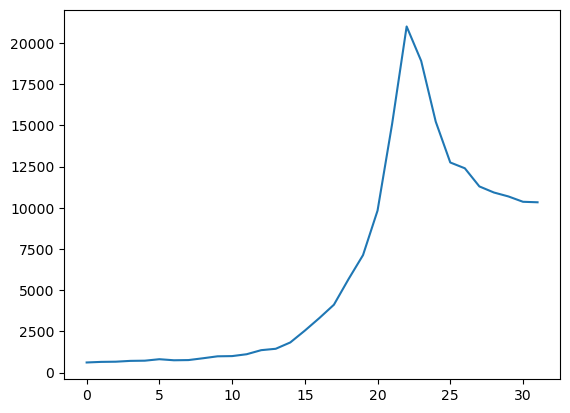

In [36]:
plt.plot(gt1.gt_xarr.data[0,:gt1.inpaintfrom_idx].sum(axis=-1))

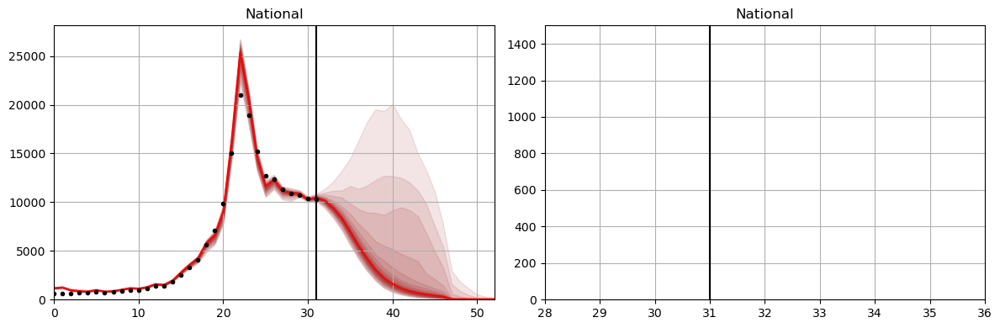

In [37]:
fig, axes = plt.subplots(1, 2, figsize=(12,4), dpi=100)

for iax in range(2):
  ax = axes[iax]
  for iqt in range(11):
      #print(flusight_quantile_pairs[iqt,0], flusight_quantile_pairs[iqt,1])
      ax.fill_between(np.arange(64), 
                      np.quantile(forecasts_national, myutils.flusight_quantile_pairs[iqt,0], axis=0)[0], 
                      np.quantile(forecasts_national, myutils.flusight_quantile_pairs[iqt,1], axis=0)[0], alpha=.1, color='darkred')
      
  ax.plot(np.arange(64), 
          np.quantile(forecasts_national, myutils.flusight_quantiles[12], axis=0)[0], color='r')
  #ax.plot(np.arange(64), fluforecasts_ti[:,0].sum(axis=-1).T,lw=0.1, alpha=.1,  color='k')
  ax.plot(gt1.gt_xarr.data[0,:gt1.inpaintfrom_idx].sum(axis=1), color='k', marker='.', ls='')
  ax.axvline(gt1.inpaintfrom_idx-1, c='k')
  if iax==0:
    ax.set_xlim(0,52)
    ax.set_ylim(bottom=0, auto=True)
  if iax==1:
    ax.set_xlim(gt1.inpaintfrom_idx-4,gt1.inpaintfrom_idx+4)
    ax.set_ylim(bottom=0, top=1500)
  
  ax.grid(visible = True)
  ax.set_title("National")
fig.tight_layout()
plt.show()

In [41]:
from datetime import datetime, timedelta

# Get today's date
today = datetime.today()

# Find the next Saturday
days_until_saturday = (5 - today.weekday()) % 7
next_saturday = today + timedelta(days=days_until_saturday)

print("Next Saturday's date is:", next_saturday.strftime("%Y-%m-%d"))
forecast_date = next_saturday.date()
team_abbrv = "UNC_IDD-InfluPaint"
forecast_date_str=str(forecast_date)

Next Saturday's date is: 2024-03-09


In [42]:
%rm -r output
%mkdir output

In [43]:
gt1.export_forecasts(fluforecasts_ti=fluforecasts_ti,
                        forecasts_national=forecasts_national,
                        directory="output",#f'output_{forecast_date_str}',
                        prefix=team_abbrv,
                        forecast_date=forecast_date,
                        save_plot=True)

DatetimeIndex(['2024-03-09', '2024-03-16', '2024-03-23', '2024-03-30',
               '2024-04-06'],
              dtype='datetime64[ns]', freq='W-SAT')


forecast_date
['2024-03-09']
target_end_date
<DatetimeArray>
['2024-03-09 00:00:00', '2024-03-16 00:00:00', '2024-03-23 00:00:00',
 '2024-03-30 00:00:00', '2024-04-06 00:00:00']
Length: 5, dtype: datetime64[ns]
location
['01' '02' '04' '05' '06' '08' '09' '10' '11' '12' '13' '15' '16' '17'
 '18' '19' '20' '21' '22' '23' '24' '25' '26' '27' '28' '29' '30' '31'
 '32' '33' '34' '35' '36' '37' '38' '39' '40' '41' '42' '44' '45' '46'
 '47' '48' '49' '50' '51' '53' '54' '55' '56' 'US']
type
['quantile']
quantile
['0.010' '0.025' '0.050' '0.100' '0.150' '0.200' '0.250' '0.300' '0.350'
 '0.400' '0.450' '0.500' '0.550' '0.600' '0.650' '0.700' '0.750' '0.800'
 '0.850' '0.900' '0.950' '0.975' '0.990']
value
[   43.7185343     31.06896576    22.06682318 ... 13222.87060994
 14510.40496319 16351.79481672]
target
['1 wk ahead inc flu hosp' '2 wk ahead inc flu hosp'
 '3 wk ahead inc flu hosp' '4 wk ahead inc flu hosp' nan]
Restored git repo Flusight/Flusight-forecast-data/
Spatial Setup with 51 locati

In [44]:
# from importlib import reload
# ground_truth = reload(ground_truth)
# gt1 = ground_truth.GroundTruth(season_first_year="2023", 
#                                data_date=datetime.datetime.today(), #datetime.datetime(2023,10,25)
#                                mask_date=datetime.datetime.today(),
#                                channels=channels,
#                                image_size=image_size
#                                )

In [45]:
gt1.export_forecasts_2023(fluforecasts_ti=fluforecasts_ti,
                        forecasts_national=forecasts_national,
                        directory='output',
                        prefix=team_abbrv,
                        forecast_date=forecast_date,
                        save_plot=True)

DatetimeIndex(['2024-03-09', '2024-03-16', '2024-03-23', '2024-03-30'], dtype='datetime64[ns]', freq='W-SAT')
reference_date
['2024-03-09']
target
['wk inc flu hosp']
horizon
['0' '1' '2' '3']
target_end_date
<DatetimeArray>
['2024-03-09 00:00:00', '2024-03-16 00:00:00', '2024-03-23 00:00:00',
 '2024-03-30 00:00:00']
Length: 4, dtype: datetime64[ns]
location
['01' '02' '04' '05' '06' '08' '09' '10' '11' '12' '13' '15' '16' '17'
 '18' '19' '20' '21' '22' '23' '24' '25' '26' '27' '28' '29' '30' '31'
 '32' '33' '34' '35' '36' '37' '38' '39' '40' '41' '42' '44' '45' '46'
 '47' '48' '49' '50' '51' '53' '54' '55' '56' 'US']
output_type
['quantile']
output_type_id
['0.01' '0.025' '0.05' '0.1' '0.15' '0.2' '0.25' '0.3' '0.35' '0.4' '0.45'
 '0.5' '0.55' '0.6' '0.65' '0.7' '0.75' '0.8' '0.85' '0.9' '0.95' '0.975'
 '0.99']
value
[   43.7185343     31.06896576    22.06682318 ... 12139.76552011
 13222.87060994 14510.40496319]
Restored git repo Flusight/Flusight-forecast-data/
Spatial Setup with 51 

## Data Export

In [46]:
import requests
requests.post("https://ntfy.sh/chadi_modeling",
     data="Notebook finshed running !",
     headers={
         "Title": "Inpainting-diffusion",
         "Priority": "urgent",
         "Tags": "warning,tada"
     })

<Response [200]>